# XRD Analysis for All Depositions

This notebook processes XRD data from multiple deposition folders automatically.

In [ ]:
import pandas as pd
import numpy as np
import os, glob, re, csv
import matplotlib.pyplot as plt
from scipy.signal import find_peaks, peak_widths, savgol_filter
from scipy.optimize import curve_fit
from matplotlib.tri import Triangulation
from matplotlib.colors import LinearSegmentedColormap, PowerNorm, Normalize
from pathlib import Path
from scipy.interpolate import griddata

# Define all deposition folders to process
BASE_DIR = r"G:\Study\Master Thesis\Characterization\XRD"

DEPOSITIONS = [
    "30-09-2025 Dep 1",
    "22-09-2025 Dep 2",
    "24-09-2025 Dep 3",
    "07-10-2025 Dep 6",
    "08-10-2025 Dep 7",
    "09-10-2025 Dep 8"
]

# Target position (mm) - same for all depositions
target_x = 399.88
target_y = 224.1
target_z = 332.15

# Wafer center position (x=0, y=0 in XRD coordinates corresponds to this)
wafer_center_x = 242.5
wafer_center_y = 257.0
wafer_center_z = 435.0

print(f"Base directory: {BASE_DIR}")
print(f"\nDepositions to process: {len(DEPOSITIONS)}")
for dep in DEPOSITIONS:
    print(f"  - {dep}")

Base directory: C:\Dilan\Study\Master Thesis\Characterization\XRD

Depositions to process: 6
  - 30-09-2025 Dep 1
  - 22-09-2025 Dep 2
  - 24-09-2025 Dep 3
  - 07-10-2025 Dep 6
  - 08-10-2025 Dep 7
  - 09-10-2025 Dep 8


In [11]:
# Define XRD analysis parameters
REGIONS = [
    (20.5, 23.0),   # (100)
    (30.5, 33.0),   # (110)
    (37.5, 40.0),   # (111)
    (44.0, 47.0),   # (200)
    (50.0, 52.5),   # (210)
    (55.0, 57.5),   # (112)
]
REGION_NAMES = ["(100)", "(110)", "(111)", "(200)", "(210)", "(112)"]

# Peak finding settings
window_pts = 12
polyorder = 2
min_sep_deg = 0.25
width_deg = (0.06, 1.2)
ratio_min = 1.2
frac_min = 0.00

def _safe_window(n, w, p):
    if n < 5:
        return None, None
    w = min(w, n - (1 - (n % 2)))
    if w % 2 == 0: w += 1
    w = max(5, w)
    p = min(p, w - 2)
    return w, p

def extract_xy_from_filename(filename):
    """Extract X and Y coordinates from filename like 'something_X-value_Y-value.xy'"""
    name = os.path.basename(filename).rsplit('.', 1)[0]
    parts = name.split('_')
    try:
        x_str, y_str = parts[-2], parts[-1]
        def tok_to_float(t):
            if '-' in t[1:]:
                t = ('-' + t[1:].replace('-', '.', 1)) if t.startswith('-') else t.replace('-', '.', 1)
            return float(t)
        x_val, y_val = tok_to_float(x_str), tok_to_float(y_str)
        return x_val, y_val
    except Exception:
        return None, None

print("Analysis parameters configured.")

Analysis parameters configured.


## Process All Depositions

In [12]:
# Process all depositions
all_deposition_results = {}

for dep_name in DEPOSITIONS:
    print(f"\n{'='*80}")
    print(f"Processing: {dep_name}")
    print(f"{'='*80}")
    
    dep_folder = os.path.join(BASE_DIR, dep_name)
    xy_data_folder = os.path.join(dep_folder, "XY Data")
    
    if not os.path.exists(xy_data_folder):
        print(f"  WARNING: XY Data folder not found in {dep_name}")
        continue
    
    os.chdir(xy_data_folder)
    files = sorted(glob.glob("*.xy"))
    
    if len(files) == 0:
        print(f"  WARNING: No .xy files found in {dep_name}")
        continue
    
    print(f"  Found {len(files)} XRD data files")
    
    # Initialize storage for this deposition
    all_file_results = []
    x_coordinates = []
    y_coordinates = []
    
    # Process each file
    for fp in files:
        data = np.loadtxt(fp)
        x, y = data[:,0], data[:,1]
        step = float(np.mean(np.diff(x)))
        
        # Smooth for peak detection
        w_use, p_use = _safe_window(len(x), window_pts, polyorder)
        ys = savgol_filter(y, w_use, p_use, mode="interp") if w_use is not None else y.copy()
        
        distance = max(1, int(min_sep_deg/step))
        width_s = (max(1, int(width_deg[0]/step)), max(2, int(width_deg[1]/step)))
        
        # Storage for THIS file: 6 values (one per region)
        file_fwhm = np.full(6, np.nan)
        file_intensity = np.full(6, np.nan)
        file_area = np.full(6, np.nan)
        file_peak_positions = [None] * 6
        
        per_region_count = {i: 0 for i in range(1, len(REGIONS)+1)}
        
        for rid, (lo, hi) in enumerate(REGIONS, start=1):
            m = (x >= lo) & (x <= hi)
            if np.count_nonzero(m) < 7:
                continue
            
            xr = x[m]
            yr = ys[m]
            idx0 = np.nonzero(m)[0][0]
            
            # Find peaks
            cand_r, prop = find_peaks(yr, distance=distance, width=width_s)
            if cand_r.size == 0:
                continue
            
            keep_r = []
            for i, pk in enumerate(cand_r):
                lb = prop["left_bases"][i]
                rb = prop["right_bases"][i]
                base = max(yr[lb], yr[rb])
                amp = yr[pk] - base
                if amp <= 0: continue
                if yr[pk] / max(base, 1e-9) < ratio_min: continue
                if amp < frac_min * base: continue
                keep_r.append(i)
            
            if not keep_r:
                continue
            
            peaks_r = cand_r[keep_r]
            widths, w_left, w_right, _ = peak_widths(yr, peaks_r, rel_height=0.5)
            
            idx_axis = np.arange(len(xr), dtype=float)
            left_x = np.interp(w_left, idx_axis, xr)
            right_x = np.interp(w_right, idx_axis, xr)
            fwhm_deg = np.abs(right_x - left_x)
            
            for j, pk in enumerate(peaks_r):
                lb = prop["left_bases"][keep_r[j]]
                rb = prop["right_bases"][keep_r[j]]
                
                x_lb, y_lb = xr[lb], yr[lb]
                x_rb, y_rb = xr[rb], yr[rb]
                
                lx, rx = x_lb, x_rb
                if lx >= rx:
                    lx = left_x[j]
                    rx = right_x[j]
                
                seg_mask = (xr >= lx) & (xr <= rx)
                if np.count_nonzero(seg_mask) < 2:
                    k0 = max(0, pk - 3)
                    k1 = min(len(xr), pk + 4)
                    seg_mask = np.zeros_like(xr, dtype=bool)
                    seg_mask[k0:k1] = True
                
                xs = xr[seg_mask]
                ys_seg = yr[seg_mask]
                
                if x_rb != x_lb:
                    slope = (y_rb - y_lb) / (x_rb - x_lb)
                    y_base = y_lb + slope * (xs - x_lb)
                else:
                    y_base = np.full_like(xs, np.mean([y_lb, y_rb]))
                
                area = np.trapz(np.maximum(ys_seg - y_base, 0.0), xs)
                
                if area == 0.0 or not np.isfinite(area):
                    peak_height = yr[pk] - np.mean([y_lb, y_rb])
                    area = peak_height * fwhm_deg[j] * 0.5 * np.sqrt(np.pi / np.log(2))
                
                gi = idx0 + pk
                per_region_count[rid] += 1
                
                # Store first peak per region
                if per_region_count[rid] == 1:
                    file_fwhm[rid-1] = float(fwhm_deg[j])
                    file_intensity[rid-1] = float(yr[pk])
                    file_area[rid-1] = float(area)
                    file_peak_positions[rid-1] = float(x[gi])
        
        # Extract X and Y coordinates from filename
        x_val, y_val = extract_xy_from_filename(fp)
        if x_val is not None and y_val is not None:
            x_coordinates.append(x_val)
            y_coordinates.append(y_val)
        
        # Store results for this file
        all_file_results.append({
            'fwhm': file_fwhm,
            'intensity': file_intensity,
            'area': file_area,
            'peak_positions': file_peak_positions,
            'filename': fp
        })
    
    # Convert to numpy arrays
    results = np.array([f['fwhm'] for f in all_file_results])
    peak_intensity = np.array([f['intensity'] for f in all_file_results])
    peak_areas = np.array([f['area'] for f in all_file_results])
    
    # Take absolute values of FWHM
    results = np.abs(results)
    
    # Store results for this deposition
    all_deposition_results[dep_name] = {
        'x_coordinates': np.array(x_coordinates),
        'y_coordinates': np.array(y_coordinates),
        'fwhm': results,
        'peak_intensity': peak_intensity,
        'peak_areas': peak_areas,
        'num_files': len(files),
        'num_processed': len(all_file_results),
        'files': files,
        'file_results': all_file_results
    }
    
    print(f"  Processed {len(all_file_results)} files successfully")

print(f"\n\n{'='*80}")
print(f"Processing complete! Results stored for {len(all_deposition_results)} depositions.")
print(f"{'='*80}")


Processing: 30-09-2025 Dep 1
  Found 61 XRD data files
  Processed 61 files successfully

Processing: 22-09-2025 Dep 2
  Found 71 XRD data files
  Processed 71 files successfully

Processing: 24-09-2025 Dep 3
  Found 61 XRD data files
  Processed 61 files successfully

Processing: 07-10-2025 Dep 6
  Found 61 XRD data files
  Processed 61 files successfully

Processing: 08-10-2025 Dep 7
  Found 61 XRD data files
  Processed 61 files successfully

Processing: 09-10-2025 Dep 8
  Found 61 XRD data files
  Processed 61 files successfully


Processing complete! Results stored for 6 depositions.


## Stacked Plots for All Depositions


Creating stacked plot for 30-09-2025 Dep 1


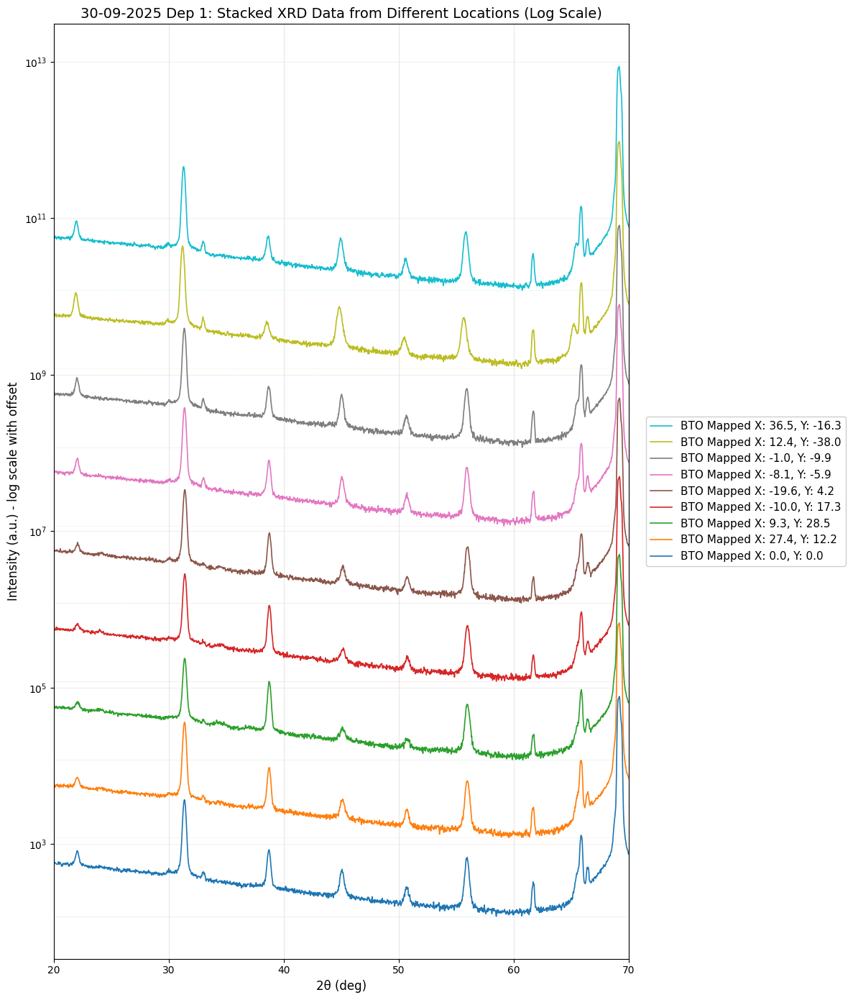


Creating stacked plot for 22-09-2025 Dep 2


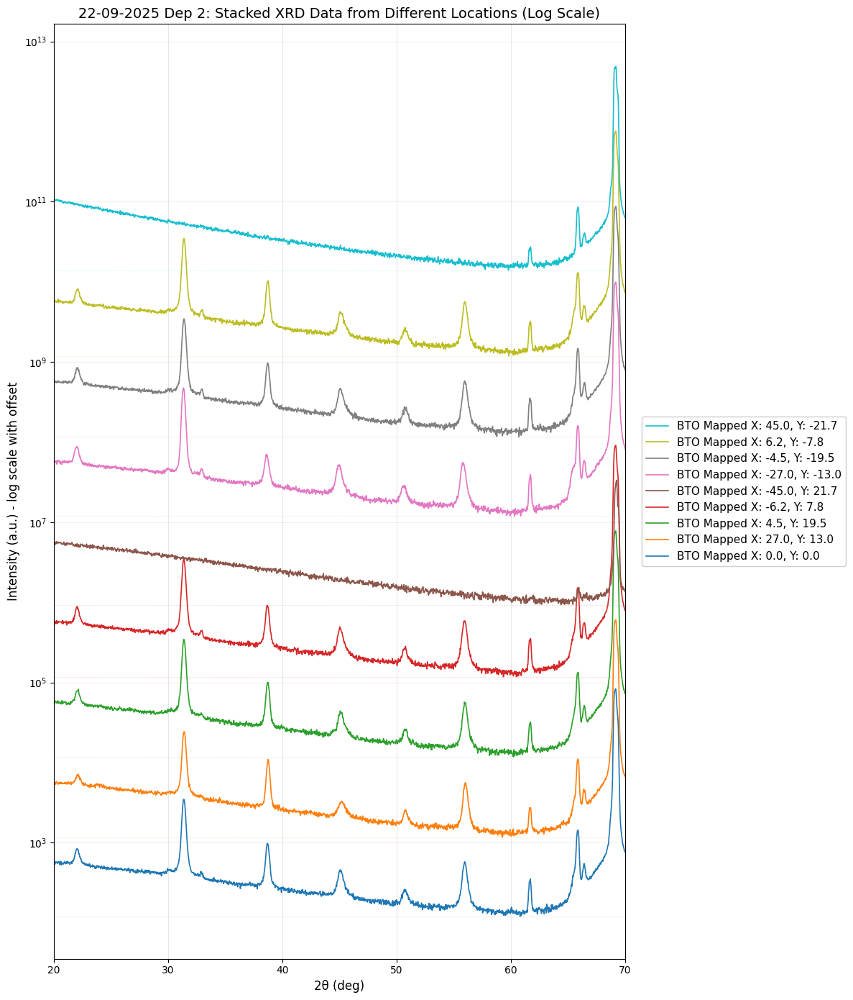


Creating stacked plot for 24-09-2025 Dep 3


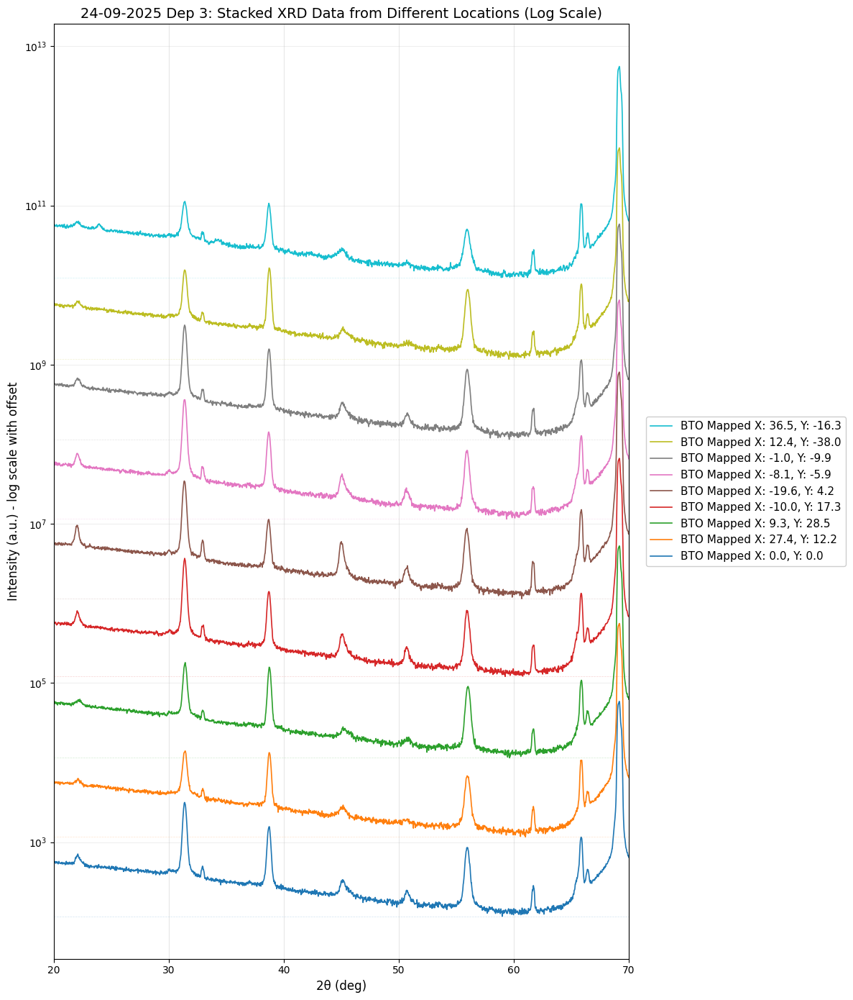


Creating stacked plot for 07-10-2025 Dep 6


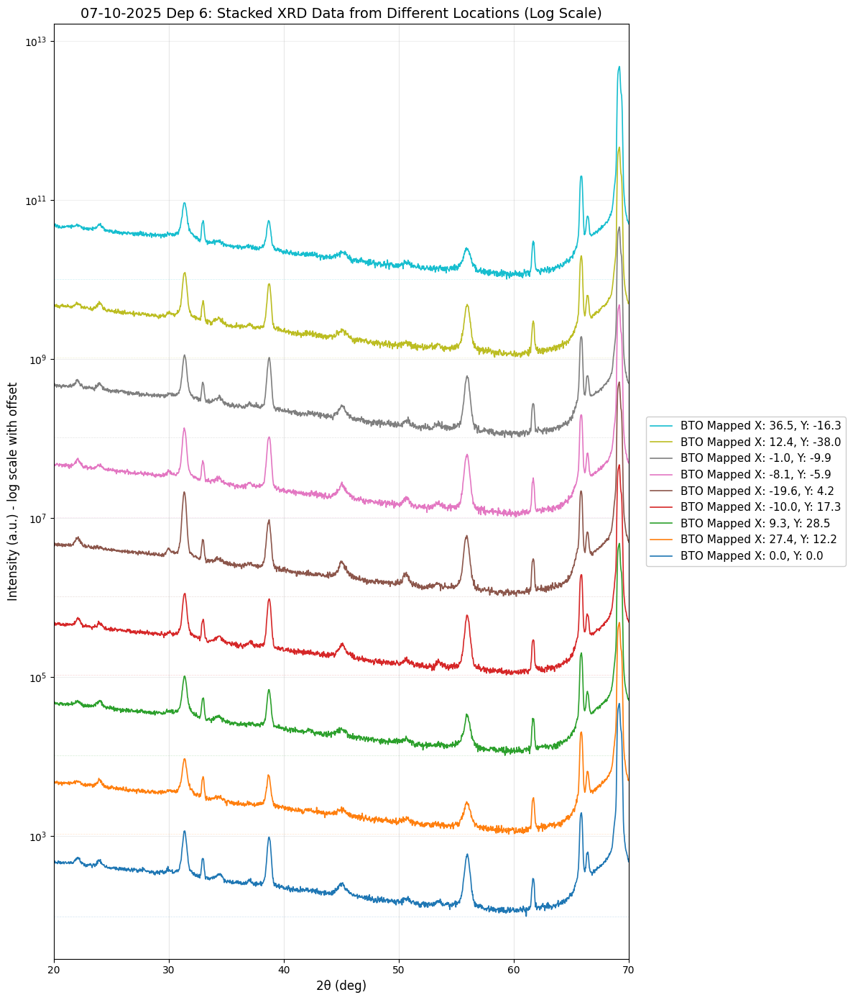


Creating stacked plot for 08-10-2025 Dep 7


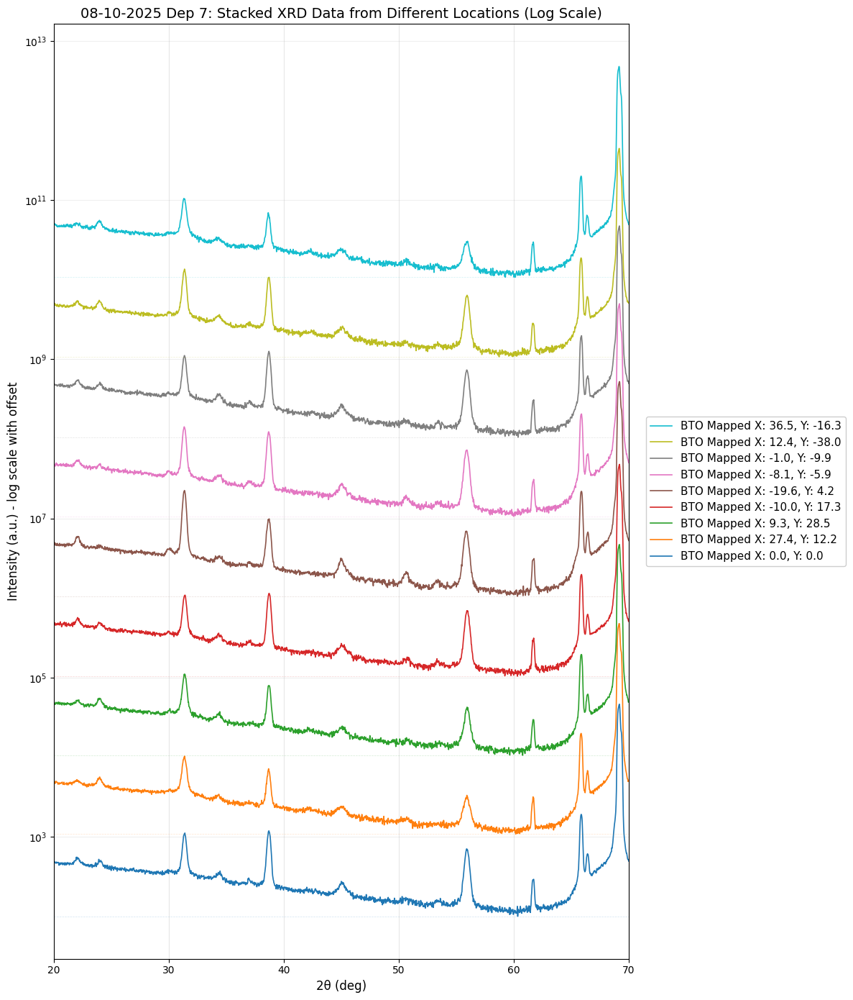


Creating stacked plot for 09-10-2025 Dep 8


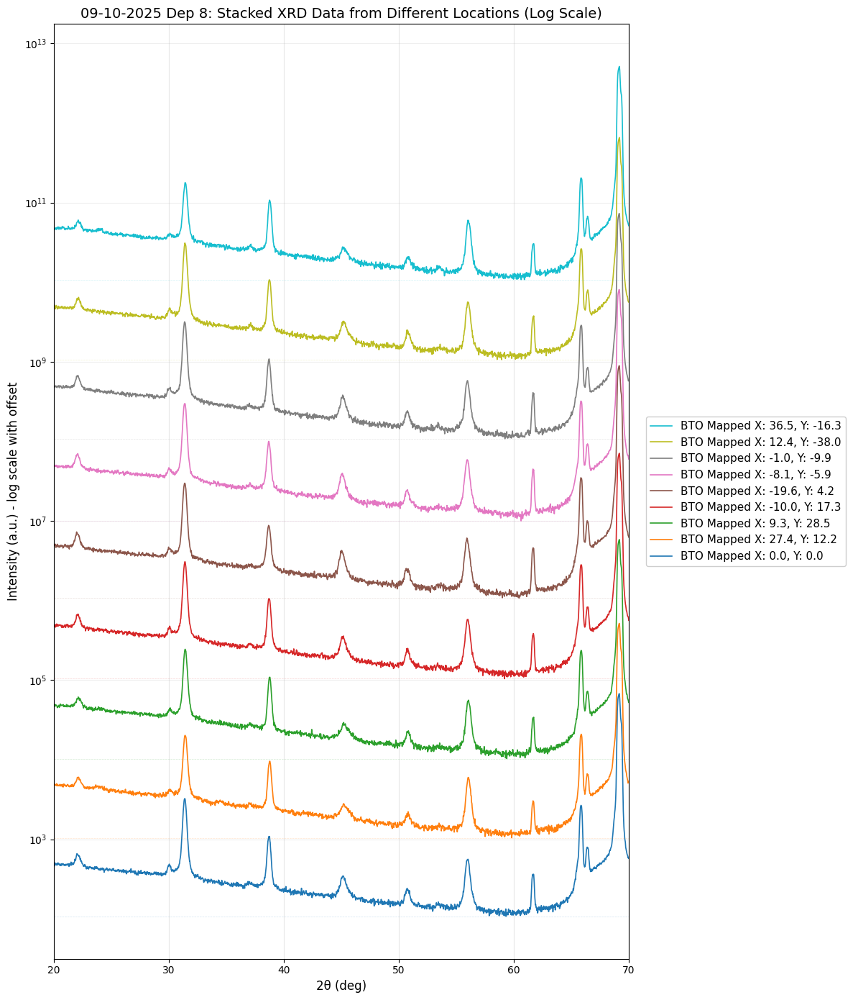

In [13]:
# Create stacked plots for each deposition
for dep_name in DEPOSITIONS:
    if dep_name not in all_deposition_results:
        continue
    
    print(f"\nCreating stacked plot for {dep_name}")
    
    dep_folder = os.path.join(BASE_DIR, dep_name)
    xy_data_folder = os.path.join(dep_folder, "XY Data")
    os.chdir(xy_data_folder)
    
    files = all_deposition_results[dep_name]['files']
    
    # Select files to plot (first, middle points, last - up to 9 files)
    if len(files) <= 9:
        files_to_plot = files
    else:
        # Select evenly spaced files
        indices = np.linspace(0, len(files)-1, 9, dtype=int)
        files_to_plot = [files[i] for i in indices]
    
    # Create ONE figure for all plots
    fig, ax = plt.subplots(figsize=(12, 14))
    
    # Define a colormap
    colors = plt.cm.tab10(np.linspace(0, 1, len(files_to_plot)))
    
    # Load data and prepare labels
    data_list = []
    label_list = []
    
    for f in files_to_plot:
        df = pd.read_csv(f, delim_whitespace=True, header=None, names=["X", "Y"])
        data_list.append(df)
        
        # Extract coordinates and create label
        x_coord, y_coord = extract_xy_from_filename(f)
        if x_coord is not None and y_coord is not None:
            label = f"BTO Mapped X: {x_coord:.1f}, Y: {y_coord:.1f}"
        else:
            label = os.path.basename(f)
        label_list.append(label)
    
    # Use logarithmic offset: multiply each curve by 10^idx
    log_offset_factor = 10
    
    # Store handles and labels for reverse ordering
    handles = []
    labels_for_legend = []
    
    # Plot with logarithmic offsets
    for idx, (df, label) in enumerate(zip(data_list, label_list)):
        offset_multiplier = log_offset_factor ** idx
        
        line, = ax.plot(df["X"], df["Y"] * offset_multiplier,
                        color=colors[idx], linewidth=1.2)
        
        handles.append(line)
        labels_for_legend.append(label)
        
        # Optional: Add horizontal gridline at baseline of each curve
        baseline = df["Y"].min() * offset_multiplier
        ax.axhline(y=baseline, color=colors[idx], linestyle='--',
                   alpha=0.2, linewidth=0.5)
    
    # Set logarithmic scale for Y-axis
    ax.set_yscale('log')
    
    # Reverse the order for legend
    handles_reversed = handles[::-1]
    labels_reversed = labels_for_legend[::-1]
    
    # Add legend outside the plot on the right
    ax.legend(handles_reversed, labels_reversed, 
              loc='center left', fontsize=11, framealpha=0.95,
              bbox_to_anchor=(1.02, 0.5))
    
    # Add labels and formatting
    ax.set_title(f"{dep_name}: Stacked XRD Data from Different Locations (Log Scale)", fontsize=14)
    ax.set_xlabel("2θ (deg)", fontsize=12)
    ax.set_ylabel("Intensity (a.u.) - log scale with offset", fontsize=12)
    ax.set_xlim(20, 70)
    ax.grid(True, alpha=0.3, axis='x')
    ax.grid(True, alpha=0.2, axis='y', which='both')
    plt.tight_layout()
    plt.show()

## Individual Plots with Smoothing and Peak Detection


Individual plots for: 30-09-2025 Dep 1

BTO_Mapping_Theta2Theta_30-09-2025_001_01_0-000_0-000.xy  peaks: 6
  (100)    [R1]   22.050°   I≈814.6   FWHM≈1.1210°   Area≈136.91
  (110)    [R2]   31.370°   I≈3680.8   FWHM≈1.7841°   Area≈1169.32
  (111)    [R3]   38.730°   I≈843.7   FWHM≈1.4478°   Area≈224.16
  (200)    [R4]   45.070°   I≈462.6   FWHM≈2.1301°   Area≈139.24
  (210)    [R5]   50.770°   I≈280.7   FWHM≈1.7390°   Area≈57.95
  (112)    [R6]   55.960°   I≈658.6   FWHM≈1.7478°   Area≈231.85


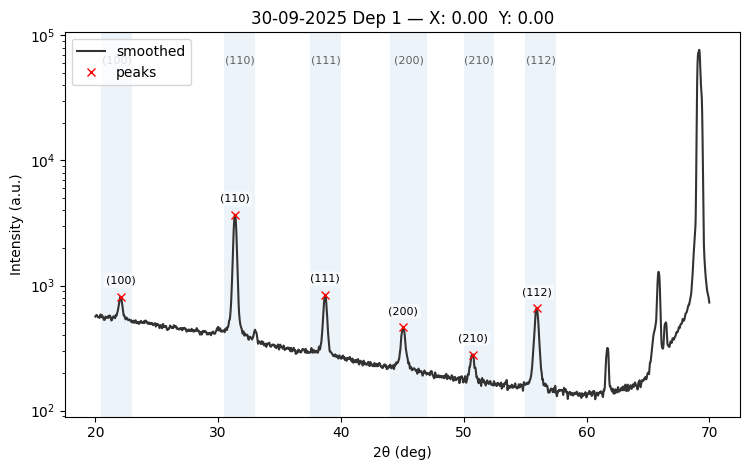


BTO_Mapping_Theta2Theta_30-09-2025_001_02_10-000_0-000.xy  peaks: 6
  (100)    [R1]   22.040°   I≈864.5   FWHM≈1.1144°   Area≈122.19
  (110)    [R2]   31.360°   I≈3844.4   FWHM≈1.7868°   Area≈1210.98
  (111)    [R3]   38.710°   I≈812.8   FWHM≈1.4590°   Area≈214.00
  (200)    [R4]   45.060°   I≈496.2   FWHM≈2.1197°   Area≈147.90
  (210)    [R5]   50.720°   I≈295.7   FWHM≈1.8346°   Area≈63.45
  (112)    [R6]   55.920°   I≈674.2   FWHM≈1.7657°   Area≈248.42


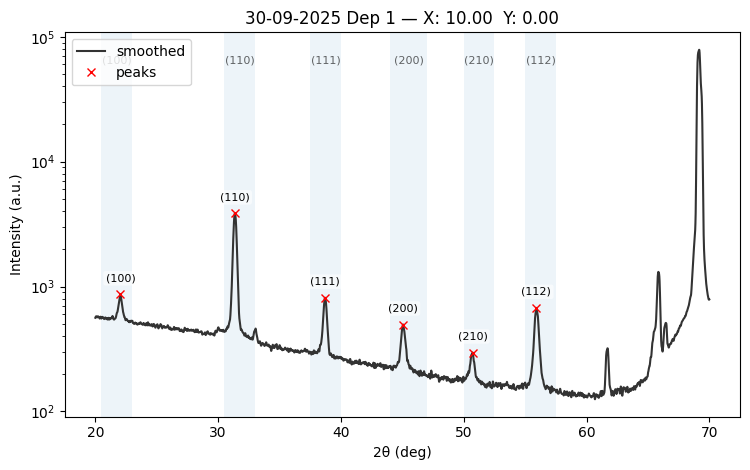


BTO_Mapping_Theta2Theta_30-09-2025_001_03_20-000_0-000.xy  peaks: 6
  (100)    [R1]   22.060°   I≈831.9   FWHM≈1.1378°   Area≈131.63
  (110)    [R2]   31.370°   I≈4053.6   FWHM≈1.7873°   Area≈1269.06
  (111)    [R3]   38.710°   I≈801.5   FWHM≈1.4581°   Area≈233.07
  (200)    [R4]   45.050°   I≈487.2   FWHM≈2.1249°   Area≈146.10
  (210)    [R5]   50.710°   I≈292.0   FWHM≈1.8648°   Area≈62.64
  (112)    [R6]   55.940°   I≈670.2   FWHM≈1.7728°   Area≈260.74


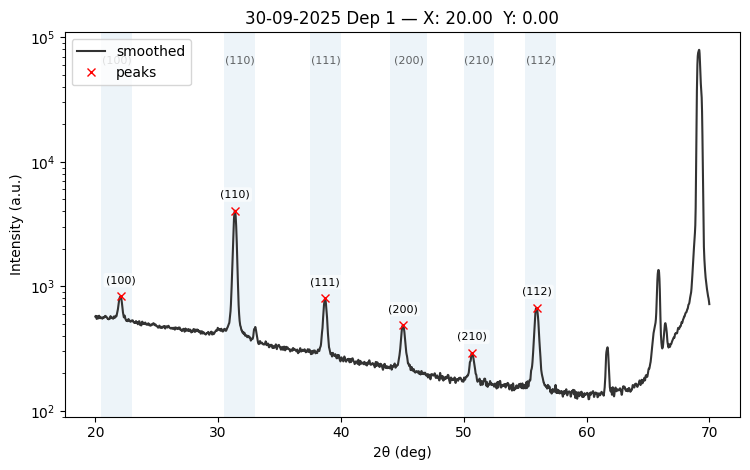


BTO_Mapping_Theta2Theta_30-09-2025_001_04_30-000_0-000.xy  peaks: 6
  (100)    [R1]   22.040°   I≈830.9   FWHM≈1.1376°   Area≈166.32
  (110)    [R2]   31.360°   I≈4132.1   FWHM≈1.7896°   Area≈1319.48
  (111)    [R3]   38.720°   I≈813.1   FWHM≈1.4541°   Area≈227.66
  (200)    [R4]   45.050°   I≈476.7   FWHM≈2.1278°   Area≈149.51
  (210)    [R5]   50.660°   I≈294.8   FWHM≈1.8290°   Area≈67.21
  (112)    [R6]   55.910°   I≈675.9   FWHM≈1.7746°   Area≈254.63


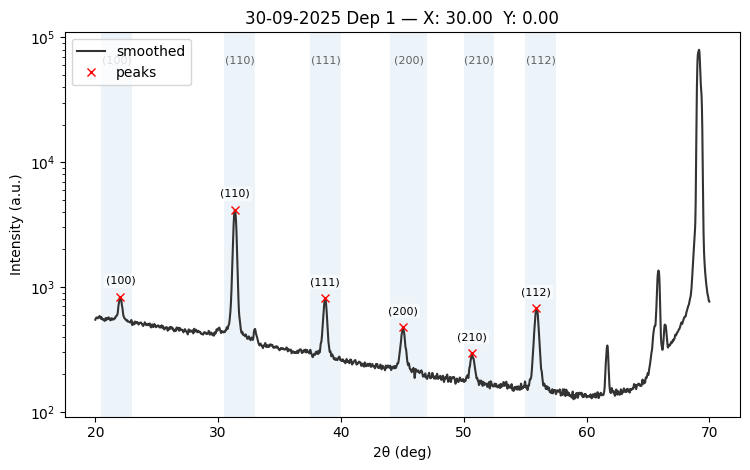


BTO_Mapping_Theta2Theta_30-09-2025_001_05_40-000_0-000.xy  peaks: 6
  (100)    [R1]   22.070°   I≈805.4   FWHM≈1.1309°   Area≈119.36
  (110)    [R2]   31.370°   I≈4233.9   FWHM≈1.7878°   Area≈1349.20
  (111)    [R3]   38.730°   I≈799.0   FWHM≈1.4555°   Area≈237.61
  (200)    [R4]   45.080°   I≈444.4   FWHM≈2.1294°   Area≈127.37
  (210)    [R5]   50.660°   I≈293.5   FWHM≈1.8664°   Area≈61.65
  (112)    [R6]   55.960°   I≈674.4   FWHM≈1.7698°   Area≈262.26


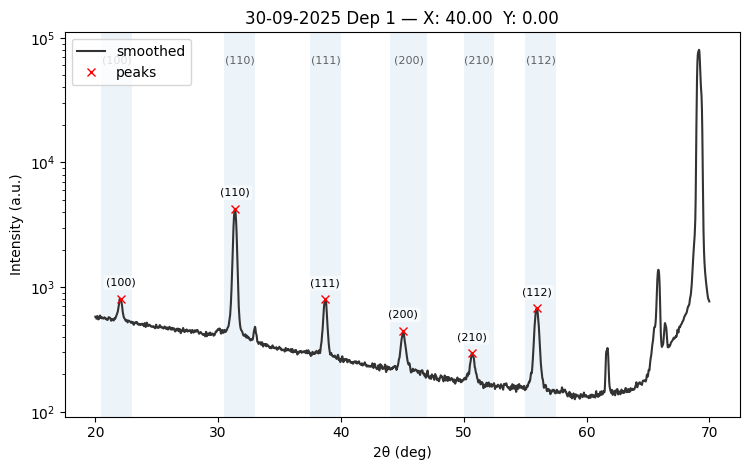


BTO_Mapping_Theta2Theta_30-09-2025_001_06_9-135_4-067.xy  peaks: 6
  (100)    [R1]   22.040°   I≈816.6   FWHM≈1.1316°   Area≈112.28
  (110)    [R2]   31.360°   I≈3728.8   FWHM≈1.7787°   Area≈1161.11
  (111)    [R3]   38.730°   I≈861.4   FWHM≈1.4439°   Area≈231.78
  (200)    [R4]   45.060°   I≈449.3   FWHM≈2.0967°   Area≈123.74
  (210)    [R5]   50.690°   I≈278.1   FWHM≈1.7331°   Area≈59.12
  (112)    [R6]   55.940°   I≈653.9   FWHM≈1.7580°   Area≈240.85


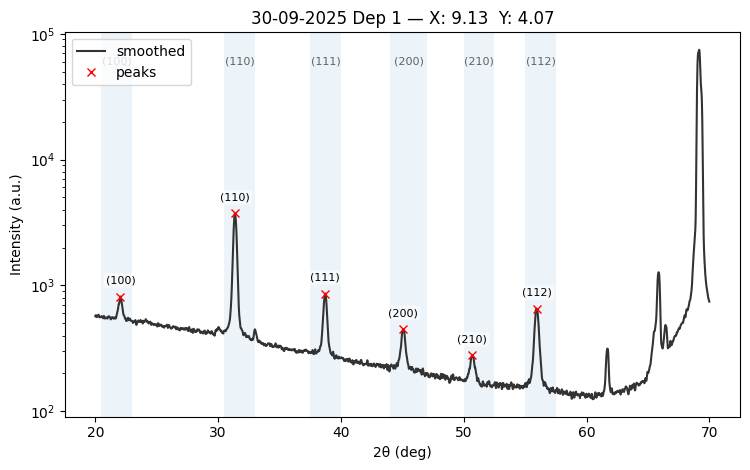


BTO_Mapping_Theta2Theta_30-09-2025_001_07_18-271_8-135.xy  peaks: 6
  (100)    [R1]   22.090°   I≈760.7   FWHM≈1.1330°   Area≈100.13
  (110)    [R2]   31.380°   I≈3689.2   FWHM≈1.7799°   Area≈1172.76
  (111)    [R3]   38.710°   I≈905.6   FWHM≈1.4381°   Area≈256.23
  (200)    [R4]   45.070°   I≈417.1   FWHM≈2.1072°   Area≈106.95
  (210)    [R5]   50.700°   I≈280.7   FWHM≈1.7323°   Area≈63.11
  (112)    [R6]   55.920°   I≈664.3   FWHM≈1.7456°   Area≈247.53


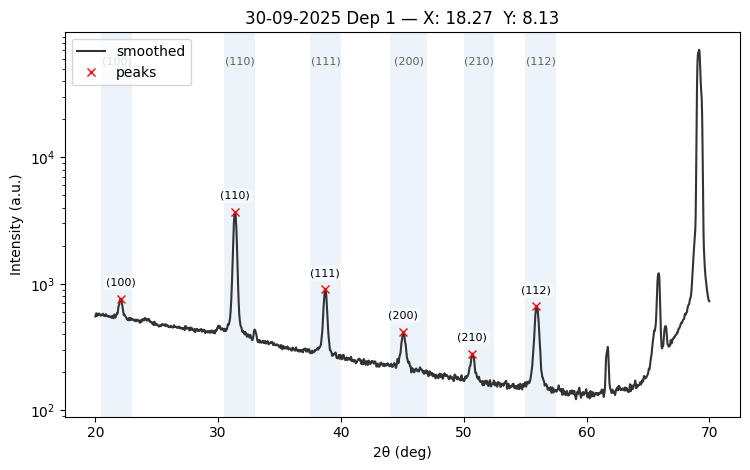


BTO_Mapping_Theta2Theta_30-09-2025_001_08_27-406_12-202.xy  peaks: 6
  (100)    [R1]   22.050°   I≈711.6   FWHM≈1.1318°   Area≈88.79
  (110)    [R2]   31.390°   I≈3618.5   FWHM≈1.7750°   Area≈1141.72
  (111)    [R3]   38.740°   I≈952.0   FWHM≈1.4319°   Area≈265.79
  (200)    [R4]   45.130°   I≈375.4   FWHM≈2.0642°   Area≈110.47
  (210)    [R5]   50.720°   I≈276.6   FWHM≈1.7098°   Area≈53.30
  (112)    [R6]   55.960°   I≈642.9   FWHM≈1.7456°   Area≈246.35


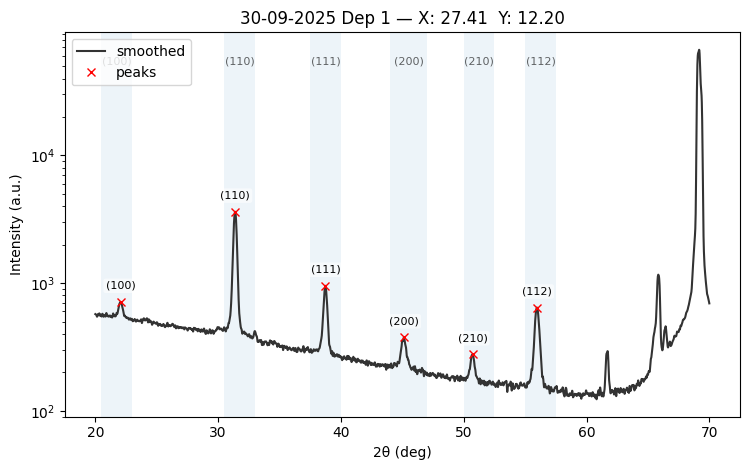


BTO_Mapping_Theta2Theta_30-09-2025_001_09_36-542_16-269.xy  peaks: 6
  (100)    [R1]   22.100°   I≈696.9   FWHM≈1.0866°   Area≈81.56
  (110)    [R2]   31.390°   I≈3507.8   FWHM≈1.7665°   Area≈1117.34
  (111)    [R3]   38.720°   I≈925.7   FWHM≈1.4222°   Area≈265.51
  (200)    [R4]   45.130°   I≈330.9   FWHM≈1.8226°   Area≈80.84
  (210)    [R5]   50.670°   I≈266.9   FWHM≈1.6759°   Area≈55.22
  (112)    [R6]   56.010°   I≈639.4   FWHM≈1.7355°   Area≈249.24


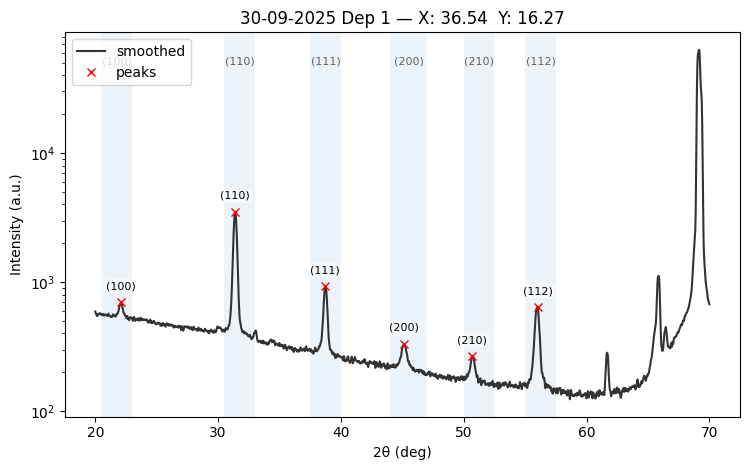


BTO_Mapping_Theta2Theta_30-09-2025_001_10_6-691_7-431.xy  peaks: 6
  (100)    [R1]   22.050°   I≈771.5   FWHM≈1.1032°   Area≈102.88
  (110)    [R2]   31.380°   I≈3605.3   FWHM≈1.7734°   Area≈1118.03
  (111)    [R3]   38.710°   I≈902.3   FWHM≈1.4380°   Area≈257.85
  (200)    [R4]   45.090°   I≈414.1   FWHM≈2.0937°   Area≈119.17
  (210)    [R5]   50.680°   I≈280.0   FWHM≈1.7632°   Area≈58.59
  (112)    [R6]   55.940°   I≈658.3   FWHM≈1.7405°   Area≈240.05


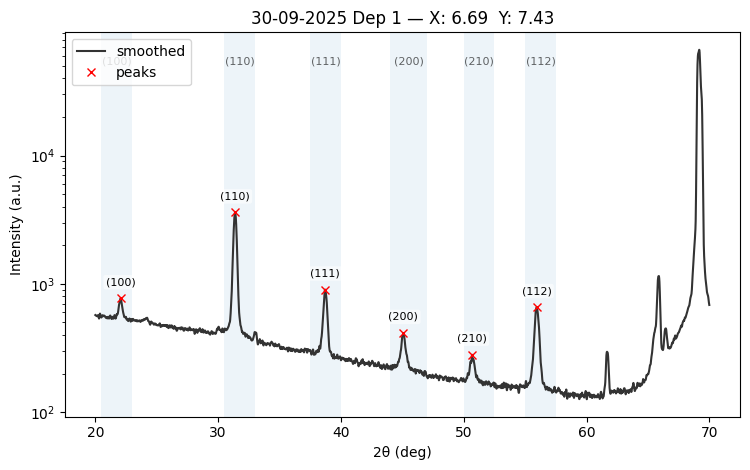


BTO_Mapping_Theta2Theta_30-09-2025_001_11_13-383_14-863.xy  peaks: 6
  (100)    [R1]   22.040°   I≈688.6   FWHM≈1.0927°   Area≈75.33
  (110)    [R2]   31.390°   I≈3384.0   FWHM≈1.7692°   Area≈1066.55
  (111)    [R3]   38.740°   I≈990.4   FWHM≈1.4236°   Area≈286.56
  (200)    [R4]   45.160°   I≈353.8   FWHM≈1.9104°   Area≈96.57
  (210)    [R5]   50.700°   I≈260.5   FWHM≈1.6453°   Area≈63.16
  (112)    [R6]   55.950°   I≈654.5   FWHM≈1.7338°   Area≈247.60


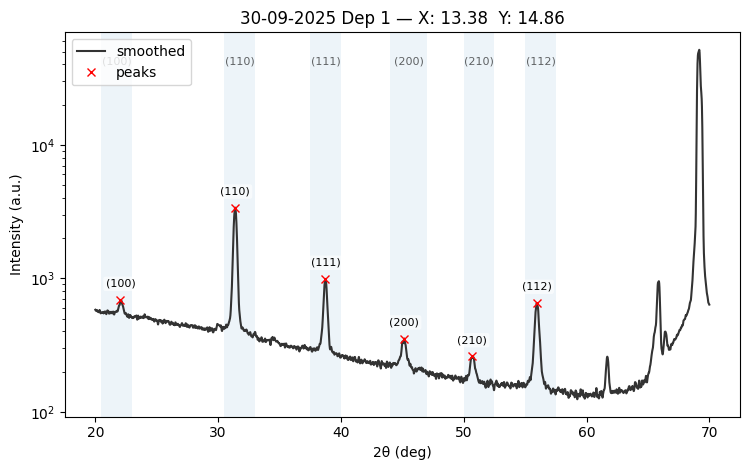


BTO_Mapping_Theta2Theta_30-09-2025_001_12_20-074_22-294.xy  peaks: 6
  (100)    [R1]   22.070°   I≈659.8   FWHM≈1.1257°   Area≈71.52
  (110)    [R2]   31.390°   I≈3059.5   FWHM≈1.7679°   Area≈964.83
  (111)    [R3]   38.770°   I≈1073.2   FWHM≈1.4173°   Area≈318.99
  (200)    [R4]   45.120°   I≈318.1   FWHM≈1.7486°   Area≈89.04
  (210)    [R5]   50.740°   I≈262.1   FWHM≈1.6173°   Area≈49.96
  (112)    [R6]   55.980°   I≈635.3   FWHM≈1.7311°   Area≈235.84


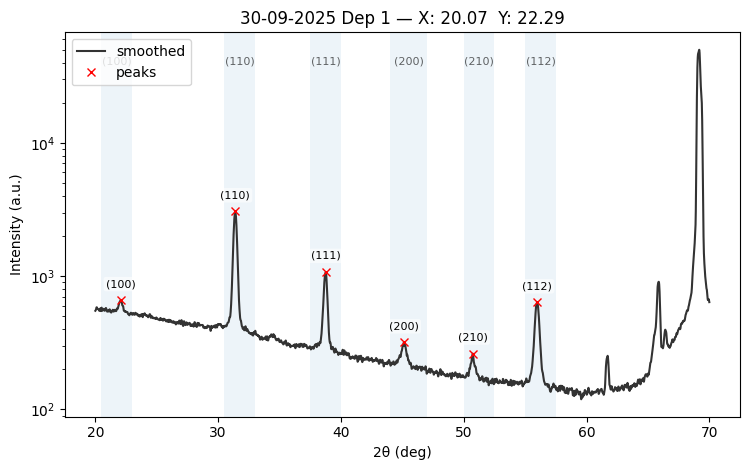


BTO_Mapping_Theta2Theta_30-09-2025_001_13_26-765_29-726.xy  peaks: 6
  (100)    [R1]   22.110°   I≈641.7   FWHM≈1.0936°   Area≈55.73
  (110)    [R2]   31.390°   I≈2559.2   FWHM≈1.7662°   Area≈804.12
  (111)    [R3]   38.760°   I≈1079.1   FWHM≈1.4096°   Area≈299.88
  (200)    [R4]   45.230°   I≈302.6   FWHM≈1.6854°   Area≈89.42
  (210)    [R5]   50.720°   I≈231.5   FWHM≈1.5229°   Area≈39.33
  (112)    [R6]   55.970°   I≈616.7   FWHM≈1.7305°   Area≈238.73


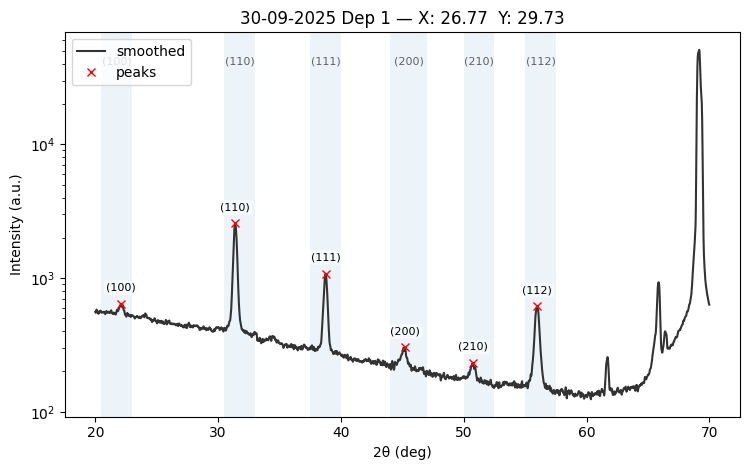


BTO_Mapping_Theta2Theta_30-09-2025_001_14_3-090_9-511.xy  peaks: 6
  (100)    [R1]   22.100°   I≈704.5   FWHM≈1.1442°   Area≈98.82
  (110)    [R2]   31.380°   I≈3468.8   FWHM≈1.7701°   Area≈1076.89
  (111)    [R3]   38.730°   I≈941.6   FWHM≈1.4240°   Area≈260.51
  (200)    [R4]   45.130°   I≈382.8   FWHM≈2.0966°   Area≈116.99
  (210)    [R5]   50.730°   I≈270.2   FWHM≈1.7030°   Area≈60.46
  (112)    [R6]   55.960°   I≈642.3   FWHM≈1.7441°   Area≈238.08


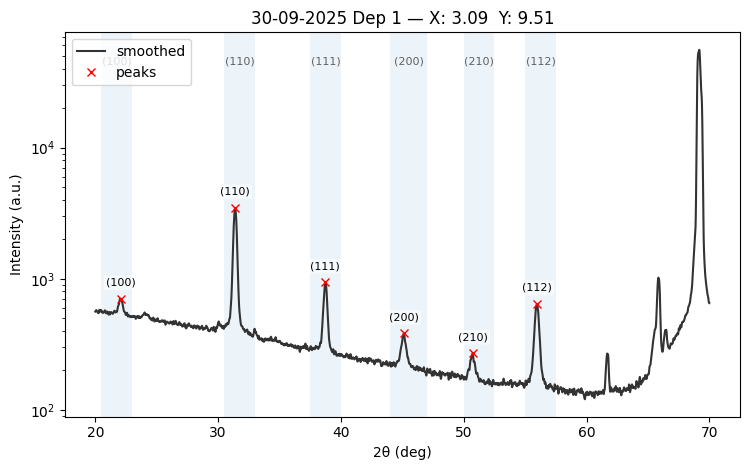


BTO_Mapping_Theta2Theta_30-09-2025_001_15_6-180_19-021.xy  peaks: 6
  (100)    [R1]   22.140°   I≈661.3   FWHM≈1.0791°   Area≈67.66
  (110)    [R2]   31.390°   I≈3047.6   FWHM≈1.7641°   Area≈960.74
  (111)    [R3]   38.760°   I≈1065.1   FWHM≈1.4202°   Area≈298.03
  (200)    [R4]   45.140°   I≈322.5   FWHM≈1.7984°   Area≈77.07
  (210)    [R5]   50.730°   I≈253.9   FWHM≈1.5690°   Area≈52.04
  (112)    [R6]   55.960°   I≈642.7   FWHM≈1.7277°   Area≈236.29


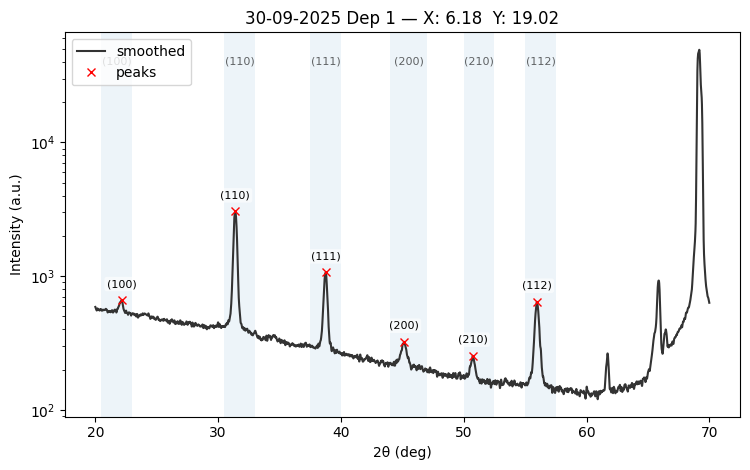


BTO_Mapping_Theta2Theta_30-09-2025_001_16_9-271_28-532.xy  peaks: 6
  (100)    [R1]   22.110°   I≈653.9   FWHM≈1.1213°   Area≈68.09
  (110)    [R2]   31.390°   I≈2365.7   FWHM≈1.7669°   Area≈732.22
  (111)    [R3]   38.740°   I≈1188.7   FWHM≈1.4116°   Area≈351.22
  (200)    [R4]   45.120°   I≈307.0   FWHM≈1.6733°   Area≈71.93
  (210)    [R5]   50.610°   I≈220.8   FWHM≈1.4319°   Area≈40.96
  (112)    [R6]   55.960°   I≈609.1   FWHM≈1.7391°   Area≈236.51


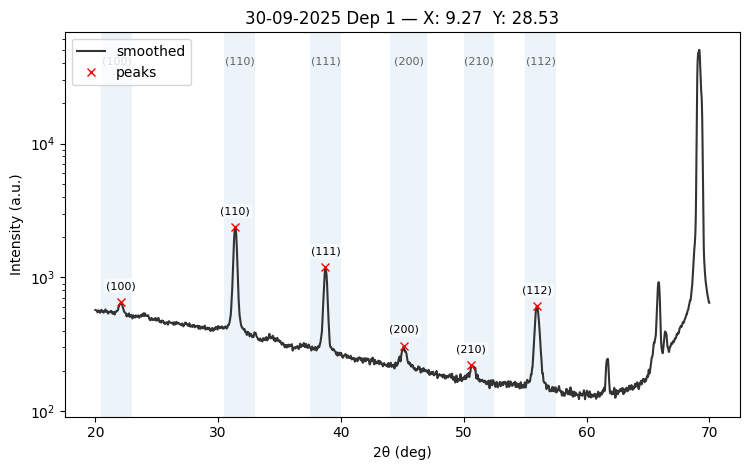


BTO_Mapping_Theta2Theta_30-09-2025_001_17_12-361_38-042.xy  peaks: 6
  (100)    [R1]   22.070°   I≈686.5   FWHM≈1.1370°   Area≈95.31
  (110)    [R2]   31.400°   I≈1801.5   FWHM≈1.7754°   Area≈579.15
  (111)    [R3]   38.740°   I≈975.5   FWHM≈1.4155°   Area≈285.46
  (200)    [R4]   45.080°   I≈344.1   FWHM≈1.8595°   Area≈102.83
  (210)    [R5]   50.670°   I≈223.4   FWHM≈1.4384°   Area≈49.23
  (112)    [R6]   55.980°   I≈574.4   FWHM≈1.7408°   Area≈213.21


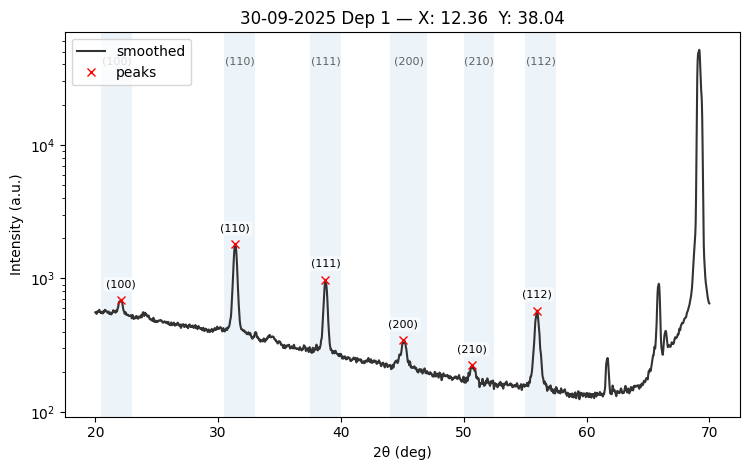


BTO_Mapping_Theta2Theta_30-09-2025_001_18_-1-045_9-945.xy  peaks: 6
  (100)    [R1]   22.070°   I≈717.6   FWHM≈1.0962°   Area≈97.37
  (110)    [R2]   31.390°   I≈3405.7   FWHM≈1.7661°   Area≈1077.28
  (111)    [R3]   38.750°   I≈960.8   FWHM≈1.4247°   Area≈263.15
  (200)    [R4]   45.120°   I≈370.2   FWHM≈2.0169°   Area≈97.23
  (210)    [R5]   50.760°   I≈262.7   FWHM≈1.6743°   Area≈54.56
  (112)    [R6]   55.960°   I≈650.7   FWHM≈1.7323°   Area≈240.23


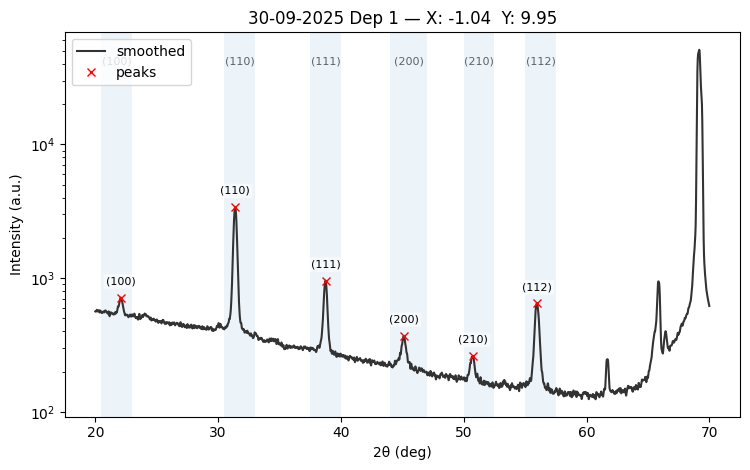


BTO_Mapping_Theta2Theta_30-09-2025_001_19_-2-091_19-890.xy  peaks: 6
  (100)    [R1]   22.090°   I≈667.2   FWHM≈1.0587°   Area≈76.71
  (110)    [R2]   31.390°   I≈2819.2   FWHM≈1.7623°   Area≈904.07
  (111)    [R3]   38.750°   I≈1138.6   FWHM≈1.4135°   Area≈336.02
  (200)    [R4]   45.140°   I≈317.4   FWHM≈1.7543°   Area≈68.74
  (210)    [R5]   50.670°   I≈245.3   FWHM≈1.5604°   Area≈51.73
  (112)    [R6]   55.960°   I≈625.3   FWHM≈1.7255°   Area≈238.20


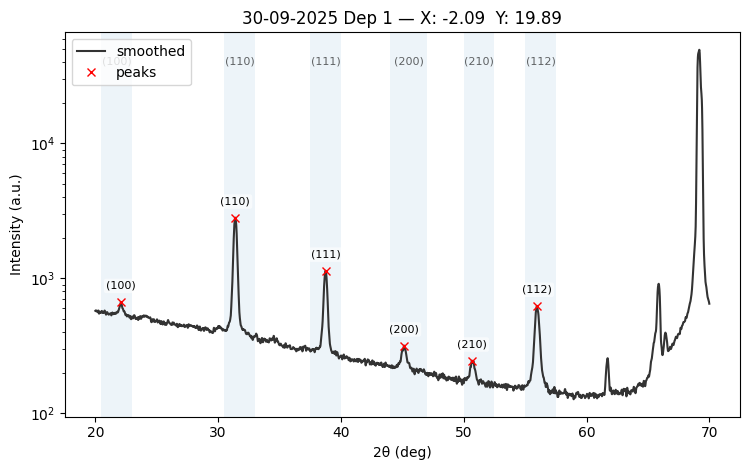


BTO_Mapping_Theta2Theta_30-09-2025_001_20_-3-136_29-836.xy  peaks: 6
  (100)    [R1]   22.000°   I≈664.2   FWHM≈1.1121°   Area≈72.71
  (110)    [R2]   31.400°   I≈2027.1   FWHM≈1.7659°   Area≈631.51
  (111)    [R3]   38.770°   I≈1147.1   FWHM≈1.4145°   Area≈346.47
  (200)    [R4]   45.080°   I≈320.0   FWHM≈1.7819°   Area≈78.62
  (210)    [R5]   50.810°   I≈222.4   FWHM≈1.4754°   Area≈35.81
  (112)    [R6]   55.970°   I≈590.4   FWHM≈1.7332°   Area≈227.11


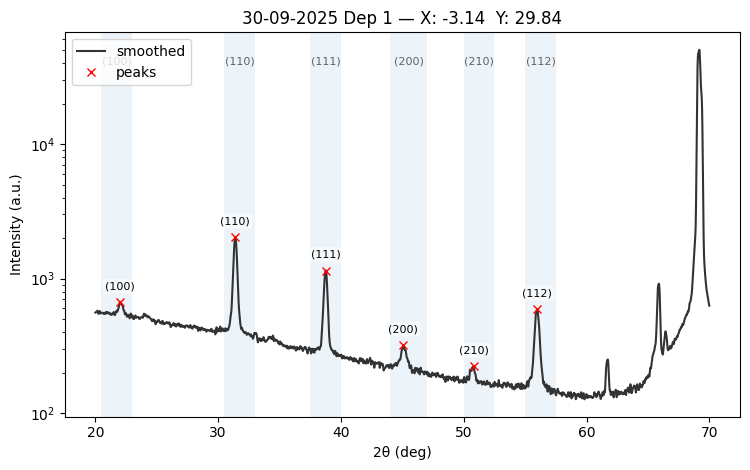


BTO_Mapping_Theta2Theta_30-09-2025_001_21_-4-181_39-781.xy  peaks: 6
  (100)    [R1]   22.100°   I≈686.0   FWHM≈1.1296°   Area≈92.11
  (110)    [R2]   31.380°   I≈1571.7   FWHM≈1.7702°   Area≈493.15
  (111)    [R3]   38.740°   I≈933.0   FWHM≈1.4205°   Area≈269.75
  (200)    [R4]   45.110°   I≈336.3   FWHM≈1.8904°   Area≈111.99
  (210)    [R5]   50.730°   I≈210.7   FWHM≈1.3995°   Area≈31.62
  (112)    [R6]   55.970°   I≈525.0   FWHM≈1.7536°   Area≈195.97


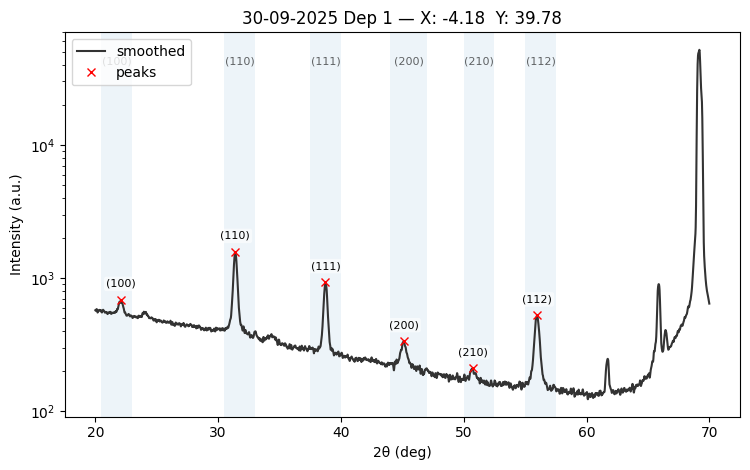


BTO_Mapping_Theta2Theta_30-09-2025_001_22_-5-000_8-660.xy  peaks: 6
  (100)    [R1]   22.030°   I≈697.9   FWHM≈1.1161°   Area≈87.97
  (110)    [R2]   31.380°   I≈3410.9   FWHM≈1.7629°   Area≈1061.35
  (111)    [R3]   38.730°   I≈933.8   FWHM≈1.4231°   Area≈277.00
  (200)    [R4]   45.070°   I≈369.7   FWHM≈2.0019°   Area≈100.56
  (210)    [R5]   50.690°   I≈259.1   FWHM≈1.6404°   Area≈48.30
  (112)    [R6]   55.990°   I≈635.4   FWHM≈1.7456°   Area≈244.45


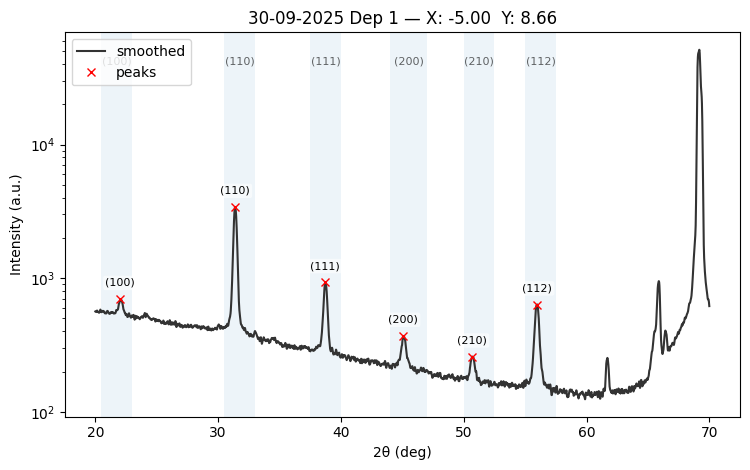


BTO_Mapping_Theta2Theta_30-09-2025_001_23_-10-000_17-321.xy  peaks: 6
  (100)    [R1]   22.020°   I≈646.8   FWHM≈1.1272°   Area≈70.83
  (110)    [R2]   31.400°   I≈2839.4   FWHM≈1.7549°   Area≈898.93
  (111)    [R3]   38.740°   I≈1126.0   FWHM≈1.4134°   Area≈349.28
  (200)    [R4]   45.200°   I≈317.1   FWHM≈1.7281°   Area≈76.51
  (210)    [R5]   50.700°   I≈250.5   FWHM≈1.5448°   Area≈48.85
  (112)    [R6]   55.980°   I≈620.1   FWHM≈1.7342°   Area≈237.24


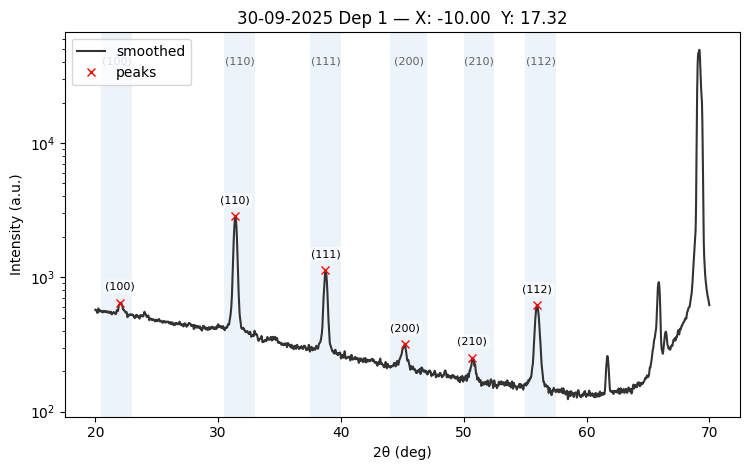


BTO_Mapping_Theta2Theta_30-09-2025_001_24_-15-000_25-981.xy  peaks: 6
  (100)    [R1]   22.080°   I≈668.8   FWHM≈1.0877°   Area≈83.85
  (110)    [R2]   31.410°   I≈2029.1   FWHM≈1.7652°   Area≈632.97
  (111)    [R3]   38.750°   I≈1145.1   FWHM≈1.4057°   Area≈332.23
  (200)    [R4]   45.100°   I≈316.7   FWHM≈1.8249°   Area≈80.61
  (210)    [R5]   50.760°   I≈222.6   FWHM≈1.4613°   Area≈41.67
  (112)    [R6]   55.970°   I≈592.4   FWHM≈1.7243°   Area≈220.15


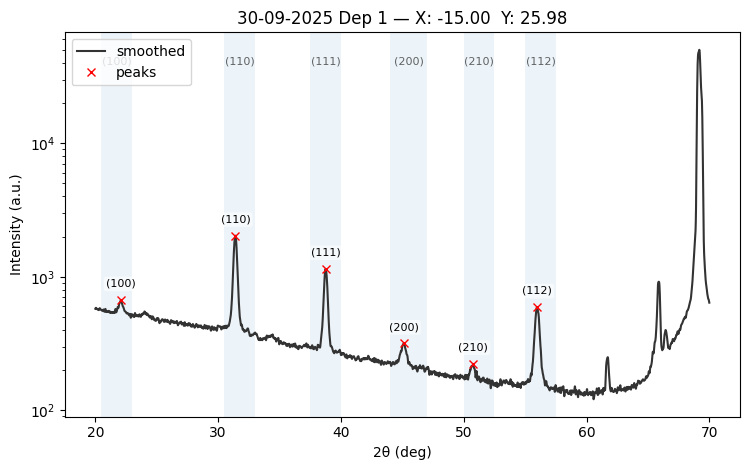


BTO_Mapping_Theta2Theta_30-09-2025_001_25_-20-000_34-641.xy  peaks: 6
  (100)    [R1]   22.120°   I≈692.2   FWHM≈1.1100°   Area≈89.47
  (110)    [R2]   31.400°   I≈1560.9   FWHM≈1.7624°   Area≈492.49
  (111)    [R3]   38.760°   I≈934.9   FWHM≈1.4049°   Area≈247.00
  (200)    [R4]   45.160°   I≈330.2   FWHM≈1.8930°   Area≈98.50
  (210)    [R5]   50.710°   I≈217.3   FWHM≈1.3918°   Area≈27.71
  (112)    [R6]   55.980°   I≈524.3   FWHM≈1.7379°   Area≈188.21


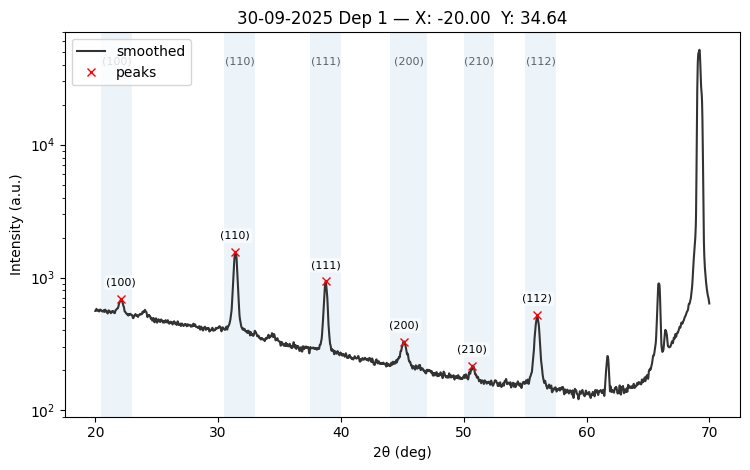


BTO_Mapping_Theta2Theta_30-09-2025_001_26_-8-090_5-878.xy  peaks: 6
  (100)    [R1]   22.120°   I≈732.9   FWHM≈1.0879°   Area≈99.18
  (110)    [R2]   31.390°   I≈3435.3   FWHM≈1.7659°   Area≈1092.45
  (111)    [R3]   38.730°   I≈919.8   FWHM≈1.4311°   Area≈261.36
  (200)    [R4]   45.110°   I≈394.6   FWHM≈2.0734°   Area≈102.01
  (210)    [R5]   50.730°   I≈276.2   FWHM≈1.7074°   Area≈55.27
  (112)    [R6]   55.940°   I≈644.0   FWHM≈1.7258°   Area≈240.12


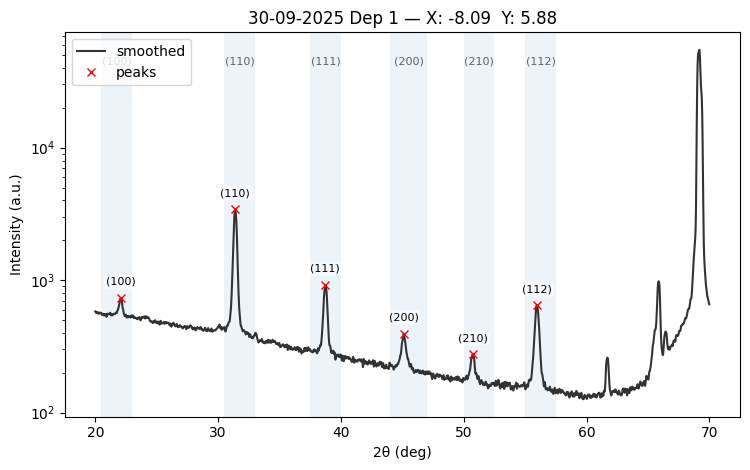


BTO_Mapping_Theta2Theta_30-09-2025_001_27_-16-180_11-756.xy  peaks: 6
  (100)    [R1]   22.100°   I≈671.0   FWHM≈1.0351°   Area≈58.81
  (110)    [R2]   31.410°   I≈3062.4   FWHM≈1.7536°   Area≈958.93
  (111)    [R3]   38.760°   I≈1071.4   FWHM≈1.4045°   Area≈296.11
  (200)    [R4]   45.130°   I≈330.4   FWHM≈1.7765°   Area≈69.77
  (210)    [R5]   50.710°   I≈251.7   FWHM≈1.5601°   Area≈47.83
  (112)    [R6]   56.020°   I≈618.9   FWHM≈1.7264°   Area≈233.18


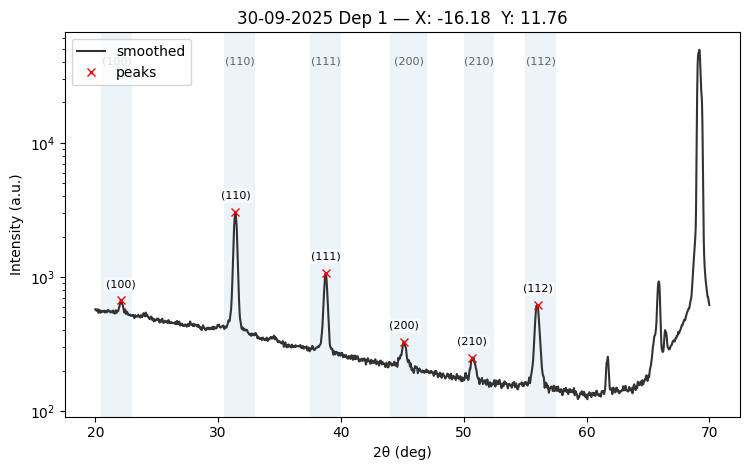


BTO_Mapping_Theta2Theta_30-09-2025_001_28_-24-271_17-634.xy  peaks: 6
  (100)    [R1]   22.150°   I≈644.0   FWHM≈1.0790°   Area≈84.19
  (110)    [R2]   31.420°   I≈2299.4   FWHM≈1.7465°   Area≈713.47
  (111)    [R3]   38.790°   I≈1153.8   FWHM≈1.3912°   Area≈329.51
  (200)    [R4]   45.160°   I≈303.2   FWHM≈1.6909°   Area≈74.25
  (210)    [R5]   50.820°   I≈223.8   FWHM≈1.4349°   Area≈32.04
  (112)    [R6]   55.980°   I≈611.5   FWHM≈1.7184°   Area≈235.42


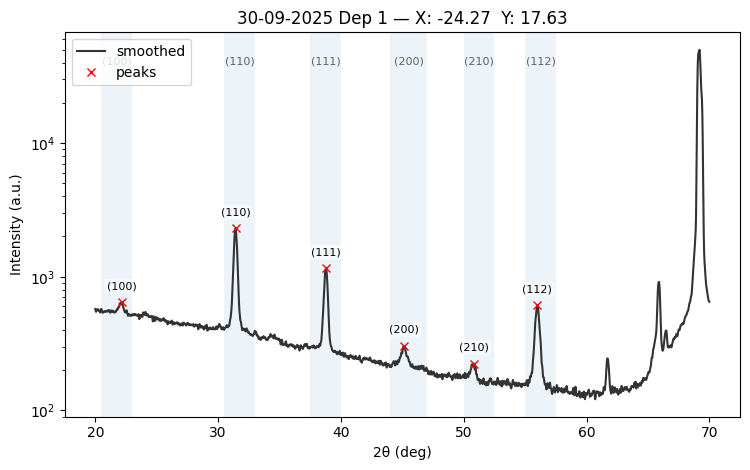


BTO_Mapping_Theta2Theta_30-09-2025_001_29_-32-361_23-511.xy  peaks: 6
  (100)    [R1]   22.100°   I≈693.8   FWHM≈1.1123°   Area≈92.73
  (110)    [R2]   31.410°   I≈1780.9   FWHM≈1.7519°   Area≈548.00
  (111)    [R3]   38.770°   I≈955.0   FWHM≈1.3956°   Area≈270.49
  (200)    [R4]   45.130°   I≈356.1   FWHM≈1.9271°   Area≈97.51
  (210)    [R5]   50.710°   I≈230.2   FWHM≈1.4316°   Area≈41.61
  (112)    [R6]   55.970°   I≈558.2   FWHM≈1.7179°   Area≈214.42


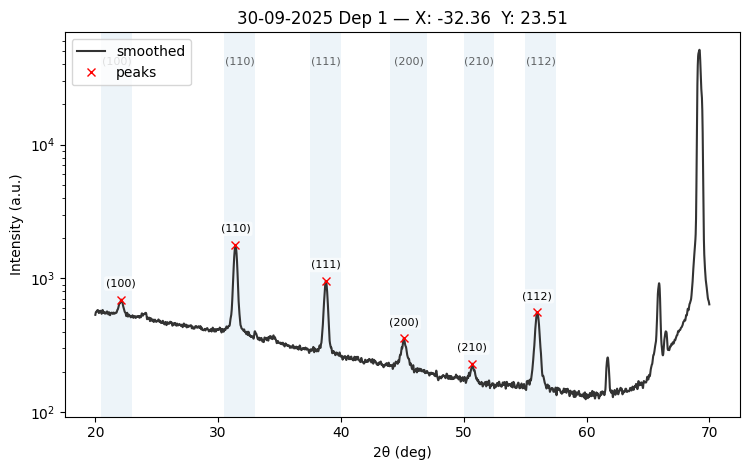


BTO_Mapping_Theta2Theta_30-09-2025_001_30_-9-781_2-079.xy  peaks: 6
  (100)    [R1]   22.070°   I≈755.5   FWHM≈1.0992°   Area≈128.92
  (110)    [R2]   31.390°   I≈3562.7   FWHM≈1.7678°   Area≈1117.86
  (111)    [R3]   38.740°   I≈871.8   FWHM≈1.4389°   Area≈251.81
  (200)    [R4]   45.050°   I≈409.0   FWHM≈2.1011°   Area≈121.06
  (210)    [R5]   50.760°   I≈273.2   FWHM≈1.7040°   Area≈62.60
  (112)    [R6]   55.940°   I≈640.7   FWHM≈1.7448°   Area≈243.07


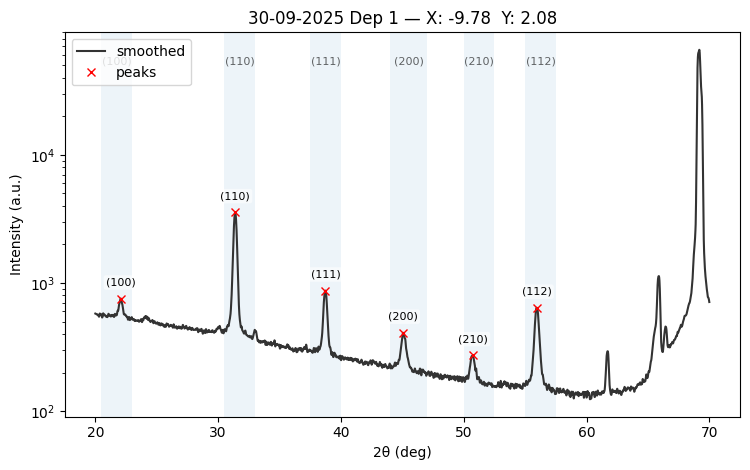


BTO_Mapping_Theta2Theta_30-09-2025_001_31_-19-563_4-158.xy  peaks: 6
  (100)    [R1]   22.090°   I≈704.1   FWHM≈1.0893°   Area≈90.58
  (110)    [R2]   31.410°   I≈3394.9   FWHM≈1.7516°   Area≈1073.07
  (111)    [R3]   38.760°   I≈950.4   FWHM≈1.4083°   Area≈263.27
  (200)    [R4]   45.180°   I≈364.2   FWHM≈1.9370°   Area≈99.40
  (210)    [R5]   50.710°   I≈259.3   FWHM≈1.6211°   Area≈48.56
  (112)    [R6]   56.000°   I≈632.5   FWHM≈1.7221°   Area≈234.15


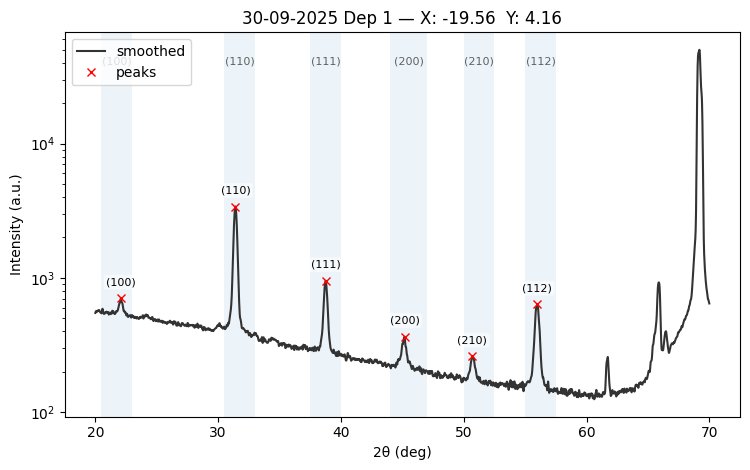


BTO_Mapping_Theta2Theta_30-09-2025_001_32_-29-344_6-237.xy  peaks: 6
  (100)    [R1]   22.190°   I≈651.8   FWHM≈1.1594°   Area≈71.74
  (110)    [R2]   31.410°   I≈2989.7   FWHM≈1.7386°   Area≈947.71
  (111)    [R3]   38.770°   I≈1060.9   FWHM≈1.3985°   Area≈299.65
  (200)    [R4]   45.110°   I≈317.0   FWHM≈1.7611°   Area≈78.48
  (210)    [R5]   50.820°   I≈247.2   FWHM≈1.5595°   Area≈45.94
  (112)    [R6]   55.980°   I≈631.2   FWHM≈1.7149°   Area≈236.17


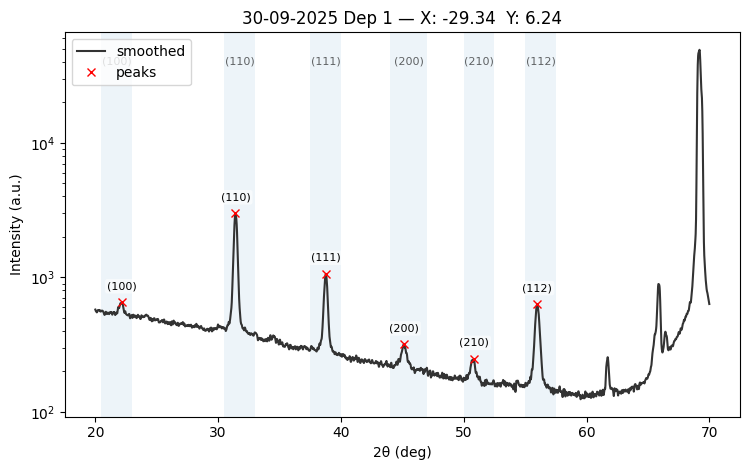


BTO_Mapping_Theta2Theta_30-09-2025_001_33_-39-126_8-316.xy  peaks: 6
  (100)    [R1]   22.090°   I≈648.0   FWHM≈1.0612°   Area≈82.66
  (110)    [R2]   31.430°   I≈2276.5   FWHM≈1.7342°   Area≈695.21
  (111)    [R3]   38.790°   I≈1101.2   FWHM≈1.3852°   Area≈320.72
  (200)    [R4]   45.150°   I≈307.3   FWHM≈1.6858°   Area≈55.95
  (210)    [R5]   50.760°   I≈230.5   FWHM≈1.4656°   Area≈42.57
  (112)    [R6]   56.000°   I≈610.9   FWHM≈1.7060°   Area≈236.02


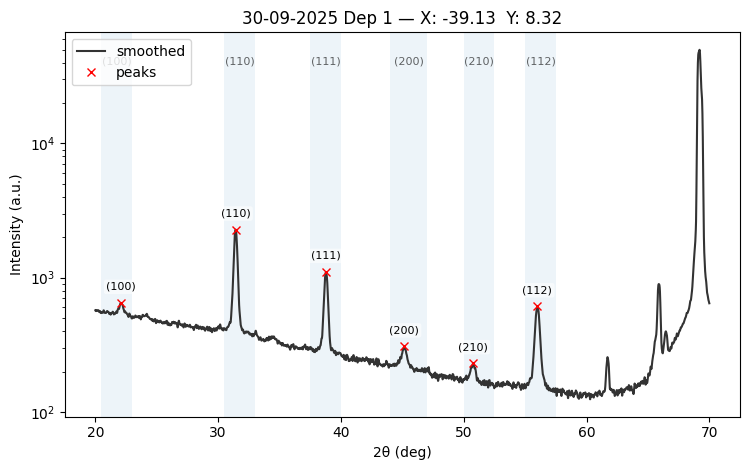


BTO_Mapping_Theta2Theta_30-09-2025_001_34_-9-781_-2-079.xy  peaks: 6
  (100)    [R1]   22.090°   I≈790.7   FWHM≈1.1120°   Area≈119.07
  (110)    [R2]   31.380°   I≈3648.7   FWHM≈1.7711°   Area≈1146.62
  (111)    [R3]   38.730°   I≈852.5   FWHM≈1.4379°   Area≈224.04
  (200)    [R4]   45.090°   I≈457.5   FWHM≈2.1033°   Area≈127.97
  (210)    [R5]   50.680°   I≈277.3   FWHM≈1.7615°   Area≈54.02
  (112)    [R6]   55.950°   I≈644.6   FWHM≈1.7485°   Area≈235.60


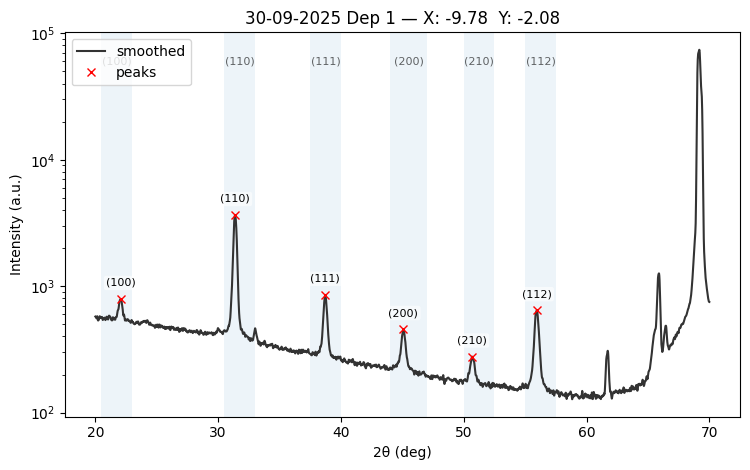


BTO_Mapping_Theta2Theta_30-09-2025_001_35_-19-563_-4-158.xy  peaks: 6
  (100)    [R1]   22.080°   I≈760.5   FWHM≈1.0791°   Area≈91.70
  (110)    [R2]   31.400°   I≈3722.1   FWHM≈1.7580°   Area≈1157.32
  (111)    [R3]   38.730°   I≈876.3   FWHM≈1.4114°   Area≈216.86
  (200)    [R4]   45.140°   I≈419.9   FWHM≈2.0876°   Area≈118.75
  (210)    [R5]   50.690°   I≈280.0   FWHM≈1.7508°   Area≈60.70
  (112)    [R6]   55.980°   I≈654.9   FWHM≈1.7308°   Area≈232.61


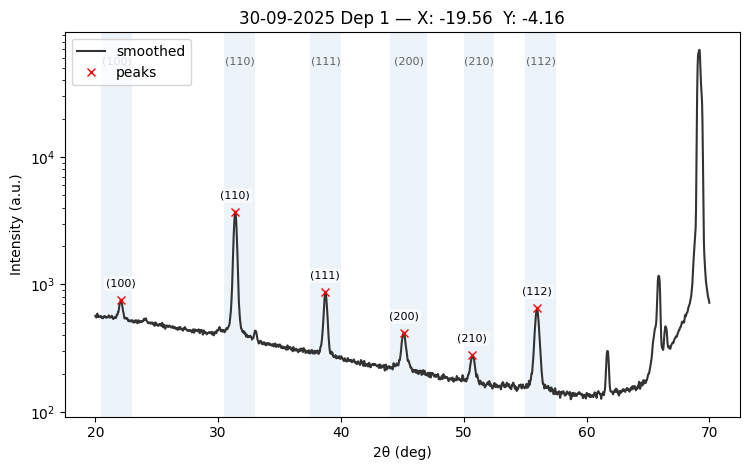


BTO_Mapping_Theta2Theta_30-09-2025_001_36_-29-344_-6-237.xy  peaks: 6
  (100)    [R1]   22.120°   I≈713.7   FWHM≈1.0928°   Area≈94.92
  (110)    [R2]   31.410°   I≈3679.0   FWHM≈1.7405°   Area≈1149.45
  (111)    [R3]   38.770°   I≈867.0   FWHM≈1.4040°   Area≈253.31
  (200)    [R4]   45.170°   I≈368.6   FWHM≈2.0019°   Area≈111.27
  (210)    [R5]   50.720°   I≈271.5   FWHM≈1.6857°   Area≈58.46
  (112)    [R6]   55.970°   I≈659.4   FWHM≈1.7002°   Area≈244.13


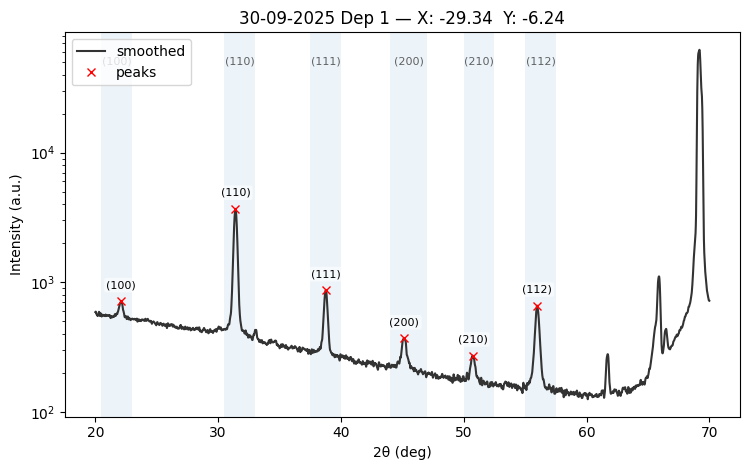


BTO_Mapping_Theta2Theta_30-09-2025_001_37_-39-126_-8-316.xy  peaks: 6
  (100)    [R1]   22.140°   I≈691.0   FWHM≈1.0673°   Area≈75.92
  (110)    [R2]   31.430°   I≈3589.8   FWHM≈1.7271°   Area≈1150.22
  (111)    [R3]   38.780°   I≈886.0   FWHM≈1.3853°   Area≈243.05
  (200)    [R4]   45.200°   I≈339.7   FWHM≈1.8251°   Area≈95.15
  (210)    [R5]   50.760°   I≈257.1   FWHM≈1.6008°   Area≈43.07
  (112)    [R6]   56.000°   I≈648.1   FWHM≈1.6975°   Area≈242.07


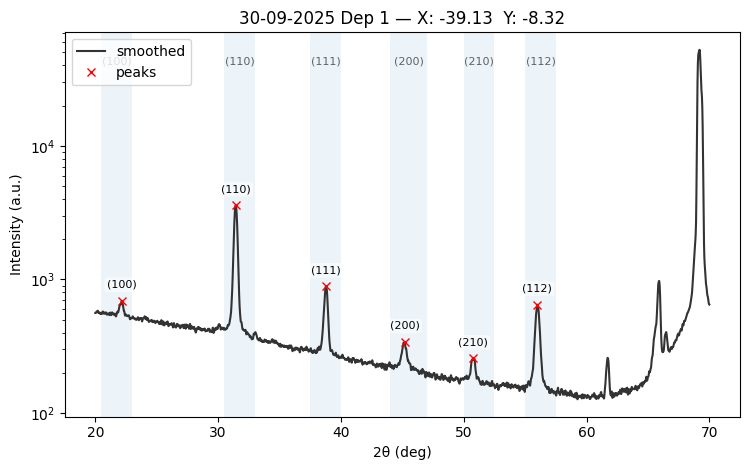


BTO_Mapping_Theta2Theta_30-09-2025_001_38_-8-090_-5-878.xy  peaks: 6
  (100)    [R1]   22.080°   I≈855.8   FWHM≈1.1019°   Area≈142.85
  (110)    [R2]   31.380°   I≈3771.9   FWHM≈1.7764°   Area≈1196.91
  (111)    [R3]   38.720°   I≈807.6   FWHM≈1.4346°   Area≈211.60
  (200)    [R4]   45.050°   I≈495.1   FWHM≈2.1335°   Area≈151.13
  (210)    [R5]   50.720°   I≈295.6   FWHM≈1.8505°   Area≈65.13
  (112)    [R6]   55.900°   I≈648.7   FWHM≈1.7560°   Area≈239.28


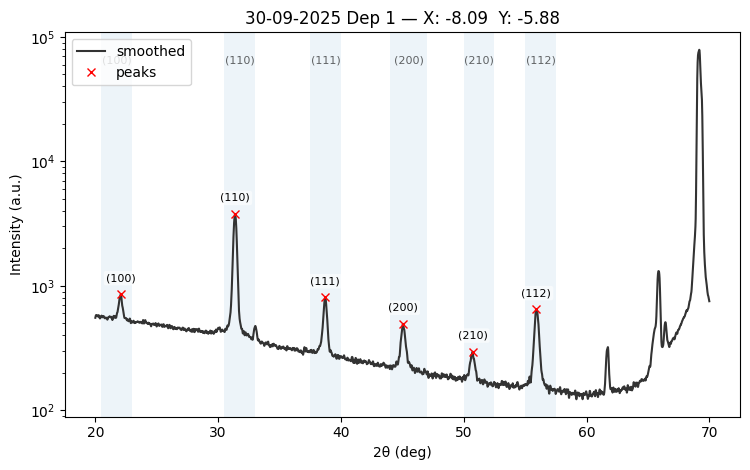


BTO_Mapping_Theta2Theta_30-09-2025_001_39_-16-180_-11-756.xy  peaks: 6
  (100)    [R1]   22.070°   I≈842.5   FWHM≈1.1172°   Area≈148.99
  (110)    [R2]   31.390°   I≈3924.3   FWHM≈1.7693°   Area≈1234.85
  (111)    [R3]   38.740°   I≈771.5   FWHM≈1.4420°   Area≈206.30
  (200)    [R4]   45.080°   I≈499.8   FWHM≈2.1038°   Area≈139.47
  (210)    [R5]   50.710°   I≈288.8   FWHM≈1.8310°   Area≈70.48
  (112)    [R6]   55.940°   I≈658.2   FWHM≈1.7505°   Area≈241.47


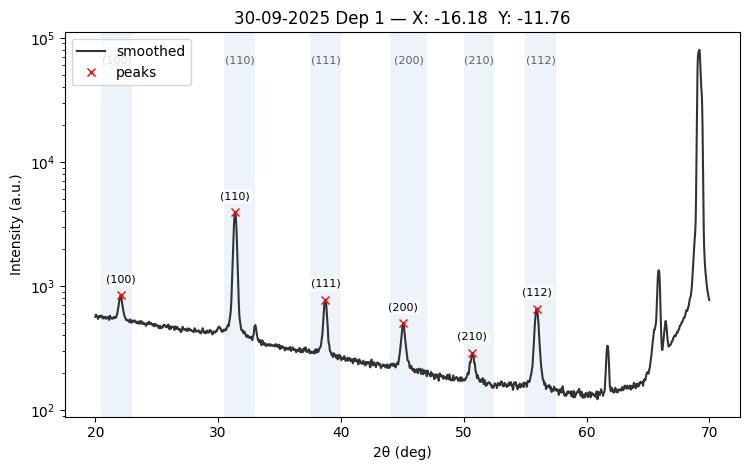


BTO_Mapping_Theta2Theta_30-09-2025_001_40_-24-271_-17-634.xy  peaks: 6
  (100)    [R1]   22.050°   I≈837.0   FWHM≈1.0974°   Area≈130.07
  (110)    [R2]   31.400°   I≈4076.3   FWHM≈1.7562°   Area≈1296.10
  (111)    [R3]   38.770°   I≈747.7   FWHM≈1.4321°   Area≈198.36
  (200)    [R4]   45.060°   I≈492.7   FWHM≈2.0968°   Area≈132.38
  (210)    [R5]   50.700°   I≈299.1   FWHM≈1.8290°   Area≈63.41
  (112)    [R6]   55.930°   I≈660.1   FWHM≈1.7416°   Area≈246.64


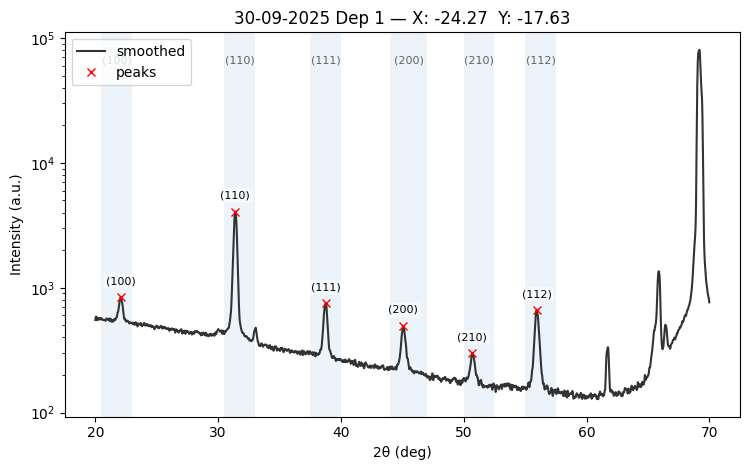


BTO_Mapping_Theta2Theta_30-09-2025_001_41_-32-361_-23-511.xy  peaks: 6
  (100)    [R1]   22.070°   I≈817.5   FWHM≈1.0905°   Area≈150.13
  (110)    [R2]   31.420°   I≈4265.0   FWHM≈1.7418°   Area≈1358.82
  (111)    [R3]   38.750°   I≈781.5   FWHM≈1.3992°   Area≈200.17
  (200)    [R4]   45.150°   I≈455.2   FWHM≈2.0992°   Area≈131.21
  (210)    [R5]   50.760°   I≈284.1   FWHM≈1.7422°   Area≈70.11
  (112)    [R6]   55.990°   I≈655.3   FWHM≈1.7173°   Area≈241.41


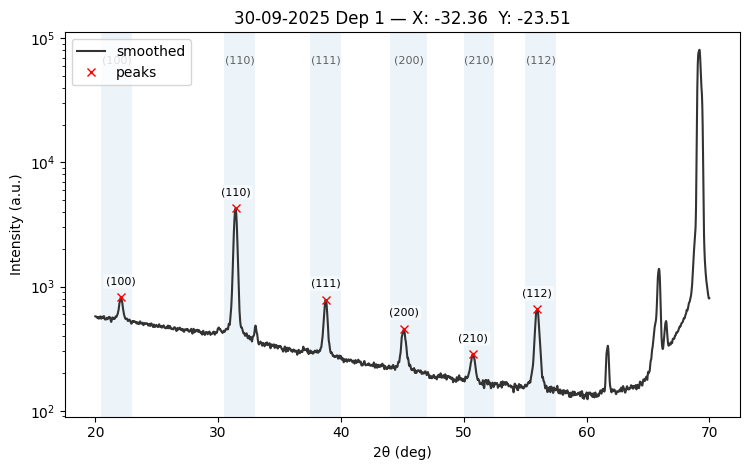


BTO_Mapping_Theta2Theta_30-09-2025_001_42_-5-000_-8-660.xy  peaks: 6
  (100)    [R1]   22.030°   I≈874.1   FWHM≈1.1268°   Area≈173.37
  (110)    [R2]   31.370°   I≈3844.9   FWHM≈1.7834°   Area≈1205.39
  (111)    [R3]   38.700°   I≈741.8   FWHM≈1.4479°   Area≈189.15
  (200)    [R4]   45.070°   I≈528.2   FWHM≈2.1223°   Area≈163.95
  (210)    [R5]   50.650°   I≈293.2   FWHM≈1.8135°   Area≈71.38
  (112)    [R6]   55.920°   I≈649.8   FWHM≈1.7749°   Area≈241.61


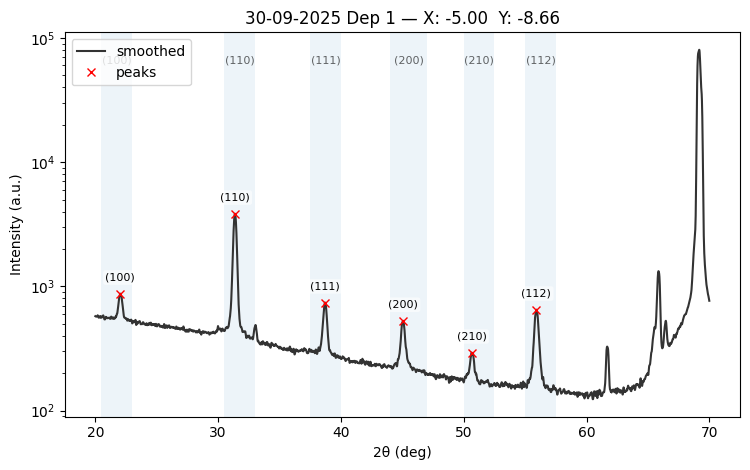


BTO_Mapping_Theta2Theta_30-09-2025_001_43_-10-000_-17-321.xy  peaks: 6
  (100)    [R1]   22.030°   I≈905.0   FWHM≈1.1259°   Area≈162.15
  (110)    [R2]   31.360°   I≈4020.3   FWHM≈1.7903°   Area≈1268.25
  (111)    [R3]   38.670°   I≈681.6   FWHM≈1.4621°   Area≈181.38
  (200)    [R4]   45.010°   I≈558.5   FWHM≈2.1610°   Area≈168.74
  (210)    [R5]   50.690°   I≈307.9   FWHM≈1.9455°   Area≈65.68
  (112)    [R6]   55.900°   I≈649.9   FWHM≈1.7932°   Area≈244.79


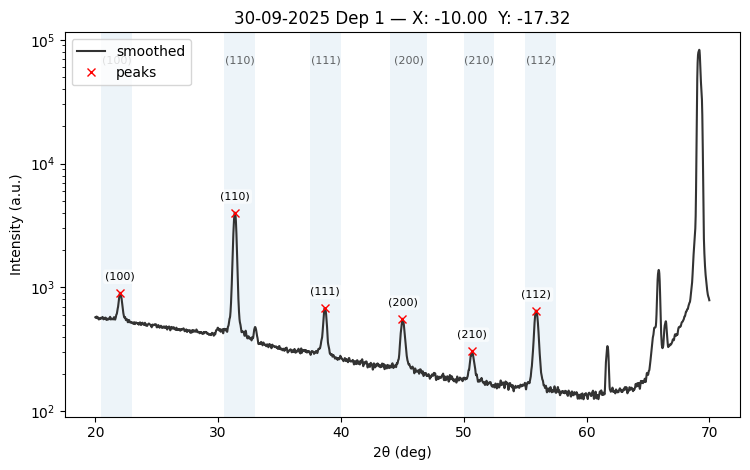


BTO_Mapping_Theta2Theta_30-09-2025_001_44_-15-000_-25-981.xy  peaks: 6
  (100)    [R1]   22.000°   I≈921.3   FWHM≈1.1387°   Area≈169.99
  (110)    [R2]   31.360°   I≈4164.8   FWHM≈1.7970°   Area≈1299.38
  (111)    [R3]   38.710°   I≈622.0   FWHM≈1.4688°   Area≈132.96
  (200)    [R4]   45.020°   I≈558.8   FWHM≈2.1819°   Area≈183.35
  (210)    [R5]   50.660°   I≈295.4   FWHM≈1.9194°   Area≈68.67
  (112)    [R6]   55.900°   I≈669.8   FWHM≈1.8079°   Area≈247.97


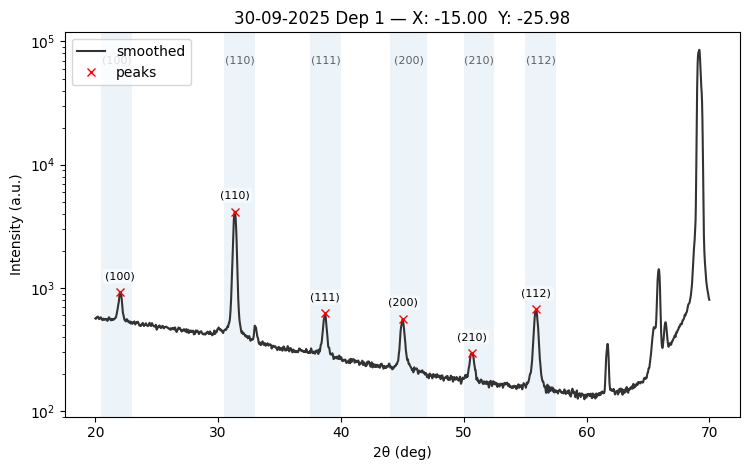


BTO_Mapping_Theta2Theta_30-09-2025_001_45_-20-000_-34-641.xy  peaks: 6
  (100)    [R1]   22.030°   I≈924.2   FWHM≈1.1504°   Area≈153.73
  (110)    [R2]   31.350°   I≈4255.2   FWHM≈1.8059°   Area≈1331.33
  (111)    [R3]   38.680°   I≈560.8   FWHM≈1.4908°   Area≈149.03
  (200)    [R4]   44.990°   I≈565.8   FWHM≈2.1941°   Area≈194.23
  (210)    [R5]   50.630°   I≈308.6   FWHM≈1.9633°   Area≈75.57
  (112)    [R6]   55.890°   I≈660.7   FWHM≈1.8294°   Area≈242.50


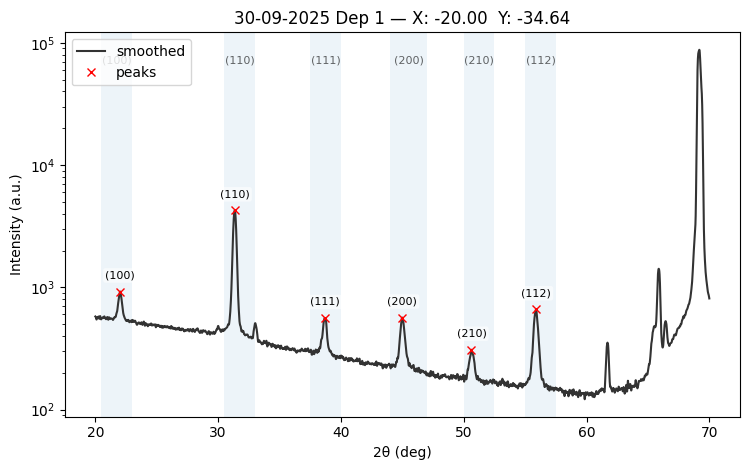


BTO_Mapping_Theta2Theta_30-09-2025_001_46_-1-045_-9-945.xy  peaks: 6
  (100)    [R1]   22.030°   I≈912.1   FWHM≈1.1175°   Area≈145.66
  (110)    [R2]   31.370°   I≈3920.3   FWHM≈1.7907°   Area≈1213.78
  (111)    [R3]   38.670°   I≈705.0   FWHM≈1.4788°   Area≈180.89
  (200)    [R4]   45.030°   I≈553.6   FWHM≈2.1433°   Area≈171.01
  (210)    [R5]   50.660°   I≈297.5   FWHM≈1.9004°   Area≈63.05
  (112)    [R6]   55.930°   I≈660.7   FWHM≈1.7889°   Area≈248.13


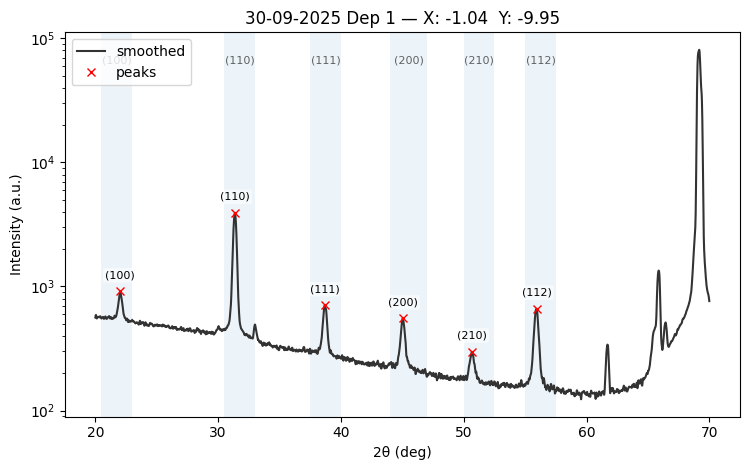


BTO_Mapping_Theta2Theta_30-09-2025_001_47_-2-091_-19-890.xy  peaks: 6
  (100)    [R1]   22.000°   I≈960.9   FWHM≈1.1580°   Area≈165.26
  (110)    [R2]   31.340°   I≈4061.7   FWHM≈1.8183°   Area≈1292.31
  (111)    [R3]   38.670°   I≈613.0   FWHM≈1.5047°   Area≈153.56
  (200)    [R4]   45.000°   I≈591.2   FWHM≈2.2064°   Area≈191.29
  (210)    [R5]   50.590°   I≈306.9   FWHM≈1.9955°   Area≈68.44
  (112)    [R6]   55.850°   I≈638.3   FWHM≈1.8475°   Area≈233.06


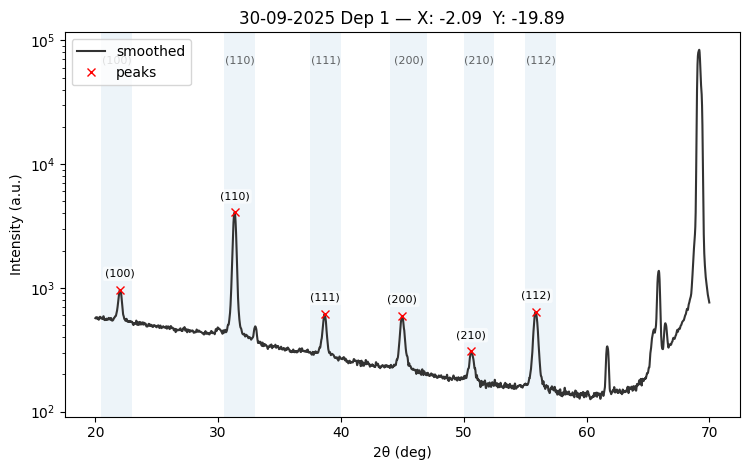


BTO_Mapping_Theta2Theta_30-09-2025_001_48_-3-136_-29-836.xy  peaks: 6
  (100)    [R1]   21.970°   I≈1068.6   FWHM≈1.1936°   Area≈224.90
  (110)    [R2]   31.290°   I≈4083.0   FWHM≈1.8710°   Area≈1314.17
  (111)    [R3]   38.640°   I≈512.4   FWHM≈1.5981°   Area≈122.16
  (200)    [R4]   44.920°   I≈690.2   FWHM≈2.2810°   Area≈227.79
  (210)    [R5]   50.640°   I≈312.5   FWHM≈2.0971°   Area≈71.76
  (112)    [R6]   55.790°   I≈590.2   FWHM≈1.9463°   Area≈216.89


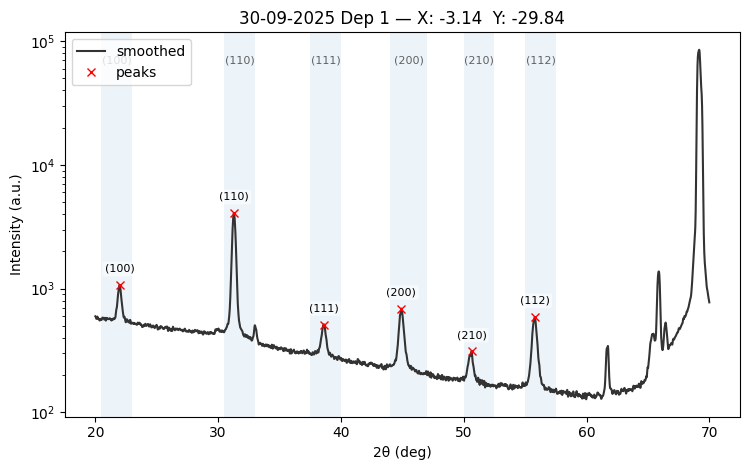


BTO_Mapping_Theta2Theta_30-09-2025_001_49_-4-181_-39-781.xy  peaks: 6
  (100)    [R1]   21.950°   I≈1111.4   FWHM≈1.2166°   Area≈246.71
  (110)    [R2]   31.250°   I≈4053.7   FWHM≈1.9162°   Area≈1340.80
  (111)    [R3]   38.570°   I≈479.5   FWHM≈1.6511°   Area≈103.64
  (200)    [R4]   44.830°   I≈725.1   FWHM≈2.3654°   Area≈292.54
  (210)    [R5]   50.490°   I≈292.5   FWHM≈2.1362°   Area≈66.20
  (112)    [R6]   55.700°   I≈545.2   FWHM≈2.0131°   Area≈208.94


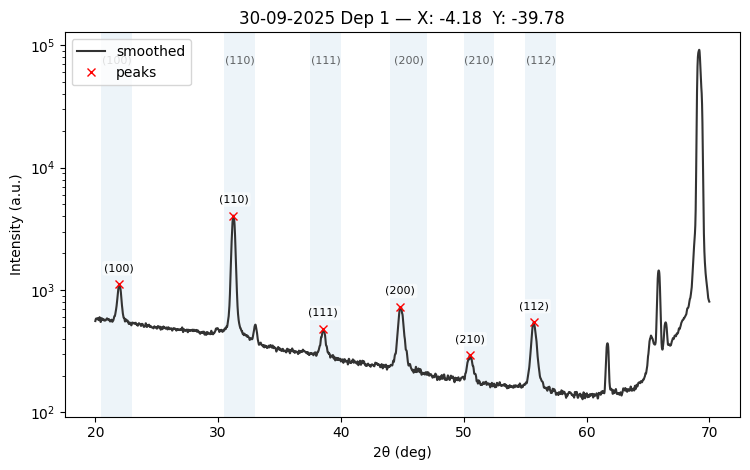


BTO_Mapping_Theta2Theta_30-09-2025_001_50_3-090_-9-511.xy  peaks: 6
  (100)    [R1]   22.010°   I≈914.3   FWHM≈1.1465°   Area≈183.02
  (110)    [R2]   31.360°   I≈3967.9   FWHM≈1.7949°   Area≈1253.29
  (111)    [R3]   38.690°   I≈707.8   FWHM≈1.4650°   Area≈182.59
  (200)    [R4]   45.050°   I≈531.7   FWHM≈2.1542°   Area≈159.24
  (210)    [R5]   50.680°   I≈298.8   FWHM≈1.8969°   Area≈72.66
  (112)    [R6]   55.900°   I≈669.3   FWHM≈1.7913°   Area≈249.38


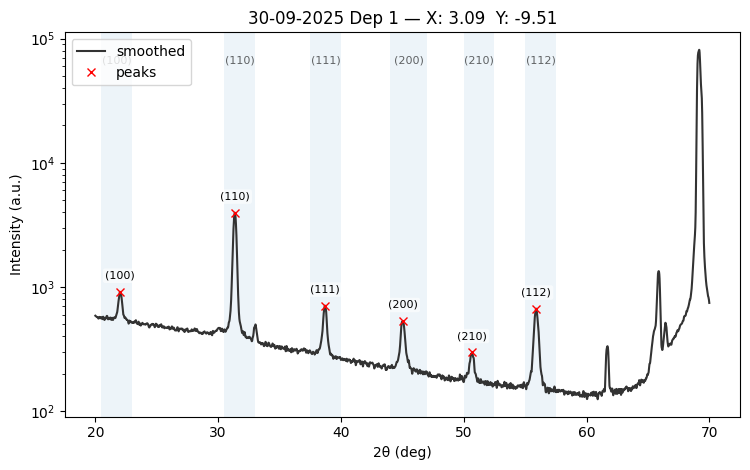


BTO_Mapping_Theta2Theta_30-09-2025_001_51_6-180_-19-021.xy  peaks: 6
  (100)    [R1]   22.010°   I≈989.6   FWHM≈1.1616°   Area≈165.98
  (110)    [R2]   31.320°   I≈4184.3   FWHM≈1.8329°   Area≈1326.16
  (111)    [R3]   38.680°   I≈598.6   FWHM≈1.5221°   Area≈148.97
  (200)    [R4]   44.980°   I≈593.0   FWHM≈2.2428°   Area≈191.56
  (210)    [R5]   50.610°   I≈309.6   FWHM≈2.0162°   Area≈71.85
  (112)    [R6]   55.860°   I≈648.5   FWHM≈1.8606°   Area≈233.90


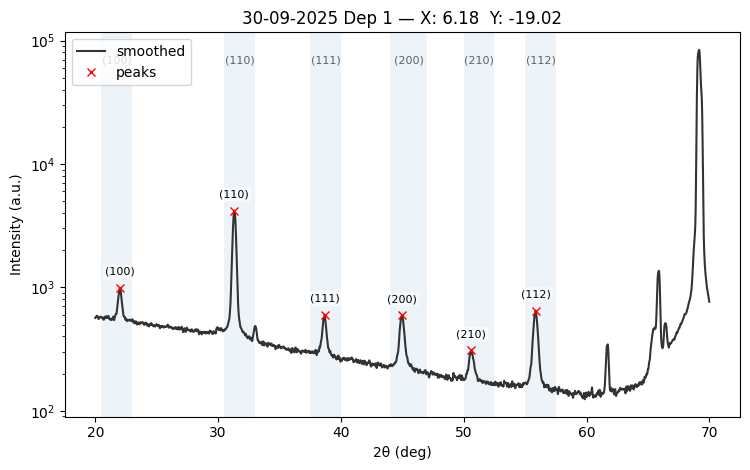


BTO_Mapping_Theta2Theta_30-09-2025_001_52_9-271_-28-532.xy  peaks: 6
  (100)    [R1]   21.960°   I≈1092.0   FWHM≈1.2226°   Area≈259.68
  (110)    [R2]   31.250°   I≈4084.0   FWHM≈1.9071°   Area≈1331.57
  (111)    [R3]   38.570°   I≈498.5   FWHM≈1.6321°   Area≈121.65
  (200)    [R4]   44.860°   I≈718.3   FWHM≈2.3510°   Area≈269.98
  (210)    [R5]   50.590°   I≈294.5   FWHM≈2.0988°   Area≈58.52
  (112)    [R6]   55.720°   I≈556.3   FWHM≈1.9926°   Area≈206.69


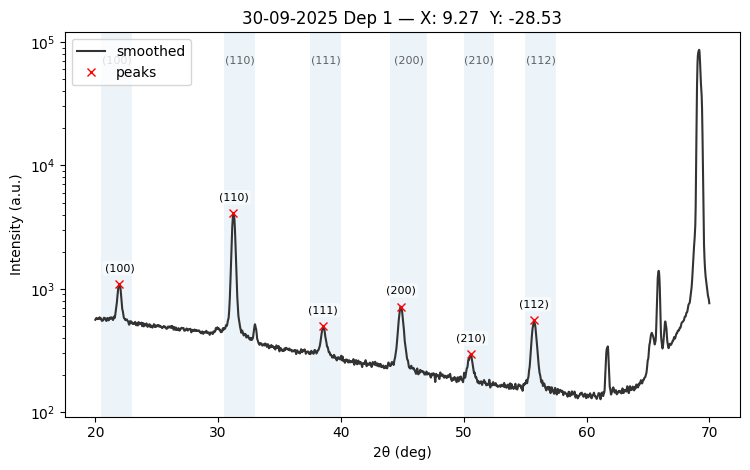


BTO_Mapping_Theta2Theta_30-09-2025_001_53_12-361_-38-042.xy  peaks: 6
  (100)    [R1]   21.920°   I≈1113.1   FWHM≈1.2512°   Area≈255.93
  (110)    [R2]   31.210°   I≈4403.9   FWHM≈1.9501°   Area≈1450.53
  (111)    [R3]   38.520°   I≈476.5   FWHM≈1.6679°   Area≈117.41
  (200)    [R4]   44.830°   I≈728.4   FWHM≈2.4179°   Area≈298.05
  (210)    [R5]   50.500°   I≈304.1   FWHM≈2.2212°   Area≈50.81
  (112)    [R6]   55.680°   I≈533.8   FWHM≈2.0759°   Area≈202.69


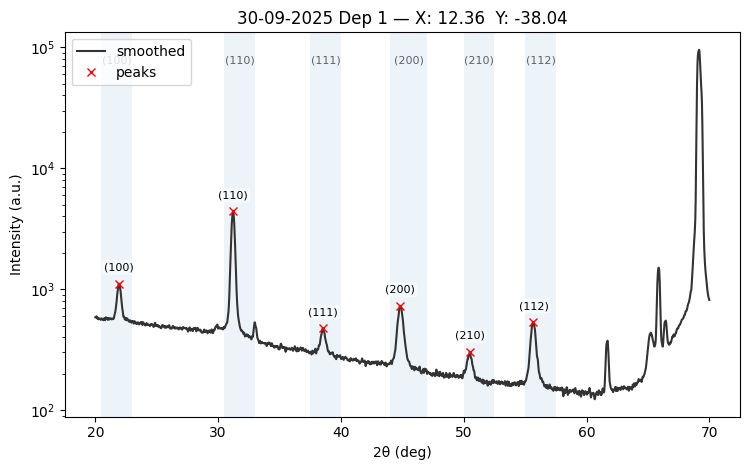


BTO_Mapping_Theta2Theta_30-09-2025_001_54_6-691_-7-431.xy  peaks: 6
  (100)    [R1]   22.050°   I≈899.5   FWHM≈1.1413°   Area≈155.93
  (110)    [R2]   31.360°   I≈3980.8   FWHM≈1.7940°   Area≈1252.71
  (111)    [R3]   38.700°   I≈719.8   FWHM≈1.4668°   Area≈186.36
  (200)    [R4]   45.030°   I≈548.1   FWHM≈2.1386°   Area≈162.02
  (210)    [R5]   50.650°   I≈299.4   FWHM≈1.9037°   Area≈65.61
  (112)    [R6]   55.910°   I≈672.3   FWHM≈1.7890°   Area≈244.13


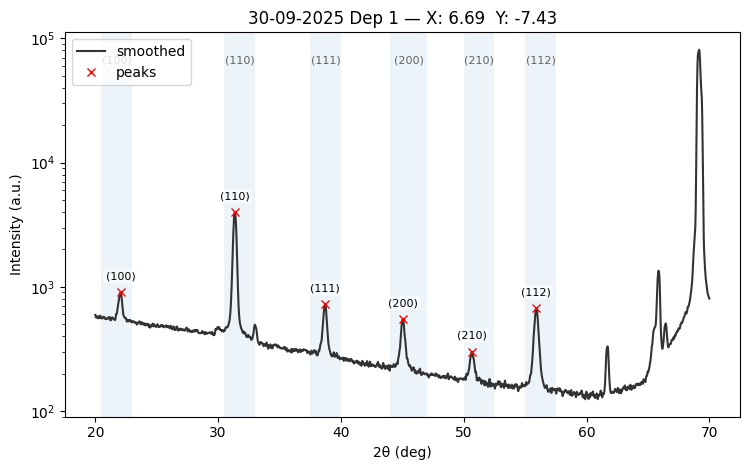


BTO_Mapping_Theta2Theta_30-09-2025_001_55_13-383_-14-863.xy  peaks: 6
  (100)    [R1]   22.000°   I≈935.3   FWHM≈1.1688°   Area≈158.97
  (110)    [R2]   31.330°   I≈4277.6   FWHM≈1.8253°   Area≈1338.14
  (111)    [R3]   38.650°   I≈624.6   FWHM≈1.5082°   Area≈156.69
  (200)    [R4]   44.980°   I≈559.9   FWHM≈2.2100°   Area≈182.24
  (210)    [R5]   50.610°   I≈306.5   FWHM≈2.0065°   Area≈74.34
  (112)    [R6]   55.840°   I≈670.0   FWHM≈1.8443°   Area≈254.41


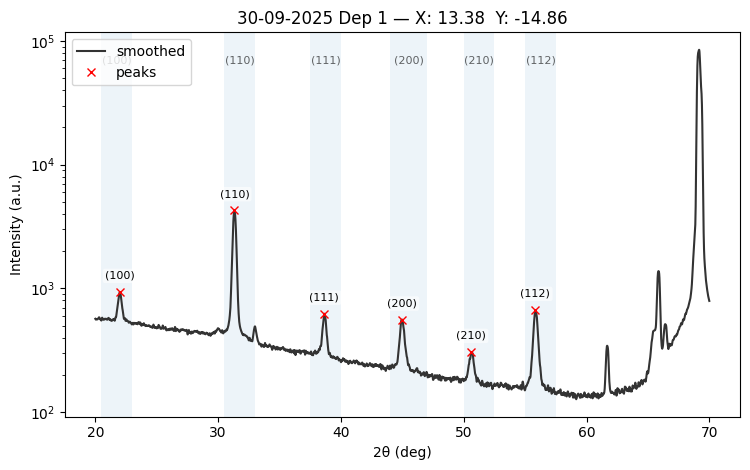


BTO_Mapping_Theta2Theta_30-09-2025_001_56_20-074_-22-294.xy  peaks: 6
  (100)    [R1]   21.960°   I≈1071.1   FWHM≈1.2176°   Area≈222.57
  (110)    [R2]   31.270°   I≈4257.6   FWHM≈1.8885°   Area≈1382.21
  (111)    [R3]   38.590°   I≈514.3   FWHM≈1.5943°   Area≈111.65
  (200)    [R4]   44.920°   I≈678.3   FWHM≈2.2942°   Area≈243.04
  (210)    [R5]   50.510°   I≈297.3   FWHM≈2.0740°   Area≈57.32
  (112)    [R6]   55.780°   I≈593.7   FWHM≈1.9513°   Area≈232.88


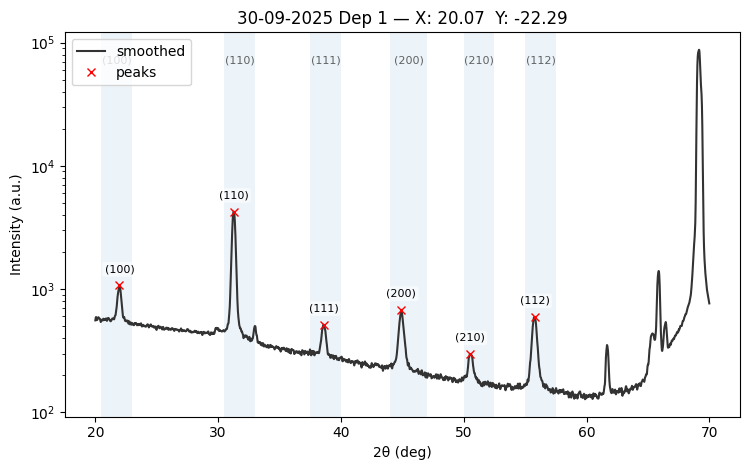


BTO_Mapping_Theta2Theta_30-09-2025_001_57_26-765_-29-726.xy  peaks: 6
  (100)    [R1]   21.940°   I≈1157.3   FWHM≈1.2364°   Area≈254.73
  (110)    [R2]   31.220°   I≈4443.4   FWHM≈1.9422°   Area≈1464.28
  (111)    [R3]   38.560°   I≈476.0   FWHM≈1.6459°   Area≈97.29
  (200)    [R4]   44.860°   I≈745.0   FWHM≈2.3763°   Area≈316.24
  (210)    [R5]   50.440°   I≈300.1   FWHM≈2.1622°   Area≈66.58
  (112)    [R6]   55.710°   I≈541.7   FWHM≈2.0328°   Area≈204.39


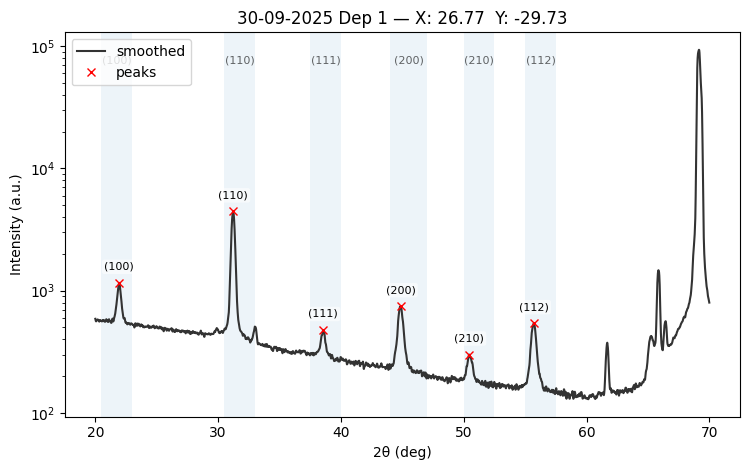


BTO_Mapping_Theta2Theta_30-09-2025_001_58_9-135_-4-067.xy  peaks: 6
  (100)    [R1]   22.060°   I≈891.7   FWHM≈1.1335°   Area≈156.91
  (110)    [R2]   31.370°   I≈3969.6   FWHM≈1.7875°   Area≈1245.58
  (111)    [R3]   38.690°   I≈761.3   FWHM≈1.4643°   Area≈206.05
  (200)    [R4]   45.050°   I≈523.0   FWHM≈2.1355°   Area≈150.91
  (210)    [R5]   50.710°   I≈294.0   FWHM≈1.8722°   Area≈67.28
  (112)    [R6]   55.910°   I≈679.0   FWHM≈1.7776°   Area≈244.12


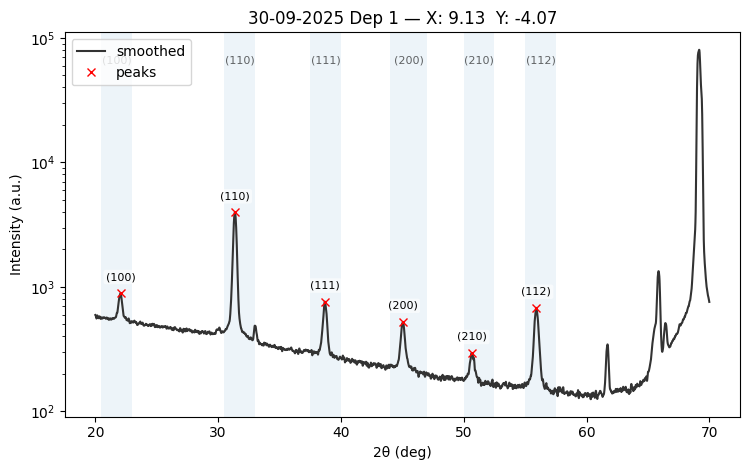


BTO_Mapping_Theta2Theta_30-09-2025_001_59_18-271_-8-135.xy  peaks: 6
  (100)    [R1]   22.000°   I≈877.1   FWHM≈1.1606°   Area≈141.25
  (110)    [R2]   31.350°   I≈4175.9   FWHM≈1.8074°   Area≈1331.38
  (111)    [R3]   38.690°   I≈714.2   FWHM≈1.4719°   Area≈174.21
  (200)    [R4]   45.050°   I≈521.3   FWHM≈2.1801°   Area≈158.18
  (210)    [R5]   50.620°   I≈297.8   FWHM≈1.9185°   Area≈72.21
  (112)    [R6]   55.900°   I≈702.4   FWHM≈1.7915°   Area≈247.99


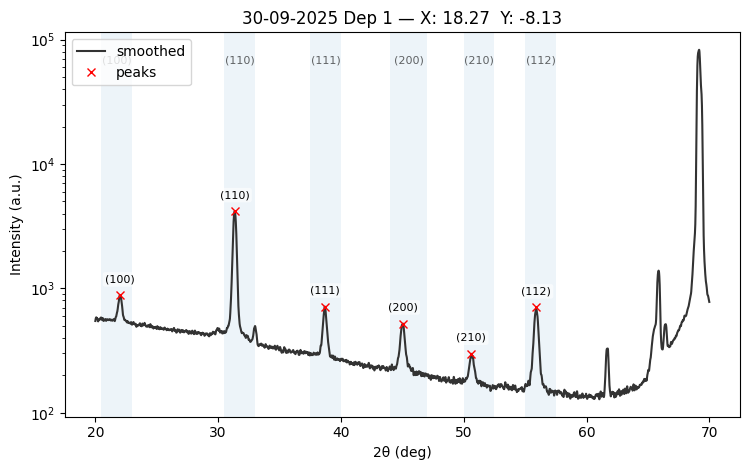


BTO_Mapping_Theta2Theta_30-09-2025_001_60_27-406_-12-202.xy  peaks: 6
  (100)    [R1]   22.010°   I≈888.1   FWHM≈1.1760°   Area≈141.84
  (110)    [R2]   31.330°   I≈4387.2   FWHM≈1.8300°   Area≈1394.14
  (111)    [R3]   38.660°   I≈619.0   FWHM≈1.4994°   Area≈147.40
  (200)    [R4]   44.960°   I≈541.0   FWHM≈2.2143°   Area≈176.23
  (210)    [R5]   50.620°   I≈308.7   FWHM≈1.9812°   Area≈74.27
  (112)    [R6]   55.870°   I≈682.6   FWHM≈1.8423°   Area≈256.58


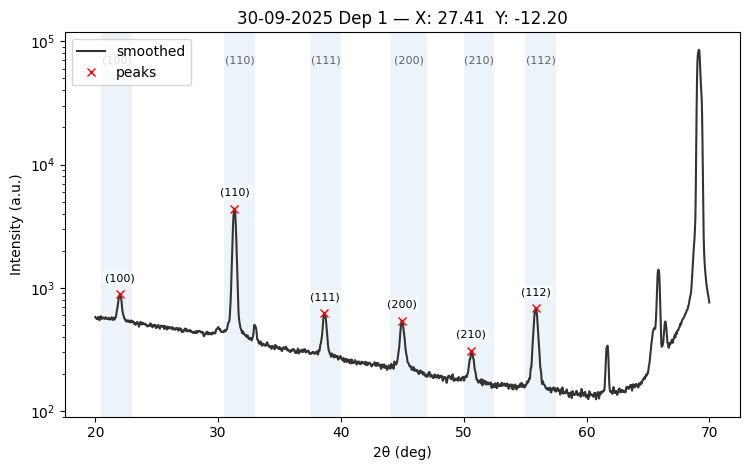


BTO_Mapping_Theta2Theta_30-09-2025_001_61_36-542_-16-269.xy  peaks: 6
  (100)    [R1]   21.980°   I≈920.2   FWHM≈1.1961°   Area≈155.01
  (110)    [R2]   31.300°   I≈4559.9   FWHM≈1.8547°   Area≈1432.02
  (111)    [R3]   38.670°   I≈594.2   FWHM≈1.5143°   Area≈139.38
  (200)    [R4]   44.950°   I≈554.0   FWHM≈2.2440°   Area≈193.33
  (210)    [R5]   50.630°   I≈306.0   FWHM≈2.0395°   Area≈60.36
  (112)    [R6]   55.840°   I≈663.6   FWHM≈1.8817°   Area≈255.20


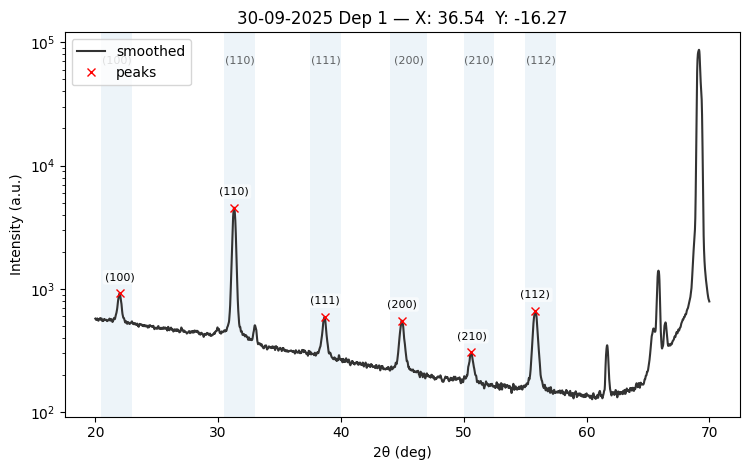


Individual plots for: 22-09-2025 Dep 2

BTO_Mapping_Theta2Theta_22-09-2025_001_01_0-000_0-000.xy  peaks: 6
  (100)    [R1]   22.050°   I≈842.5   FWHM≈1.1508°   Area≈155.36
  (110)    [R2]   31.390°   I≈3482.2   FWHM≈1.7796°   Area≈1243.87
  (111)    [R3]   38.710°   I≈979.0   FWHM≈1.4510°   Area≈307.79
  (200)    [R4]   45.070°   I≈457.9   FWHM≈2.1437°   Area≈172.73
  (210)    [R5]   50.680°   I≈258.8   FWHM≈1.6299°   Area≈70.86
  (112)    [R6]   55.970°   I≈573.5   FWHM≈1.7488°   Area≈231.71


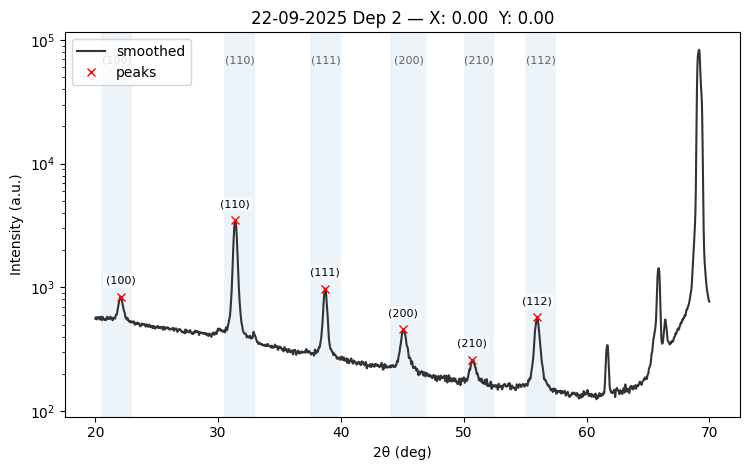


BTO_Mapping_Theta2Theta_22-09-2025_001_02_10-000_0-000.xy  peaks: 6
  (100)    [R1]   22.060°   I≈792.4   FWHM≈1.1165°   Area≈152.86
  (110)    [R2]   31.410°   I≈3406.8   FWHM≈1.7671°   Area≈1191.09
  (111)    [R3]   38.740°   I≈1037.3   FWHM≈1.4317°   Area≈304.82
  (200)    [R4]   45.110°   I≈411.1   FWHM≈2.1135°   Area≈151.77
  (210)    [R5]   50.750°   I≈258.7   FWHM≈1.6224°   Area≈56.59
  (112)    [R6]   55.990°   I≈545.9   FWHM≈1.7296°   Area≈215.61


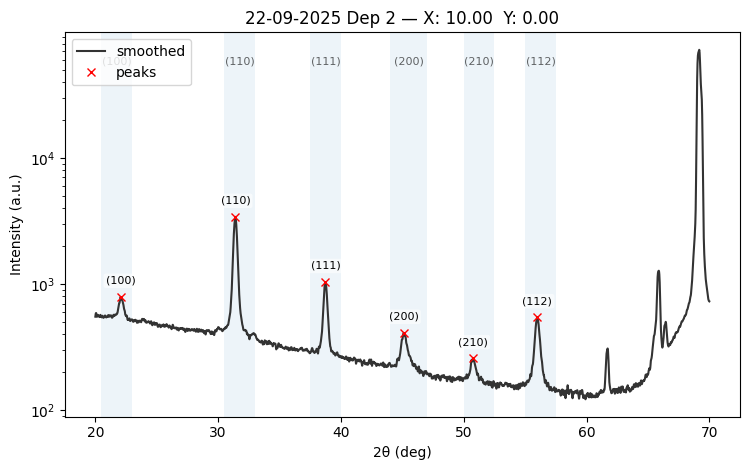


BTO_Mapping_Theta2Theta_22-09-2025_001_03_20-000_0-000.xy  peaks: 6
  (100)    [R1]   22.110°   I≈733.9   FWHM≈1.0675°   Area≈114.18
  (110)    [R2]   31.410°   I≈2908.1   FWHM≈1.7595°   Area≈1018.41
  (111)    [R3]   38.770°   I≈1067.5   FWHM≈1.4103°   Area≈329.21
  (200)    [R4]   45.190°   I≈358.9   FWHM≈1.9543°   Area≈120.97
  (210)    [R5]   50.690°   I≈254.9   FWHM≈1.6017°   Area≈59.19
  (112)    [R6]   56.010°   I≈525.8   FWHM≈1.7101°   Area≈213.23


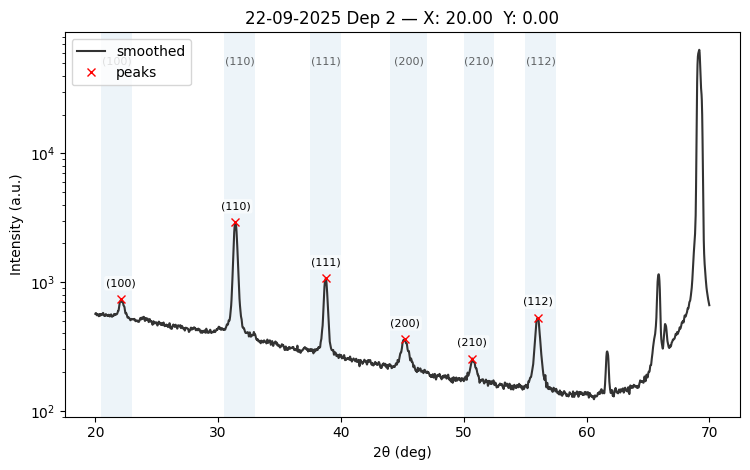


BTO_Mapping_Theta2Theta_22-09-2025_001_04_30-000_0-000.xy  peaks: 6
  (100)    [R1]   22.130°   I≈700.9   FWHM≈1.0524°   Area≈93.38
  (110)    [R2]   31.420°   I≈2350.8   FWHM≈1.7494°   Area≈823.20
  (111)    [R3]   38.760°   I≈1056.1   FWHM≈1.3965°   Area≈335.27
  (200)    [R4]   45.150°   I≈324.7   FWHM≈1.8243°   Area≈97.63
  (210)    [R5]   50.740°   I≈257.3   FWHM≈1.5174°   Area≈50.06
  (112)    [R6]   56.030°   I≈572.4   FWHM≈1.6643°   Area≈230.34


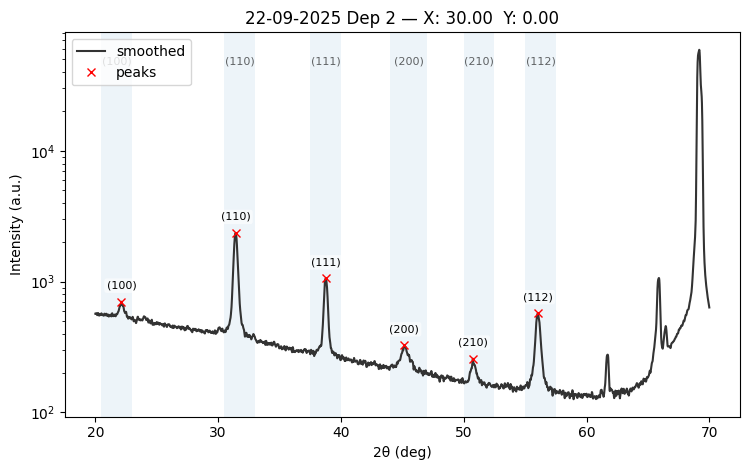


BTO_Mapping_Theta2Theta_22-09-2025_001_05_40-000_0-000.xy  peaks: 6
  (100)    [R1]   22.130°   I≈660.2   FWHM≈1.0637°   Area≈111.58
  (110)    [R2]   31.420°   I≈1985.1   FWHM≈1.7346°   Area≈661.58
  (111)    [R3]   38.780°   I≈1010.6   FWHM≈1.3723°   Area≈290.83
  (200)    [R4]   45.120°   I≈301.6   FWHM≈1.6793°   Area≈79.70
  (210)    [R5]   50.750°   I≈227.9   FWHM≈1.3503°   Area≈44.36
  (112)    [R6]   56.000°   I≈589.5   FWHM≈1.6517°   Area≈251.84


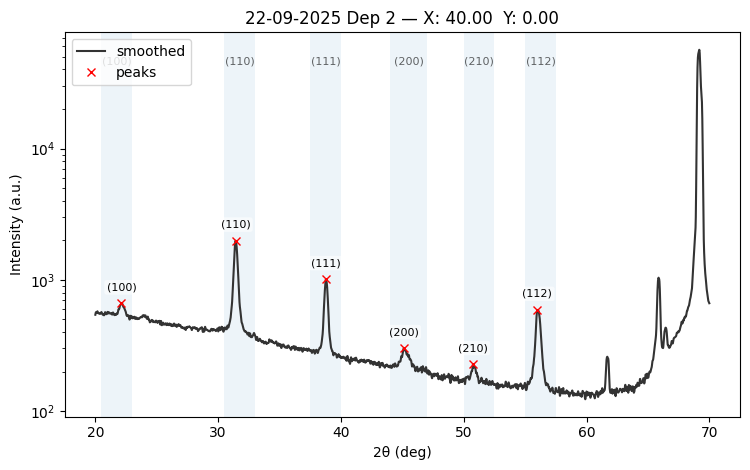


BTO_Mapping_Theta2Theta_22-09-2025_001_06_50-000_0-000.xy  peaks: 0


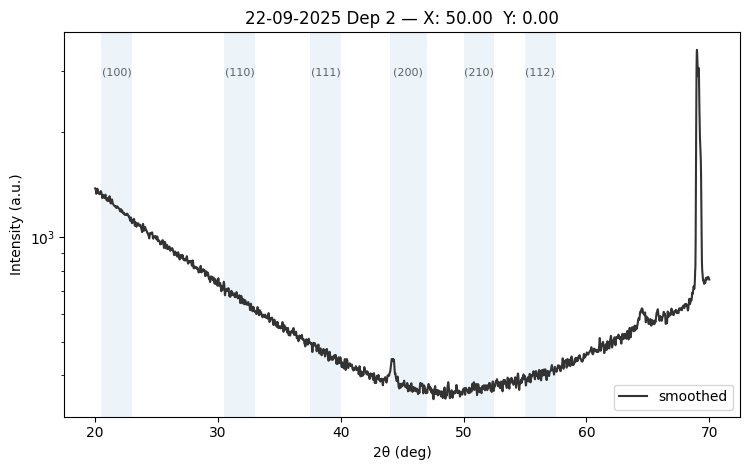


BTO_Mapping_Theta2Theta_22-09-2025_001_07_9-010_4-339.xy  peaks: 6
  (100)    [R1]   22.100°   I≈797.3   FWHM≈1.0985°   Area≈136.85
  (110)    [R2]   31.400°   I≈3407.6   FWHM≈1.7702°   Area≈1202.40
  (111)    [R3]   38.740°   I≈1032.0   FWHM≈1.4332°   Area≈319.25
  (200)    [R4]   45.080°   I≈414.5   FWHM≈2.1189°   Area≈159.36
  (210)    [R5]   50.770°   I≈262.0   FWHM≈1.6383°   Area≈58.52
  (112)    [R6]   55.960°   I≈550.0   FWHM≈1.7207°   Area≈218.66


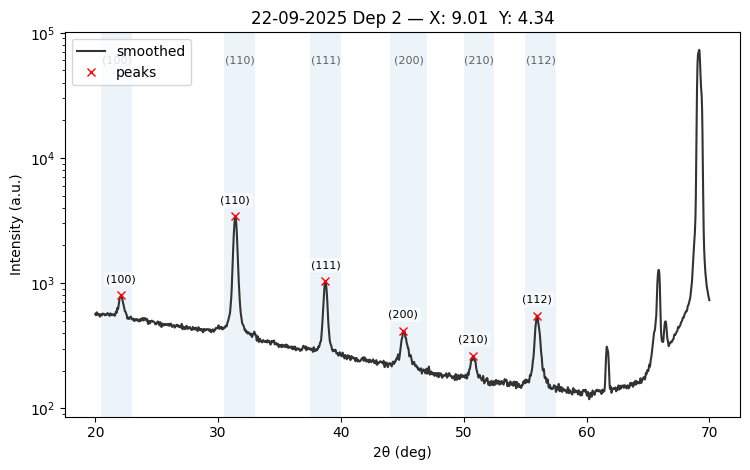


BTO_Mapping_Theta2Theta_22-09-2025_001_08_18-019_8-678.xy  peaks: 6
  (100)    [R1]   22.140°   I≈773.2   FWHM≈1.0634°   Area≈122.01
  (110)    [R2]   31.410°   I≈3048.9   FWHM≈1.7612°   Area≈1053.20
  (111)    [R3]   38.770°   I≈1053.6   FWHM≈1.4106°   Area≈307.23
  (200)    [R4]   45.150°   I≈373.6   FWHM≈2.0394°   Area≈126.66
  (210)    [R5]   50.770°   I≈261.3   FWHM≈1.6340°   Area≈63.09
  (112)    [R6]   56.000°   I≈542.0   FWHM≈1.6914°   Area≈210.46


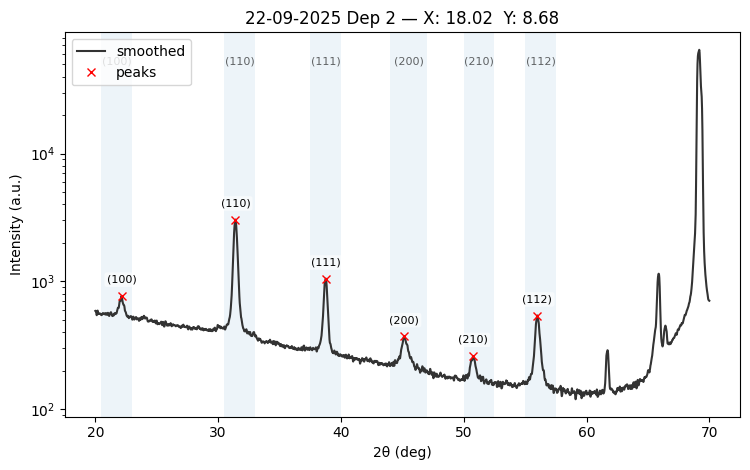


BTO_Mapping_Theta2Theta_22-09-2025_001_09_27-029_13-017.xy  peaks: 6
  (100)    [R1]   22.160°   I≈698.7   FWHM≈1.1004°   Area≈93.81
  (110)    [R2]   31.420°   I≈2427.7   FWHM≈1.7560°   Area≈852.81
  (111)    [R3]   38.770°   I≈1074.6   FWHM≈1.3978°   Area≈336.36
  (200)    [R4]   45.220°   I≈328.9   FWHM≈1.8414°   Area≈114.24
  (210)    [R5]   50.810°   I≈253.4   FWHM≈1.5457°   Area≈51.60
  (112)    [R6]   56.010°   I≈555.1   FWHM≈1.6745°   Area≈219.07


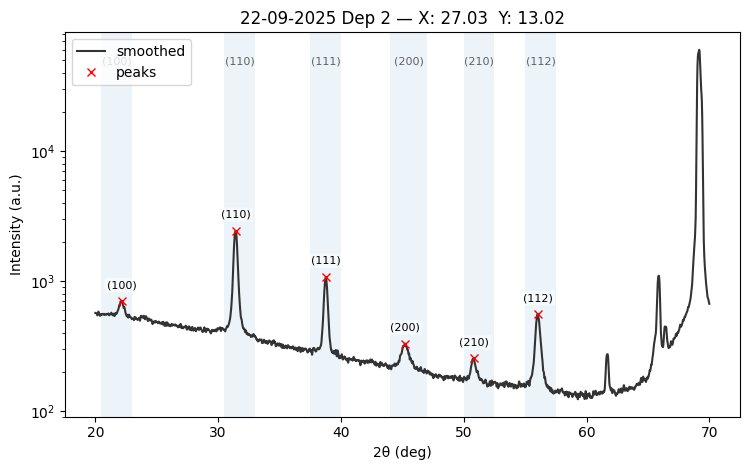


BTO_Mapping_Theta2Theta_22-09-2025_001_10_36-039_17-355.xy  peaks: 6
  (100)    [R1]   22.170°   I≈669.0   FWHM≈1.0706°   Area≈118.34
  (110)    [R2]   31.430°   I≈2001.5   FWHM≈1.7384°   Area≈682.58
  (111)    [R3]   38.760°   I≈1017.8   FWHM≈1.3773°   Area≈293.58
  (200)    [R4]   45.150°   I≈310.9   FWHM≈1.7107°   Area≈89.02
  (210)    [R5]   50.870°   I≈237.3   FWHM≈1.4448°   Area≈46.70
  (112)    [R6]   56.050°   I≈604.8   FWHM≈1.6497°   Area≈242.47


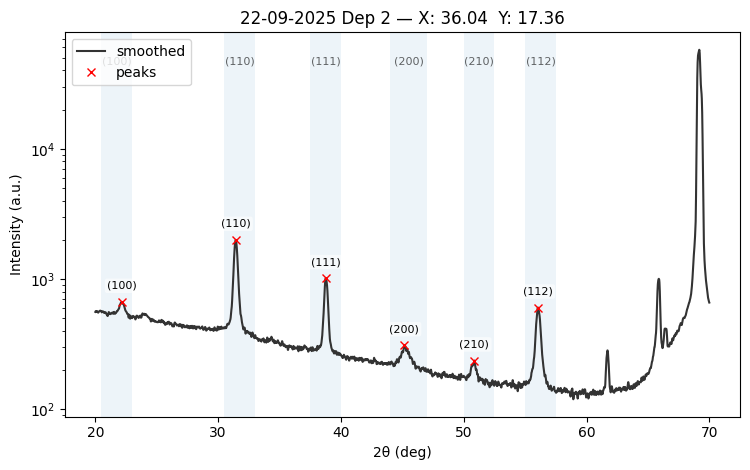


BTO_Mapping_Theta2Theta_22-09-2025_001_11_45-048_21-694.xy  peaks: 0


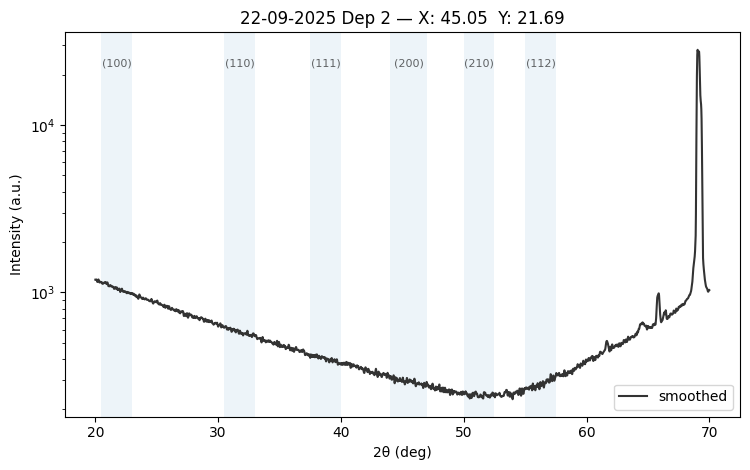


BTO_Mapping_Theta2Theta_22-09-2025_001_12_6-235_7-818.xy  peaks: 6
  (100)    [R1]   22.130°   I≈807.8   FWHM≈1.1155°   Area≈174.77
  (110)    [R2]   31.400°   I≈3433.7   FWHM≈1.7720°   Area≈1198.42
  (111)    [R3]   38.740°   I≈1029.5   FWHM≈1.4376°   Area≈314.86
  (200)    [R4]   45.150°   I≈416.1   FWHM≈2.1588°   Area≈158.90
  (210)    [R5]   50.750°   I≈272.2   FWHM≈1.6838°   Area≈64.06
  (112)    [R6]   55.980°   I≈555.4   FWHM≈1.7320°   Area≈232.26


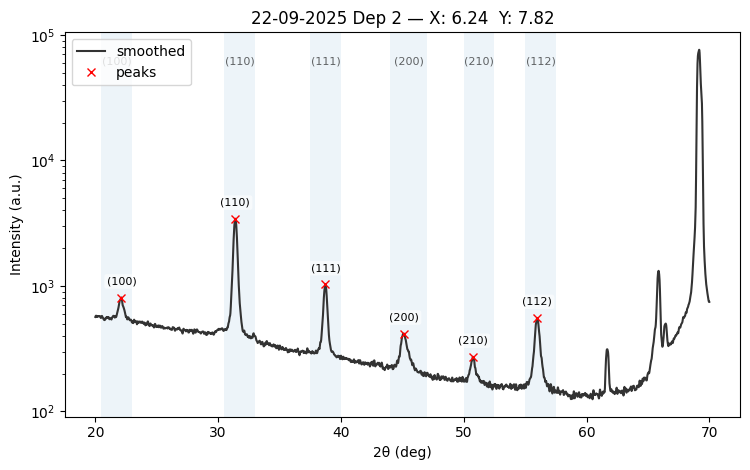


BTO_Mapping_Theta2Theta_22-09-2025_001_13_12-470_15-637.xy  peaks: 6
  (100)    [R1]   22.080°   I≈767.5   FWHM≈1.1193°   Area≈148.45
  (110)    [R2]   31.410°   I≈3258.4   FWHM≈1.7631°   Area≈1140.82
  (111)    [R3]   38.750°   I≈1017.4   FWHM≈1.4261°   Area≈315.95
  (200)    [R4]   45.140°   I≈402.5   FWHM≈2.1133°   Area≈143.98
  (210)    [R5]   50.770°   I≈272.4   FWHM≈1.6389°   Area≈65.60
  (112)    [R6]   55.990°   I≈542.3   FWHM≈1.7279°   Area≈229.40


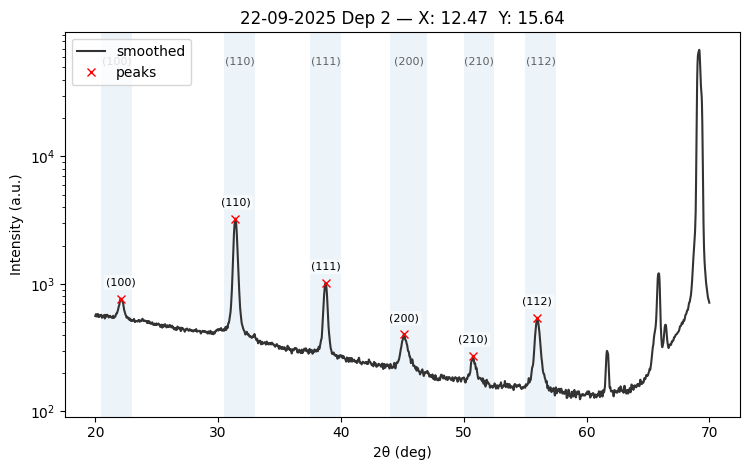


BTO_Mapping_Theta2Theta_22-09-2025_001_14_18-705_23-455.xy  peaks: 6
  (100)    [R1]   22.090°   I≈738.8   FWHM≈1.0771°   Area≈114.23
  (110)    [R2]   31.410°   I≈2874.0   FWHM≈1.7551°   Area≈981.22
  (111)    [R3]   38.750°   I≈1063.4   FWHM≈1.4028°   Area≈322.92
  (200)    [R4]   45.110°   I≈353.2   FWHM≈1.9377°   Area≈134.69
  (210)    [R5]   50.800°   I≈262.9   FWHM≈1.6042°   Area≈49.24
  (112)    [R6]   55.990°   I≈526.6   FWHM≈1.7076°   Area≈209.81


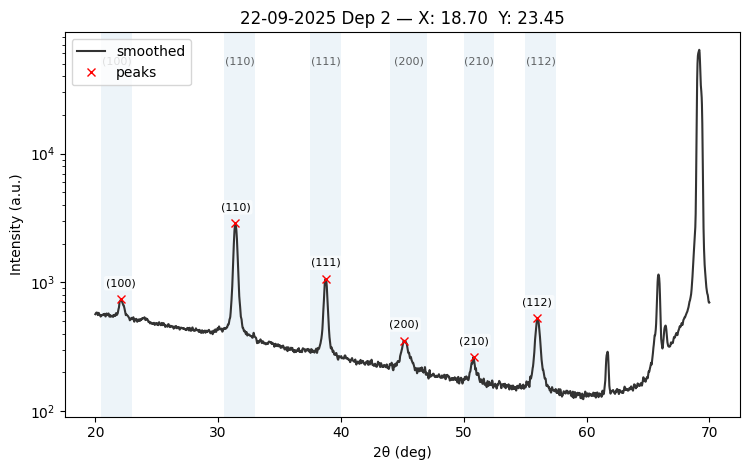


BTO_Mapping_Theta2Theta_22-09-2025_001_15_24-940_31-273.xy  peaks: 6
  (100)    [R1]   22.110°   I≈695.2   FWHM≈1.0680°   Area≈115.59
  (110)    [R2]   31.420°   I≈2325.6   FWHM≈1.7416°   Area≈779.38
  (111)    [R3]   38.780°   I≈1060.6   FWHM≈1.3904°   Area≈312.22
  (200)    [R4]   45.220°   I≈328.5   FWHM≈1.7575°   Area≈100.98
  (210)    [R5]   50.830°   I≈246.6   FWHM≈1.5215°   Area≈64.73
  (112)    [R6]   56.030°   I≈560.0   FWHM≈1.6647°   Area≈219.75


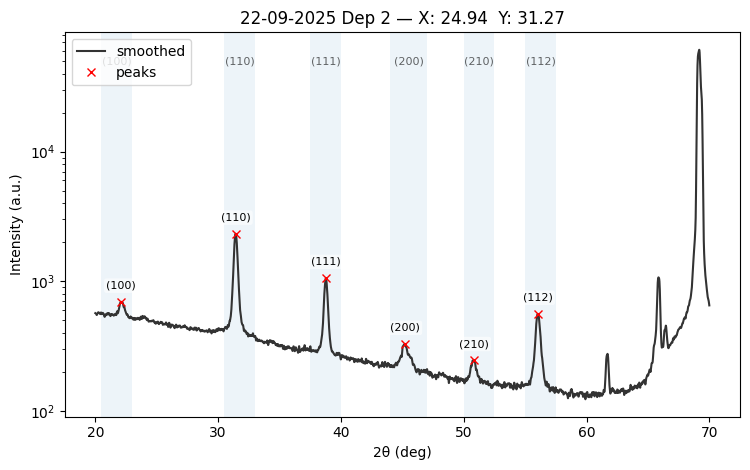


BTO_Mapping_Theta2Theta_22-09-2025_001_16_31-174_39-092.xy  peaks: 1
  (200)    [R4]   44.250°   I≈4568.8   FWHM≈2.8909°   Area≈712.40


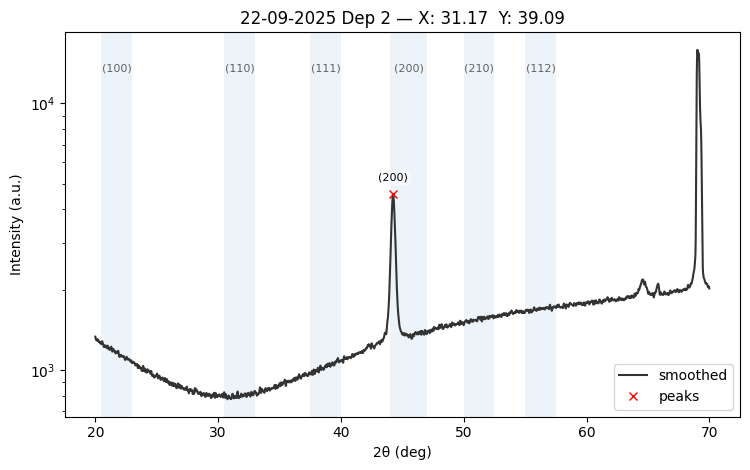


BTO_Mapping_Theta2Theta_22-09-2025_001_17_2-225_9-749.xy  peaks: 6
  (100)    [R1]   22.090°   I≈826.9   FWHM≈1.1249°   Area≈186.59
  (110)    [R2]   31.400°   I≈3475.3   FWHM≈1.7721°   Area≈1234.81
  (111)    [R3]   38.730°   I≈1004.0   FWHM≈1.4468°   Area≈304.93
  (200)    [R4]   45.140°   I≈446.9   FWHM≈2.1284°   Area≈166.24
  (210)    [R5]   50.810°   I≈265.1   FWHM≈1.6939°   Area≈59.17
  (112)    [R6]   55.980°   I≈565.6   FWHM≈1.7369°   Area≈231.81


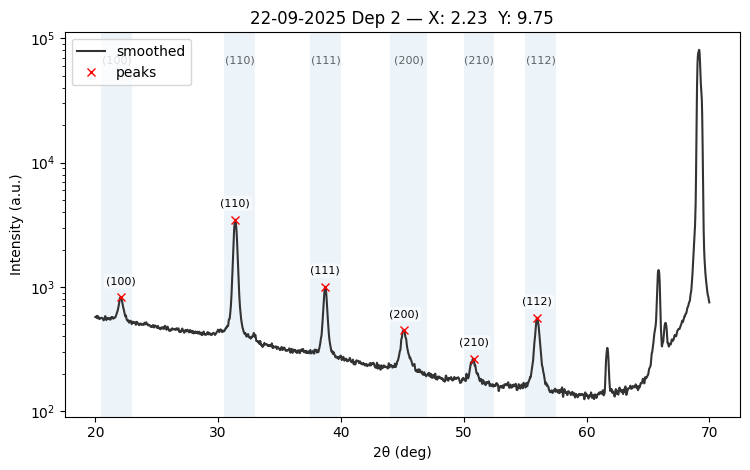


BTO_Mapping_Theta2Theta_22-09-2025_001_18_4-450_19-499.xy  peaks: 6
  (100)    [R1]   22.150°   I≈809.3   FWHM≈1.1138°   Area≈152.58
  (110)    [R2]   31.400°   I≈3447.4   FWHM≈1.7665°   Area≈1208.69
  (111)    [R3]   38.740°   I≈998.2   FWHM≈1.4363°   Area≈300.81
  (200)    [R4]   45.100°   I≈429.6   FWHM≈2.1279°   Area≈172.33
  (210)    [R5]   50.850°   I≈261.7   FWHM≈1.6248°   Area≈63.58
  (112)    [R6]   55.970°   I≈555.7   FWHM≈1.7359°   Area≈233.51


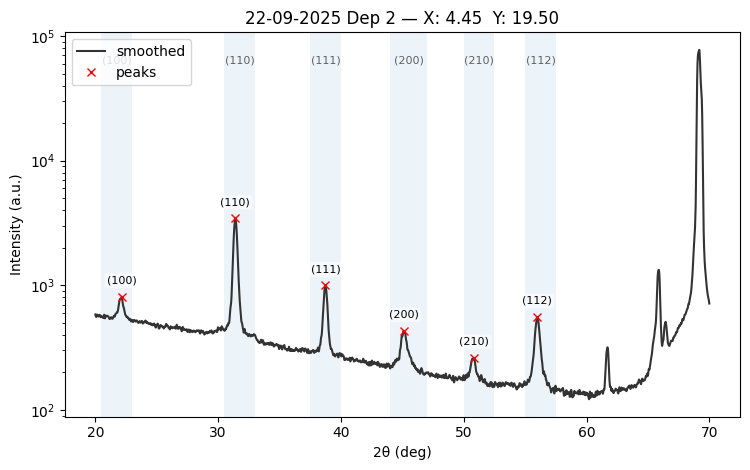


BTO_Mapping_Theta2Theta_22-09-2025_001_19_6-676_29-248.xy  peaks: 6
  (100)    [R1]   22.040°   I≈774.7   FWHM≈1.1450°   Area≈169.46
  (110)    [R2]   31.400°   I≈3335.7   FWHM≈1.7627°   Area≈1172.25
  (111)    [R3]   38.750°   I≈990.4   FWHM≈1.4272°   Area≈305.88
  (200)    [R4]   45.080°   I≈403.6   FWHM≈2.1084°   Area≈149.97
  (210)    [R5]   50.770°   I≈274.1   FWHM≈1.6286°   Area≈74.33
  (112)    [R6]   55.980°   I≈537.0   FWHM≈1.7288°   Area≈222.70


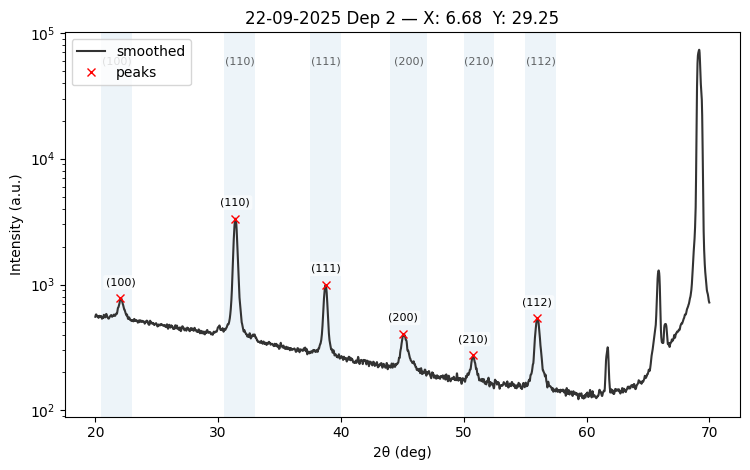


BTO_Mapping_Theta2Theta_22-09-2025_001_20_8-901_38-997.xy  peaks: 6
  (100)    [R1]   22.090°   I≈764.8   FWHM≈1.1033°   Area≈155.09
  (110)    [R2]   31.420°   I≈3129.7   FWHM≈1.7504°   Area≈1117.31
  (111)    [R3]   38.780°   I≈1022.2   FWHM≈1.4056°   Area≈309.82
  (200)    [R4]   45.130°   I≈385.7   FWHM≈2.0539°   Area≈147.24
  (210)    [R5]   50.750°   I≈271.9   FWHM≈1.6353°   Area≈60.39
  (112)    [R6]   56.030°   I≈540.1   FWHM≈1.6960°   Area≈211.40


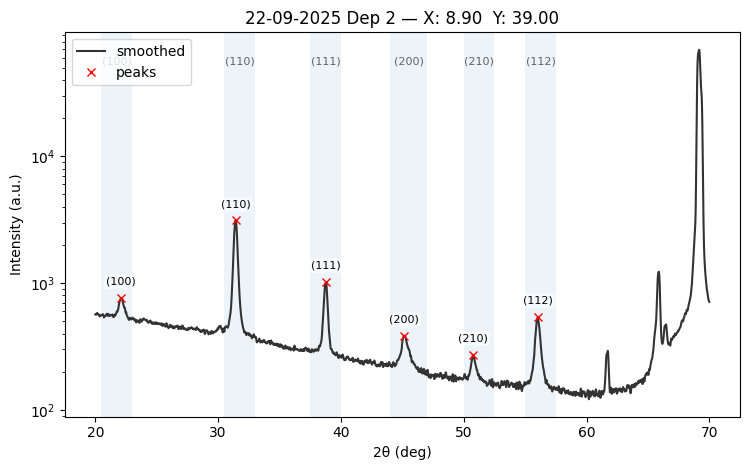


BTO_Mapping_Theta2Theta_22-09-2025_001_21_11-126_48-746.xy  peaks: 1
  (200)    [R4]   44.250°   I≈8802.1   FWHM≈2.8946°   Area≈1344.08


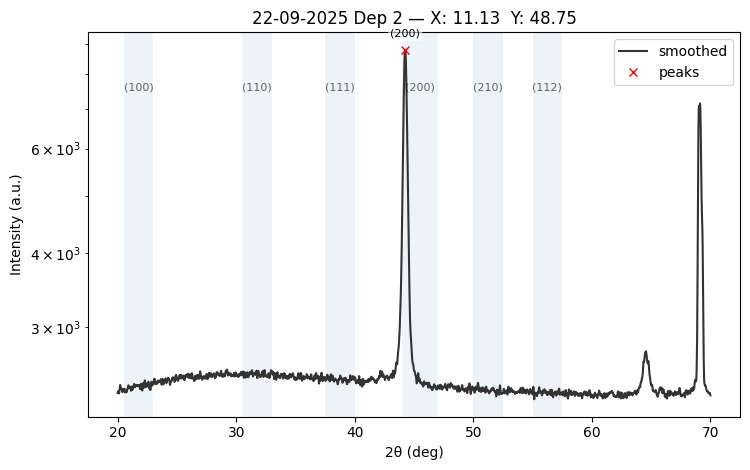


BTO_Mapping_Theta2Theta_22-09-2025_001_22_-2-225_9-749.xy  peaks: 6
  (100)    [R1]   22.060°   I≈857.2   FWHM≈1.1230°   Area≈173.23
  (110)    [R2]   31.400°   I≈3472.3   FWHM≈1.7751°   Area≈1233.41
  (111)    [R3]   38.720°   I≈948.8   FWHM≈1.4521°   Area≈304.38
  (200)    [R4]   45.090°   I≈483.6   FWHM≈2.1492°   Area≈182.16
  (210)    [R5]   50.810°   I≈262.7   FWHM≈1.7400°   Area≈54.55
  (112)    [R6]   55.950°   I≈575.0   FWHM≈1.7615°   Area≈253.92


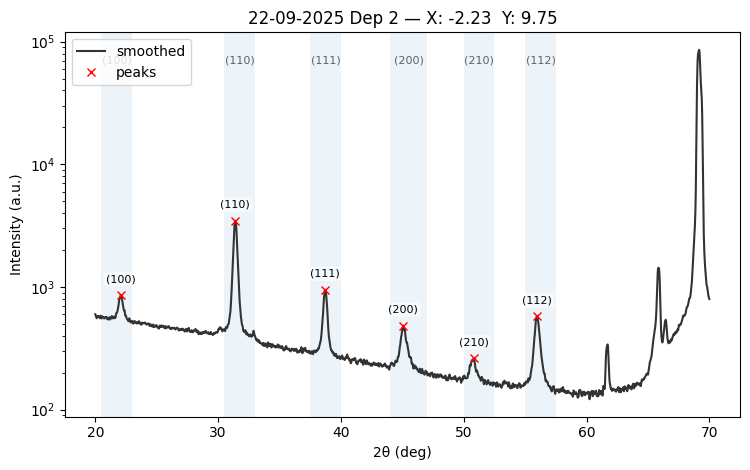


BTO_Mapping_Theta2Theta_22-09-2025_001_23_-4-450_19-499.xy  peaks: 6
  (100)    [R1]   22.060°   I≈858.8   FWHM≈1.1131°   Area≈154.92
  (110)    [R2]   31.400°   I≈3459.3   FWHM≈1.7717°   Area≈1227.83
  (111)    [R3]   38.720°   I≈976.6   FWHM≈1.4557°   Area≈302.21
  (200)    [R4]   45.120°   I≈458.8   FWHM≈2.1652°   Area≈173.53
  (210)    [R5]   50.780°   I≈271.2   FWHM≈1.6841°   Area≈68.00
  (112)    [R6]   55.960°   I≈579.9   FWHM≈1.7522°   Area≈247.87


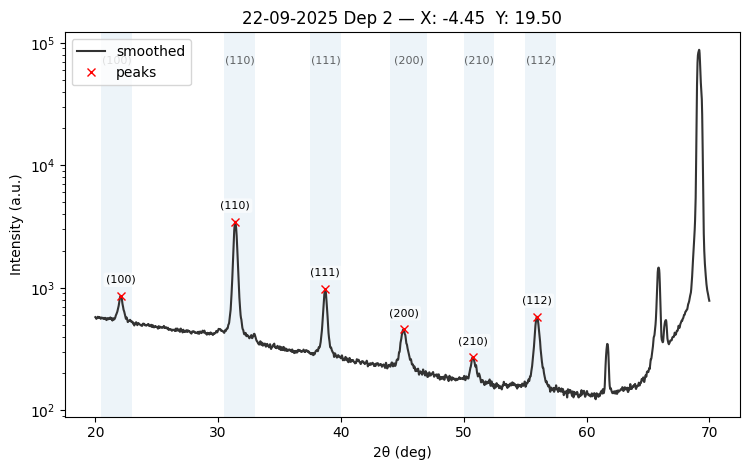


BTO_Mapping_Theta2Theta_22-09-2025_001_24_-6-676_29-248.xy  peaks: 6
  (100)    [R1]   22.040°   I≈843.4   FWHM≈1.1055°   Area≈152.01
  (110)    [R2]   31.410°   I≈3400.2   FWHM≈1.7645°   Area≈1204.87
  (111)    [R3]   38.730°   I≈940.4   FWHM≈1.4586°   Area≈289.55
  (200)    [R4]   45.100°   I≈458.0   FWHM≈2.1679°   Area≈167.82
  (210)    [R5]   50.750°   I≈270.2   FWHM≈1.7125°   Area≈69.49
  (112)    [R6]   56.010°   I≈573.8   FWHM≈1.7397°   Area≈252.55


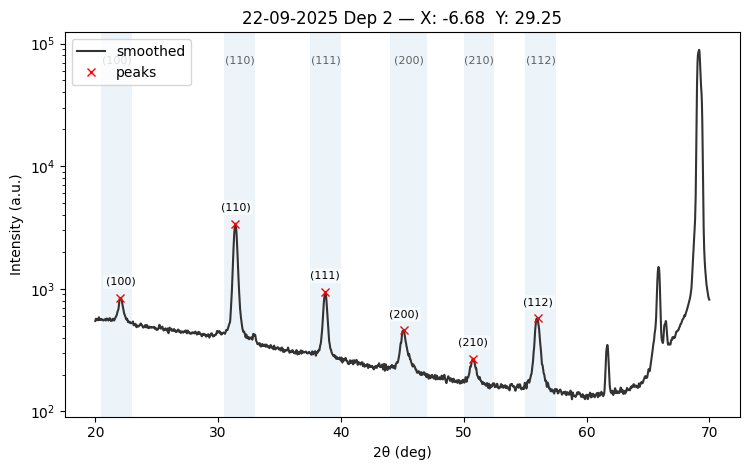


BTO_Mapping_Theta2Theta_22-09-2025_001_25_-8-901_38-997.xy  peaks: 6
  (100)    [R1]   22.100°   I≈826.6   FWHM≈1.1176°   Area≈144.51
  (110)    [R2]   31.410°   I≈3378.4   FWHM≈1.7564°   Area≈1210.92
  (111)    [R3]   38.740°   I≈918.5   FWHM≈1.4356°   Area≈288.30
  (200)    [R4]   45.060°   I≈453.1   FWHM≈2.1330°   Area≈179.68
  (210)    [R5]   50.810°   I≈279.2   FWHM≈1.7323°   Area≈76.11
  (112)    [R6]   56.040°   I≈567.2   FWHM≈1.7362°   Area≈245.74


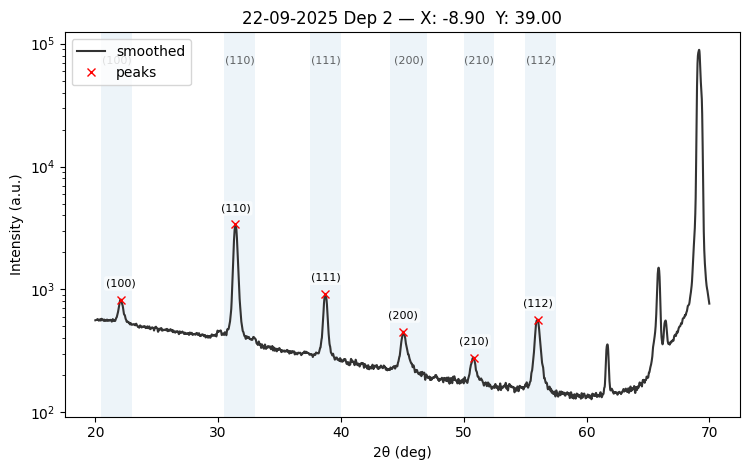


BTO_Mapping_Theta2Theta_22-09-2025_001_26_-11-126_48-746.xy  peaks: 1
  (200)    [R4]   44.250°   I≈3496.4   FWHM≈2.8901°   Area≈544.83


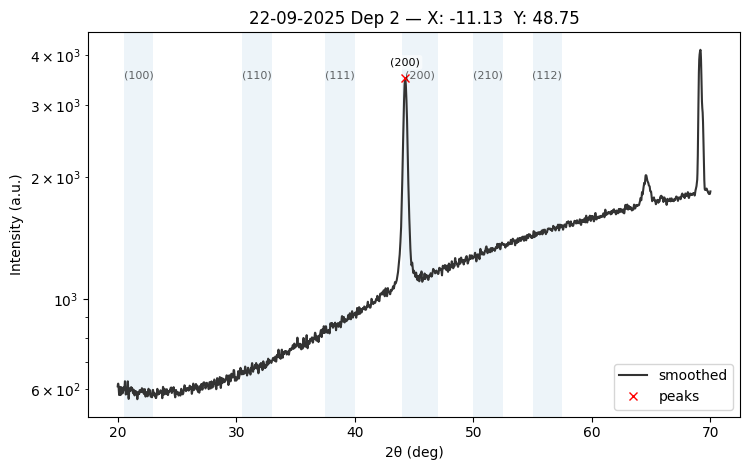


BTO_Mapping_Theta2Theta_22-09-2025_001_27_-6-235_7-818.xy  peaks: 6
  (100)    [R1]   22.050°   I≈878.7   FWHM≈1.1333°   Area≈177.45
  (110)    [R2]   31.390°   I≈3432.7   FWHM≈1.7800°   Area≈1217.79
  (111)    [R3]   38.690°   I≈912.2   FWHM≈1.4695°   Area≈306.69
  (200)    [R4]   45.040°   I≈480.6   FWHM≈2.1839°   Area≈197.69
  (210)    [R5]   50.780°   I≈277.4   FWHM≈1.7162°   Area≈72.52
  (112)    [R6]   55.970°   I≈582.6   FWHM≈1.7840°   Area≈262.14


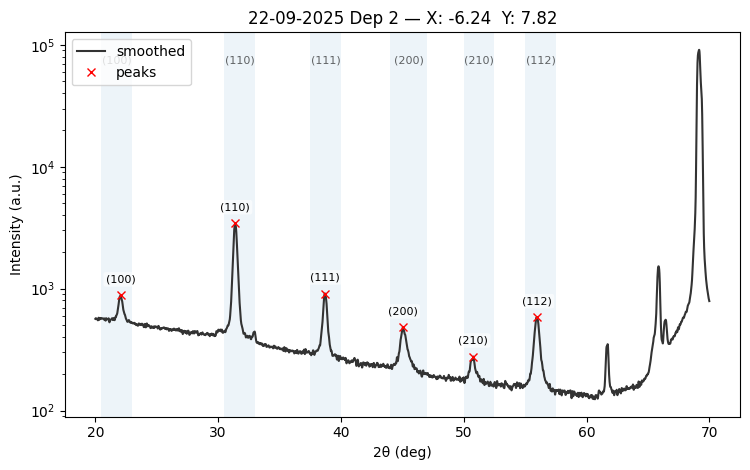


BTO_Mapping_Theta2Theta_22-09-2025_001_28_-12-470_15-637.xy  peaks: 6
  (100)    [R1]   22.030°   I≈880.1   FWHM≈1.1603°   Area≈207.15
  (110)    [R2]   31.390°   I≈3351.7   FWHM≈1.7810°   Area≈1178.16
  (111)    [R3]   38.690°   I≈869.0   FWHM≈1.4866°   Area≈279.53
  (200)    [R4]   45.020°   I≈507.9   FWHM≈2.1998°   Area≈193.09
  (210)    [R5]   50.690°   I≈279.5   FWHM≈1.7337°   Area≈85.83
  (112)    [R6]   55.960°   I≈583.6   FWHM≈1.7864°   Area≈263.21


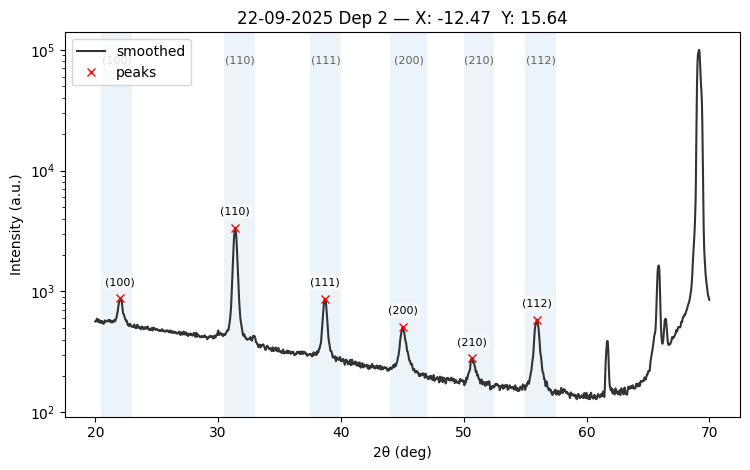


BTO_Mapping_Theta2Theta_22-09-2025_001_29_-18-705_23-455.xy  peaks: 6
  (100)    [R1]   22.030°   I≈888.3   FWHM≈1.1533°   Area≈177.81
  (110)    [R2]   31.390°   I≈3599.6   FWHM≈1.7786°   Area≈1271.64
  (111)    [R3]   38.690°   I≈825.8   FWHM≈1.4908°   Area≈250.99
  (200)    [R4]   45.000°   I≈514.1   FWHM≈2.2049°   Area≈208.79
  (210)    [R5]   50.690°   I≈275.1   FWHM≈1.8383°   Area≈72.00
  (112)    [R6]   55.970°   I≈576.7   FWHM≈1.8017°   Area≈255.19


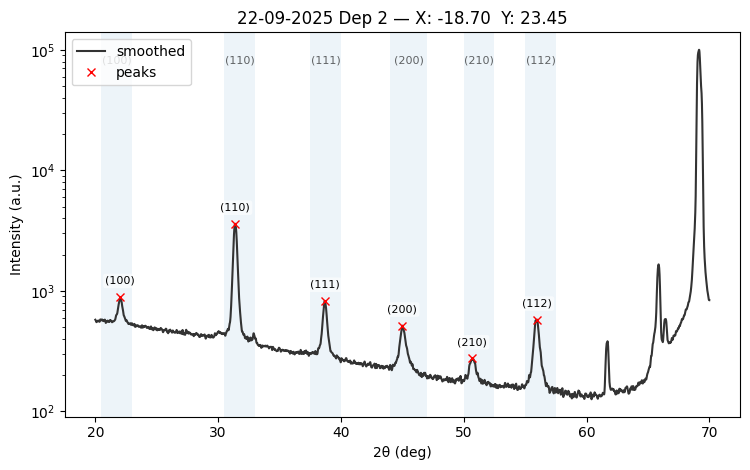


BTO_Mapping_Theta2Theta_22-09-2025_001_30_-24-940_31-273.xy  peaks: 6
  (100)    [R1]   22.030°   I≈831.4   FWHM≈1.1407°   Area≈150.30
  (110)    [R2]   31.390°   I≈4588.3   FWHM≈1.7751°   Area≈1594.57
  (111)    [R3]   38.700°   I≈733.9   FWHM≈1.5049°   Area≈260.89
  (200)    [R4]   45.010°   I≈453.3   FWHM≈2.2363°   Area≈172.59
  (210)    [R5]   50.690°   I≈295.9   FWHM≈1.9270°   Area≈69.78
  (112)    [R6]   55.920°   I≈563.8   FWHM≈1.8197°   Area≈249.38


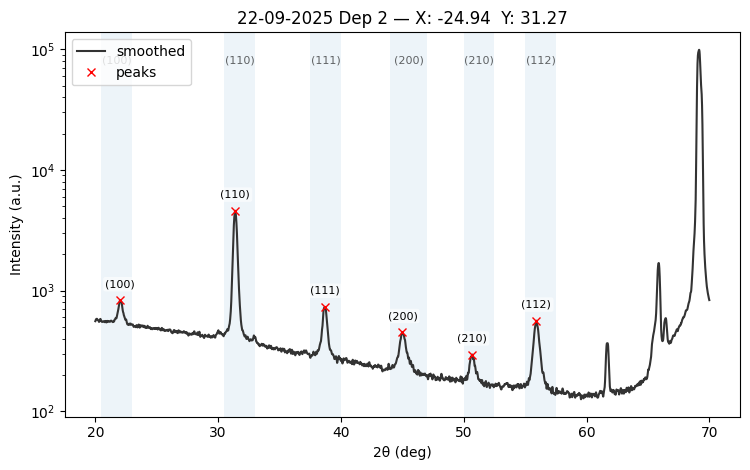


BTO_Mapping_Theta2Theta_22-09-2025_001_31_-31-174_39-092.xy  peaks: 0


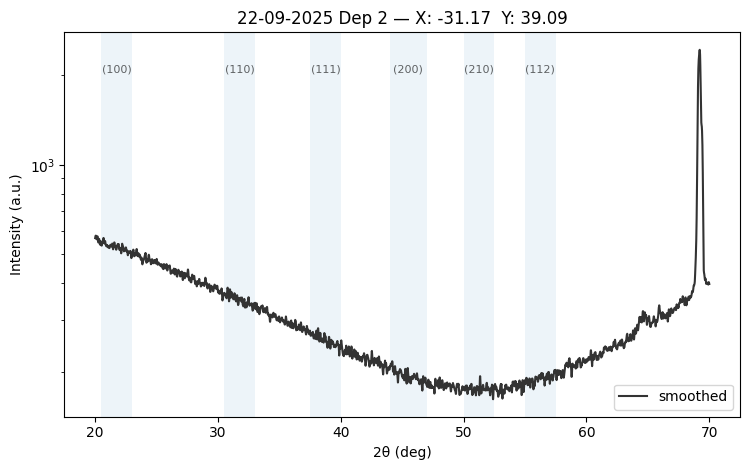


BTO_Mapping_Theta2Theta_22-09-2025_001_32_-9-010_4-339.xy  peaks: 6
  (100)    [R1]   22.060°   I≈875.2   FWHM≈1.1456°   Area≈192.91
  (110)    [R2]   31.390°   I≈3419.2   FWHM≈1.7812°   Area≈1192.31
  (111)    [R3]   38.710°   I≈923.0   FWHM≈1.4711°   Area≈287.47
  (200)    [R4]   45.040°   I≈484.4   FWHM≈2.1968°   Area≈200.11
  (210)    [R5]   50.710°   I≈281.1   FWHM≈1.7760°   Area≈67.30
  (112)    [R6]   55.930°   I≈597.7   FWHM≈1.7819°   Area≈261.08


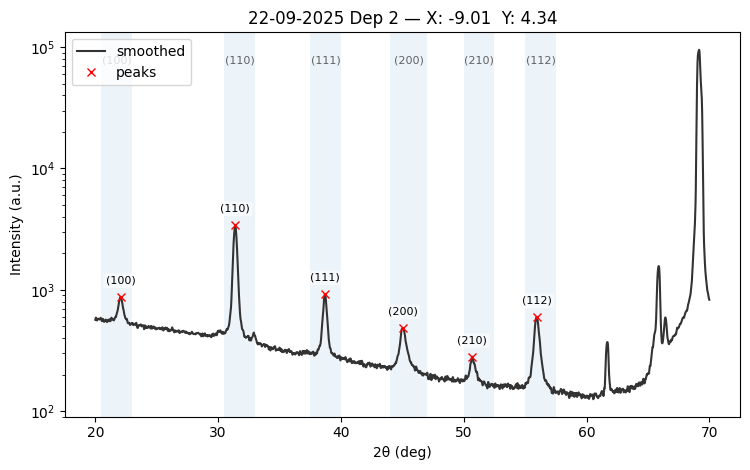


BTO_Mapping_Theta2Theta_22-09-2025_001_33_-18-019_8-678.xy  peaks: 6
  (100)    [R1]   22.030°   I≈913.9   FWHM≈1.1574°   Area≈205.55
  (110)    [R2]   31.390°   I≈3428.5   FWHM≈1.7898°   Area≈1188.43
  (111)    [R3]   38.670°   I≈820.2   FWHM≈1.5123°   Area≈258.40
  (200)    [R4]   45.050°   I≈534.2   FWHM≈2.2340°   Area≈216.42
  (210)    [R5]   50.650°   I≈283.3   FWHM≈1.8759°   Area≈67.03
  (112)    [R6]   55.930°   I≈581.0   FWHM≈1.8268°   Area≈252.27


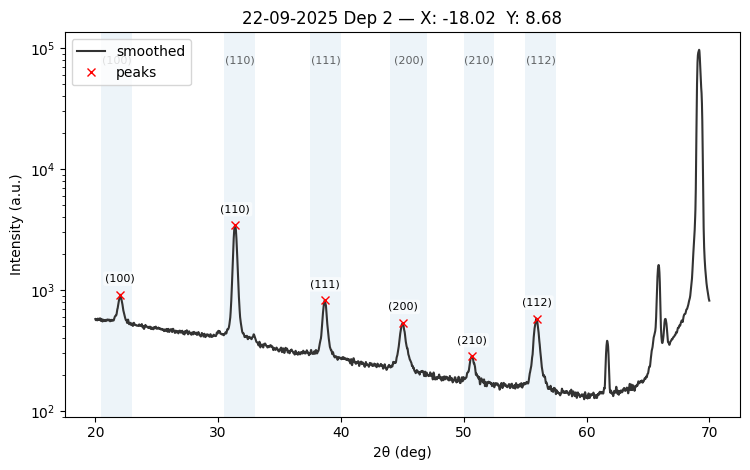


BTO_Mapping_Theta2Theta_22-09-2025_001_34_-27-029_13-017.xy  peaks: 6
  (100)    [R1]   22.030°   I≈907.7   FWHM≈1.1858°   Area≈189.31
  (110)    [R2]   31.350°   I≈4290.6   FWHM≈1.8176°   Area≈1456.95
  (111)    [R3]   38.620°   I≈700.3   FWHM≈1.5589°   Area≈221.66
  (200)    [R4]   44.970°   I≈549.3   FWHM≈2.2953°   Area≈237.20
  (210)    [R5]   50.660°   I≈281.8   FWHM≈1.9828°   Area≈61.23
  (112)    [R6]   55.850°   I≈561.2   FWHM≈1.9048°   Area≈243.40


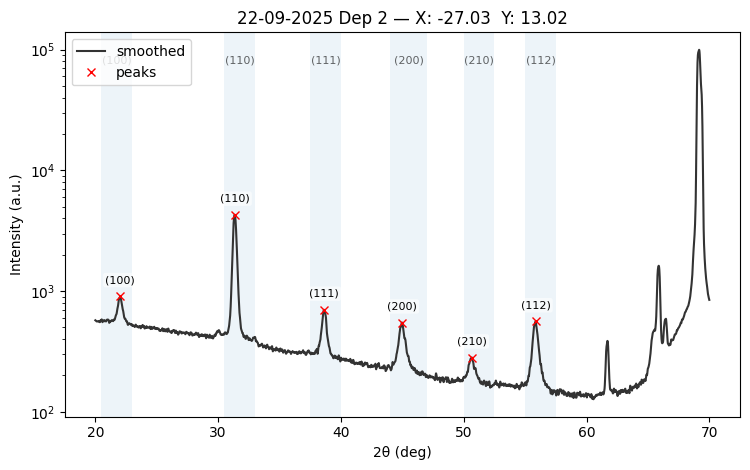


BTO_Mapping_Theta2Theta_22-09-2025_001_35_-36-039_17-355.xy  peaks: 6
  (100)    [R1]   21.970°   I≈874.3   FWHM≈1.2316°   Area≈194.77
  (110)    [R2]   31.300°   I≈6365.2   FWHM≈1.8548°   Area≈2051.87
  (111)    [R3]   38.580°   I≈584.6   FWHM≈1.6187°   Area≈153.65
  (200)    [R4]   44.880°   I≈508.4   FWHM≈2.3803°   Area≈221.23
  (210)    [R5]   50.540°   I≈301.6   FWHM≈2.0812°   Area≈71.97
  (112)    [R6]   55.720°   I≈586.4   FWHM≈1.9955°   Area≈229.91


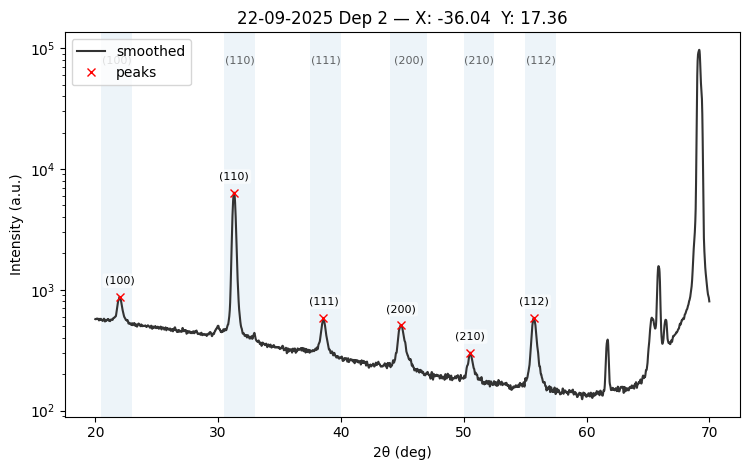


BTO_Mapping_Theta2Theta_22-09-2025_001_36_-45-048_21-694.xy  peaks: 0


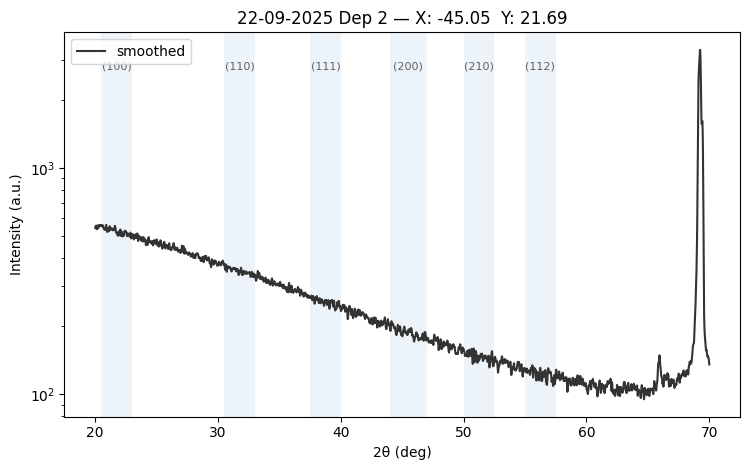


BTO_Mapping_Theta2Theta_22-09-2025_001_37_-10-000_0-000.xy  peaks: 6
  (100)    [R1]   22.080°   I≈876.6   FWHM≈1.1500°   Area≈177.51
  (110)    [R2]   31.400°   I≈3292.0   FWHM≈1.7837°   Area≈1175.00
  (111)    [R3]   38.700°   I≈889.9   FWHM≈1.4865°   Area≈283.05
  (200)    [R4]   45.070°   I≈505.7   FWHM≈2.2046°   Area≈209.90
  (210)    [R5]   50.740°   I≈277.1   FWHM≈1.7961°   Area≈60.04
  (112)    [R6]   55.940°   I≈581.8   FWHM≈1.7877°   Area≈246.72


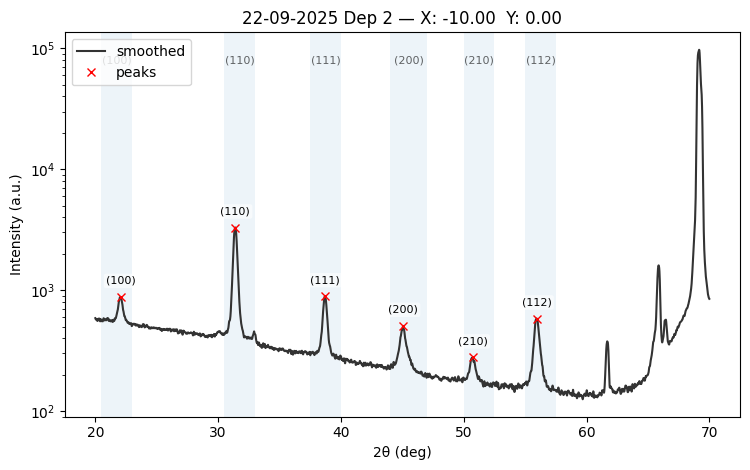


BTO_Mapping_Theta2Theta_22-09-2025_001_38_-20-000_0-000.xy  peaks: 6
  (100)    [R1]   22.020°   I≈922.1   FWHM≈1.1787°   Area≈205.06
  (110)    [R2]   31.380°   I≈3554.1   FWHM≈1.7915°   Area≈1238.19
  (111)    [R3]   38.670°   I≈785.2   FWHM≈1.5277°   Area≈254.28
  (200)    [R4]   45.010°   I≈556.7   FWHM≈2.2248°   Area≈212.15
  (210)    [R5]   50.740°   I≈280.9   FWHM≈1.9021°   Area≈72.03
  (112)    [R6]   55.920°   I≈572.7   FWHM≈1.8572°   Area≈252.91


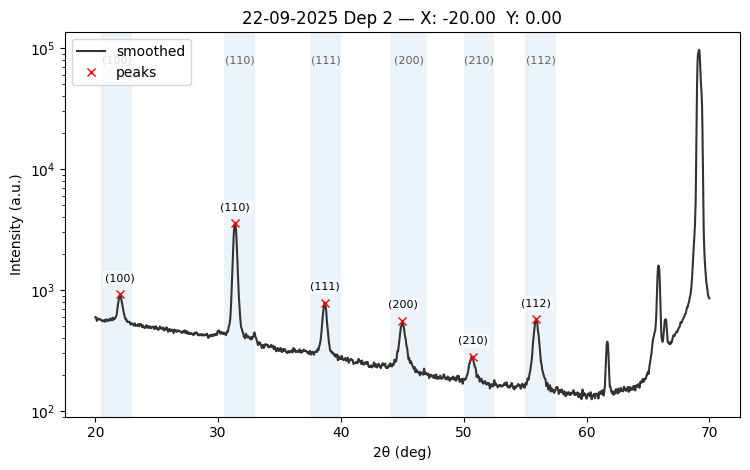


BTO_Mapping_Theta2Theta_22-09-2025_001_39_-30-000_0-000.xy  peaks: 6
  (100)    [R1]   21.980°   I≈926.0   FWHM≈1.1932°   Area≈210.03
  (110)    [R2]   31.320°   I≈5026.5   FWHM≈1.8345°   Area≈1669.42
  (111)    [R3]   38.580°   I≈634.0   FWHM≈1.5975°   Area≈200.12
  (200)    [R4]   44.900°   I≈538.2   FWHM≈2.3507°   Area≈219.43
  (210)    [R5]   50.540°   I≈298.7   FWHM≈2.0513°   Area≈70.07
  (112)    [R6]   55.770°   I≈560.5   FWHM≈1.9662°   Area≈237.88


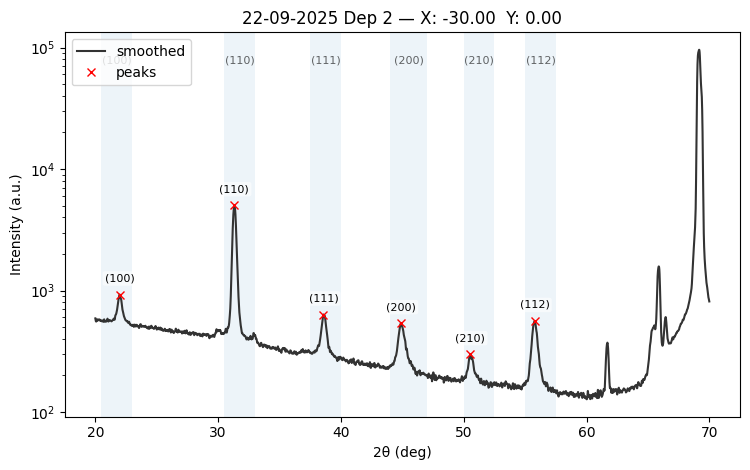


BTO_Mapping_Theta2Theta_22-09-2025_001_40_-40-000_0-000.xy  peaks: 6
  (100)    [R1]   21.960°   I≈1249.8   FWHM≈1.2203°   Area≈341.68
  (110)    [R2]   31.260°   I≈4504.2   FWHM≈1.8812°   Area≈1380.82
  (111)    [R3]   38.600°   I≈510.8   FWHM≈1.6844°   Area≈134.44
  (200)    [R4]   44.840°   I≈886.5   FWHM≈2.3949°   Area≈409.56
  (210)    [R5]   50.530°   I≈289.5   FWHM≈2.0974°   Area≈56.74
  (112)    [R6]   55.650°   I≈722.8   FWHM≈2.0420°   Area≈272.07


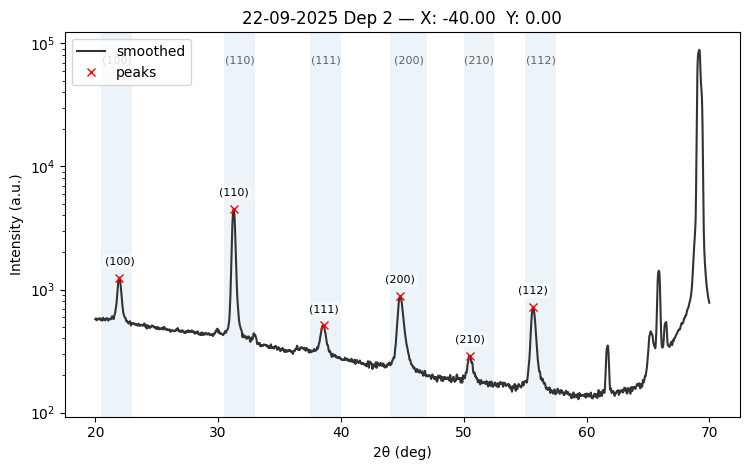


BTO_Mapping_Theta2Theta_22-09-2025_001_41_-50-000_0-000.xy  peaks: 1
  (200)    [R4]   44.270°   I≈6888.8   FWHM≈2.8858°   Area≈1271.29


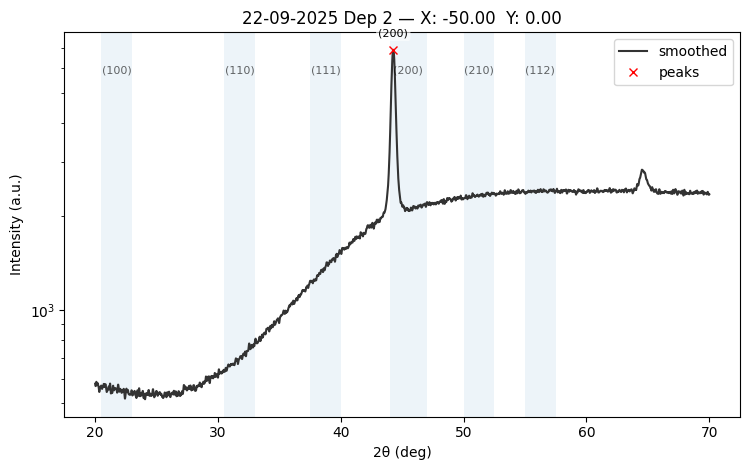


BTO_Mapping_Theta2Theta_22-09-2025_001_42_-9-010_-4-339.xy  peaks: 6
  (100)    [R1]   22.090°   I≈871.6   FWHM≈1.1295°   Area≈195.84
  (110)    [R2]   31.390°   I≈3378.5   FWHM≈1.7778°   Area≈1201.82
  (111)    [R3]   38.730°   I≈909.8   FWHM≈1.4691°   Area≈293.28
  (200)    [R4]   45.000°   I≈501.1   FWHM≈2.1780°   Area≈191.06
  (210)    [R5]   50.730°   I≈276.4   FWHM≈1.7953°   Area≈65.94
  (112)    [R6]   55.950°   I≈575.2   FWHM≈1.7925°   Area≈256.10


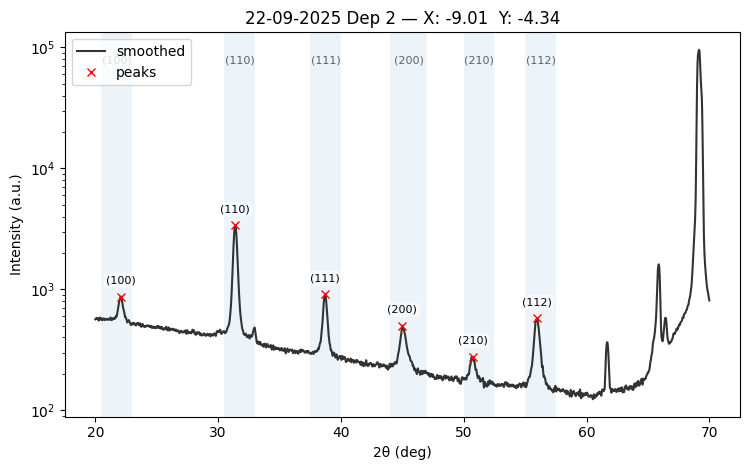


BTO_Mapping_Theta2Theta_22-09-2025_001_43_-18-019_-8-678.xy  peaks: 6
  (100)    [R1]   22.020°   I≈896.6   FWHM≈1.1582°   Area≈212.56
  (110)    [R2]   31.400°   I≈3542.9   FWHM≈1.7813°   Area≈1228.33
  (111)    [R3]   38.710°   I≈804.2   FWHM≈1.5027°   Area≈260.69
  (200)    [R4]   44.970°   I≈510.2   FWHM≈2.2256°   Area≈208.47
  (210)    [R5]   50.690°   I≈285.1   FWHM≈1.8519°   Area≈73.47
  (112)    [R6]   55.920°   I≈578.4   FWHM≈1.8225°   Area≈254.17


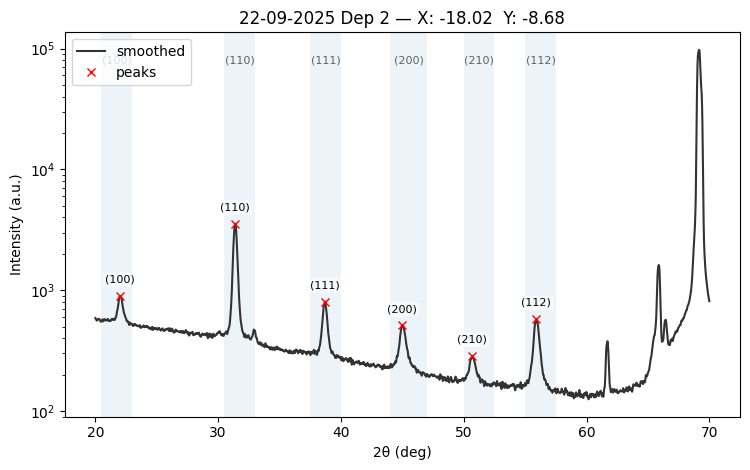


BTO_Mapping_Theta2Theta_22-09-2025_001_44_-27-029_-13-017.xy  peaks: 6
  (100)    [R1]   22.050°   I≈874.8   FWHM≈1.2140°   Area≈221.08
  (110)    [R2]   31.360°   I≈4700.2   FWHM≈1.8035°   Area≈1604.64
  (111)    [R3]   38.670°   I≈686.0   FWHM≈1.5595°   Area≈210.01
  (200)    [R4]   44.970°   I≈515.1   FWHM≈2.3046°   Area≈215.89
  (210)    [R5]   50.660°   I≈285.5   FWHM≈1.9444°   Area≈77.73
  (112)    [R6]   55.800°   I≈541.4   FWHM≈1.9128°   Area≈241.37


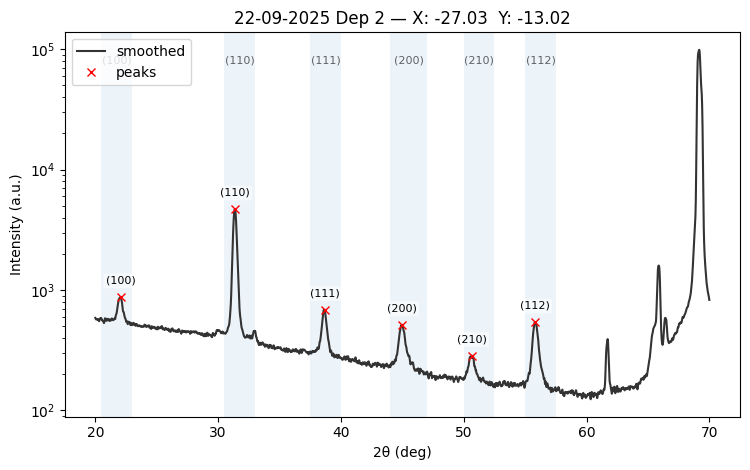


BTO_Mapping_Theta2Theta_22-09-2025_001_45_-36-039_-17-355.xy  peaks: 6
  (100)    [R1]   21.990°   I≈886.3   FWHM≈1.2161°   Area≈199.44
  (110)    [R2]   31.310°   I≈7093.9   FWHM≈1.8400°   Area≈2274.63
  (111)    [R3]   38.620°   I≈565.5   FWHM≈1.6231°   Area≈164.14
  (200)    [R4]   44.920°   I≈511.5   FWHM≈2.3870°   Area≈231.66
  (210)    [R5]   50.540°   I≈294.6   FWHM≈2.0911°   Area≈69.37
  (112)    [R6]   55.720°   I≈553.9   FWHM≈1.9901°   Area≈231.39


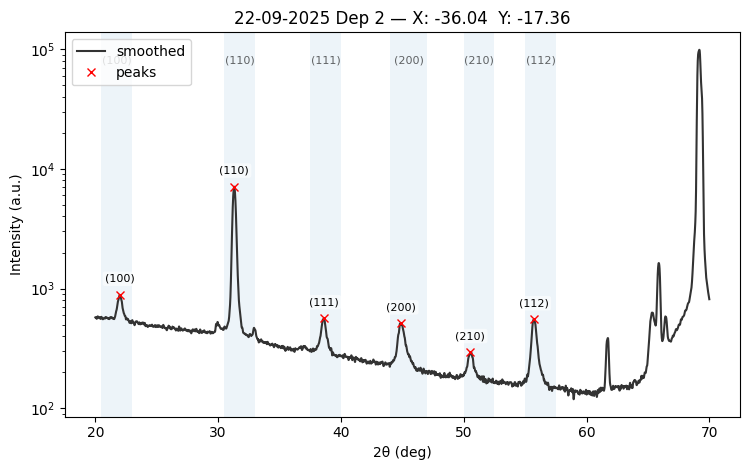


BTO_Mapping_Theta2Theta_22-09-2025_001_46_-45-048_-21-694.xy  peaks: 0


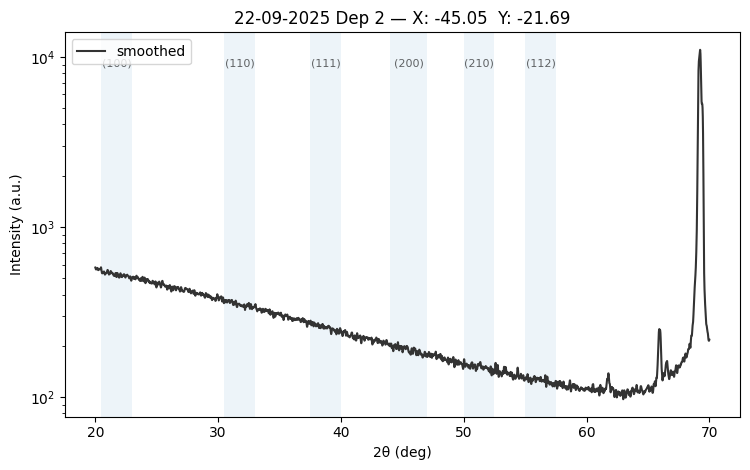


BTO_Mapping_Theta2Theta_22-09-2025_001_47_-6-235_-7-818.xy  peaks: 6
  (100)    [R1]   22.110°   I≈842.4   FWHM≈1.1373°   Area≈182.77
  (110)    [R2]   31.400°   I≈3366.7   FWHM≈1.7756°   Area≈1204.03
  (111)    [R3]   38.720°   I≈935.1   FWHM≈1.4608°   Area≈288.89
  (200)    [R4]   45.080°   I≈484.1   FWHM≈2.1608°   Area≈184.31
  (210)    [R5]   50.740°   I≈275.2   FWHM≈1.7477°   Area≈68.02
  (112)    [R6]   55.940°   I≈581.2   FWHM≈1.7721°   Area≈239.70


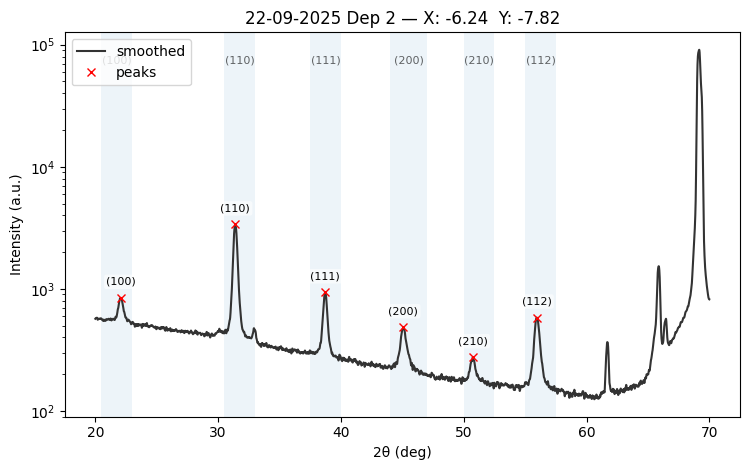


BTO_Mapping_Theta2Theta_22-09-2025_001_48_-12-470_-15-637.xy  peaks: 6
  (100)    [R1]   22.050°   I≈875.4   FWHM≈1.1278°   Area≈180.71
  (110)    [R2]   31.410°   I≈3374.9   FWHM≈1.7701°   Area≈1204.67
  (111)    [R3]   38.720°   I≈870.3   FWHM≈1.4766°   Area≈277.49
  (200)    [R4]   45.090°   I≈492.7   FWHM≈2.1913°   Area≈195.55
  (210)    [R5]   50.790°   I≈284.7   FWHM≈1.7711°   Area≈77.19
  (112)    [R6]   55.950°   I≈582.7   FWHM≈1.7800°   Area≈256.91


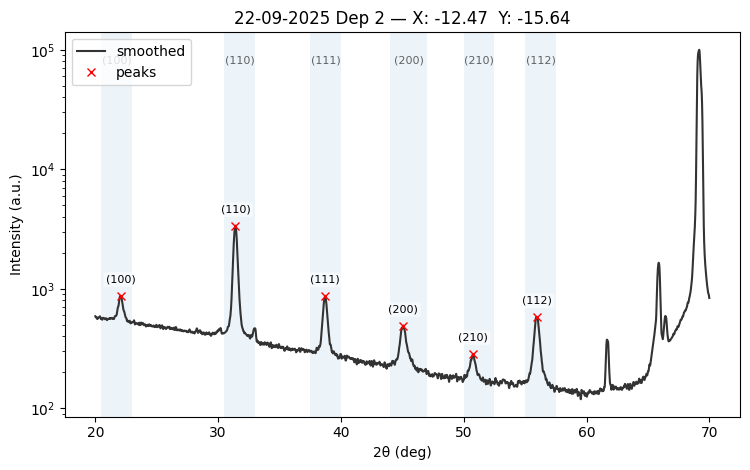


BTO_Mapping_Theta2Theta_22-09-2025_001_49_-18-705_-23-455.xy  peaks: 6
  (100)    [R1]   22.070°   I≈869.3   FWHM≈1.1464°   Area≈184.03
  (110)    [R2]   31.410°   I≈3632.8   FWHM≈1.7595°   Area≈1274.89
  (111)    [R3]   38.720°   I≈825.6   FWHM≈1.4809°   Area≈259.39
  (200)    [R4]   45.040°   I≈500.8   FWHM≈2.2003°   Area≈187.27
  (210)    [R5]   50.780°   I≈289.9   FWHM≈1.8423°   Area≈73.08
  (112)    [R6]   55.950°   I≈581.6   FWHM≈1.7908°   Area≈262.46


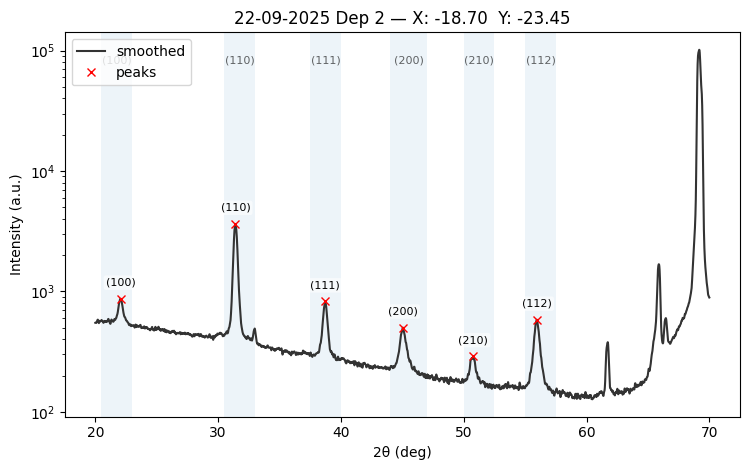


BTO_Mapping_Theta2Theta_22-09-2025_001_50_-24-940_-31-273.xy  peaks: 6
  (100)    [R1]   22.060°   I≈815.9   FWHM≈1.1532°   Area≈153.40
  (110)    [R2]   31.410°   I≈4546.0   FWHM≈1.7527°   Area≈1587.44
  (111)    [R3]   38.700°   I≈738.1   FWHM≈1.4932°   Area≈243.18
  (200)    [R4]   45.020°   I≈460.5   FWHM≈2.2335°   Area≈179.75
  (210)    [R5]   50.730°   I≈293.7   FWHM≈1.8702°   Area≈84.78
  (112)    [R6]   55.940°   I≈554.3   FWHM≈1.8191°   Area≈242.33


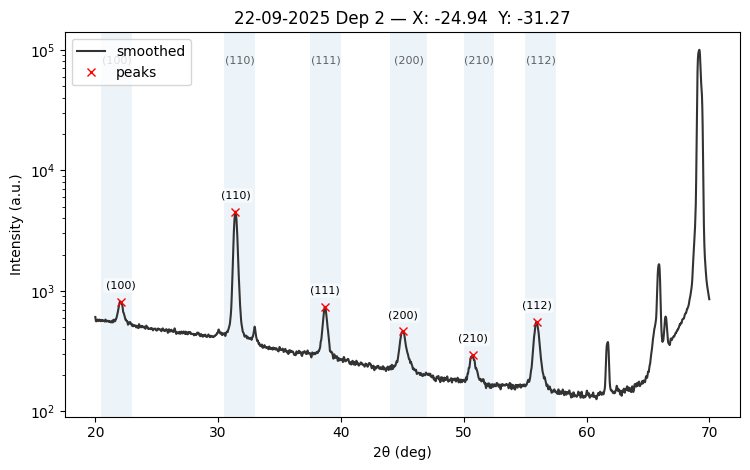


BTO_Mapping_Theta2Theta_22-09-2025_001_51_-31-174_-39-092.xy  peaks: 0


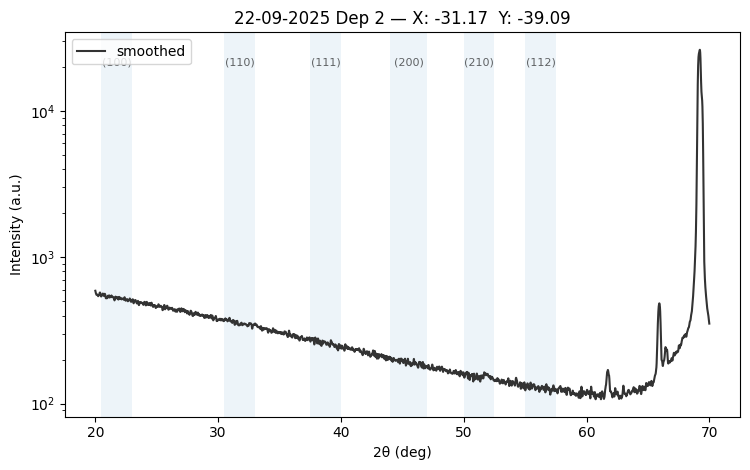


BTO_Mapping_Theta2Theta_22-09-2025_001_52_-2-225_-9-749.xy  peaks: 6
  (100)    [R1]   22.080°   I≈873.2   FWHM≈1.1080°   Area≈178.58
  (110)    [R2]   31.410°   I≈3475.0   FWHM≈1.7697°   Area≈1236.04
  (111)    [R3]   38.710°   I≈985.5   FWHM≈1.4491°   Area≈297.04
  (200)    [R4]   45.130°   I≈471.4   FWHM≈2.1397°   Area≈179.49
  (210)    [R5]   50.710°   I≈276.2   FWHM≈1.7548°   Area≈54.58
  (112)    [R6]   55.990°   I≈585.5   FWHM≈1.7482°   Area≈248.54


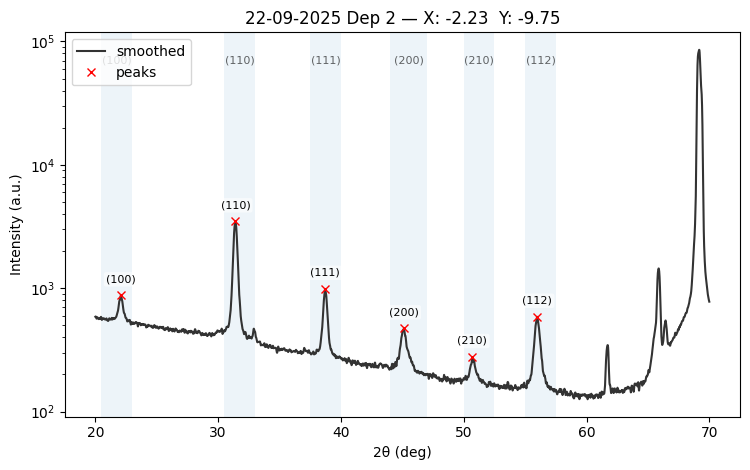


BTO_Mapping_Theta2Theta_22-09-2025_001_53_-4-450_-19-499.xy  peaks: 6
  (100)    [R1]   22.080°   I≈843.4   FWHM≈1.1367°   Area≈161.44
  (110)    [R2]   31.410°   I≈3439.9   FWHM≈1.7595°   Area≈1217.51
  (111)    [R3]   38.730°   I≈963.5   FWHM≈1.4440°   Area≈306.36
  (200)    [R4]   45.060°   I≈462.3   FWHM≈2.1521°   Area≈184.20
  (210)    [R5]   50.710°   I≈271.5   FWHM≈1.7148°   Area≈61.84
  (112)    [R6]   55.970°   I≈579.0   FWHM≈1.7305°   Area≈250.22


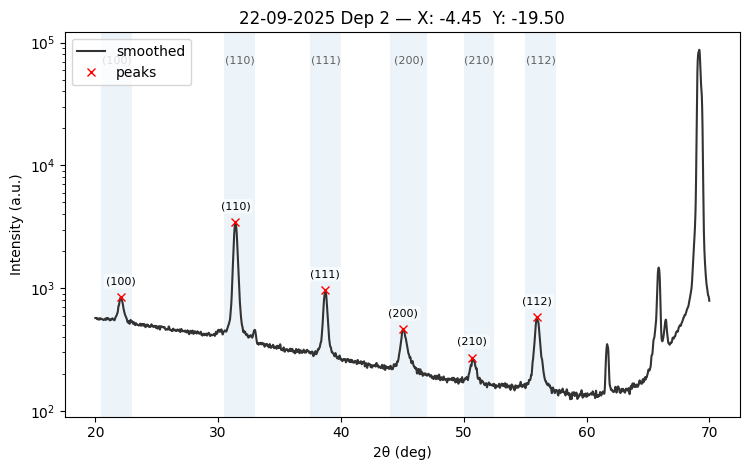


BTO_Mapping_Theta2Theta_22-09-2025_001_54_-6-676_-29-248.xy  peaks: 6
  (100)    [R1]   22.120°   I≈864.7   FWHM≈1.0930°   Area≈183.19
  (110)    [R2]   31.430°   I≈3445.1   FWHM≈1.7490°   Area≈1244.50
  (111)    [R3]   38.730°   I≈939.4   FWHM≈1.4341°   Area≈294.34
  (200)    [R4]   45.120°   I≈458.8   FWHM≈2.1057°   Area≈172.71
  (210)    [R5]   50.690°   I≈278.4   FWHM≈1.7319°   Area≈66.37
  (112)    [R6]   56.010°   I≈588.7   FWHM≈1.7252°   Area≈244.67


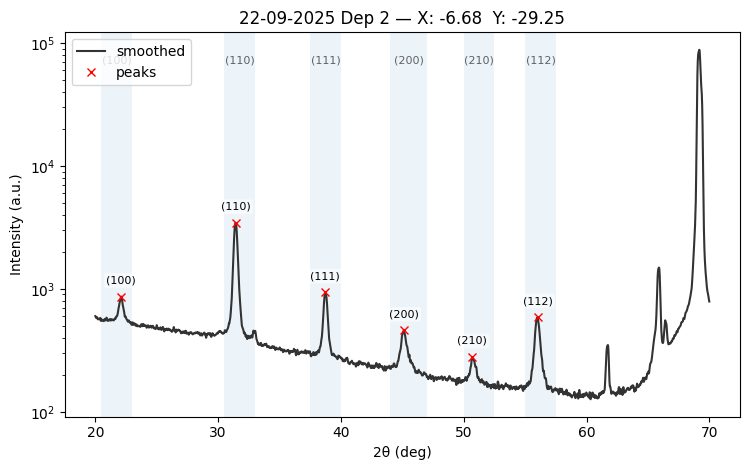


BTO_Mapping_Theta2Theta_22-09-2025_001_55_-8-901_-38-997.xy  peaks: 6
  (100)    [R1]   22.100°   I≈827.5   FWHM≈1.0955°   Area≈167.63
  (110)    [R2]   31.450°   I≈3502.5   FWHM≈1.7322°   Area≈1289.41
  (111)    [R3]   38.750°   I≈916.7   FWHM≈1.4122°   Area≈283.45
  (200)    [R4]   45.150°   I≈447.2   FWHM≈2.1471°   Area≈176.26
  (210)    [R5]   50.820°   I≈281.9   FWHM≈1.7164°   Area≈69.72
  (112)    [R6]   55.990°   I≈563.0   FWHM≈1.7154°   Area≈250.14


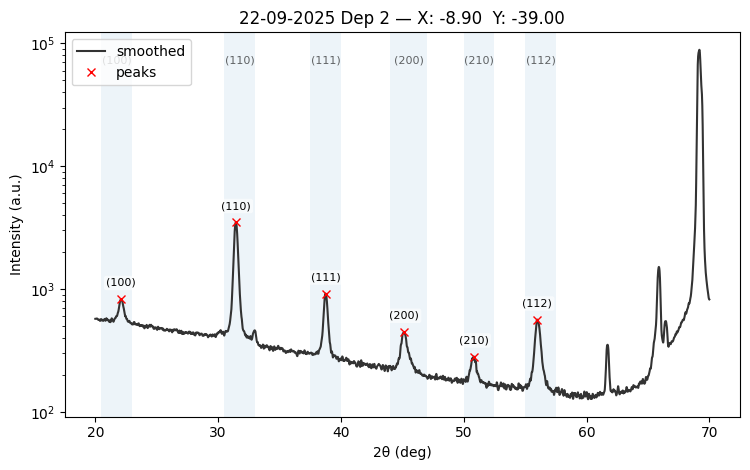


BTO_Mapping_Theta2Theta_22-09-2025_001_56_-11-126_-48-746.xy  peaks: 0


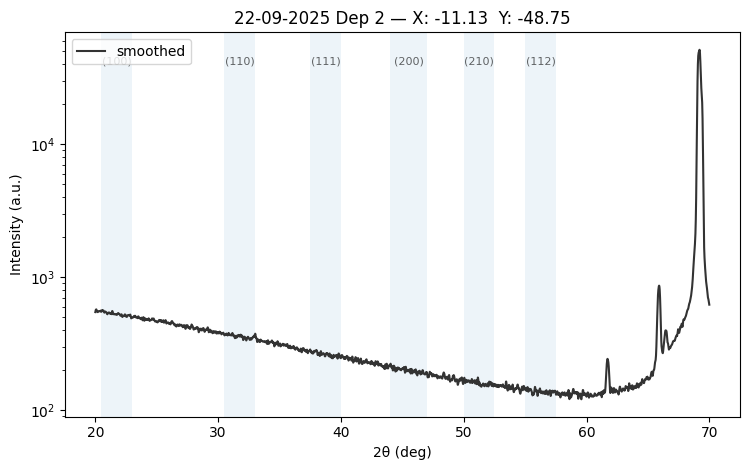


BTO_Mapping_Theta2Theta_22-09-2025_001_57_2-225_-9-749.xy  peaks: 6
  (100)    [R1]   22.050°   I≈829.2   FWHM≈1.1258°   Area≈163.03
  (110)    [R2]   31.400°   I≈3463.8   FWHM≈1.7676°   Area≈1238.21
  (111)    [R3]   38.740°   I≈1009.3   FWHM≈1.4449°   Area≈321.13
  (200)    [R4]   45.080°   I≈439.0   FWHM≈2.1300°   Area≈159.31
  (210)    [R5]   50.750°   I≈266.1   FWHM≈1.6903°   Area≈66.86
  (112)    [R6]   55.980°   I≈571.3   FWHM≈1.7392°   Area≈243.55


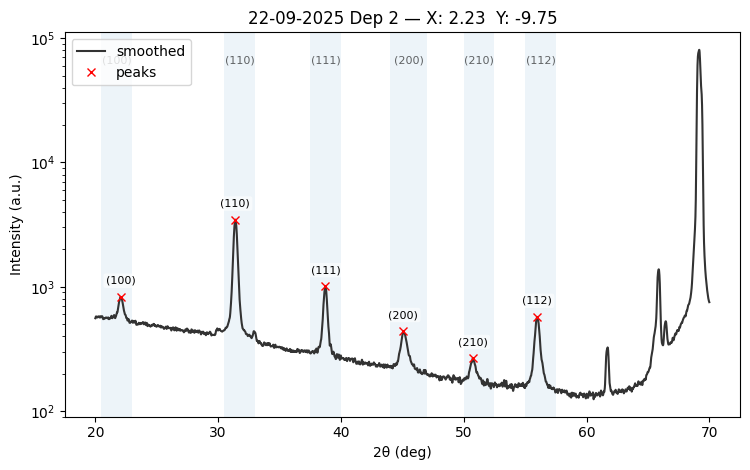


BTO_Mapping_Theta2Theta_22-09-2025_001_58_4-450_-19-499.xy  peaks: 6
  (100)    [R1]   22.110°   I≈810.7   FWHM≈1.0848°   Area≈162.13
  (110)    [R2]   31.400°   I≈3400.5   FWHM≈1.7595°   Area≈1206.82
  (111)    [R3]   38.760°   I≈1017.9   FWHM≈1.4258°   Area≈323.14
  (200)    [R4]   45.170°   I≈429.6   FWHM≈2.1119°   Area≈163.70
  (210)    [R5]   50.760°   I≈270.2   FWHM≈1.6546°   Area≈59.85
  (112)    [R6]   55.990°   I≈576.6   FWHM≈1.7034°   Area≈240.30


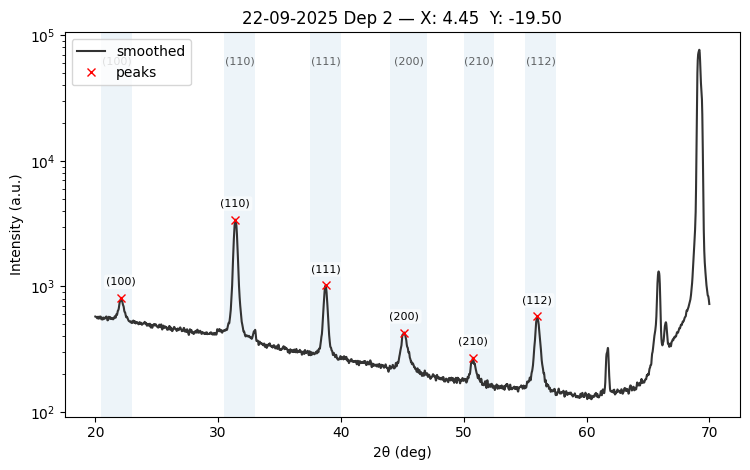


BTO_Mapping_Theta2Theta_22-09-2025_001_59_6-676_-29-248.xy  peaks: 6
  (100)    [R1]   22.060°   I≈776.0   FWHM≈1.0980°   Area≈135.21
  (110)    [R2]   31.420°   I≈3323.8   FWHM≈1.7451°   Area≈1191.15
  (111)    [R3]   38.760°   I≈1028.7   FWHM≈1.4030°   Area≈305.85
  (200)    [R4]   45.130°   I≈396.5   FWHM≈2.0895°   Area≈152.87
  (210)    [R5]   50.800°   I≈267.7   FWHM≈1.6557°   Area≈74.92
  (112)    [R6]   56.000°   I≈552.6   FWHM≈1.7016°   Area≈221.25


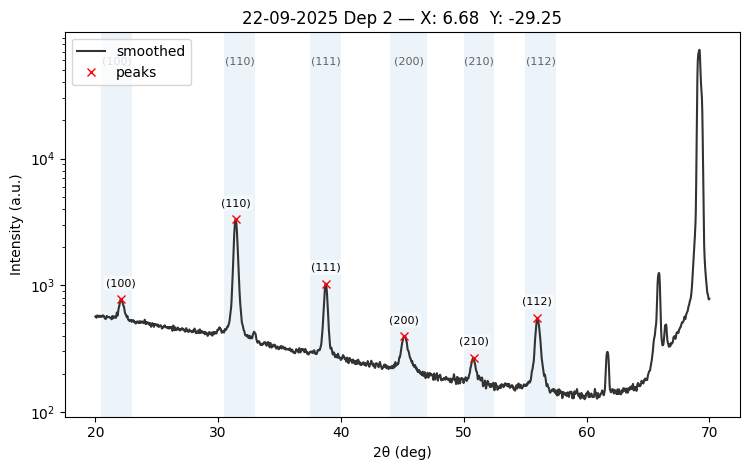


BTO_Mapping_Theta2Theta_22-09-2025_001_60_8-901_-38-997.xy  peaks: 6
  (100)    [R1]   22.140°   I≈775.4   FWHM≈1.0739°   Area≈122.35
  (110)    [R2]   31.440°   I≈3214.2   FWHM≈1.7240°   Area≈1145.27
  (111)    [R3]   38.780°   I≈1020.9   FWHM≈1.3806°   Area≈307.77
  (200)    [R4]   45.110°   I≈388.1   FWHM≈2.0525°   Area≈141.95
  (210)    [R5]   50.750°   I≈275.7   FWHM≈1.6859°   Area≈61.86
  (112)    [R6]   56.050°   I≈529.7   FWHM≈1.6785°   Area≈213.76


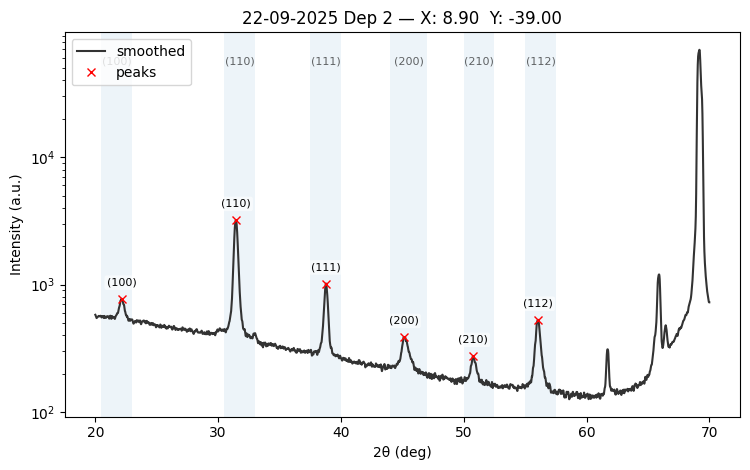


BTO_Mapping_Theta2Theta_22-09-2025_001_61_11-126_-48-746.xy  peaks: 0


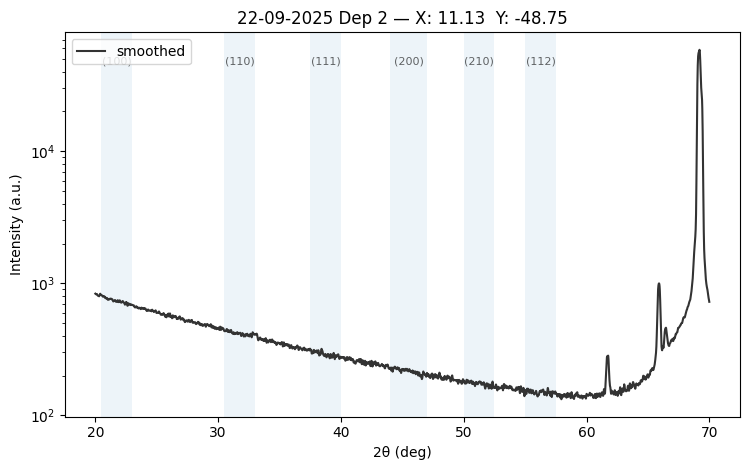


BTO_Mapping_Theta2Theta_22-09-2025_001_62_6-235_-7-818.xy  peaks: 6
  (100)    [R1]   22.110°   I≈810.5   FWHM≈1.1270°   Area≈137.76
  (110)    [R2]   31.410°   I≈3468.7   FWHM≈1.7650°   Area≈1224.48
  (111)    [R3]   38.750°   I≈1023.5   FWHM≈1.4350°   Area≈314.71
  (200)    [R4]   45.090°   I≈420.3   FWHM≈2.1118°   Area≈161.87
  (210)    [R5]   50.760°   I≈262.9   FWHM≈1.6498°   Area≈59.96
  (112)    [R6]   56.000°   I≈557.5   FWHM≈1.7305°   Area≈231.12


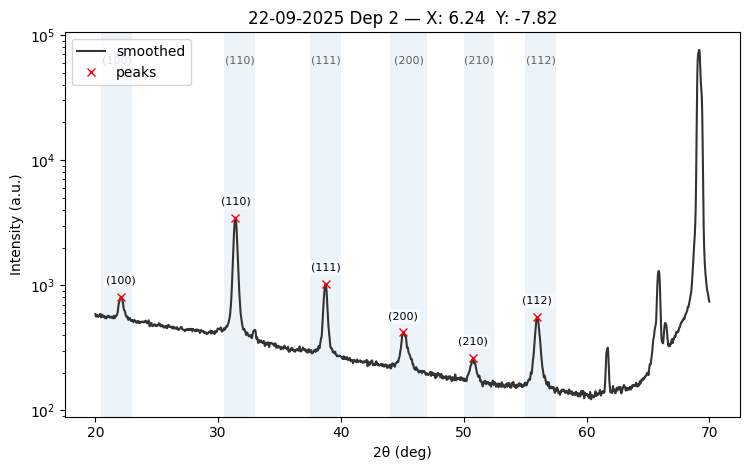


BTO_Mapping_Theta2Theta_22-09-2025_001_63_12-470_-15-637.xy  peaks: 6
  (100)    [R1]   22.140°   I≈760.0   FWHM≈1.1148°   Area≈121.79
  (110)    [R2]   31.410°   I≈3262.5   FWHM≈1.7583°   Area≈1160.68
  (111)    [R3]   38.770°   I≈1059.2   FWHM≈1.4105°   Area≈335.15
  (200)    [R4]   45.100°   I≈391.8   FWHM≈2.1167°   Area≈153.70
  (210)    [R5]   50.800°   I≈276.7   FWHM≈1.6593°   Area≈60.70
  (112)    [R6]   56.000°   I≈541.6   FWHM≈1.7077°   Area≈216.24


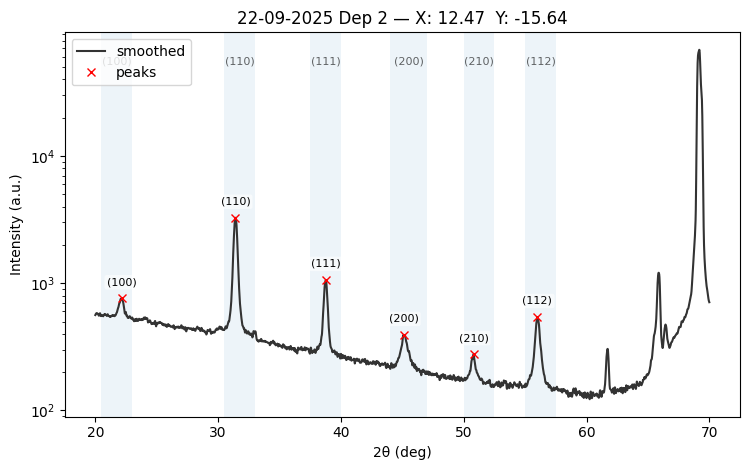


BTO_Mapping_Theta2Theta_22-09-2025_001_64_18-705_-23-455.xy  peaks: 6
  (100)    [R1]   22.100°   I≈728.8   FWHM≈1.0826°   Area≈125.31
  (110)    [R2]   31.420°   I≈2937.8   FWHM≈1.7400°   Area≈1018.07
  (111)    [R3]   38.770°   I≈1074.9   FWHM≈1.3898°   Area≈321.38
  (200)    [R4]   45.160°   I≈359.4   FWHM≈1.9584°   Area≈119.18
  (210)    [R5]   50.750°   I≈256.5   FWHM≈1.5678°   Area≈65.92
  (112)    [R6]   56.020°   I≈539.8   FWHM≈1.6894°   Area≈209.65


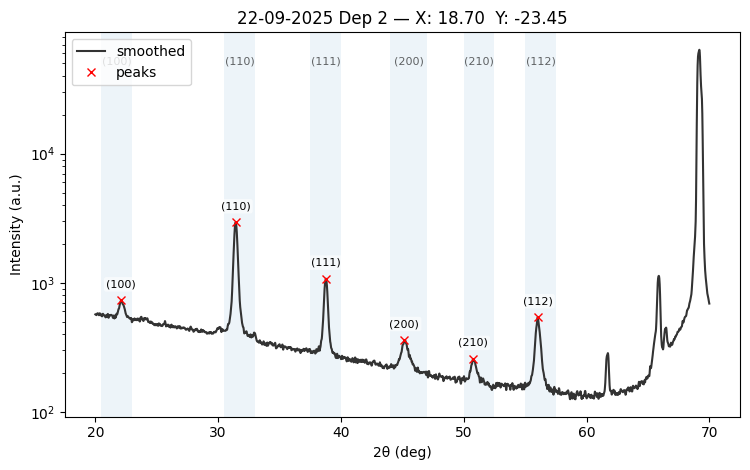


BTO_Mapping_Theta2Theta_22-09-2025_001_65_24-940_-31-273.xy  peaks: 6
  (100)    [R1]   22.240°   I≈707.6   FWHM≈1.0447°   Area≈106.21
  (110)    [R2]   31.450°   I≈2466.2   FWHM≈1.7311°   Area≈873.88
  (111)    [R3]   38.810°   I≈1037.7   FWHM≈1.3721°   Area≈306.21
  (200)    [R4]   45.170°   I≈334.5   FWHM≈1.8724°   Area≈109.30
  (210)    [R5]   50.810°   I≈256.8   FWHM≈1.5439°   Area≈57.93
  (112)    [R6]   56.060°   I≈555.1   FWHM≈1.6589°   Area≈212.65


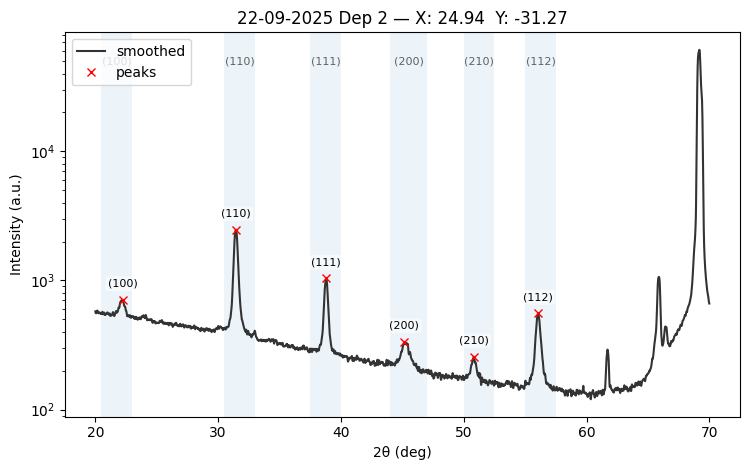


BTO_Mapping_Theta2Theta_22-09-2025_001_66_31-174_-39-092.xy  peaks: 0


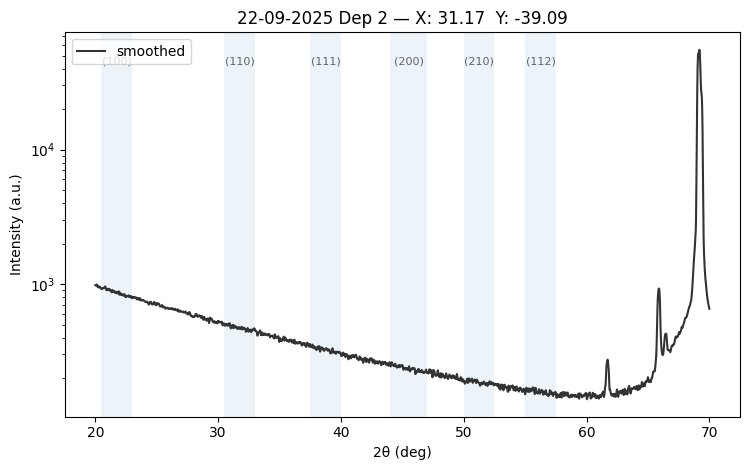


BTO_Mapping_Theta2Theta_22-09-2025_001_67_9-010_-4-339.xy  peaks: 6
  (100)    [R1]   22.060°   I≈795.0   FWHM≈1.0852°   Area≈152.64
  (110)    [R2]   31.400°   I≈3402.6   FWHM≈1.7643°   Area≈1195.20
  (111)    [R3]   38.760°   I≈1038.8   FWHM≈1.4265°   Area≈316.79
  (200)    [R4]   45.130°   I≈407.3   FWHM≈2.1411°   Area≈163.32
  (210)    [R5]   50.720°   I≈264.8   FWHM≈1.6359°   Area≈67.29
  (112)    [R6]   55.980°   I≈545.1   FWHM≈1.7200°   Area≈223.66


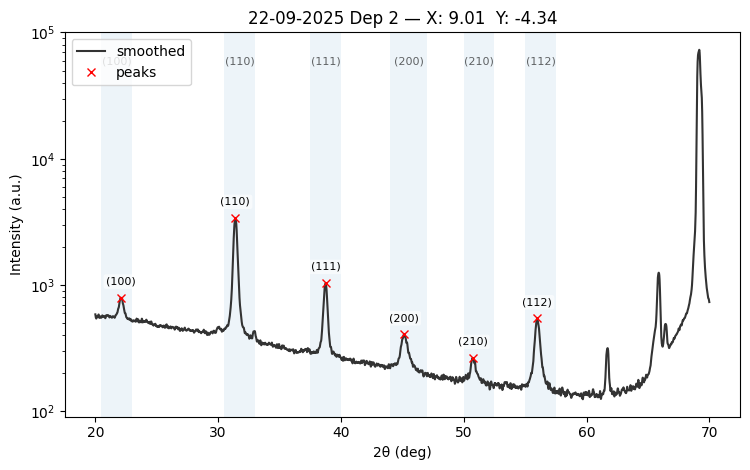


BTO_Mapping_Theta2Theta_22-09-2025_001_68_18-019_-8-678.xy  peaks: 6
  (100)    [R1]   22.120°   I≈739.1   FWHM≈1.1061°   Area≈116.92
  (110)    [R2]   31.410°   I≈3082.2   FWHM≈1.7552°   Area≈1076.25
  (111)    [R3]   38.750°   I≈1060.7   FWHM≈1.4120°   Area≈323.05
  (200)    [R4]   45.230°   I≈375.4   FWHM≈2.0077°   Area≈130.18
  (210)    [R5]   50.810°   I≈258.1   FWHM≈1.5732°   Area≈60.29
  (112)    [R6]   56.020°   I≈532.2   FWHM≈1.7027°   Area≈224.35


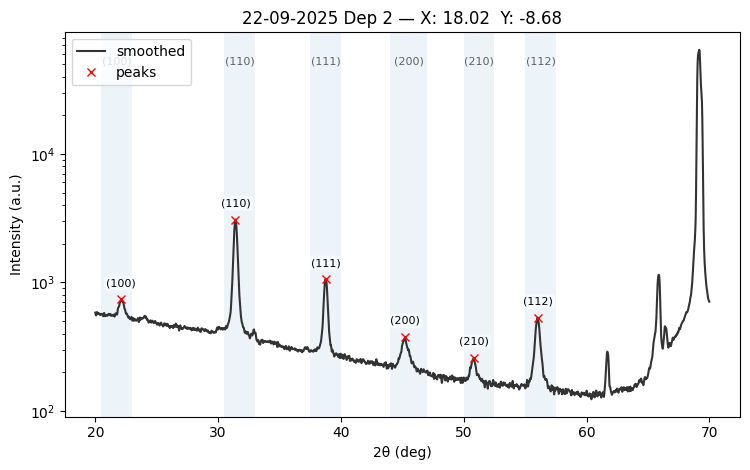


BTO_Mapping_Theta2Theta_22-09-2025_001_69_27-029_-13-017.xy  peaks: 6
  (100)    [R1]   22.120°   I≈707.1   FWHM≈1.1057°   Area≈105.87
  (110)    [R2]   31.440°   I≈2521.5   FWHM≈1.7495°   Area≈887.61
  (111)    [R3]   38.780°   I≈1079.9   FWHM≈1.3952°   Area≈330.88
  (200)    [R4]   45.160°   I≈324.2   FWHM≈1.7953°   Area≈119.52
  (210)    [R5]   50.790°   I≈253.7   FWHM≈1.5447°   Area≈54.06
  (112)    [R6]   56.060°   I≈553.9   FWHM≈1.6746°   Area≈228.27


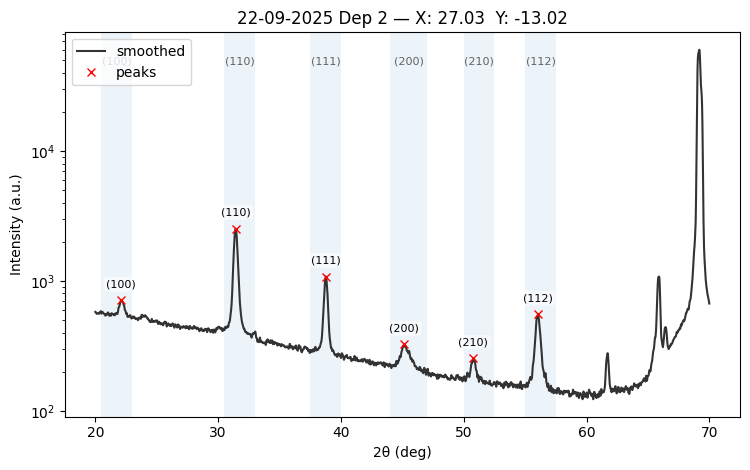


BTO_Mapping_Theta2Theta_22-09-2025_001_70_36-039_-17-355.xy  peaks: 6
  (100)    [R1]   22.230°   I≈666.1   FWHM≈1.1144°   Area≈105.27
  (110)    [R2]   31.440°   I≈2134.7   FWHM≈1.7359°   Area≈750.55
  (111)    [R3]   38.790°   I≈1042.1   FWHM≈1.3716°   Area≈306.52
  (200)    [R4]   45.320°   I≈306.3   FWHM≈1.6861°   Area≈107.50
  (210)    [R5]   50.840°   I≈239.2   FWHM≈1.4239°   Area≈45.98
  (112)    [R6]   56.080°   I≈614.1   FWHM≈1.6469°   Area≈242.08


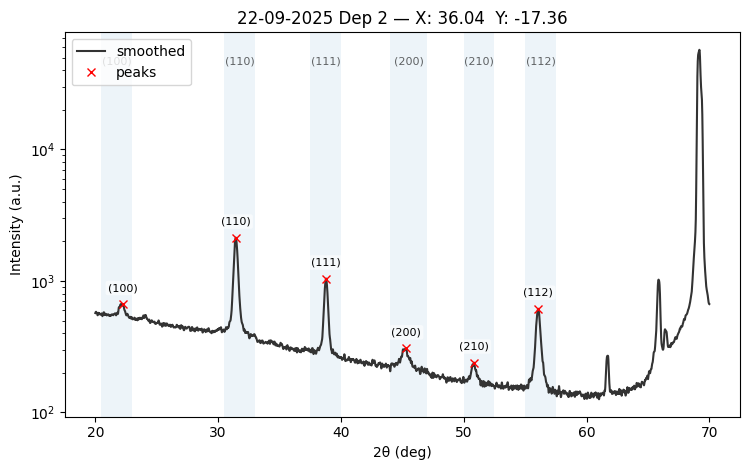


BTO_Mapping_Theta2Theta_22-09-2025_001_71_45-048_-21-694.xy  peaks: 0


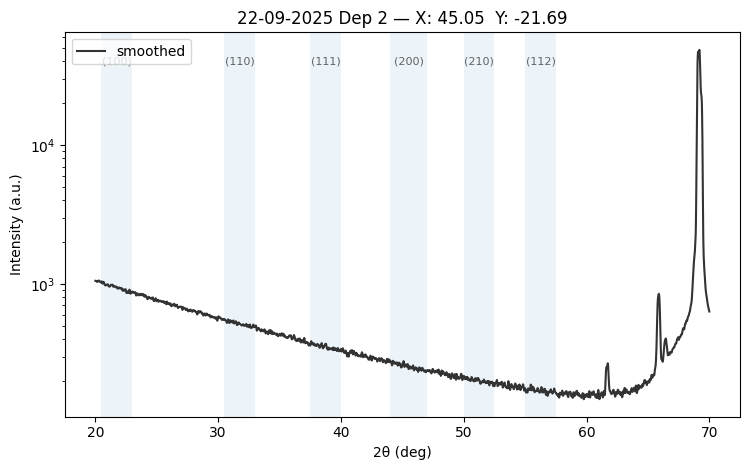


Individual plots for: 24-09-2025 Dep 3

BTO_Mapping_Theta2Theta_24-09-2025_001_01_0-000_0-000.xy  peaks: 6
  (100)    [R1]   22.100°   I≈698.1   FWHM≈1.1227°   Area≈106.46
  (110)    [R2]   31.390°   I≈3129.6   FWHM≈1.7769°   Area≈1082.48
  (111)    [R3]   38.740°   I≈1565.6   FWHM≈1.4397°   Area≈488.56
  (200)    [R4]   45.190°   I≈331.3   FWHM≈1.8558°   Area≈114.49
  (210)    [R5]   50.680°   I≈248.1   FWHM≈1.5669°   Area≈52.10
  (112)    [R6]   55.960°   I≈858.9   FWHM≈1.7496°   Area≈362.93


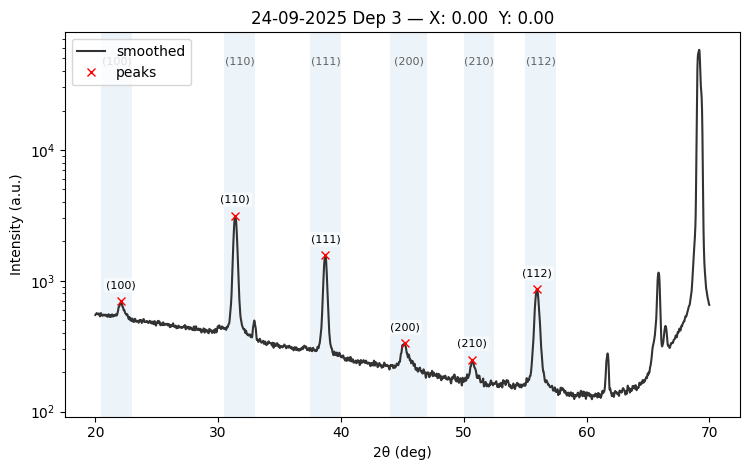


BTO_Mapping_Theta2Theta_24-09-2025_001_02_10-000_0-000.xy  peaks: 5
  (110)    [R2]   31.390°   I≈2014.9   FWHM≈1.7696°   Area≈678.26
  (111)    [R3]   38.750°   I≈1581.5   FWHM≈1.4223°   Area≈505.82
  (200)    [R4]   45.090°   I≈277.6   FWHM≈1.4995°   Area≈77.24
  (210)    [R5]   50.800°   I≈208.0   FWHM≈1.3929°   Area≈31.82
  (112)    [R6]   56.020°   I≈908.8   FWHM≈1.7278°   Area≈390.24


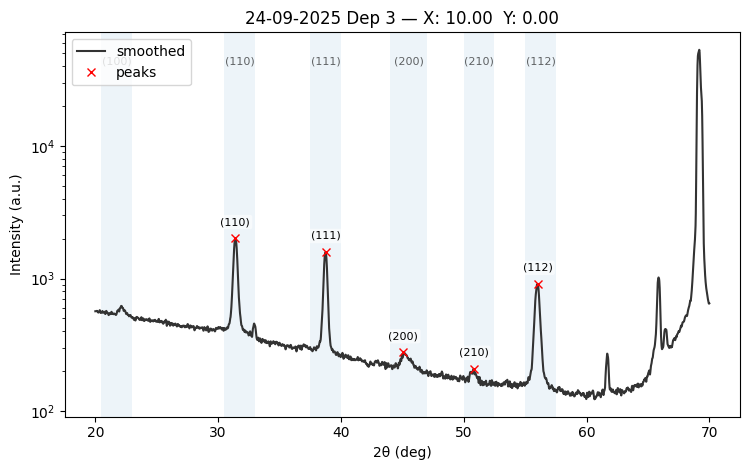


BTO_Mapping_Theta2Theta_24-09-2025_001_03_20-000_0-000.xy  peaks: 4
  (110)    [R2]   31.400°   I≈1551.4   FWHM≈1.7723°   Area≈501.95
  (111)    [R3]   38.760°   I≈1523.9   FWHM≈1.4104°   Area≈480.10
  (200)    [R4]   45.130°   I≈283.8   FWHM≈1.5732°   Area≈57.11
  (112)    [R6]   55.970°   I≈824.9   FWHM≈1.7221°   Area≈356.66


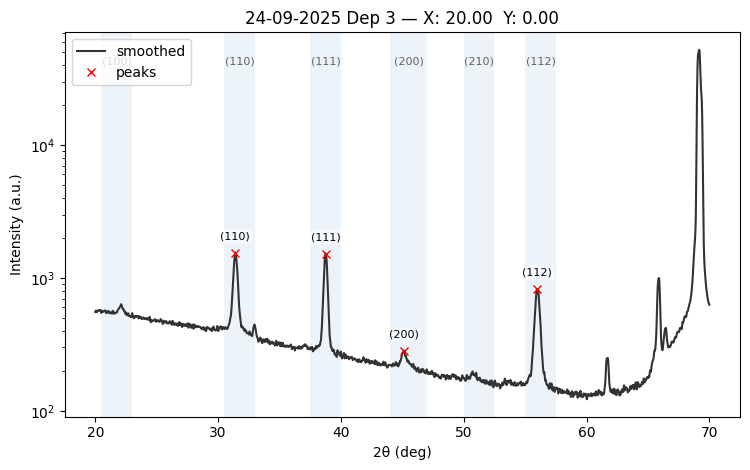


BTO_Mapping_Theta2Theta_24-09-2025_001_04_30-000_0-000.xy  peaks: 4
  (110)    [R2]   31.390°   I≈1327.0   FWHM≈1.8003°   Area≈439.20
  (111)    [R3]   38.760°   I≈1252.3   FWHM≈1.4294°   Area≈397.25
  (200)    [R4]   45.050°   I≈282.1   FWHM≈1.7220°   Area≈66.41
  (112)    [R6]   55.960°   I≈633.4   FWHM≈1.7644°   Area≈277.40


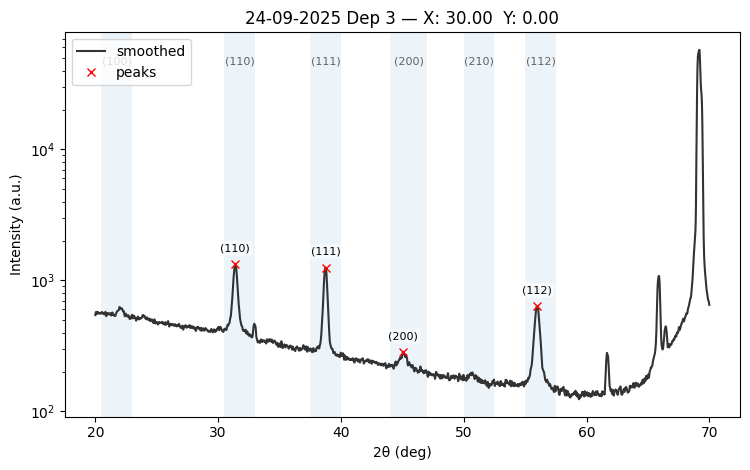


BTO_Mapping_Theta2Theta_24-09-2025_001_05_40-000_0-000.xy  peaks: 4
  (110)    [R2]   31.430°   I≈1121.2   FWHM≈1.8075°   Area≈351.91
  (111)    [R3]   38.690°   I≈952.0   FWHM≈1.4681°   Area≈303.62
  (200)    [R4]   45.030°   I≈288.7   FWHM≈1.8555°   Area≈68.78
  (112)    [R6]   55.900°   I≈461.6   FWHM≈1.8249°   Area≈202.14


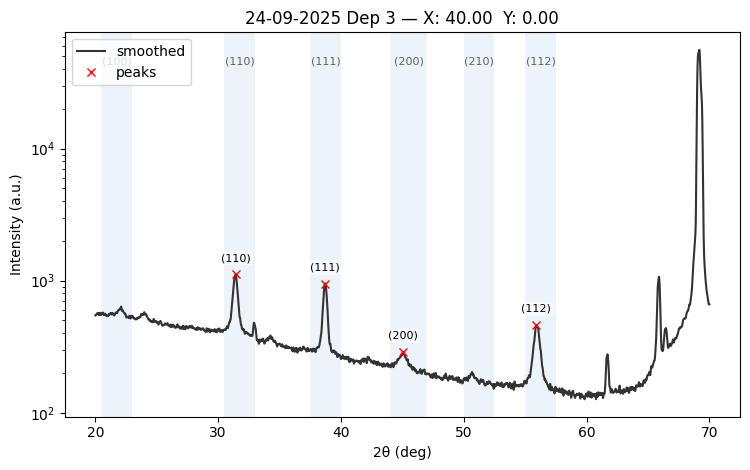


BTO_Mapping_Theta2Theta_24-09-2025_001_06_9-135_4-067.xy  peaks: 6
  (100)    [R1]   22.130°   I≈625.0   FWHM≈1.1351°   Area≈77.88
  (110)    [R2]   31.410°   I≈2050.6   FWHM≈1.7673°   Area≈702.69
  (111)    [R3]   38.740°   I≈1575.1   FWHM≈1.4219°   Area≈499.36
  (200)    [R4]   45.050°   I≈290.8   FWHM≈1.5416°   Area≈76.27
  (210)    [R5]   50.810°   I≈219.7   FWHM≈1.3368°   Area≈38.53
  (112)    [R6]   56.000°   I≈918.5   FWHM≈1.7251°   Area≈392.47


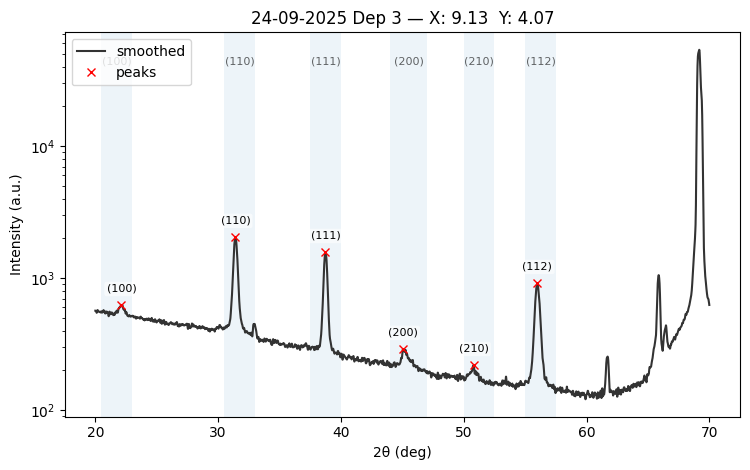


BTO_Mapping_Theta2Theta_24-09-2025_001_07_18-271_8-135.xy  peaks: 4
  (110)    [R2]   31.430°   I≈1588.0   FWHM≈1.7719°   Area≈539.95
  (111)    [R3]   38.760°   I≈1519.8   FWHM≈1.4099°   Area≈459.37
  (200)    [R4]   45.140°   I≈282.0   FWHM≈1.5800°   Area≈72.50
  (112)    [R6]   56.010°   I≈863.4   FWHM≈1.7140°   Area≈363.04


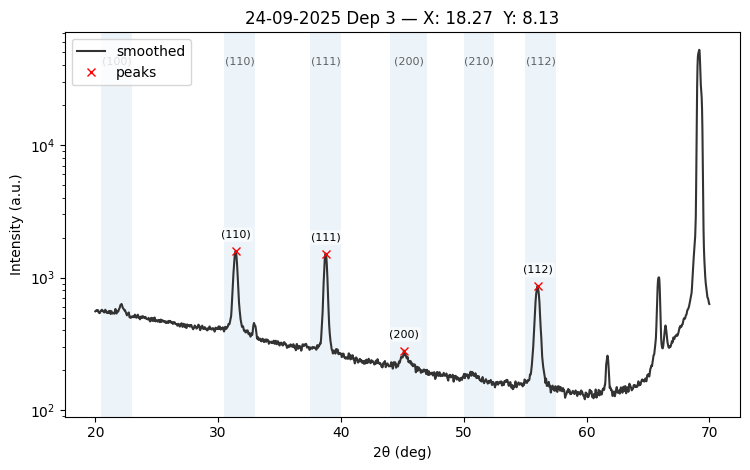


BTO_Mapping_Theta2Theta_24-09-2025_001_08_27-406_12-202.xy  peaks: 4
  (110)    [R2]   31.430°   I≈1390.6   FWHM≈1.7888°   Area≈470.66
  (111)    [R3]   38.750°   I≈1330.3   FWHM≈1.4108°   Area≈406.93
  (200)    [R4]   45.180°   I≈279.6   FWHM≈1.6626°   Area≈67.32
  (112)    [R6]   55.970°   I≈677.4   FWHM≈1.7600°   Area≈287.98


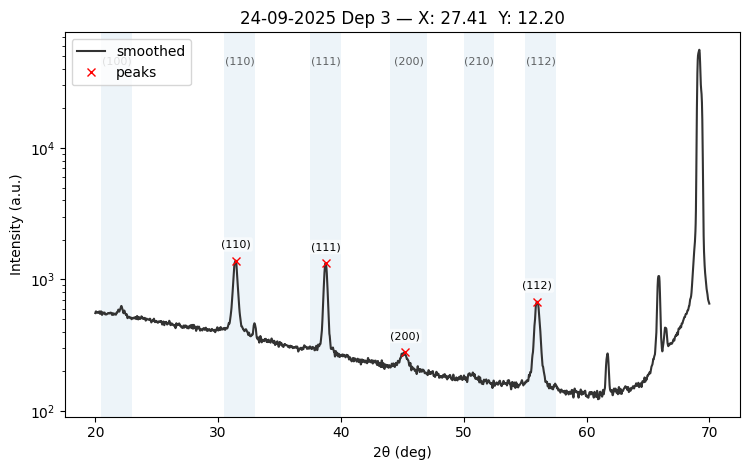


BTO_Mapping_Theta2Theta_24-09-2025_001_09_36-542_16-269.xy  peaks: 4
  (110)    [R2]   31.390°   I≈1158.1   FWHM≈1.7915°   Area≈373.90
  (111)    [R3]   38.730°   I≈1047.5   FWHM≈1.4394°   Area≈328.83
  (200)    [R4]   45.040°   I≈282.6   FWHM≈1.8233°   Area≈65.11
  (112)    [R6]   55.960°   I≈493.2   FWHM≈1.7965°   Area≈212.49


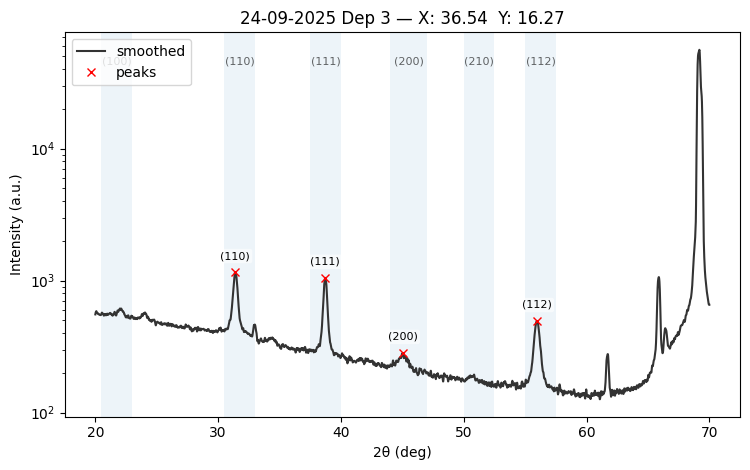


BTO_Mapping_Theta2Theta_24-09-2025_001_10_6-691_7-431.xy  peaks: 6
  (100)    [R1]   22.140°   I≈634.8   FWHM≈1.0891°   Area≈86.54
  (110)    [R2]   31.410°   I≈2286.8   FWHM≈1.7643°   Area≈779.96
  (111)    [R3]   38.740°   I≈1590.6   FWHM≈1.4204°   Area≈504.28
  (200)    [R4]   45.140°   I≈293.8   FWHM≈1.6066°   Area≈83.09
  (210)    [R5]   50.650°   I≈218.5   FWHM≈1.3904°   Area≈38.37
  (112)    [R6]   56.010°   I≈889.4   FWHM≈1.7202°   Area≈385.47


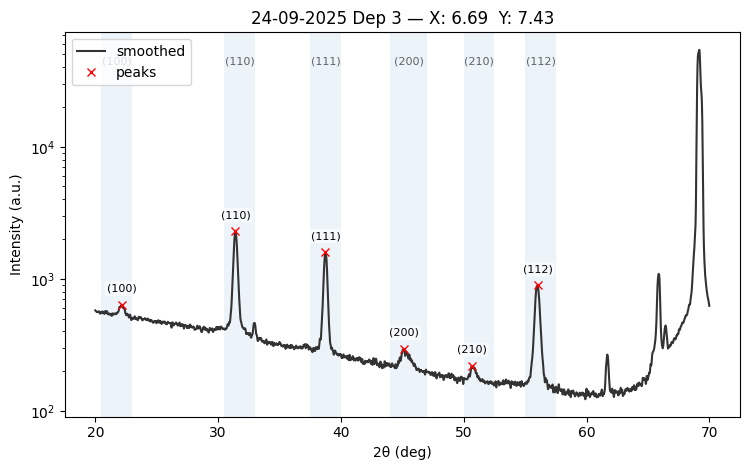


BTO_Mapping_Theta2Theta_24-09-2025_001_11_13-383_14-863.xy  peaks: 4
  (110)    [R2]   31.410°   I≈1745.5   FWHM≈1.7582°   Area≈576.00
  (111)    [R3]   38.760°   I≈1539.4   FWHM≈1.4075°   Area≈484.08
  (200)    [R4]   45.100°   I≈269.3   FWHM≈1.4662°   Area≈67.66
  (112)    [R6]   55.980°   I≈900.8   FWHM≈1.7110°   Area≈378.75


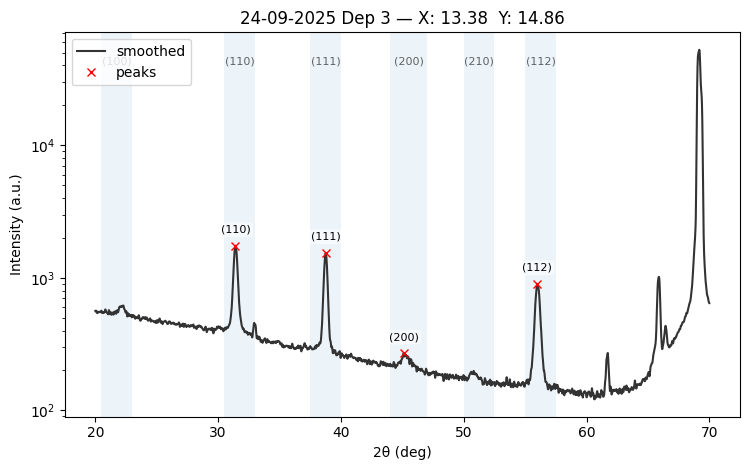


BTO_Mapping_Theta2Theta_24-09-2025_001_12_20-074_22-294.xy  peaks: 4
  (110)    [R2]   31.420°   I≈1534.7   FWHM≈1.7668°   Area≈512.12
  (111)    [R3]   38.780°   I≈1465.2   FWHM≈1.3982°   Area≈447.12
  (200)    [R4]   45.160°   I≈285.0   FWHM≈1.5788°   Area≈70.40
  (112)    [R6]   56.030°   I≈813.4   FWHM≈1.7073°   Area≈336.33


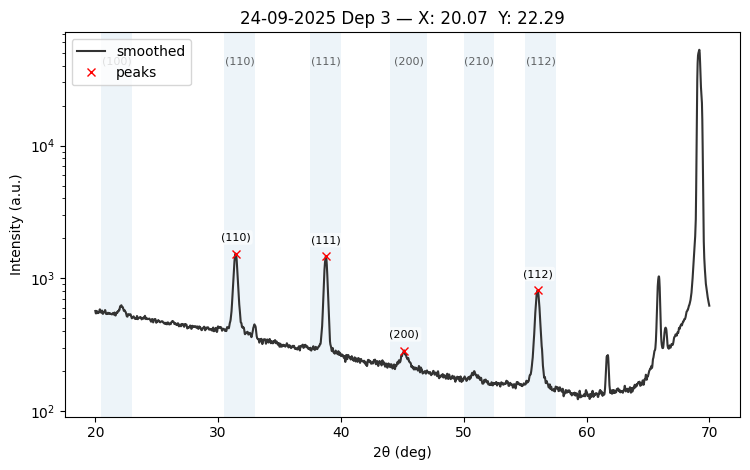


BTO_Mapping_Theta2Theta_24-09-2025_001_13_26-765_29-726.xy  peaks: 5
  (110)    [R2]   31.430°   I≈1336.1   FWHM≈1.7747°   Area≈451.90
  (111)    [R3]   38.750°   I≈1256.8   FWHM≈1.4137°   Area≈388.10
  (200)    [R4]   45.160°   I≈273.5   FWHM≈1.6488°   Area≈53.66
  (210)    [R5]   50.700°   I≈210.0   FWHM≈1.2609°   Area≈35.11
  (112)    [R6]   56.010°   I≈640.6   FWHM≈1.7362°   Area≈270.06


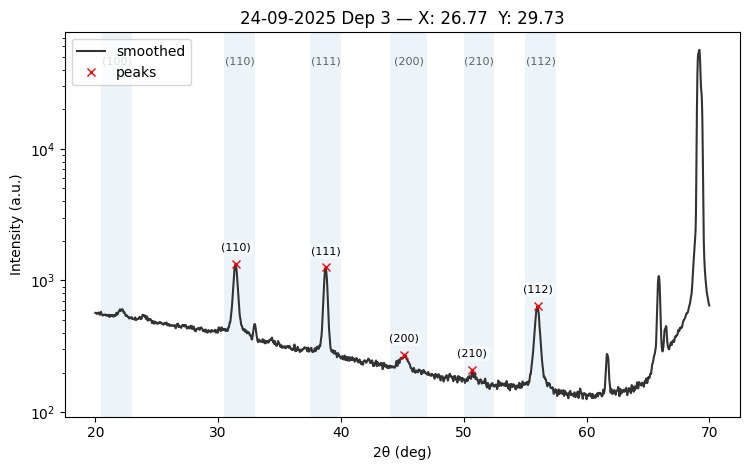


BTO_Mapping_Theta2Theta_24-09-2025_001_14_3-090_9-511.xy  peaks: 6
  (100)    [R1]   22.150°   I≈669.6   FWHM≈1.1036°   Area≈90.74
  (110)    [R2]   31.400°   I≈2669.3   FWHM≈1.7678°   Area≈917.04
  (111)    [R3]   38.740°   I≈1563.7   FWHM≈1.4307°   Area≈502.22
  (200)    [R4]   45.160°   I≈314.6   FWHM≈1.7646°   Area≈92.87
  (210)    [R5]   50.730°   I≈230.5   FWHM≈1.4824°   Area≈52.83
  (112)    [R6]   55.970°   I≈854.5   FWHM≈1.7351°   Area≈373.86


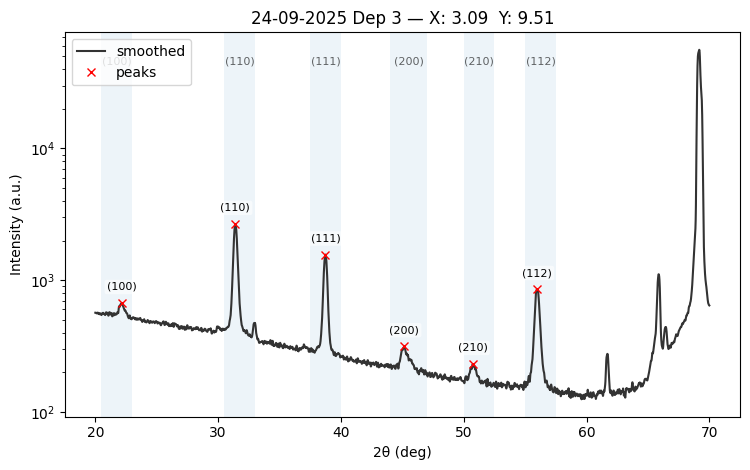


BTO_Mapping_Theta2Theta_24-09-2025_001_15_6-180_19-021.xy  peaks: 6
  (100)    [R1]   22.070°   I≈632.7   FWHM≈1.1027°   Area≈71.76
  (110)    [R2]   31.420°   I≈2066.6   FWHM≈1.7595°   Area≈691.74
  (111)    [R3]   38.750°   I≈1600.4   FWHM≈1.4110°   Area≈501.00
  (200)    [R4]   45.140°   I≈294.7   FWHM≈1.5606°   Area≈89.08
  (210)    [R5]   50.680°   I≈213.5   FWHM≈1.3597°   Area≈32.59
  (112)    [R6]   56.030°   I≈896.6   FWHM≈1.7150°   Area≈393.71


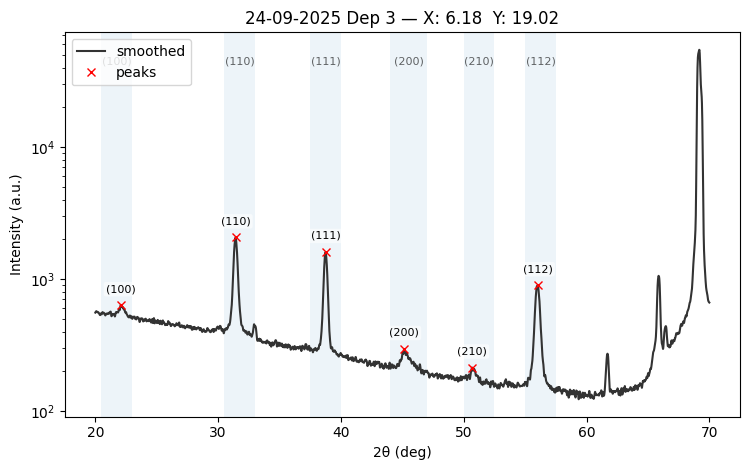


BTO_Mapping_Theta2Theta_24-09-2025_001_16_9-271_28-532.xy  peaks: 5
  (110)    [R2]   31.430°   I≈1782.0   FWHM≈1.7464°   Area≈569.98
  (111)    [R3]   38.760°   I≈1569.8   FWHM≈1.3969°   Area≈483.43
  (200)    [R4]   45.140°   I≈273.9   FWHM≈1.3945°   Area≈60.32
  (210)    [R5]   50.790°   I≈203.1   FWHM≈1.2500°   Area≈38.48
  (112)    [R6]   56.020°   I≈891.1   FWHM≈1.6994°   Area≈378.08


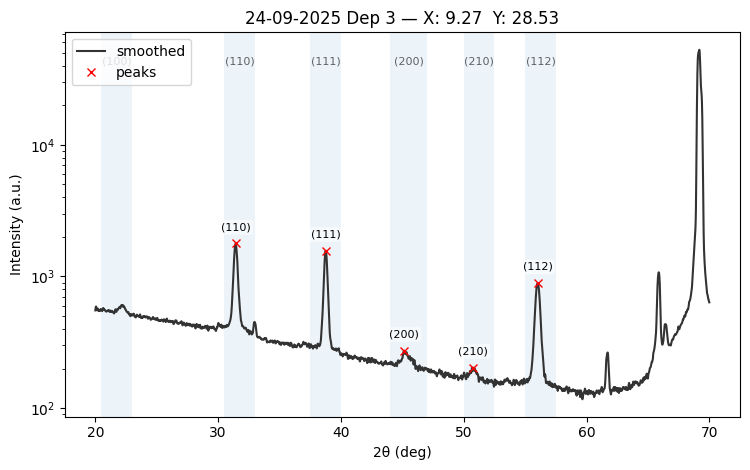


BTO_Mapping_Theta2Theta_24-09-2025_001_17_12-361_38-042.xy  peaks: 4
  (110)    [R2]   31.420°   I≈1569.0   FWHM≈1.7475°   Area≈520.49
  (111)    [R3]   38.780°   I≈1502.2   FWHM≈1.3851°   Area≈461.08
  (200)    [R4]   45.160°   I≈279.6   FWHM≈1.5100°   Area≈68.68
  (112)    [R6]   56.020°   I≈836.2   FWHM≈1.6945°   Area≈352.98


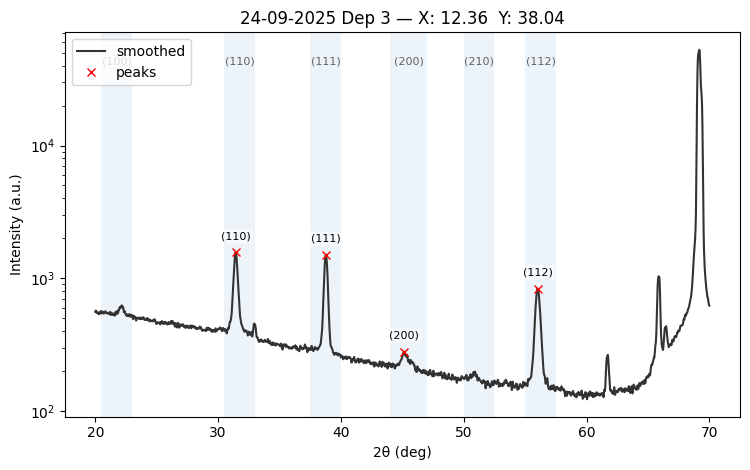


BTO_Mapping_Theta2Theta_24-09-2025_001_18_-1-045_9-945.xy  peaks: 6
  (100)    [R1]   22.070°   I≈691.5   FWHM≈1.0946°   Area≈105.56
  (110)    [R2]   31.400°   I≈3137.6   FWHM≈1.7714°   Area≈1100.57
  (111)    [R3]   38.730°   I≈1572.3   FWHM≈1.4320°   Area≈503.35
  (200)    [R4]   45.140°   I≈335.2   FWHM≈1.8607°   Area≈109.08
  (210)    [R5]   50.750°   I≈251.4   FWHM≈1.6062°   Area≈56.49
  (112)    [R6]   55.990°   I≈852.9   FWHM≈1.7387°   Area≈356.70


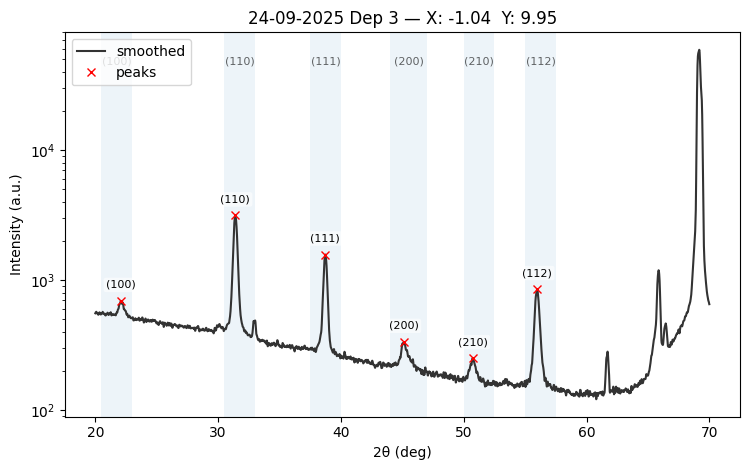


BTO_Mapping_Theta2Theta_24-09-2025_001_19_-2-091_19-890.xy  peaks: 6
  (100)    [R1]   22.110°   I≈686.2   FWHM≈1.1356°   Area≈94.06
  (110)    [R2]   31.400°   I≈2995.7   FWHM≈1.7658°   Area≈1057.42
  (111)    [R3]   38.750°   I≈1604.7   FWHM≈1.4202°   Area≈492.76
  (200)    [R4]   45.090°   I≈335.1   FWHM≈1.8479°   Area≈106.70
  (210)    [R5]   50.770°   I≈240.5   FWHM≈1.5625°   Area≈50.18
  (112)    [R6]   55.970°   I≈873.3   FWHM≈1.7263°   Area≈351.36


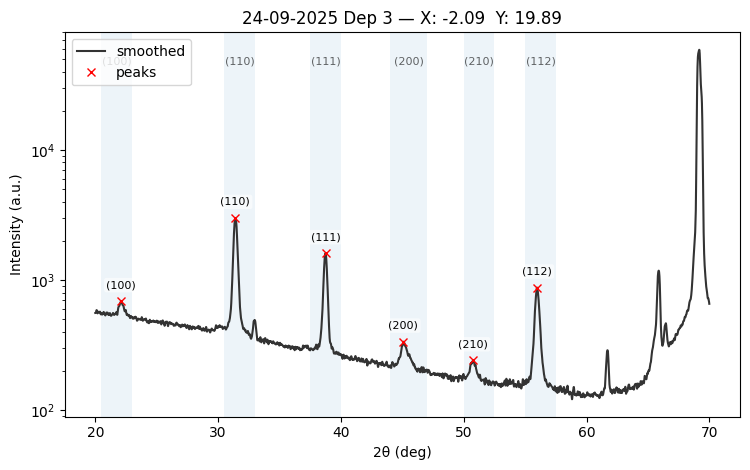


BTO_Mapping_Theta2Theta_24-09-2025_001_20_-3-136_29-836.xy  peaks: 6
  (100)    [R1]   22.080°   I≈693.4   FWHM≈1.0728°   Area≈100.97
  (110)    [R2]   31.420°   I≈2739.5   FWHM≈1.7560°   Area≈943.05
  (111)    [R3]   38.740°   I≈1606.8   FWHM≈1.4161°   Area≈504.16
  (200)    [R4]   45.220°   I≈327.8   FWHM≈1.7808°   Area≈117.10
  (210)    [R5]   50.690°   I≈247.9   FWHM≈1.5404°   Area≈56.23
  (112)    [R6]   55.990°   I≈881.1   FWHM≈1.7142°   Area≈372.27


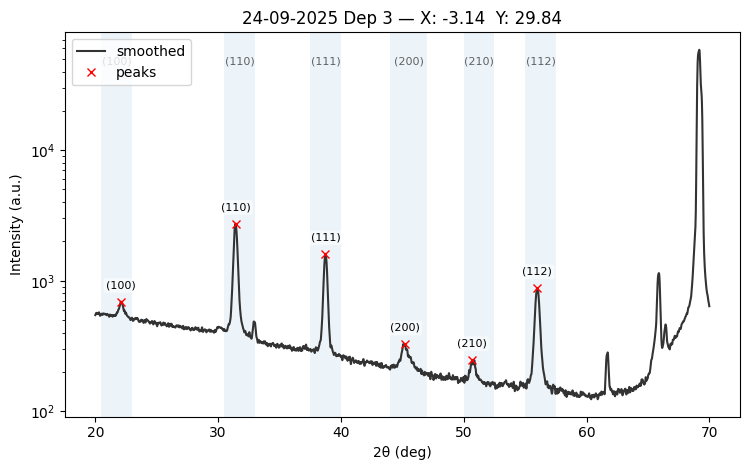


BTO_Mapping_Theta2Theta_24-09-2025_001_21_-4-181_39-781.xy  peaks: 6
  (100)    [R1]   22.180°   I≈665.4   FWHM≈1.0861°   Area≈80.30
  (110)    [R2]   31.420°   I≈2276.4   FWHM≈1.7470°   Area≈775.26
  (111)    [R3]   38.760°   I≈1628.3   FWHM≈1.3967°   Area≈507.36
  (200)    [R4]   45.180°   I≈318.0   FWHM≈1.7178°   Area≈89.81
  (210)    [R5]   50.750°   I≈241.9   FWHM≈1.5248°   Area≈45.51
  (112)    [R6]   56.010°   I≈902.6   FWHM≈1.6975°   Area≈385.22


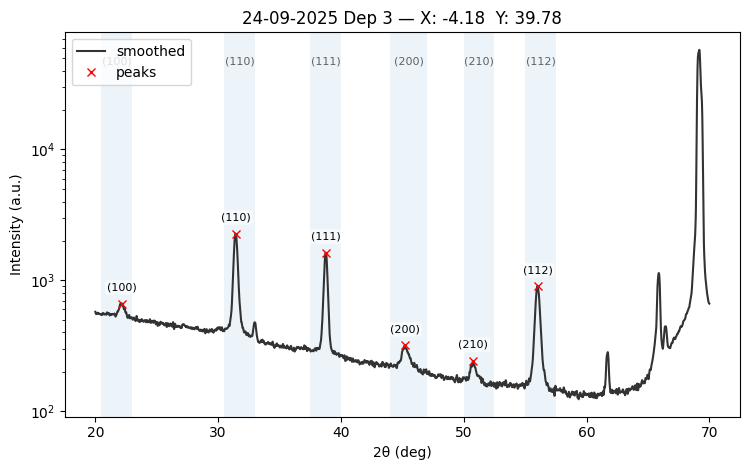


BTO_Mapping_Theta2Theta_24-09-2025_001_22_-5-000_8-660.xy  peaks: 6
  (100)    [R1]   22.090°   I≈748.2   FWHM≈1.1064°   Area≈134.89
  (110)    [R2]   31.400°   I≈3502.7   FWHM≈1.7760°   Area≈1230.76
  (111)    [R3]   38.710°   I≈1474.8   FWHM≈1.4487°   Area≈468.79
  (200)    [R4]   45.020°   I≈367.4   FWHM≈2.0484°   Area≈126.22
  (210)    [R5]   50.650°   I≈267.8   FWHM≈1.7356°   Area≈67.93
  (112)    [R6]   55.950°   I≈818.4   FWHM≈1.7550°   Area≈323.85


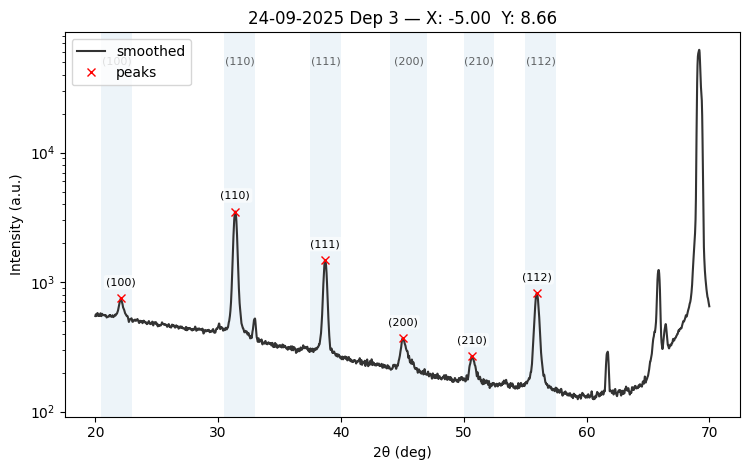


BTO_Mapping_Theta2Theta_24-09-2025_001_23_-10-000_17-321.xy  peaks: 6
  (100)    [R1]   22.050°   I≈799.2   FWHM≈1.1109°   Area≈160.82
  (110)    [R2]   31.400°   I≈3637.3   FWHM≈1.7735°   Area≈1255.96
  (111)    [R3]   38.720°   I≈1408.8   FWHM≈1.4568°   Area≈460.33
  (200)    [R4]   45.110°   I≈411.9   FWHM≈2.1277°   Area≈141.19
  (210)    [R5]   50.690°   I≈283.6   FWHM≈1.7910°   Area≈66.46
  (112)    [R6]   55.910°   I≈804.0   FWHM≈1.7537°   Area≈342.17


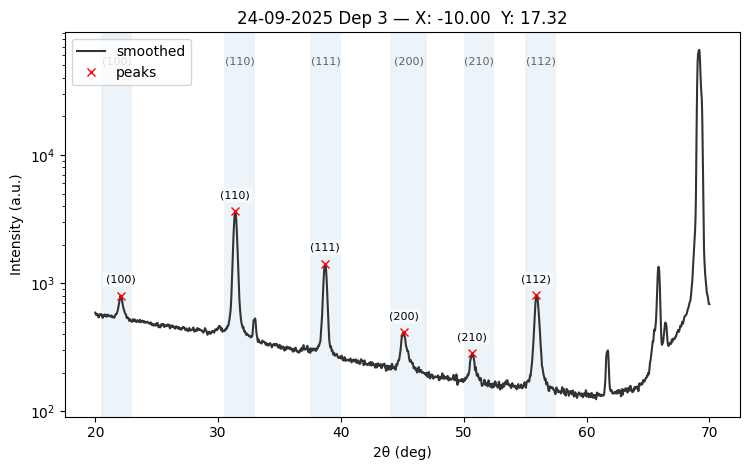


BTO_Mapping_Theta2Theta_24-09-2025_001_24_-15-000_25-981.xy  peaks: 6
  (100)    [R1]   22.050°   I≈814.3   FWHM≈1.1083°   Area≈123.76
  (110)    [R2]   31.390°   I≈3617.6   FWHM≈1.7725°   Area≈1240.22
  (111)    [R3]   38.720°   I≈1331.2   FWHM≈1.4548°   Area≈416.60
  (200)    [R4]   45.030°   I≈448.4   FWHM≈2.1304°   Area≈174.49
  (210)    [R5]   50.680°   I≈290.9   FWHM≈1.8224°   Area≈68.79
  (112)    [R6]   55.960°   I≈797.7   FWHM≈1.7566°   Area≈332.50


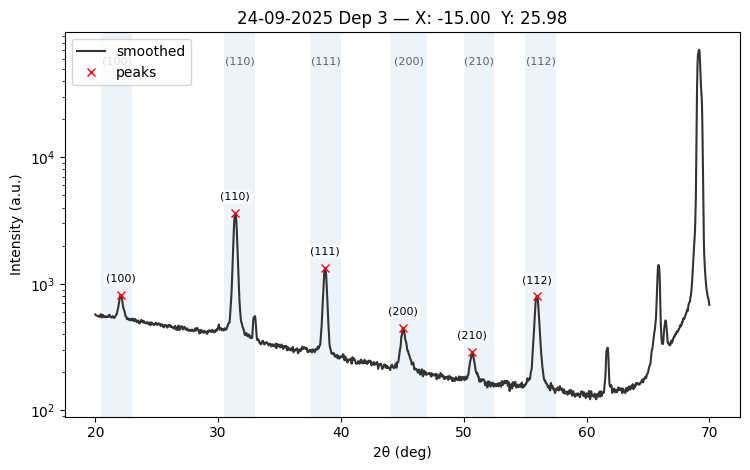


BTO_Mapping_Theta2Theta_24-09-2025_001_25_-20-000_34-641.xy  peaks: 6
  (100)    [R1]   22.100°   I≈823.9   FWHM≈1.1031°   Area≈135.34
  (110)    [R2]   31.410°   I≈3583.5   FWHM≈1.7613°   Area≈1250.38
  (111)    [R3]   38.740°   I≈1246.3   FWHM≈1.4382°   Area≈385.93
  (200)    [R4]   45.060°   I≈464.5   FWHM≈2.1124°   Area≈163.41
  (210)    [R5]   50.780°   I≈294.7   FWHM≈1.7998°   Area≈74.16
  (112)    [R6]   55.990°   I≈812.5   FWHM≈1.7461°   Area≈340.65


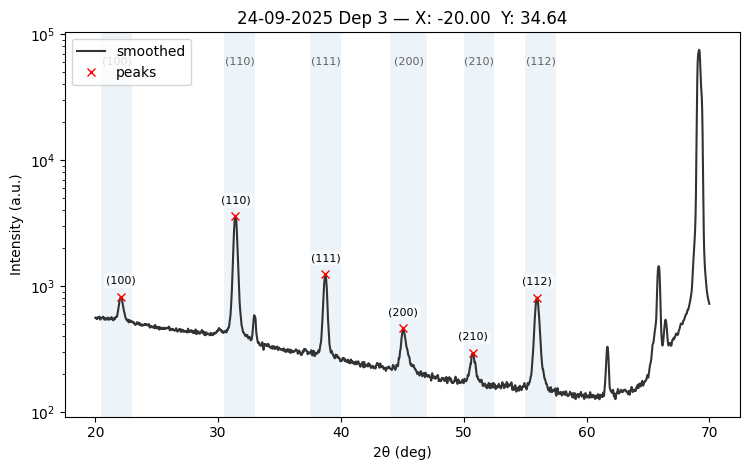


BTO_Mapping_Theta2Theta_24-09-2025_001_26_-8-090_5-878.xy  peaks: 6
  (100)    [R1]   22.110°   I≈765.9   FWHM≈1.1015°   Area≈126.21
  (110)    [R2]   31.380°   I≈3652.3   FWHM≈1.7814°   Area≈1270.22
  (111)    [R3]   38.700°   I≈1415.1   FWHM≈1.4606°   Area≈455.71
  (200)    [R4]   45.060°   I≈409.2   FWHM≈2.1403°   Area≈135.04
  (210)    [R5]   50.660°   I≈276.9   FWHM≈1.7989°   Area≈63.83
  (112)    [R6]   55.940°   I≈794.2   FWHM≈1.7629°   Area≈331.78


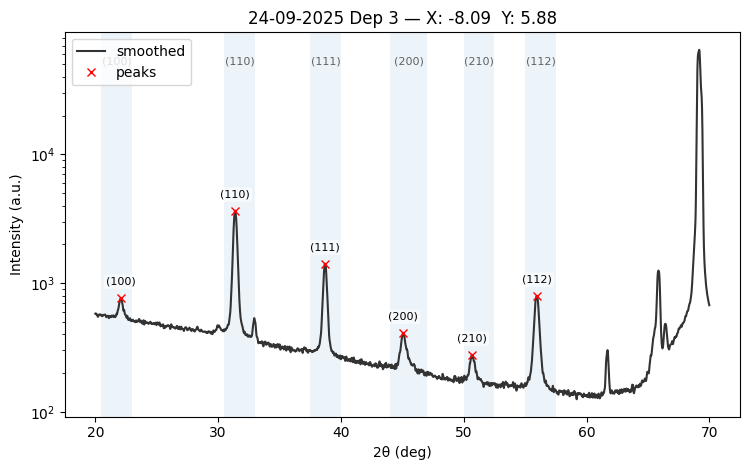


BTO_Mapping_Theta2Theta_24-09-2025_001_27_-16-180_11-756.xy  peaks: 6
  (100)    [R1]   22.050°   I≈891.7   FWHM≈1.1175°   Area≈195.10
  (110)    [R2]   31.370°   I≈3460.3   FWHM≈1.7903°   Area≈1207.57
  (111)    [R3]   38.680°   I≈1237.6   FWHM≈1.4816°   Area≈400.97
  (200)    [R4]   44.990°   I≈518.3   FWHM≈2.1722°   Area≈194.86
  (210)    [R5]   50.700°   I≈286.6   FWHM≈1.8501°   Area≈65.29
  (112)    [R6]   55.930°   I≈817.2   FWHM≈1.7860°   Area≈341.27


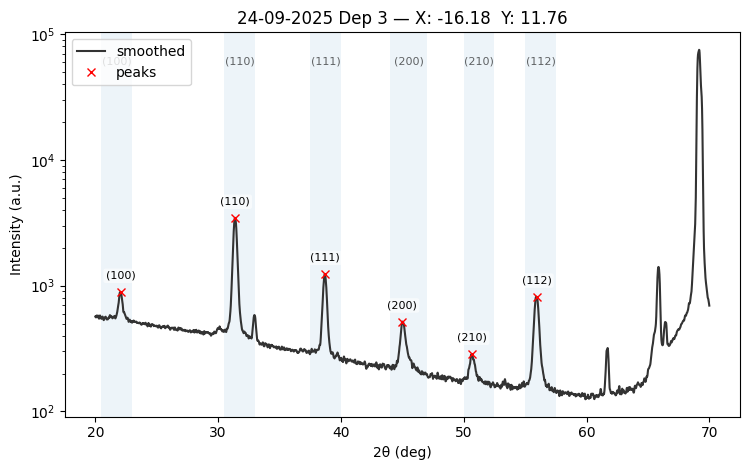


BTO_Mapping_Theta2Theta_24-09-2025_001_28_-24-271_17-634.xy  peaks: 6
  (100)    [R1]   22.030°   I≈990.0   FWHM≈1.1323°   Area≈206.81
  (110)    [R2]   31.370°   I≈3607.2   FWHM≈1.7918°   Area≈1258.73
  (111)    [R3]   38.700°   I≈1051.7   FWHM≈1.4871°   Area≈325.06
  (200)    [R4]   45.040°   I≈629.9   FWHM≈2.1893°   Area≈240.78
  (210)    [R5]   50.690°   I≈305.0   FWHM≈1.8969°   Area≈77.46
  (112)    [R6]   55.910°   I≈875.0   FWHM≈1.7921°   Area≈363.83


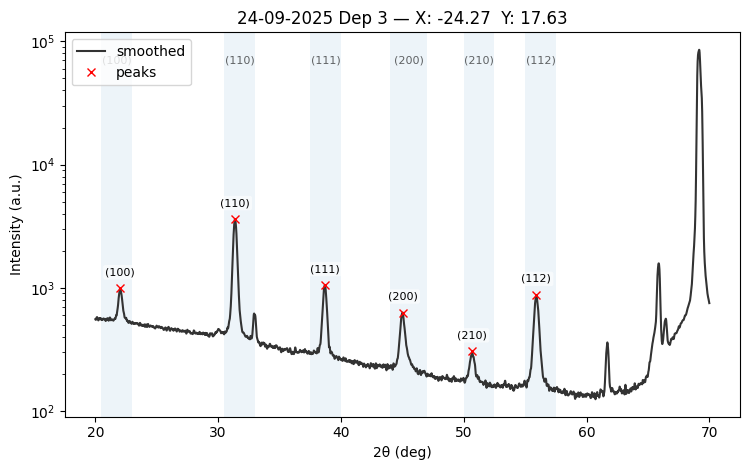


BTO_Mapping_Theta2Theta_24-09-2025_001_29_-32-361_23-511.xy  peaks: 6
  (100)    [R1]   22.020°   I≈1008.0   FWHM≈1.1471°   Area≈214.30
  (110)    [R2]   31.370°   I≈4431.1   FWHM≈1.8028°   Area≈1523.21
  (111)    [R3]   38.690°   I≈873.4   FWHM≈1.5024°   Area≈258.92
  (200)    [R4]   44.980°   I≈639.0   FWHM≈2.2202°   Area≈246.76
  (210)    [R5]   50.640°   I≈301.1   FWHM≈1.9426°   Area≈79.26
  (112)    [R6]   55.880°   I≈842.5   FWHM≈1.8300°   Area≈355.27


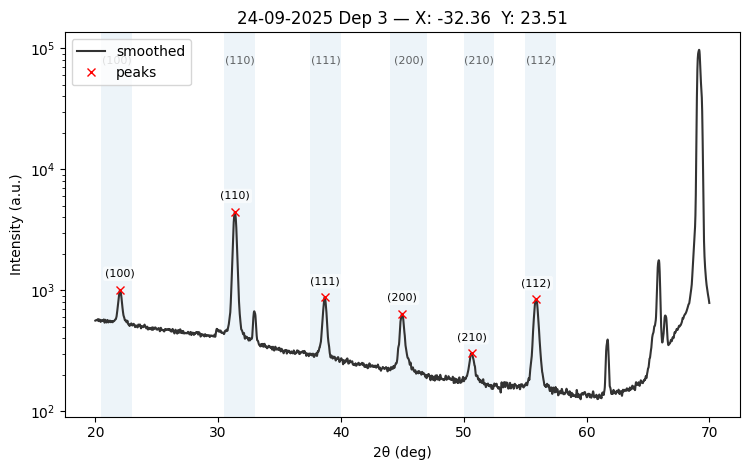


BTO_Mapping_Theta2Theta_24-09-2025_001_30_-9-781_2-079.xy  peaks: 6
  (100)    [R1]   22.010°   I≈798.0   FWHM≈1.1078°   Area≈147.87
  (110)    [R2]   31.390°   I≈3680.1   FWHM≈1.7854°   Area≈1275.91
  (111)    [R3]   38.690°   I≈1362.0   FWHM≈1.4717°   Area≈456.40
  (200)    [R4]   45.030°   I≈439.2   FWHM≈2.1439°   Area≈154.86
  (210)    [R5]   50.760°   I≈279.7   FWHM≈1.7853°   Area≈73.45
  (112)    [R6]   55.950°   I≈819.9   FWHM≈1.7737°   Area≈331.73


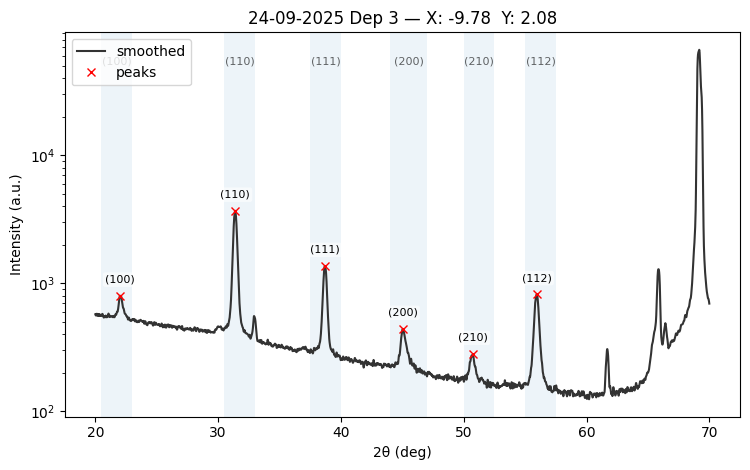


BTO_Mapping_Theta2Theta_24-09-2025_001_31_-19-563_4-158.xy  peaks: 6
  (100)    [R1]   22.040°   I≈953.9   FWHM≈1.1336°   Area≈211.73
  (110)    [R2]   31.370°   I≈3437.1   FWHM≈1.8036°   Area≈1209.34
  (111)    [R3]   38.690°   I≈1135.8   FWHM≈1.4936°   Area≈350.57
  (200)    [R4]   44.990°   I≈588.1   FWHM≈2.1817°   Area≈210.66
  (210)    [R5]   50.750°   I≈289.1   FWHM≈1.8643°   Area≈71.54
  (112)    [R6]   55.920°   I≈857.6   FWHM≈1.7946°   Area≈367.28


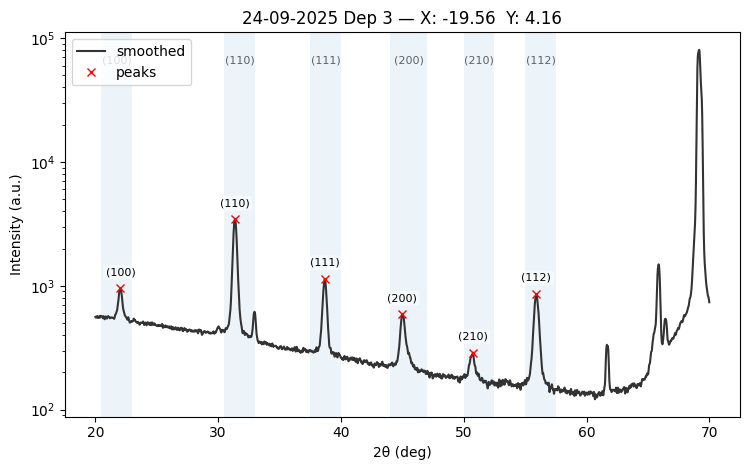


BTO_Mapping_Theta2Theta_24-09-2025_001_32_-29-344_6-237.xy  peaks: 6
  (100)    [R1]   22.030°   I≈1024.1   FWHM≈1.1619°   Area≈233.82
  (110)    [R2]   31.350°   I≈3960.0   FWHM≈1.8165°   Area≈1369.26
  (111)    [R3]   38.630°   I≈914.4   FWHM≈1.5188°   Area≈261.80
  (200)    [R4]   44.950°   I≈667.0   FWHM≈2.2137°   Area≈244.28
  (210)    [R5]   50.630°   I≈302.8   FWHM≈2.0060°   Area≈72.29
  (112)    [R6]   55.890°   I≈873.5   FWHM≈1.8418°   Area≈374.65


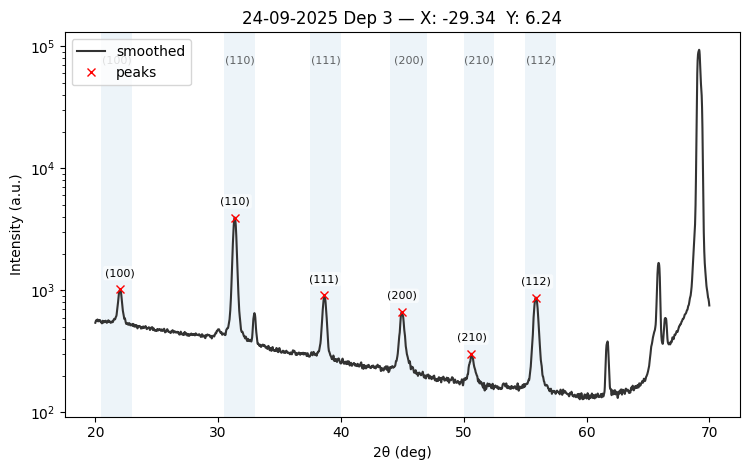


BTO_Mapping_Theta2Theta_24-09-2025_001_33_-39-126_8-316.xy  peaks: 6
  (100)    [R1]   21.950°   I≈1003.3   FWHM≈1.2135°   Area≈218.84
  (110)    [R2]   31.270°   I≈4595.5   FWHM≈1.8924°   Area≈1571.80
  (111)    [R3]   38.590°   I≈677.5   FWHM≈1.6149°   Area≈192.21
  (200)    [R4]   44.880°   I≈635.7   FWHM≈2.3944°   Area≈256.96
  (210)    [R5]   50.580°   I≈314.5   FWHM≈2.2152°   Area≈76.53
  (112)    [R6]   55.760°   I≈794.6   FWHM≈1.9651°   Area≈327.88


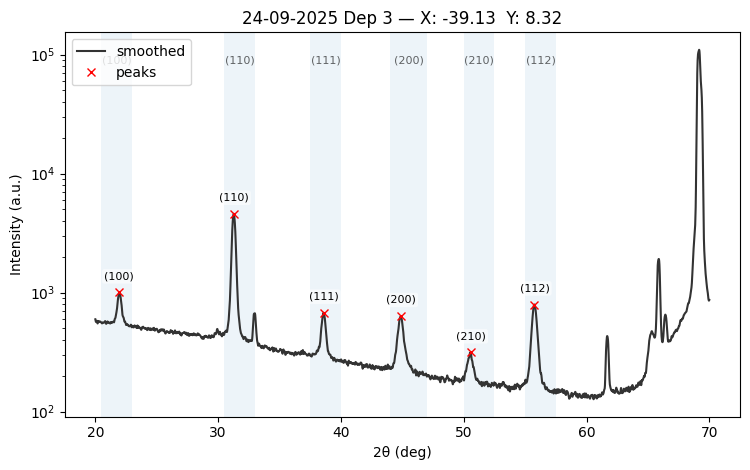


BTO_Mapping_Theta2Theta_24-09-2025_001_34_-9-781_-2-079.xy  peaks: 6
  (100)    [R1]   22.060°   I≈795.8   FWHM≈1.1289°   Area≈136.92
  (110)    [R2]   31.380°   I≈3654.6   FWHM≈1.7900°   Area≈1275.49
  (111)    [R3]   38.700°   I≈1371.2   FWHM≈1.4700°   Area≈428.00
  (200)    [R4]   45.020°   I≈427.7   FWHM≈2.1530°   Area≈149.53
  (210)    [R5]   50.690°   I≈283.5   FWHM≈1.7751°   Area≈64.75
  (112)    [R6]   55.970°   I≈819.1   FWHM≈1.7755°   Area≈337.46


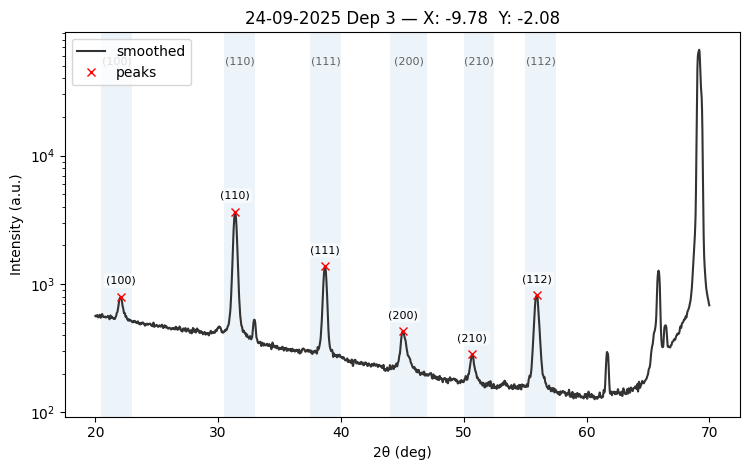


BTO_Mapping_Theta2Theta_24-09-2025_001_35_-19-563_-4-158.xy  peaks: 6
  (100)    [R1]   22.030°   I≈957.8   FWHM≈1.1345°   Area≈195.27
  (110)    [R2]   31.380°   I≈3453.7   FWHM≈1.8012°   Area≈1209.16
  (111)    [R3]   38.670°   I≈1133.0   FWHM≈1.4973°   Area≈349.51
  (200)    [R4]   45.010°   I≈588.0   FWHM≈2.2006°   Area≈210.13
  (210)    [R5]   50.600°   I≈287.4   FWHM≈1.8738°   Area≈59.83
  (112)    [R6]   55.930°   I≈884.7   FWHM≈1.8011°   Area≈368.78


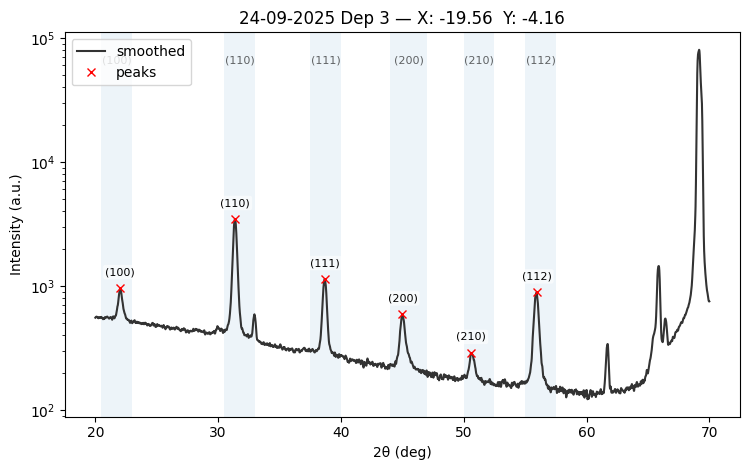


BTO_Mapping_Theta2Theta_24-09-2025_001_36_-29-344_-6-237.xy  peaks: 6
  (100)    [R1]   22.000°   I≈1037.3   FWHM≈1.1578°   Area≈199.74
  (110)    [R2]   31.340°   I≈3967.5   FWHM≈1.8225°   Area≈1345.41
  (111)    [R3]   38.640°   I≈905.5   FWHM≈1.5320°   Area≈275.26
  (200)    [R4]   44.950°   I≈650.4   FWHM≈2.2537°   Area≈259.33
  (210)    [R5]   50.650°   I≈297.5   FWHM≈1.9866°   Area≈72.34
  (112)    [R6]   55.910°   I≈880.7   FWHM≈1.8491°   Area≈375.93


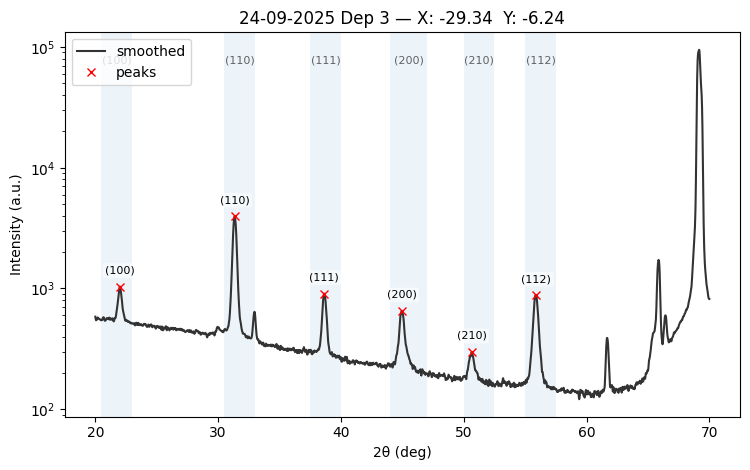


BTO_Mapping_Theta2Theta_24-09-2025_001_37_-39-126_-8-316.xy  peaks: 6
  (100)    [R1]   21.950°   I≈1016.7   FWHM≈1.2293°   Area≈219.80
  (110)    [R2]   31.240°   I≈4890.8   FWHM≈1.9192°   Area≈1618.70
  (111)    [R3]   38.560°   I≈682.3   FWHM≈1.6387°   Area≈189.14
  (200)    [R4]   44.840°   I≈646.9   FWHM≈2.4358°   Area≈257.36
  (210)    [R5]   50.470°   I≈304.1   FWHM≈2.2514°   Area≈62.15
  (112)    [R6]   55.700°   I≈792.0   FWHM≈2.0244°   Area≈325.00


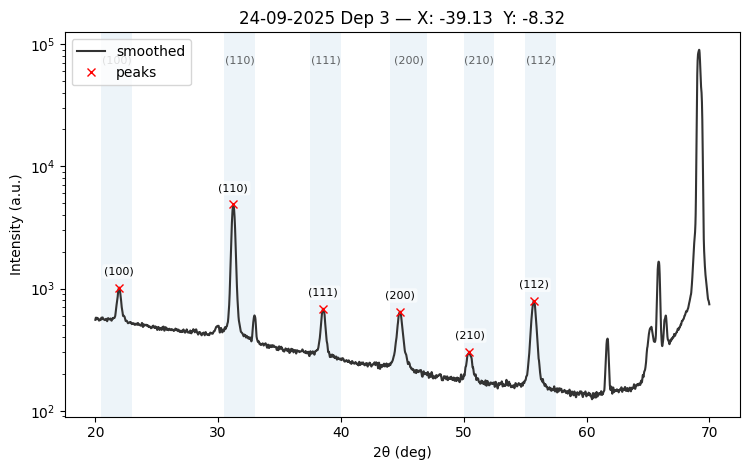


BTO_Mapping_Theta2Theta_24-09-2025_001_38_-8-090_-5-878.xy  peaks: 6
  (100)    [R1]   22.040°   I≈764.8   FWHM≈1.1274°   Area≈114.38
  (110)    [R2]   31.380°   I≈3637.4   FWHM≈1.7884°   Area≈1285.12
  (111)    [R3]   38.700°   I≈1420.5   FWHM≈1.4680°   Area≈466.67
  (200)    [R4]   45.070°   I≈419.8   FWHM≈2.1487°   Area≈148.97
  (210)    [R5]   50.670°   I≈267.9   FWHM≈1.7160°   Area≈59.76
  (112)    [R6]   55.950°   I≈832.5   FWHM≈1.7728°   Area≈344.87


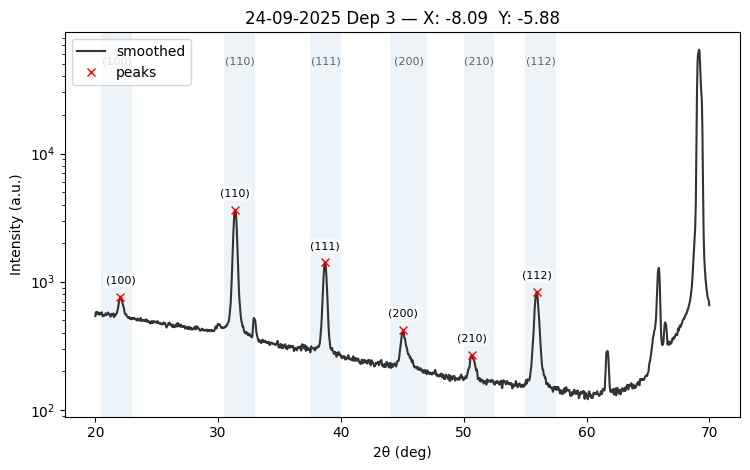


BTO_Mapping_Theta2Theta_24-09-2025_001_39_-16-180_-11-756.xy  peaks: 6
  (100)    [R1]   22.040°   I≈897.6   FWHM≈1.1238°   Area≈182.28
  (110)    [R2]   31.370°   I≈3555.8   FWHM≈1.7984°   Area≈1238.45
  (111)    [R3]   38.700°   I≈1247.3   FWHM≈1.4859°   Area≈399.38
  (200)    [R4]   45.020°   I≈509.3   FWHM≈2.1714°   Area≈201.30
  (210)    [R5]   50.670°   I≈283.0   FWHM≈1.8412°   Area≈64.58
  (112)    [R6]   55.920°   I≈850.2   FWHM≈1.7889°   Area≈362.08


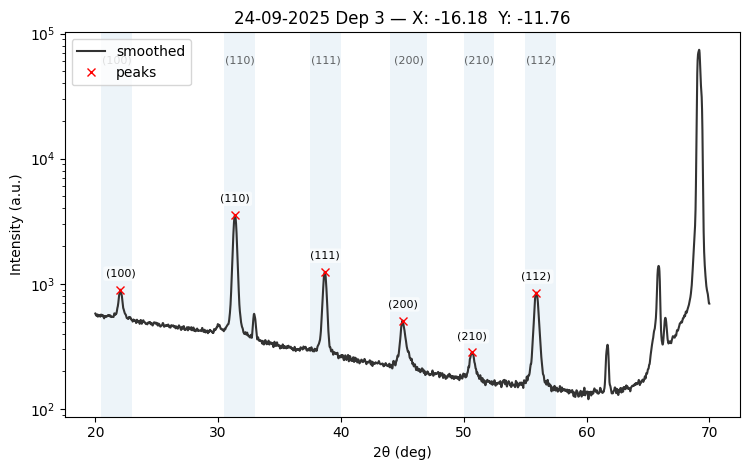


BTO_Mapping_Theta2Theta_24-09-2025_001_40_-24-271_-17-634.xy  peaks: 6
  (100)    [R1]   22.020°   I≈959.7   FWHM≈1.1541°   Area≈185.37
  (110)    [R2]   31.360°   I≈3591.5   FWHM≈1.8131°   Area≈1251.92
  (111)    [R3]   38.670°   I≈1074.8   FWHM≈1.5076°   Area≈342.14
  (200)    [R4]   44.950°   I≈616.3   FWHM≈2.2123°   Area≈230.02
  (210)    [R5]   50.600°   I≈287.0   FWHM≈1.9004°   Area≈66.80
  (112)    [R6]   55.910°   I≈922.8   FWHM≈1.8082°   Area≈367.26


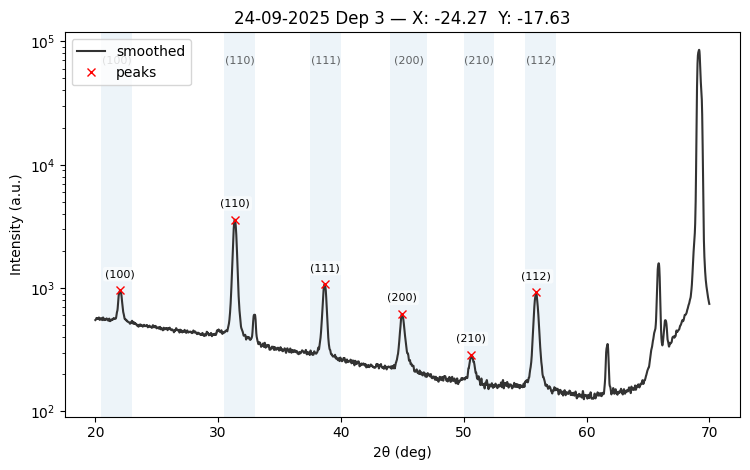


BTO_Mapping_Theta2Theta_24-09-2025_001_41_-32-361_-23-511.xy  peaks: 6
  (100)    [R1]   22.020°   I≈984.3   FWHM≈1.1839°   Area≈181.23
  (110)    [R2]   31.330°   I≈4524.2   FWHM≈1.8328°   Area≈1537.25
  (111)    [R3]   38.650°   I≈890.6   FWHM≈1.5327°   Area≈259.79
  (200)    [R4]   44.920°   I≈634.9   FWHM≈2.2802°   Area≈247.33
  (210)    [R5]   50.600°   I≈315.1   FWHM≈2.1046°   Area≈73.87
  (112)    [R6]   55.860°   I≈889.5   FWHM≈1.8639°   Area≈380.39


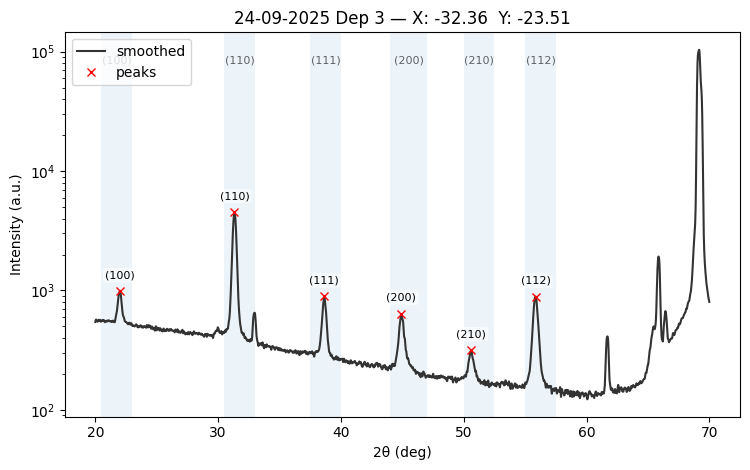


BTO_Mapping_Theta2Theta_24-09-2025_001_42_-5-000_-8-660.xy  peaks: 6
  (100)    [R1]   22.120°   I≈717.9   FWHM≈1.1126°   Area≈116.94
  (110)    [R2]   31.390°   I≈3502.4   FWHM≈1.7842°   Area≈1217.44
  (111)    [R3]   38.720°   I≈1507.4   FWHM≈1.4532°   Area≈486.89
  (200)    [R4]   45.050°   I≈361.5   FWHM≈2.0406°   Area≈127.57
  (210)    [R5]   50.670°   I≈267.2   FWHM≈1.7085°   Area≈58.80
  (112)    [R6]   55.920°   I≈844.1   FWHM≈1.7579°   Area≈350.92


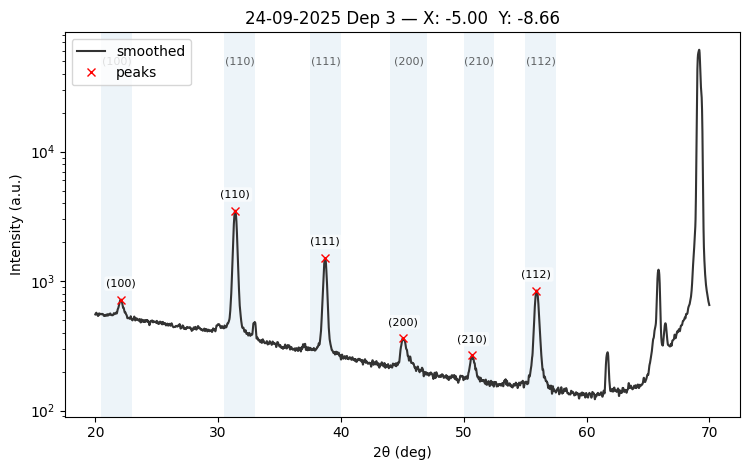


BTO_Mapping_Theta2Theta_24-09-2025_001_43_-10-000_-17-321.xy  peaks: 6
  (100)    [R1]   22.060°   I≈755.4   FWHM≈1.1159°   Area≈119.33
  (110)    [R2]   31.380°   I≈3686.9   FWHM≈1.7861°   Area≈1296.61
  (111)    [R3]   38.690°   I≈1431.3   FWHM≈1.4683°   Area≈469.27
  (200)    [R4]   45.070°   I≈403.1   FWHM≈2.1571°   Area≈139.03
  (210)    [R5]   50.750°   I≈270.7   FWHM≈1.7318°   Area≈64.83
  (112)    [R6]   55.920°   I≈853.4   FWHM≈1.7723°   Area≈356.81


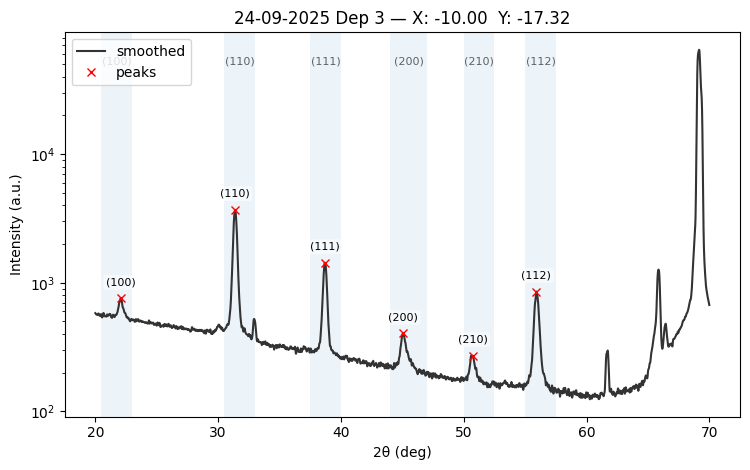


BTO_Mapping_Theta2Theta_24-09-2025_001_44_-15-000_-25-981.xy  peaks: 6
  (100)    [R1]   22.080°   I≈800.3   FWHM≈1.1547°   Area≈142.12
  (110)    [R2]   31.380°   I≈3692.0   FWHM≈1.7914°   Area≈1291.10
  (111)    [R3]   38.690°   I≈1409.8   FWHM≈1.4702°   Area≈458.49
  (200)    [R4]   45.050°   I≈434.5   FWHM≈2.1642°   Area≈152.08
  (210)    [R5]   50.640°   I≈275.8   FWHM≈1.7641°   Area≈56.89
  (112)    [R6]   55.930°   I≈856.5   FWHM≈1.7781°   Area≈351.23


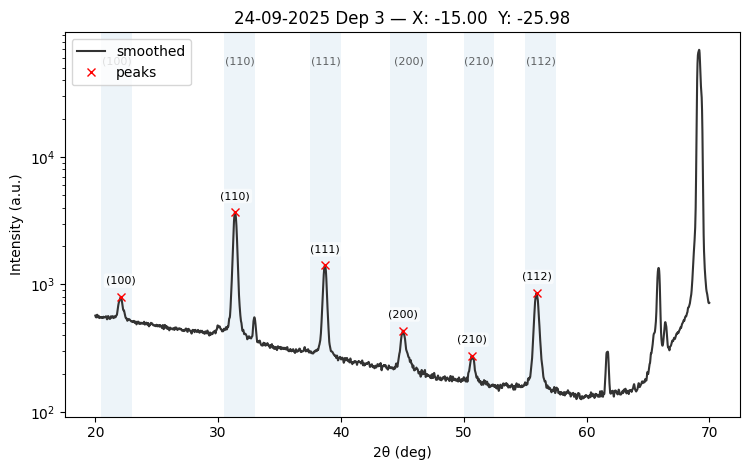


BTO_Mapping_Theta2Theta_24-09-2025_001_45_-20-000_-34-641.xy  peaks: 6
  (100)    [R1]   22.060°   I≈834.0   FWHM≈1.1424°   Area≈154.42
  (110)    [R2]   31.380°   I≈3833.8   FWHM≈1.7881°   Area≈1344.97
  (111)    [R3]   38.720°   I≈1353.5   FWHM≈1.4698°   Area≈422.48
  (200)    [R4]   45.030°   I≈468.3   FWHM≈2.1653°   Area≈174.95
  (210)    [R5]   50.660°   I≈298.2   FWHM≈1.8626°   Area≈74.03
  (112)    [R6]   55.920°   I≈843.2   FWHM≈1.7752°   Area≈345.65


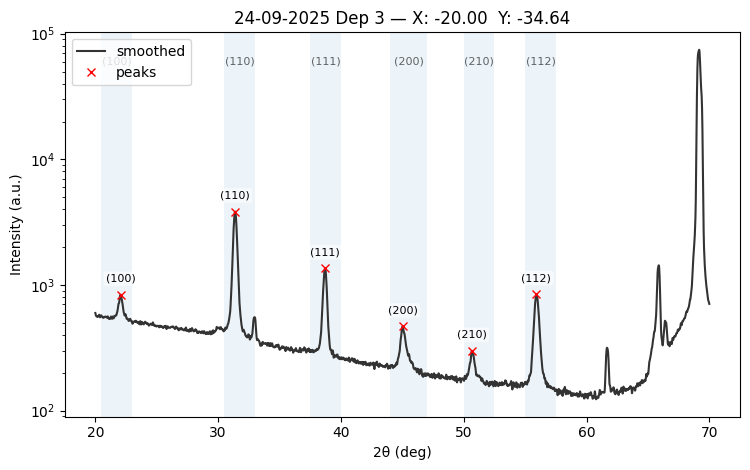


BTO_Mapping_Theta2Theta_24-09-2025_001_46_-1-045_-9-945.xy  peaks: 6
  (100)    [R1]   22.070°   I≈678.6   FWHM≈1.1208°   Area≈90.18
  (110)    [R2]   31.400°   I≈3122.8   FWHM≈1.7809°   Area≈1098.05
  (111)    [R3]   38.730°   I≈1575.5   FWHM≈1.4433°   Area≈485.61
  (200)    [R4]   45.140°   I≈337.3   FWHM≈1.8898°   Area≈99.52
  (210)    [R5]   50.730°   I≈247.4   FWHM≈1.5806°   Area≈47.18
  (112)    [R6]   55.970°   I≈871.8   FWHM≈1.7470°   Area≈360.51


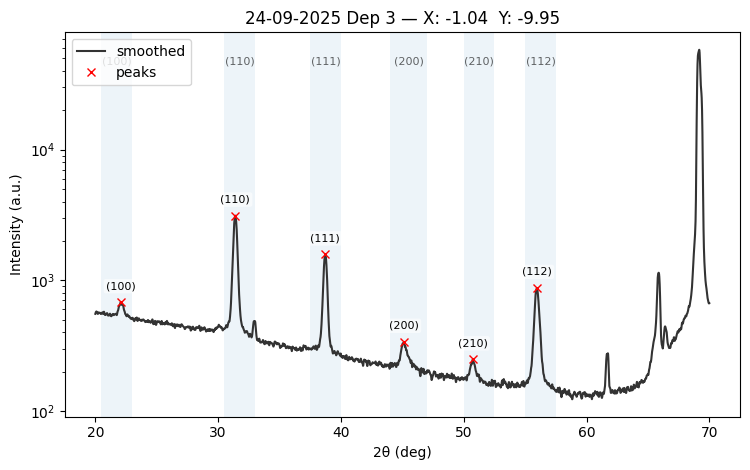


BTO_Mapping_Theta2Theta_24-09-2025_001_47_-2-091_-19-890.xy  peaks: 6
  (100)    [R1]   22.080°   I≈684.3   FWHM≈1.1049°   Area≈98.02
  (110)    [R2]   31.390°   I≈2928.2   FWHM≈1.7829°   Area≈1022.49
  (111)    [R3]   38.720°   I≈1596.5   FWHM≈1.4434°   Area≈531.62
  (200)    [R4]   45.060°   I≈324.5   FWHM≈1.8040°   Area≈112.46
  (210)    [R5]   50.720°   I≈239.9   FWHM≈1.5781°   Area≈46.04
  (112)    [R6]   55.960°   I≈903.8   FWHM≈1.7526°   Area≈378.66


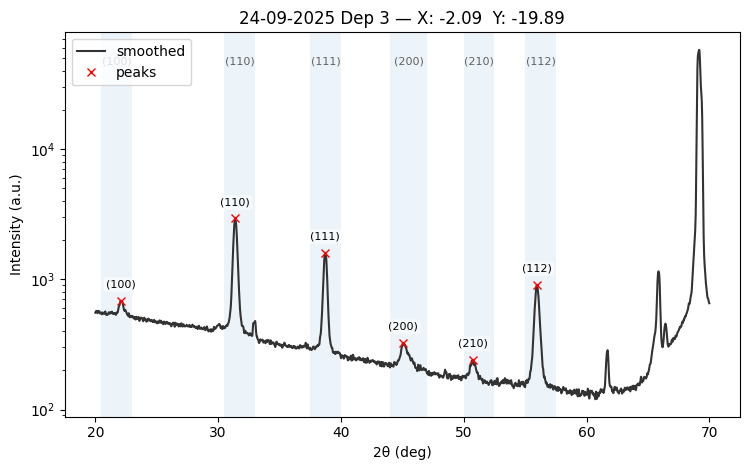


BTO_Mapping_Theta2Theta_24-09-2025_001_48_-3-136_-29-836.xy  peaks: 6
  (100)    [R1]   22.040°   I≈684.7   FWHM≈1.1087°   Area≈85.78
  (110)    [R2]   31.400°   I≈2569.0   FWHM≈1.7864°   Area≈900.81
  (111)    [R3]   38.720°   I≈1682.8   FWHM≈1.4378°   Area≈545.25
  (200)    [R4]   45.100°   I≈318.1   FWHM≈1.7569°   Area≈99.83
  (210)    [R5]   50.690°   I≈229.0   FWHM≈1.5941°   Area≈43.25
  (112)    [R6]   55.980°   I≈913.1   FWHM≈1.7483°   Area≈394.12


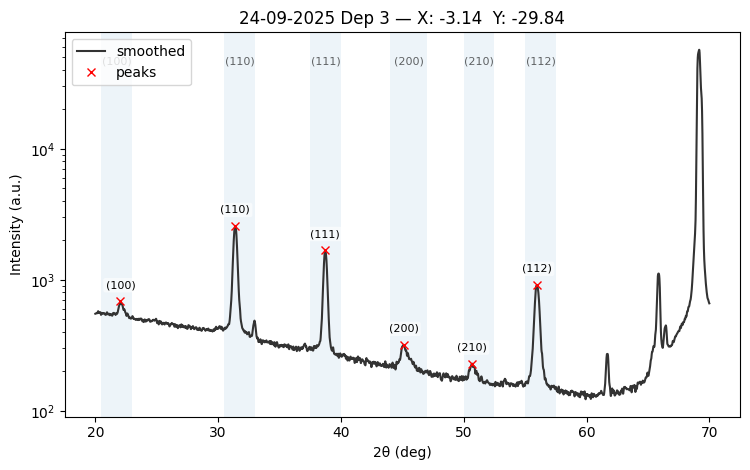


BTO_Mapping_Theta2Theta_24-09-2025_001_49_-4-181_-39-781.xy  peaks: 6
  (100)    [R1]   22.180°   I≈648.3   FWHM≈1.1960°   Area≈86.47
  (110)    [R2]   31.380°   I≈2251.5   FWHM≈1.7849°   Area≈793.39
  (111)    [R3]   38.720°   I≈1747.6   FWHM≈1.4330°   Area≈582.49
  (200)    [R4]   45.130°   I≈316.9   FWHM≈1.7672°   Area≈106.71
  (210)    [R5]   50.720°   I≈233.4   FWHM≈1.5202°   Area≈42.90
  (112)    [R6]   56.000°   I≈965.2   FWHM≈1.7283°   Area≈415.96


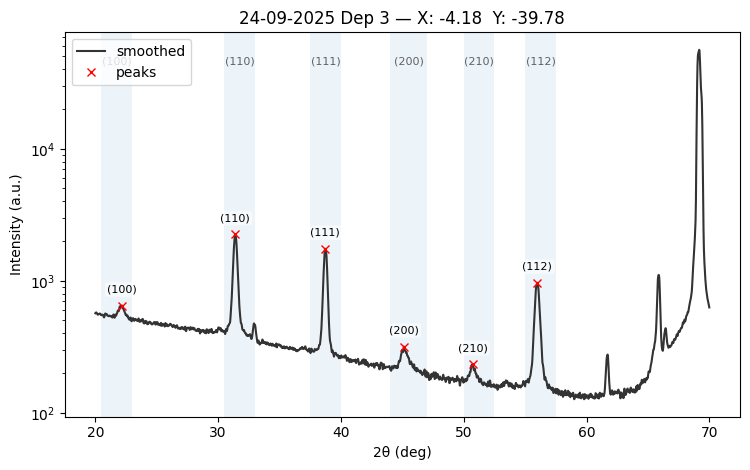


BTO_Mapping_Theta2Theta_24-09-2025_001_50_3-090_-9-511.xy  peaks: 6
  (100)    [R1]   22.020°   I≈666.9   FWHM≈1.0897°   Area≈92.55
  (110)    [R2]   31.400°   I≈2620.4   FWHM≈1.7791°   Area≈914.02
  (111)    [R3]   38.720°   I≈1577.9   FWHM≈1.4357°   Area≈515.52
  (200)    [R4]   45.190°   I≈322.8   FWHM≈1.7513°   Area≈103.20
  (210)    [R5]   50.700°   I≈233.0   FWHM≈1.5382°   Area≈46.53
  (112)    [R6]   55.980°   I≈896.3   FWHM≈1.7404°   Area≈393.76


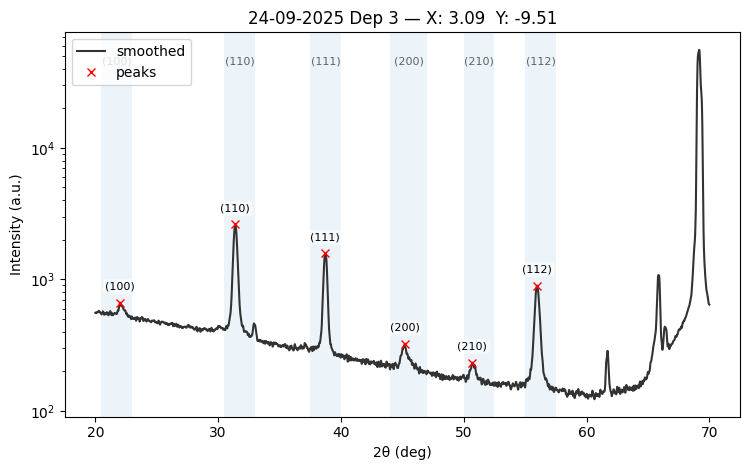


BTO_Mapping_Theta2Theta_24-09-2025_001_51_6-180_-19-021.xy  peaks: 5
  (110)    [R2]   31.390°   I≈2049.4   FWHM≈1.7760°   Area≈691.68
  (111)    [R3]   38.750°   I≈1644.7   FWHM≈1.4252°   Area≈524.83
  (200)    [R4]   45.100°   I≈286.4   FWHM≈1.5648°   Area≈86.31
  (210)    [R5]   50.770°   I≈218.4   FWHM≈1.4025°   Area≈35.21
  (112)    [R6]   55.970°   I≈913.1   FWHM≈1.7417°   Area≈404.66


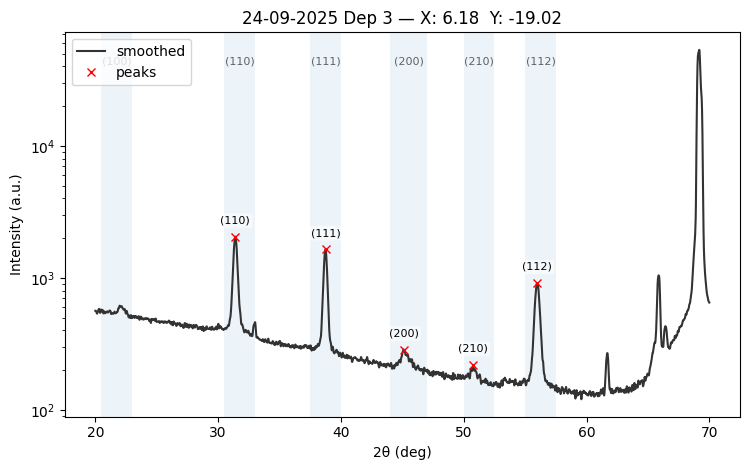


BTO_Mapping_Theta2Theta_24-09-2025_001_52_9-271_-28-532.xy  peaks: 6
  (100)    [R1]   22.160°   I≈622.0   FWHM≈1.0299°   Area≈69.77
  (110)    [R2]   31.410°   I≈1698.9   FWHM≈1.7781°   Area≈562.42
  (111)    [R3]   38.750°   I≈1652.5   FWHM≈1.4178°   Area≈508.12
  (200)    [R4]   45.080°   I≈264.0   FWHM≈1.5127°   Area≈62.78
  (210)    [R5]   50.700°   I≈206.8   FWHM≈1.2681°   Area≈28.11
  (112)    [R6]   56.000°   I≈927.7   FWHM≈1.7235°   Area≈401.64


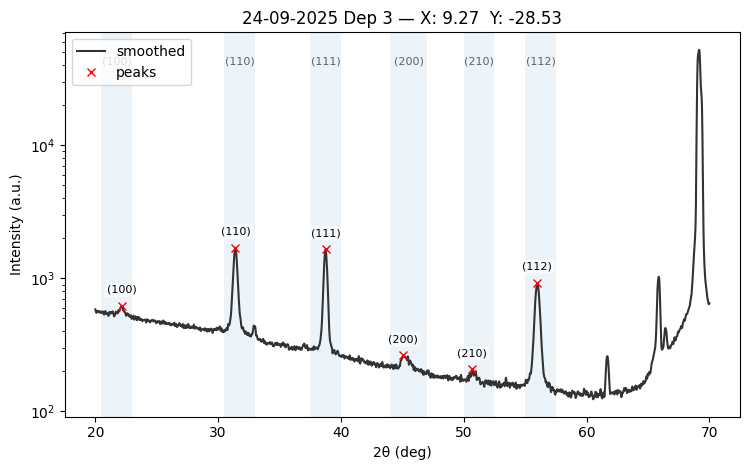


BTO_Mapping_Theta2Theta_24-09-2025_001_53_12-361_-38-042.xy  peaks: 4
  (110)    [R2]   31.400°   I≈1546.6   FWHM≈1.7737°   Area≈514.49
  (111)    [R3]   38.750°   I≈1632.8   FWHM≈1.4116°   Area≈518.88
  (200)    [R4]   45.140°   I≈286.2   FWHM≈1.5664°   Area≈72.17
  (112)    [R6]   56.010°   I≈878.6   FWHM≈1.7253°   Area≈376.10


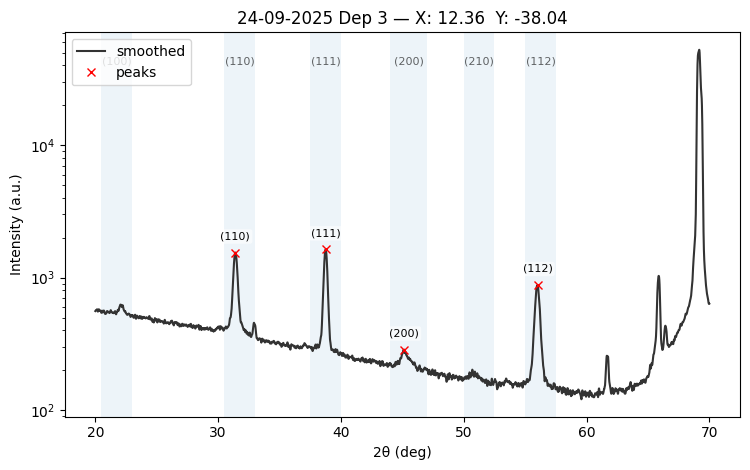


BTO_Mapping_Theta2Theta_24-09-2025_001_54_6-691_-7-431.xy  peaks: 5
  (110)    [R2]   31.410°   I≈2264.6   FWHM≈1.7753°   Area≈761.55
  (111)    [R3]   38.740°   I≈1589.8   FWHM≈1.4299°   Area≈509.43
  (200)    [R4]   45.140°   I≈294.6   FWHM≈1.6452°   Area≈83.40
  (210)    [R5]   50.830°   I≈222.3   FWHM≈1.4389°   Area≈35.99
  (112)    [R6]   55.960°   I≈905.3   FWHM≈1.7360°   Area≈387.21


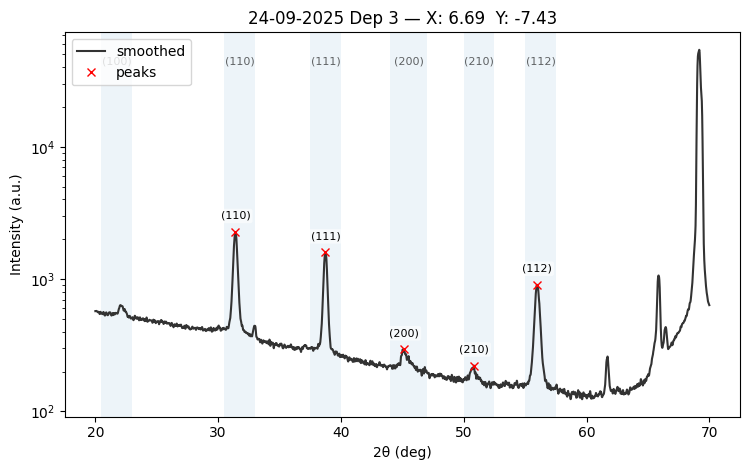


BTO_Mapping_Theta2Theta_24-09-2025_001_55_13-383_-14-863.xy  peaks: 4
  (110)    [R2]   31.400°   I≈1680.0   FWHM≈1.7765°   Area≈551.27
  (111)    [R3]   38.740°   I≈1588.0   FWHM≈1.4160°   Area≈505.78
  (200)    [R4]   45.130°   I≈277.5   FWHM≈1.5335°   Area≈71.47
  (112)    [R6]   56.000°   I≈893.8   FWHM≈1.7326°   Area≈393.80


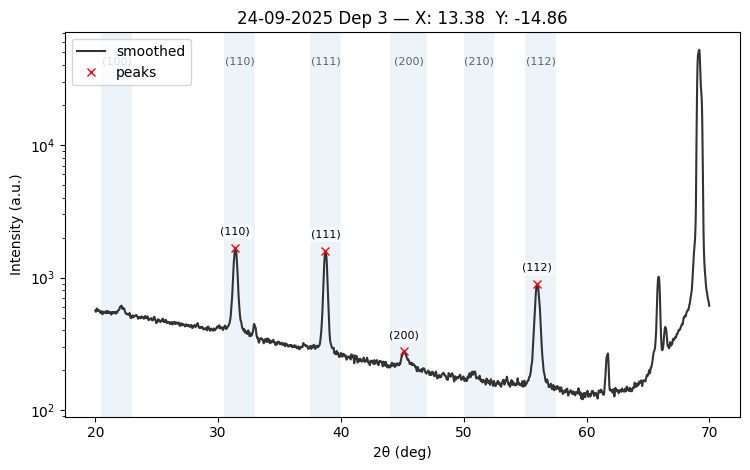


BTO_Mapping_Theta2Theta_24-09-2025_001_56_20-074_-22-294.xy  peaks: 5
  (110)    [R2]   31.410°   I≈1493.9   FWHM≈1.7776°   Area≈483.12
  (111)    [R3]   38.760°   I≈1502.2   FWHM≈1.4173°   Area≈487.15
  (200)    [R4]   45.090°   I≈279.1   FWHM≈1.5924°   Area≈61.12
  (210)    [R5]   50.730°   I≈202.6   FWHM≈1.4155°   Area≈28.43
  (112)    [R6]   56.020°   I≈793.3   FWHM≈1.7359°   Area≈349.56


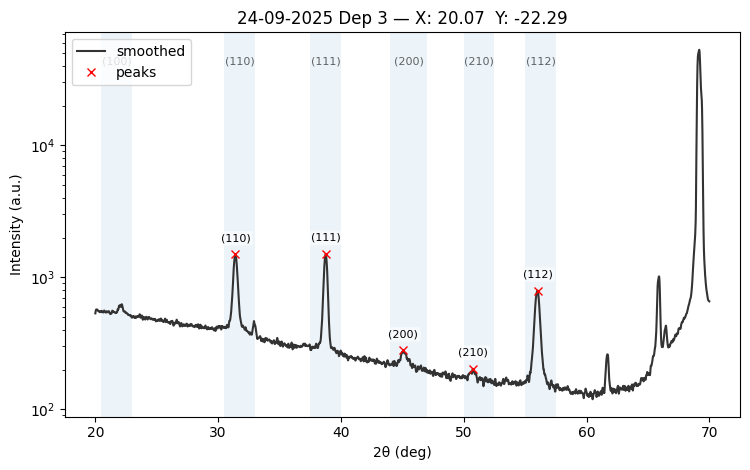


BTO_Mapping_Theta2Theta_24-09-2025_001_57_26-765_-29-726.xy  peaks: 4
  (110)    [R2]   31.390°   I≈1319.5   FWHM≈1.8094°   Area≈449.57
  (111)    [R3]   38.740°   I≈1320.6   FWHM≈1.4273°   Area≈407.34
  (200)    [R4]   45.190°   I≈274.1   FWHM≈1.8641°   Area≈75.98
  (112)    [R6]   55.940°   I≈642.6   FWHM≈1.7529°   Area≈275.32


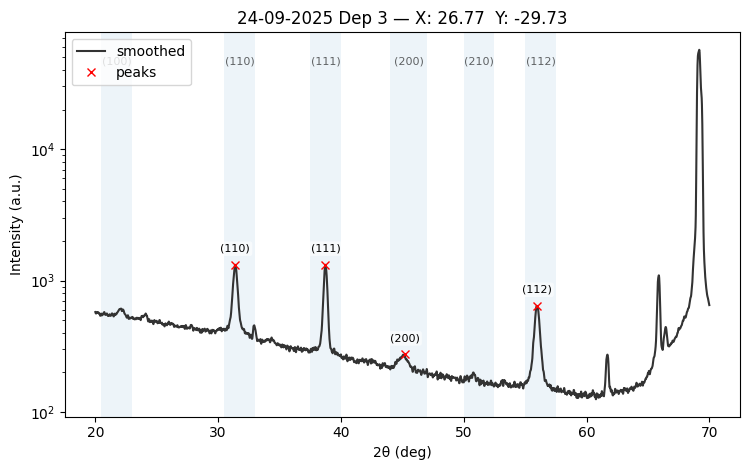


BTO_Mapping_Theta2Theta_24-09-2025_001_58_9-135_-4-067.xy  peaks: 5
  (110)    [R2]   31.410°   I≈2068.4   FWHM≈1.7738°   Area≈706.67
  (111)    [R3]   38.740°   I≈1594.6   FWHM≈1.4210°   Area≈498.83
  (200)    [R4]   45.070°   I≈276.3   FWHM≈1.4961°   Area≈67.16
  (210)    [R5]   50.840°   I≈213.2   FWHM≈1.2712°   Area≈36.24
  (112)    [R6]   55.990°   I≈933.3   FWHM≈1.7157°   Area≈397.67


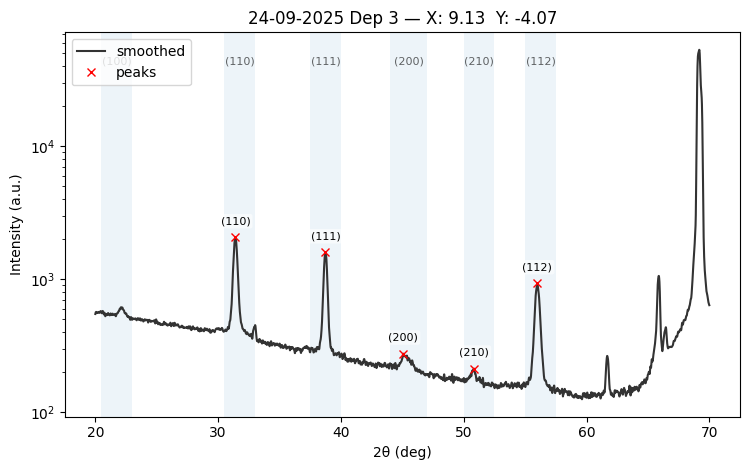


BTO_Mapping_Theta2Theta_24-09-2025_001_59_18-271_-8-135.xy  peaks: 5
  (110)    [R2]   31.390°   I≈1556.5   FWHM≈1.7795°   Area≈507.59
  (111)    [R3]   38.760°   I≈1561.8   FWHM≈1.4120°   Area≈463.71
  (200)    [R4]   45.080°   I≈278.1   FWHM≈1.5470°   Area≈73.19
  (210)    [R5]   50.790°   I≈205.4   FWHM≈1.1255°   Area≈29.08
  (112)    [R6]   55.980°   I≈864.5   FWHM≈1.7188°   Area≈355.98


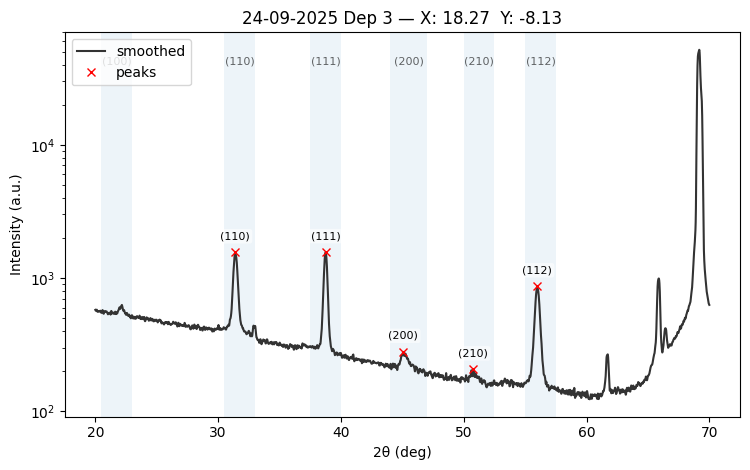


BTO_Mapping_Theta2Theta_24-09-2025_001_60_27-406_-12-202.xy  peaks: 4
  (110)    [R2]   31.400°   I≈1396.1   FWHM≈1.7894°   Area≈446.08
  (111)    [R3]   38.730°   I≈1340.3   FWHM≈1.4263°   Area≈428.44
  (200)    [R4]   45.160°   I≈280.7   FWHM≈1.6587°   Area≈61.44
  (112)    [R6]   55.960°   I≈688.0   FWHM≈1.7424°   Area≈296.66


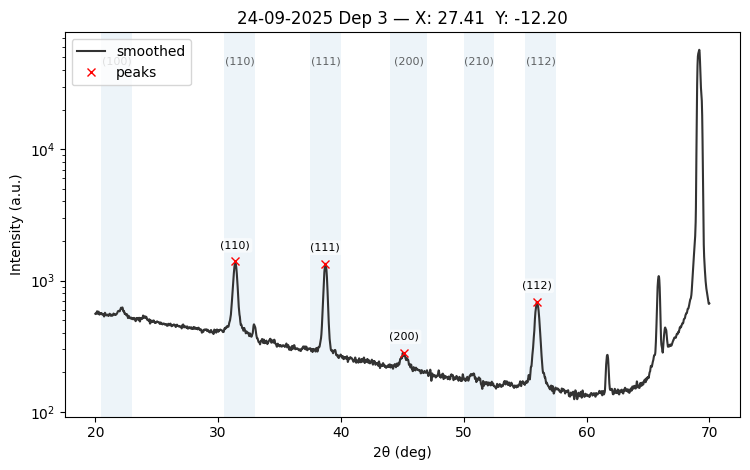


BTO_Mapping_Theta2Theta_24-09-2025_001_61_36-542_-16-269.xy  peaks: 4
  (110)    [R2]   31.400°   I≈1119.9   FWHM≈1.8183°   Area≈370.34
  (111)    [R3]   38.720°   I≈1051.0   FWHM≈1.4556°   Area≈319.47
  (200)    [R4]   45.160°   I≈282.8   FWHM≈1.7573°   Area≈65.64
  (112)    [R6]   55.950°   I≈503.3   FWHM≈1.8068°   Area≈206.28


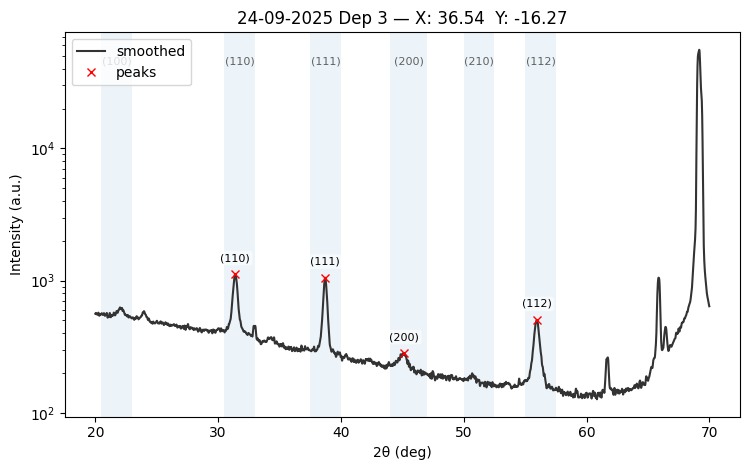


Individual plots for: 07-10-2025 Dep 6

BTO_Mapping_Theta2Theta_07-10-2025_001_01_0-000_0-000.xy  peaks: 4
  (110)    [R2]   31.390°   I≈1146.7   FWHM≈1.8053°   Area≈374.73
  (111)    [R3]   38.720°   I≈970.0   FWHM≈1.4435°   Area≈299.53
  (200)    [R4]   45.120°   I≈258.2   FWHM≈1.5131°   Area≈72.40
  (112)    [R6]   55.980°   I≈590.1   FWHM≈1.7661°   Area≈247.70


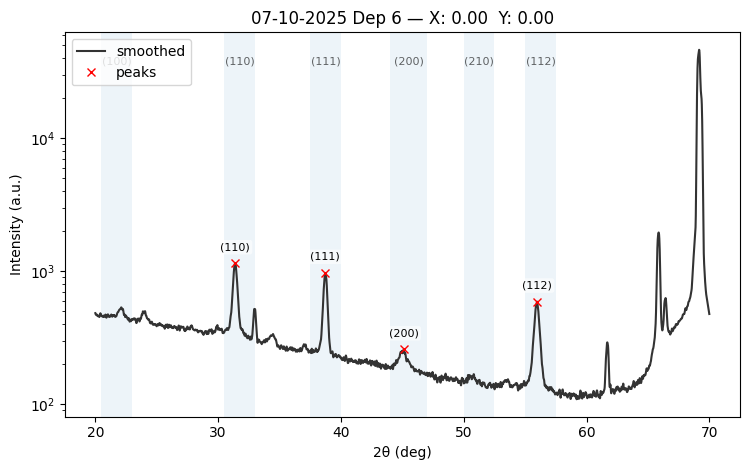


BTO_Mapping_Theta2Theta_07-10-2025_001_02_10-000_0-000.xy  peaks: 4
  (110)    [R2]   31.400°   I≈1187.2   FWHM≈1.8076°   Area≈391.32
  (111)    [R3]   38.740°   I≈827.9   FWHM≈1.4512°   Area≈235.70
  (200)    [R4]   45.180°   I≈236.6   FWHM≈1.3890°   Area≈56.53
  (112)    [R6]   55.990°   I≈446.8   FWHM≈1.7828°   Area≈187.03


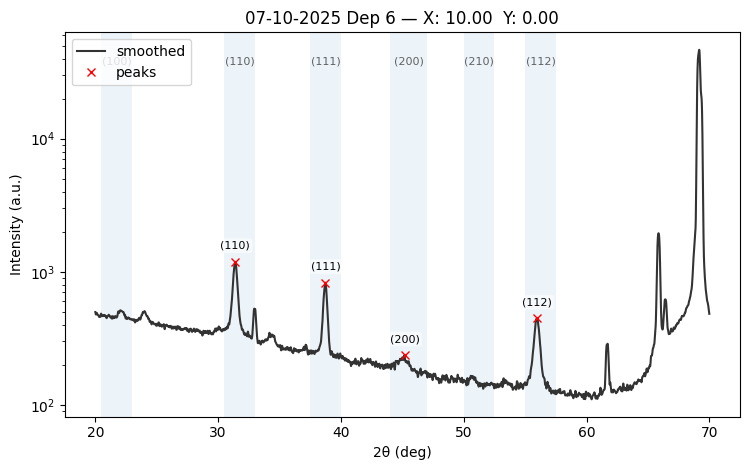


BTO_Mapping_Theta2Theta_07-10-2025_001_03_20-000_0-000.xy  peaks: 4
  (110)    [R2]   31.390°   I≈1020.4   FWHM≈1.8270°   Area≈344.25
  (111)    [R3]   38.690°   I≈690.3   FWHM≈1.4645°   Area≈203.83
  (200)    [R4]   45.030°   I≈226.5   FWHM≈1.5997°   Area≈57.40
  (112)    [R6]   55.950°   I≈333.1   FWHM≈1.7066°   Area≈131.20


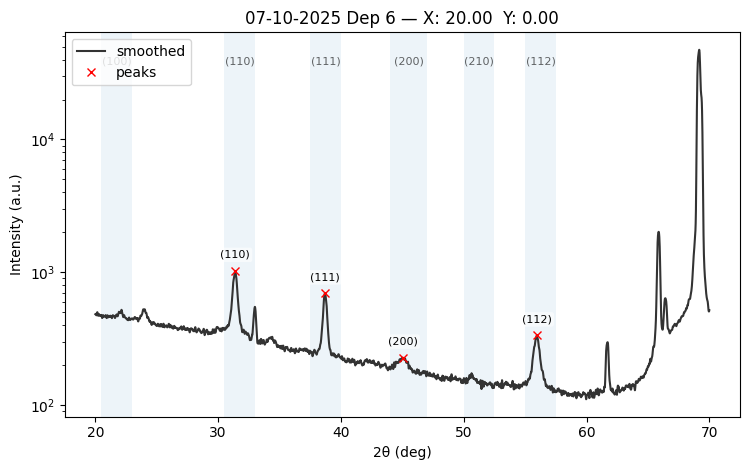


BTO_Mapping_Theta2Theta_07-10-2025_001_04_30-000_0-000.xy  peaks: 4
  (110)    [R2]   31.360°   I≈928.3   FWHM≈1.8286°   Area≈297.86
  (111)    [R3]   38.740°   I≈592.5   FWHM≈1.4703°   Area≈165.26
  (200)    [R4]   45.000°   I≈228.0   FWHM≈1.4232°   Area≈41.61
  (112)    [R6]   56.000°   I≈270.7   FWHM≈1.4084°   Area≈102.28


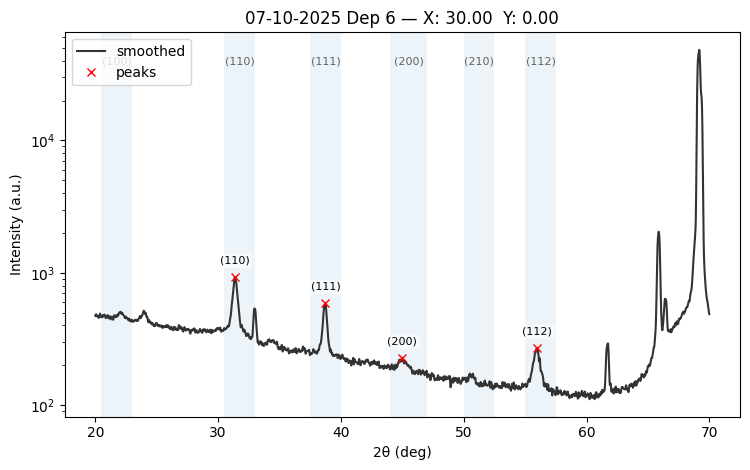


BTO_Mapping_Theta2Theta_07-10-2025_001_05_40-000_0-000.xy  peaks: 3
  (110)    [R2]   31.390°   I≈850.5   FWHM≈1.8259°   Area≈285.69
  (111)    [R3]   38.700°   I≈483.8   FWHM≈1.5025°   Area≈130.46
  (112)    [R6]   56.010°   I≈223.3   FWHM≈1.1469°   Area≈82.60


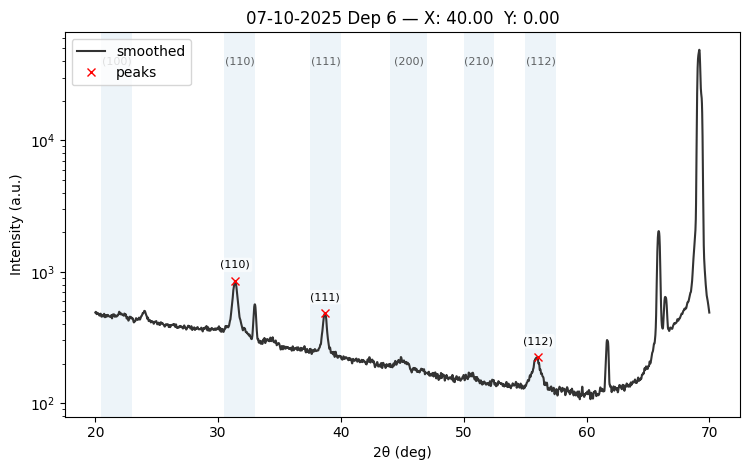


BTO_Mapping_Theta2Theta_07-10-2025_001_06_9-135_4-067.xy  peaks: 4
  (110)    [R2]   31.390°   I≈1190.4   FWHM≈1.7992°   Area≈403.34
  (111)    [R3]   38.720°   I≈819.9   FWHM≈1.4482°   Area≈233.51
  (200)    [R4]   45.120°   I≈237.5   FWHM≈1.2523°   Area≈60.96
  (112)    [R6]   55.950°   I≈445.9   FWHM≈1.7648°   Area≈184.89


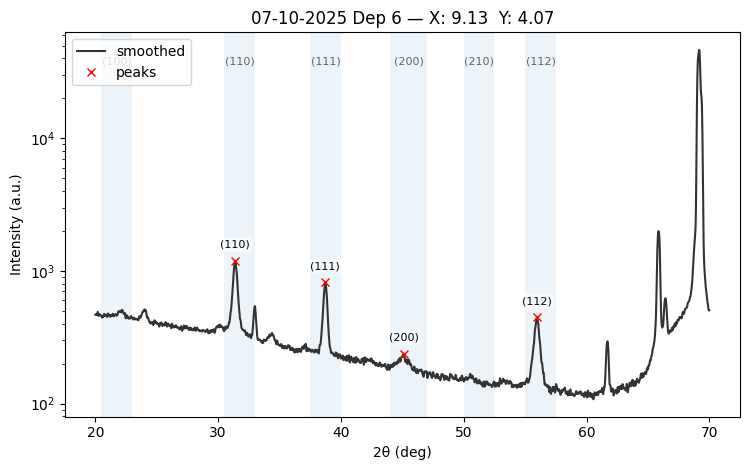


BTO_Mapping_Theta2Theta_07-10-2025_001_07_18-271_8-135.xy  peaks: 4
  (110)    [R2]   31.380°   I≈1012.1   FWHM≈1.8235°   Area≈340.02
  (111)    [R3]   38.730°   I≈679.8   FWHM≈1.4734°   Area≈200.54
  (200)    [R4]   45.150°   I≈230.7   FWHM≈1.3565°   Area≈55.32
  (112)    [R6]   55.980°   I≈326.1   FWHM≈1.6578°   Area≈140.08


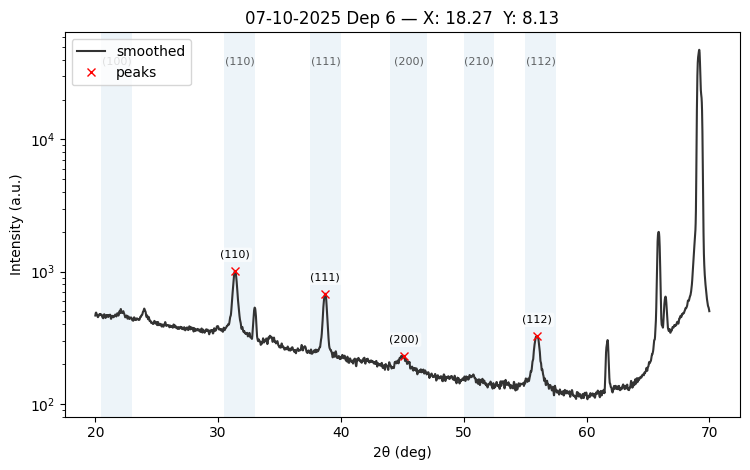


BTO_Mapping_Theta2Theta_07-10-2025_001_08_27-406_12-202.xy  peaks: 3
  (110)    [R2]   31.380°   I≈928.6   FWHM≈1.8184°   Area≈314.45
  (111)    [R3]   38.680°   I≈582.7   FWHM≈1.4715°   Area≈159.03
  (112)    [R6]   55.900°   I≈267.4   FWHM≈1.3400°   Area≈93.12


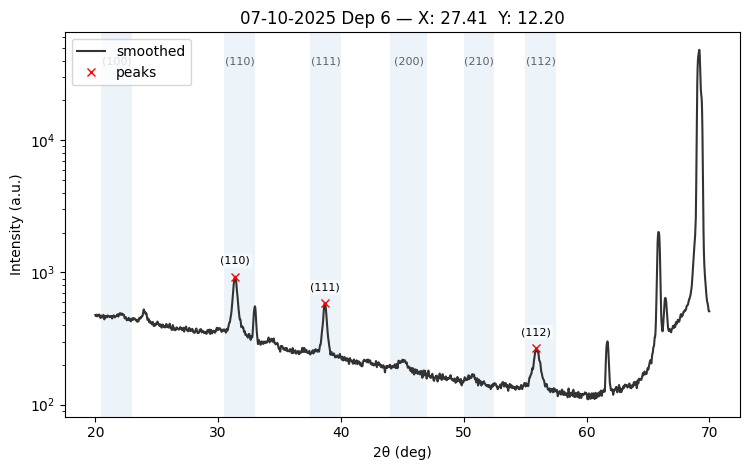


BTO_Mapping_Theta2Theta_07-10-2025_001_09_36-542_16-269.xy  peaks: 3
  (110)    [R2]   31.420°   I≈850.0   FWHM≈1.8333°   Area≈269.99
  (111)    [R3]   38.720°   I≈470.1   FWHM≈1.4924°   Area≈121.99
  (112)    [R6]   56.010°   I≈220.4   FWHM≈1.1372°   Area≈73.16


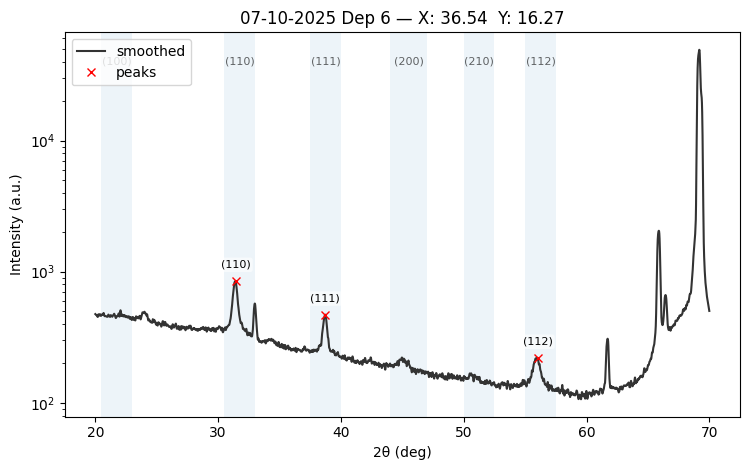


BTO_Mapping_Theta2Theta_07-10-2025_001_10_6-691_7-431.xy  peaks: 4
  (110)    [R2]   31.400°   I≈1201.7   FWHM≈1.8009°   Area≈419.00
  (111)    [R3]   38.730°   I≈836.1   FWHM≈1.4418°   Area≈240.86
  (200)    [R4]   45.240°   I≈236.0   FWHM≈1.5040°   Area≈56.71
  (112)    [R6]   55.980°   I≈457.3   FWHM≈1.7765°   Area≈194.26


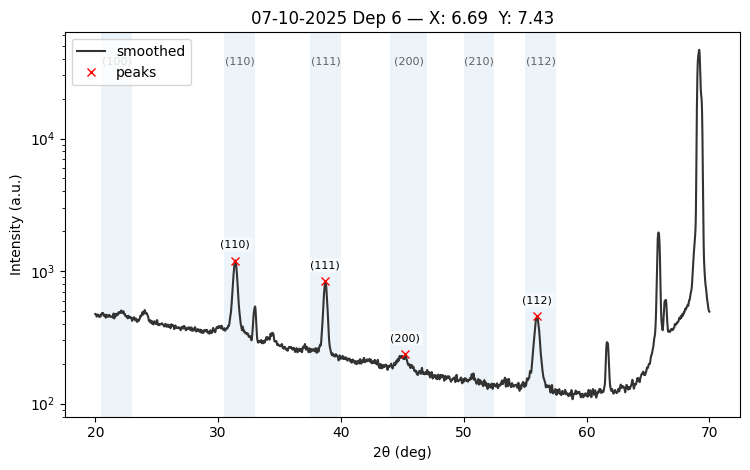


BTO_Mapping_Theta2Theta_07-10-2025_001_11_13-383_14-863.xy  peaks: 4
  (110)    [R2]   31.420°   I≈1024.7   FWHM≈1.8233°   Area≈342.09
  (111)    [R3]   38.700°   I≈688.2   FWHM≈1.4670°   Area≈188.62
  (200)    [R4]   44.900°   I≈225.4   FWHM≈1.5034°   Area≈55.04
  (112)    [R6]   55.950°   I≈355.6   FWHM≈1.7710°   Area≈141.46


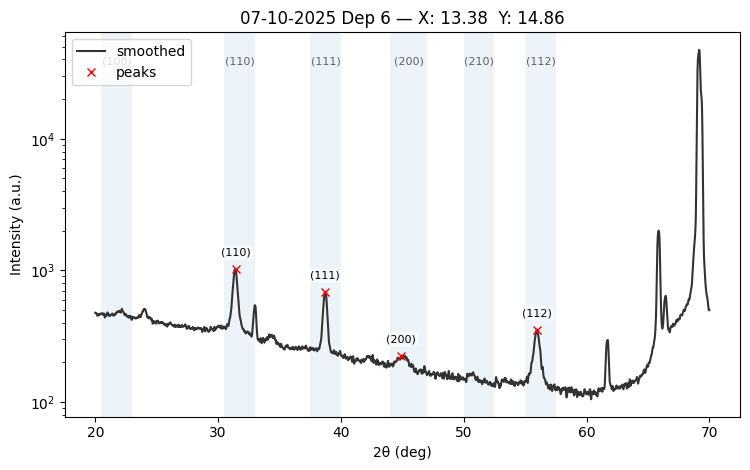


BTO_Mapping_Theta2Theta_07-10-2025_001_12_20-074_22-294.xy  peaks: 4
  (110)    [R2]   31.390°   I≈961.1   FWHM≈1.8111°   Area≈309.24
  (111)    [R3]   38.730°   I≈612.5   FWHM≈1.4692°   Area≈175.38
  (200)    [R4]   45.260°   I≈225.5   FWHM≈1.3763°   Area≈47.01
  (112)    [R6]   55.950°   I≈286.4   FWHM≈1.4054°   Area≈109.85


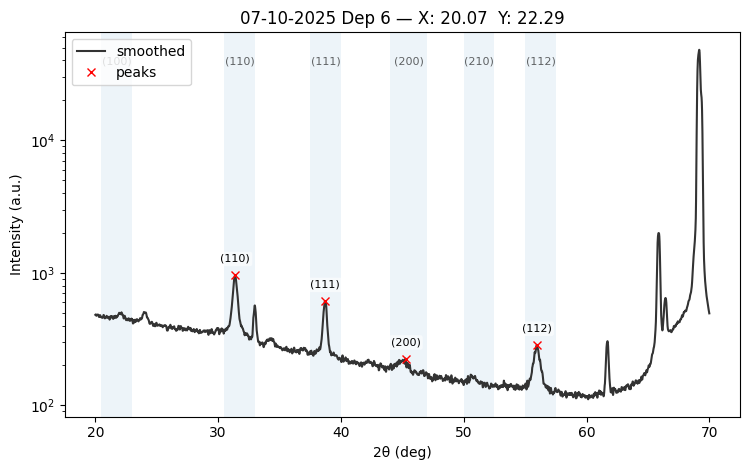


BTO_Mapping_Theta2Theta_07-10-2025_001_13_26-765_29-726.xy  peaks: 4
  (110)    [R2]   31.380°   I≈894.8   FWHM≈1.8163°   Area≈314.79
  (111)    [R3]   38.720°   I≈506.8   FWHM≈1.4695°   Area≈133.64
  (200)    [R4]   44.950°   I≈223.2   FWHM≈1.4985°   Area≈50.78
  (112)    [R6]   56.010°   I≈236.0   FWHM≈1.1763°   Area≈78.84


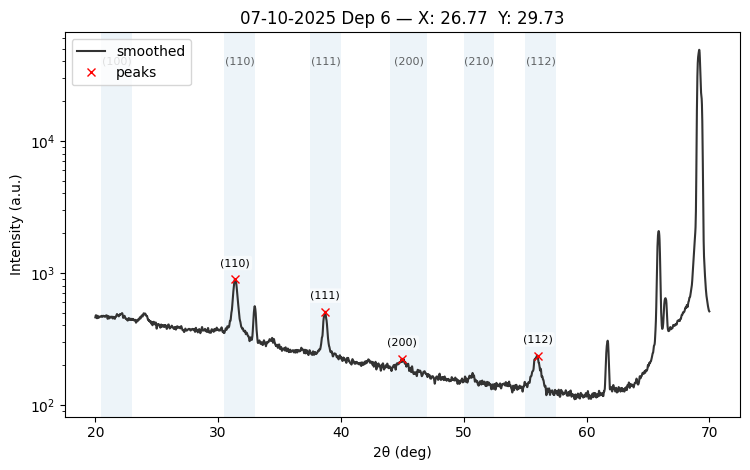


BTO_Mapping_Theta2Theta_07-10-2025_001_14_3-090_9-511.xy  peaks: 4
  (110)    [R2]   31.370°   I≈1187.7   FWHM≈1.8051°   Area≈403.51
  (111)    [R3]   38.730°   I≈872.3   FWHM≈1.4366°   Area≈248.64
  (200)    [R4]   44.950°   I≈242.7   FWHM≈1.4409°   Area≈65.42
  (112)    [R6]   55.990°   I≈490.4   FWHM≈1.7682°   Area≈213.58


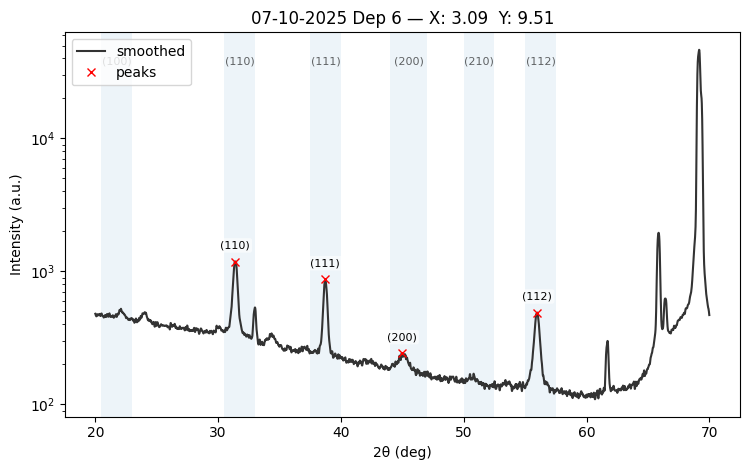


BTO_Mapping_Theta2Theta_07-10-2025_001_15_6-180_19-021.xy  peaks: 5
  (110)    [R2]   31.380°   I≈1168.5   FWHM≈1.8012°   Area≈388.11
  (111)    [R3]   38.710°   I≈760.2   FWHM≈1.4457°   Area≈215.64
  (200)    [R4]   45.070°   I≈230.1   FWHM≈1.5191°   Area≈55.26
  (210)    [R5]   50.840°   I≈172.0   FWHM≈0.7653°   Area≈31.88
  (112)    [R6]   55.940°   I≈390.4   FWHM≈1.7800°   Area≈161.84


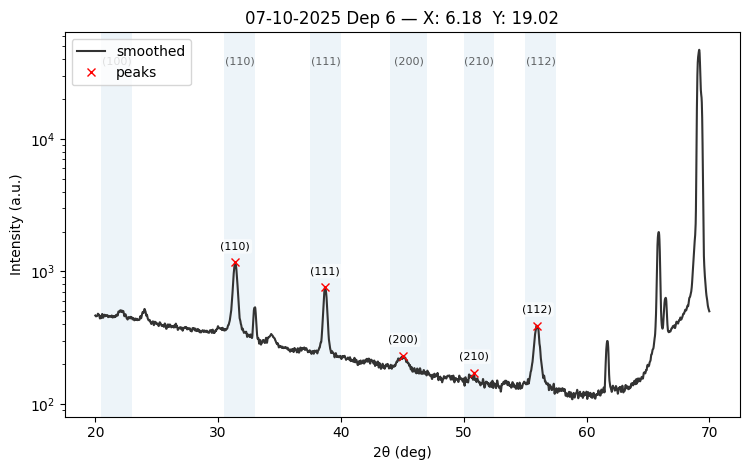


BTO_Mapping_Theta2Theta_07-10-2025_001_16_9-271_28-532.xy  peaks: 4
  (110)    [R2]   31.380°   I≈1019.1   FWHM≈1.8097°   Area≈339.24
  (111)    [R3]   38.720°   I≈694.9   FWHM≈1.4520°   Area≈189.31
  (200)    [R4]   45.000°   I≈229.1   FWHM≈1.2579°   Area≈58.02
  (112)    [R6]   55.900°   I≈333.4   FWHM≈1.6380°   Area≈124.36


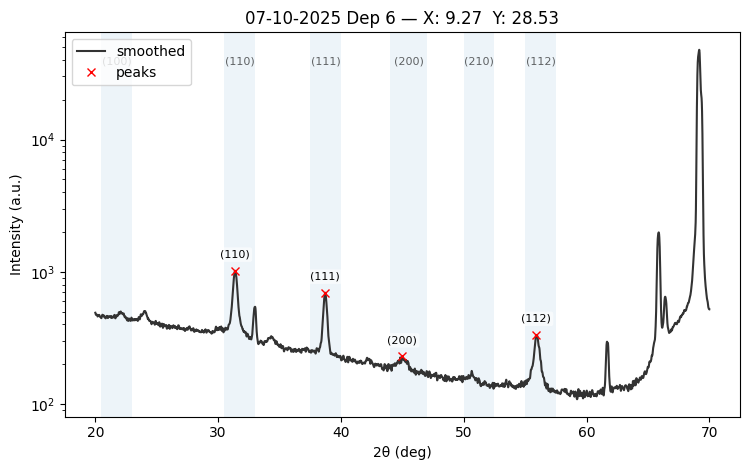


BTO_Mapping_Theta2Theta_07-10-2025_001_17_12-361_38-042.xy  peaks: 5
  (110)    [R2]   31.390°   I≈976.8   FWHM≈1.8079°   Area≈320.94
  (111)    [R3]   38.690°   I≈577.1   FWHM≈1.4550°   Area≈152.57
  (200)    [R4]   45.070°   I≈224.7   FWHM≈1.1356°   Area≈44.68
  (210)    [R5]   50.580°   I≈174.6   FWHM≈1.0717°   Area≈29.74
  (112)    [R6]   55.980°   I≈273.7   FWHM≈1.3638°   Area≈99.11


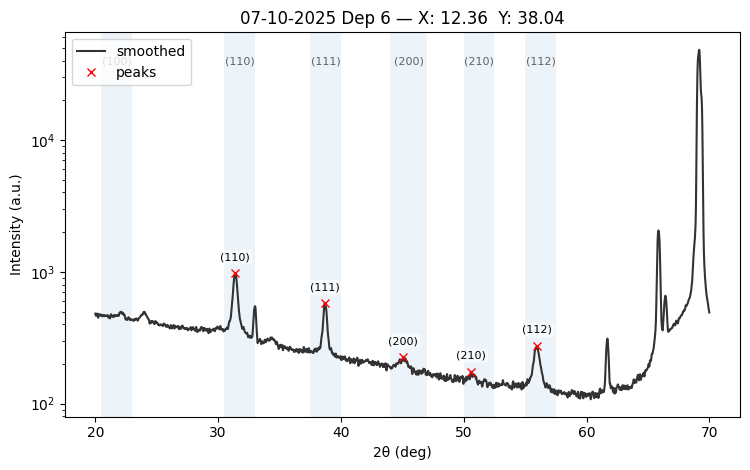


BTO_Mapping_Theta2Theta_07-10-2025_001_18_-1-045_9-945.xy  peaks: 5
  (100)    [R1]   21.980°   I≈532.8   FWHM≈1.1538°   Area≈66.80
  (110)    [R2]   31.400°   I≈1191.5   FWHM≈1.7981°   Area≈394.52
  (111)    [R3]   38.740°   I≈948.8   FWHM≈1.4343°   Area≈279.19
  (200)    [R4]   45.120°   I≈249.3   FWHM≈1.4445°   Area≈74.78
  (112)    [R6]   55.980°   I≈553.5   FWHM≈1.7567°   Area≈224.88


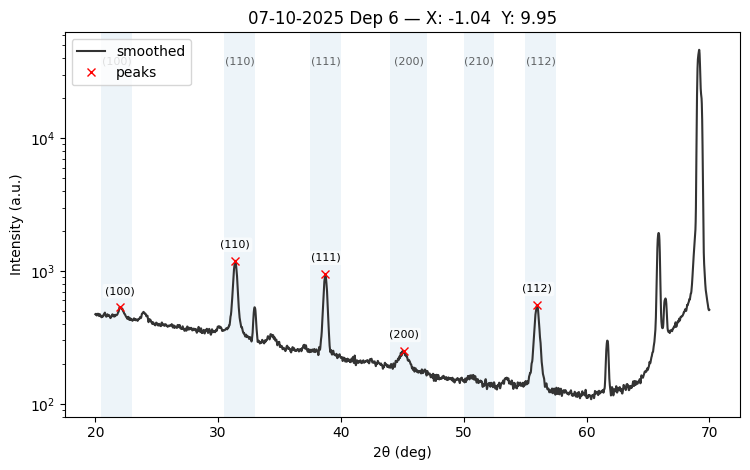


BTO_Mapping_Theta2Theta_07-10-2025_001_19_-2-091_19-890.xy  peaks: 5
  (100)    [R1]   22.120°   I≈526.3   FWHM≈1.0847°   Area≈73.69
  (110)    [R2]   31.400°   I≈1250.9   FWHM≈1.7854°   Area≈392.99
  (111)    [R3]   38.730°   I≈860.5   FWHM≈1.4319°   Area≈258.29
  (200)    [R4]   45.110°   I≈241.8   FWHM≈1.3869°   Area≈55.86
  (112)    [R6]   55.950°   I≈516.0   FWHM≈1.7529°   Area≈207.29


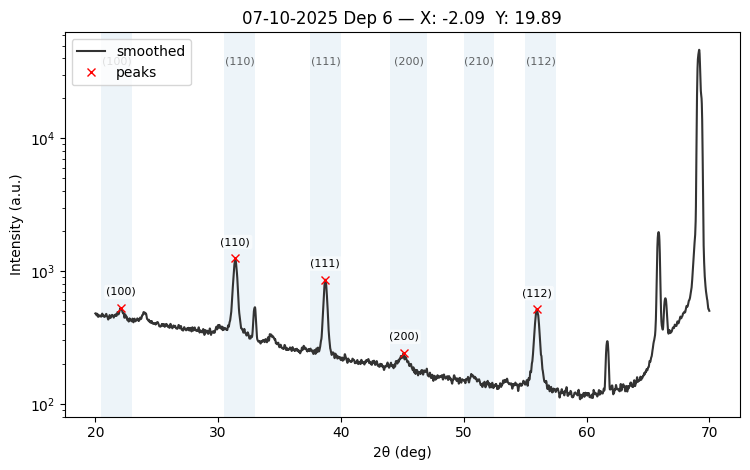


BTO_Mapping_Theta2Theta_07-10-2025_001_20_-3-136_29-836.xy  peaks: 4
  (110)    [R2]   31.380°   I≈1252.8   FWHM≈1.7881°   Area≈406.84
  (111)    [R3]   38.750°   I≈790.0   FWHM≈1.4398°   Area≈224.79
  (200)    [R4]   45.030°   I≈233.4   FWHM≈1.2954°   Area≈61.35
  (112)    [R6]   55.990°   I≈426.1   FWHM≈1.7666°   Area≈171.74


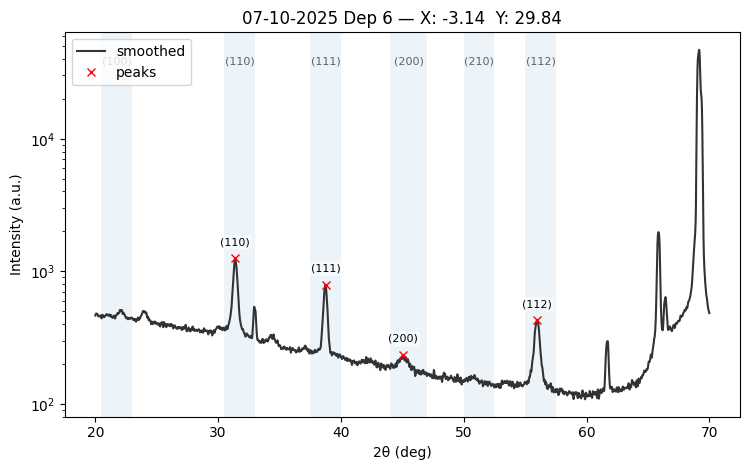


BTO_Mapping_Theta2Theta_07-10-2025_001_21_-4-181_39-781.xy  peaks: 5
  (110)    [R2]   31.390°   I≈1163.7   FWHM≈1.7939°   Area≈384.69
  (111)    [R3]   38.740°   I≈716.5   FWHM≈1.4455°   Area≈204.71
  (200)    [R4]   45.150°   I≈231.4   FWHM≈0.9740°   Area≈56.06
  (210)    [R5]   50.510°   I≈171.0   FWHM≈1.0878°   Area≈37.91
  (112)    [R6]   55.980°   I≈380.9   FWHM≈1.7658°   Area≈145.10


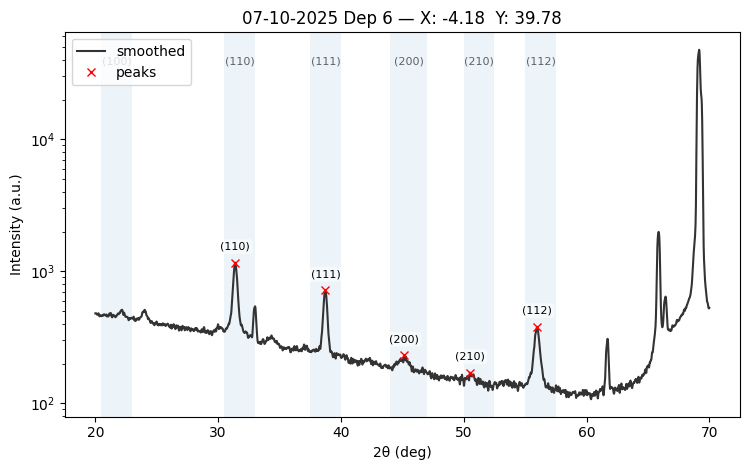


BTO_Mapping_Theta2Theta_07-10-2025_001_22_-5-000_8-660.xy  peaks: 5
  (100)    [R1]   22.080°   I≈542.3   FWHM≈1.1441°   Area≈83.95
  (110)    [R2]   31.400°   I≈1116.5   FWHM≈1.8025°   Area≈359.10
  (111)    [R3]   38.740°   I≈986.3   FWHM≈1.4451°   Area≈309.08
  (200)    [R4]   45.090°   I≈264.6   FWHM≈1.4023°   Area≈75.28
  (112)    [R6]   55.950°   I≈590.0   FWHM≈1.7684°   Area≈254.55


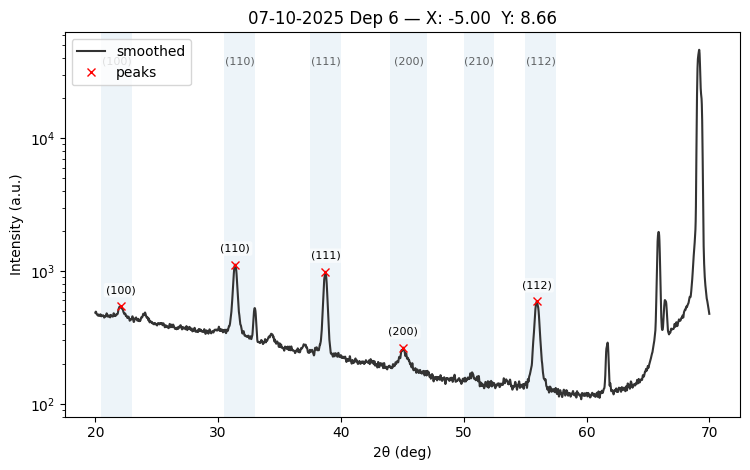


BTO_Mapping_Theta2Theta_07-10-2025_001_23_-10-000_17-321.xy  peaks: 6
  (100)    [R1]   22.100°   I≈554.3   FWHM≈1.0637°   Area≈69.16
  (110)    [R2]   31.410°   I≈1129.7   FWHM≈1.8009°   Area≈362.11
  (111)    [R3]   38.740°   I≈957.2   FWHM≈1.4447°   Area≈310.71
  (200)    [R4]   45.110°   I≈261.3   FWHM≈1.3945°   Area≈68.34
  (210)    [R5]   50.690°   I≈176.0   FWHM≈1.0851°   Area≈27.76
  (112)    [R6]   55.940°   I≈600.0   FWHM≈1.7494°   Area≈247.88


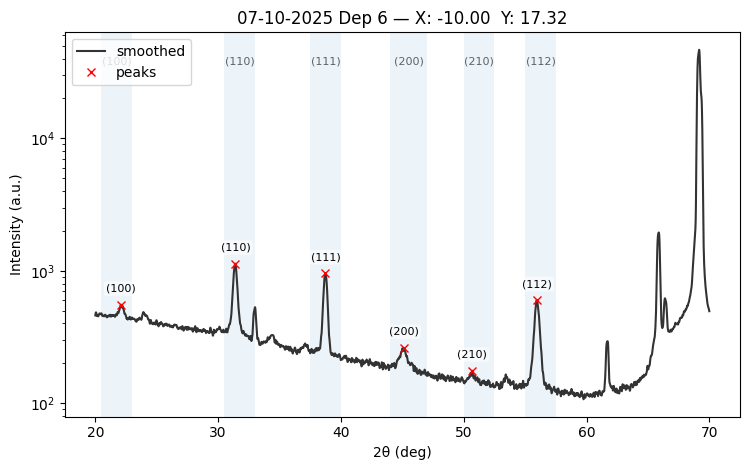


BTO_Mapping_Theta2Theta_07-10-2025_001_24_-15-000_25-981.xy  peaks: 6
  (100)    [R1]   22.070°   I≈556.2   FWHM≈1.0970°   Area≈70.26
  (110)    [R2]   31.380°   I≈1152.1   FWHM≈1.7923°   Area≈369.39
  (111)    [R3]   38.750°   I≈932.3   FWHM≈1.4498°   Area≈301.97
  (200)    [R4]   45.050°   I≈271.1   FWHM≈1.4333°   Area≈90.19
  (210)    [R5]   50.620°   I≈178.7   FWHM≈1.1330°   Area≈27.76
  (112)    [R6]   55.970°   I≈578.8   FWHM≈1.7635°   Area≈241.02


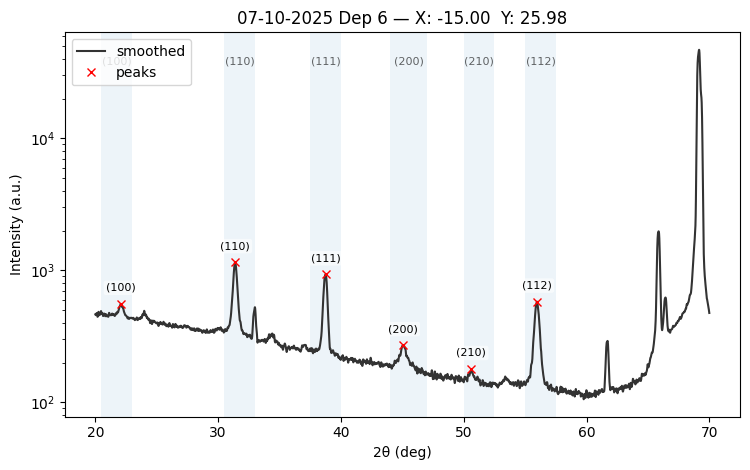


BTO_Mapping_Theta2Theta_07-10-2025_001_25_-20-000_34-641.xy  peaks: 5
  (100)    [R1]   22.070°   I≈563.5   FWHM≈1.0947°   Area≈63.96
  (110)    [R2]   31.400°   I≈1204.6   FWHM≈1.7909°   Area≈394.02
  (111)    [R3]   38.740°   I≈907.4   FWHM≈1.4268°   Area≈271.80
  (200)    [R4]   45.080°   I≈276.4   FWHM≈1.5542°   Area≈86.77
  (112)    [R6]   55.960°   I≈571.8   FWHM≈1.7447°   Area≈233.56


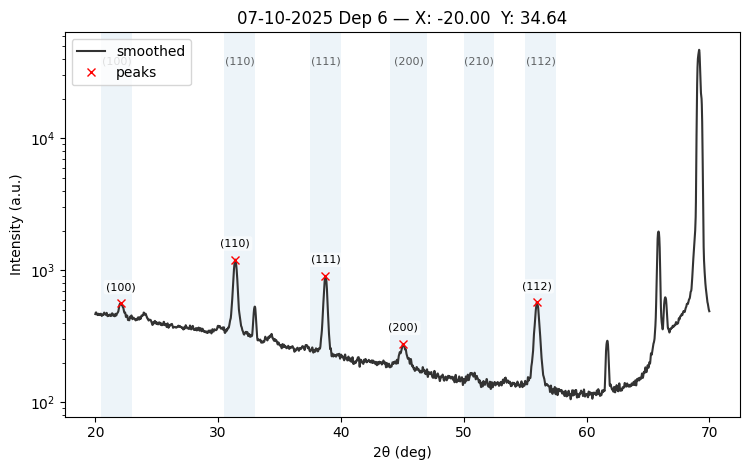


BTO_Mapping_Theta2Theta_07-10-2025_001_26_-8-090_5-878.xy  peaks: 5
  (100)    [R1]   22.040°   I≈548.2   FWHM≈1.1187°   Area≈85.69
  (110)    [R2]   31.380°   I≈1182.1   FWHM≈1.8068°   Area≈367.34
  (111)    [R3]   38.740°   I≈1030.7   FWHM≈1.4539°   Area≈323.92
  (200)    [R4]   45.050°   I≈268.9   FWHM≈1.4259°   Area≈82.88
  (112)    [R6]   55.980°   I≈597.2   FWHM≈1.7856°   Area≈250.62


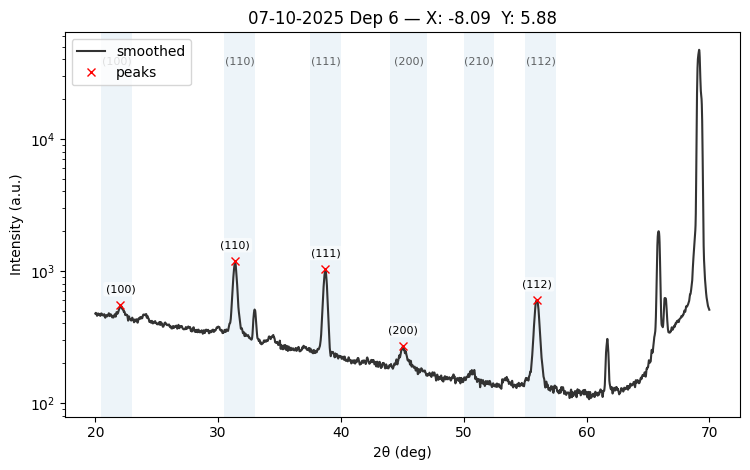


BTO_Mapping_Theta2Theta_07-10-2025_001_27_-16-180_11-756.xy  peaks: 6
  (100)    [R1]   22.110°   I≈551.1   FWHM≈1.1661°   Area≈89.03
  (110)    [R2]   31.360°   I≈1431.2   FWHM≈1.8108°   Area≈454.37
  (111)    [R3]   38.740°   I≈996.3   FWHM≈1.4750°   Area≈330.11
  (200)    [R4]   45.140°   I≈271.0   FWHM≈1.4723°   Area≈93.63
  (210)    [R5]   50.620°   I≈188.4   FWHM≈1.2617°   Area≈35.69
  (112)    [R6]   55.930°   I≈606.1   FWHM≈1.8075°   Area≈259.87


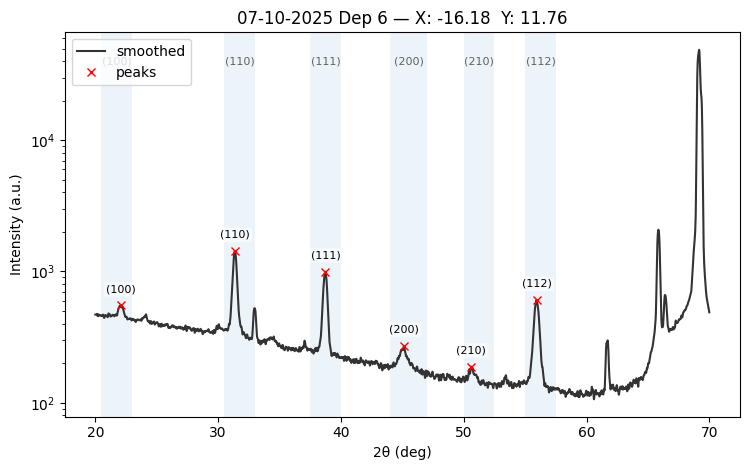


BTO_Mapping_Theta2Theta_07-10-2025_001_28_-24-271_17-634.xy  peaks: 6
  (100)    [R1]   22.050°   I≈570.4   FWHM≈1.1480°   Area≈83.76
  (110)    [R2]   31.370°   I≈1795.0   FWHM≈1.8073°   Area≈601.59
  (111)    [R3]   38.710°   I≈944.1   FWHM≈1.4784°   Area≈319.04
  (200)    [R4]   45.100°   I≈274.1   FWHM≈1.4927°   Area≈95.33
  (210)    [R5]   50.580°   I≈194.2   FWHM≈1.3046°   Area≈38.28
  (112)    [R6]   55.900°   I≈599.9   FWHM≈1.8237°   Area≈261.97


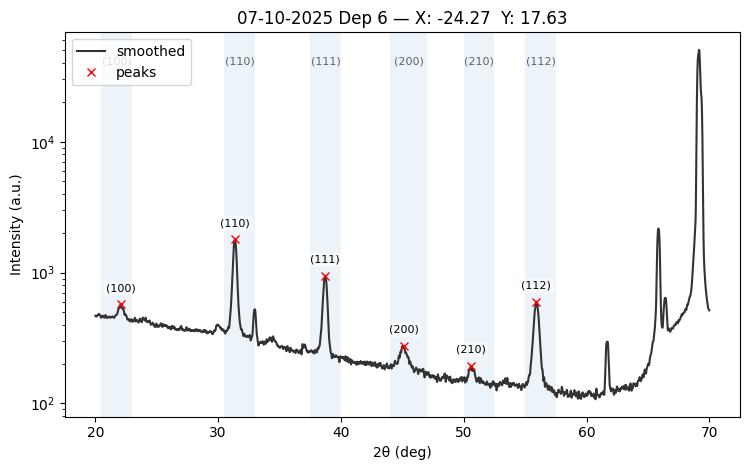


BTO_Mapping_Theta2Theta_07-10-2025_001_29_-32-361_23-511.xy  peaks: 6
  (100)    [R1]   22.090°   I≈604.8   FWHM≈1.1214°   Area≈87.25
  (110)    [R2]   31.370°   I≈2008.9   FWHM≈1.8167°   Area≈680.55
  (111)    [R3]   38.720°   I≈885.9   FWHM≈1.4799°   Area≈284.96
  (200)    [R4]   45.070°   I≈295.1   FWHM≈1.5943°   Area≈101.02
  (210)    [R5]   50.670°   I≈204.4   FWHM≈1.3705°   Area≈43.22
  (112)    [R6]   55.930°   I≈572.9   FWHM≈1.8581°   Area≈270.97


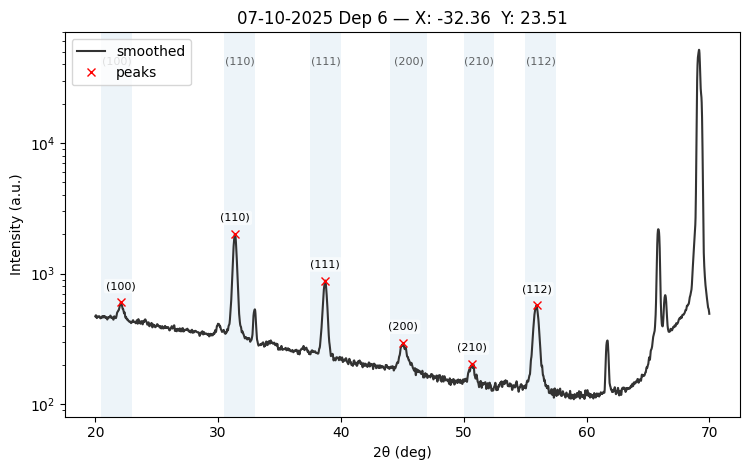


BTO_Mapping_Theta2Theta_07-10-2025_001_30_-9-781_2-079.xy  peaks: 6
  (100)    [R1]   22.050°   I≈555.2   FWHM≈1.1559°   Area≈83.62
  (110)    [R2]   31.370°   I≈1344.7   FWHM≈1.8125°   Area≈429.02
  (111)    [R3]   38.740°   I≈1033.1   FWHM≈1.4657°   Area≈335.12
  (200)    [R4]   45.160°   I≈256.7   FWHM≈1.3357°   Area≈78.62
  (210)    [R5]   50.610°   I≈187.4   FWHM≈1.1636°   Area≈34.26
  (112)    [R6]   55.910°   I≈606.9   FWHM≈1.7957°   Area≈262.76


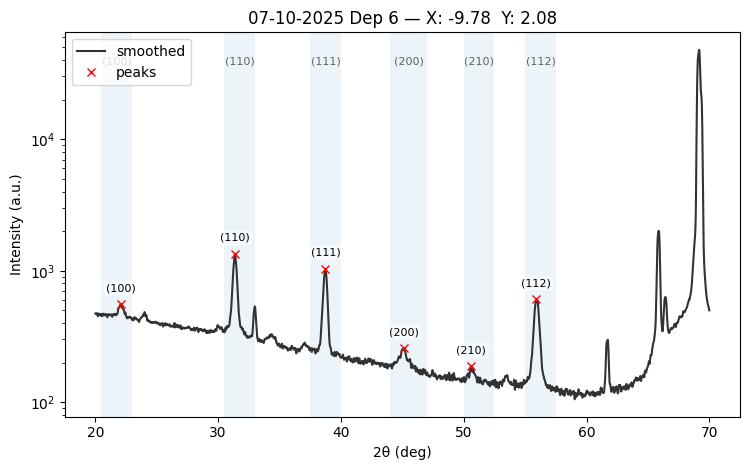


BTO_Mapping_Theta2Theta_07-10-2025_001_31_-19-563_4-158.xy  peaks: 6
  (100)    [R1]   22.130°   I≈571.6   FWHM≈1.1920°   Area≈79.44
  (110)    [R2]   31.360°   I≈2126.1   FWHM≈1.8186°   Area≈719.04
  (111)    [R3]   38.720°   I≈941.5   FWHM≈1.4835°   Area≈307.73
  (200)    [R4]   45.070°   I≈284.2   FWHM≈1.5552°   Area≈93.31
  (210)    [R5]   50.650°   I≈203.9   FWHM≈1.4025°   Area≈40.00
  (112)    [R6]   55.930°   I≈601.2   FWHM≈1.8408°   Area≈263.58


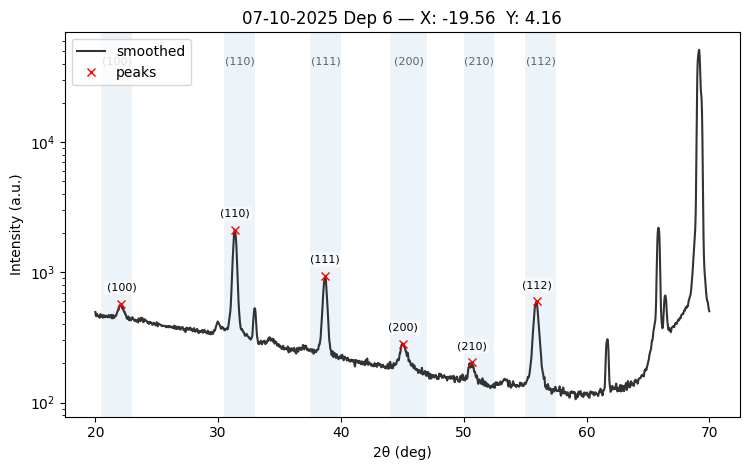


BTO_Mapping_Theta2Theta_07-10-2025_001_32_-29-344_6-237.xy  peaks: 6
  (100)    [R1]   22.010°   I≈665.7   FWHM≈1.1690°   Area≈128.92
  (110)    [R2]   31.360°   I≈2772.4   FWHM≈1.8258°   Area≈969.03
  (111)    [R3]   38.720°   I≈663.5   FWHM≈1.5247°   Area≈223.98
  (200)    [R4]   45.030°   I≈354.0   FWHM≈1.9587°   Area≈129.95
  (210)    [R5]   50.670°   I≈228.5   FWHM≈1.4764°   Area≈50.64
  (112)    [R6]   55.820°   I≈538.1   FWHM≈1.8872°   Area≈250.79


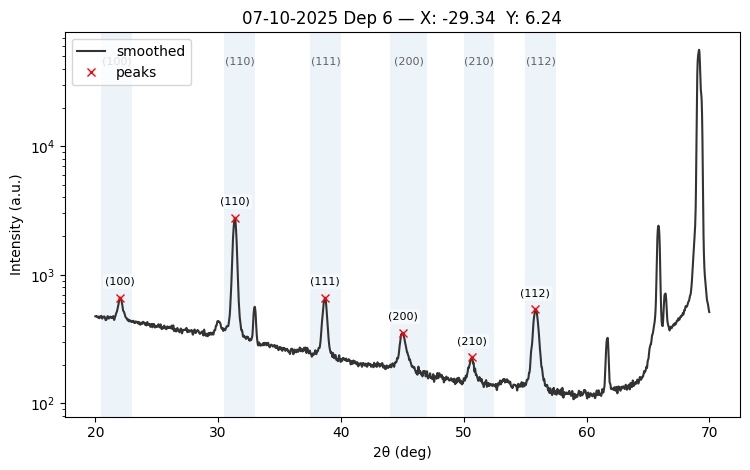


BTO_Mapping_Theta2Theta_07-10-2025_001_33_-39-126_8-316.xy  peaks: 6
  (100)    [R1]   21.980°   I≈799.9   FWHM≈1.1735°   Area≈177.84
  (110)    [R2]   31.340°   I≈3181.9   FWHM≈1.8378°   Area≈1146.22
  (111)    [R3]   38.680°   I≈516.1   FWHM≈1.5374°   Area≈146.49
  (200)    [R4]   44.900°   I≈447.2   FWHM≈2.2832°   Area≈184.16
  (210)    [R5]   50.550°   I≈246.0   FWHM≈1.6061°   Area≈57.79
  (112)    [R6]   55.830°   I≈490.9   FWHM≈1.9458°   Area≈244.12


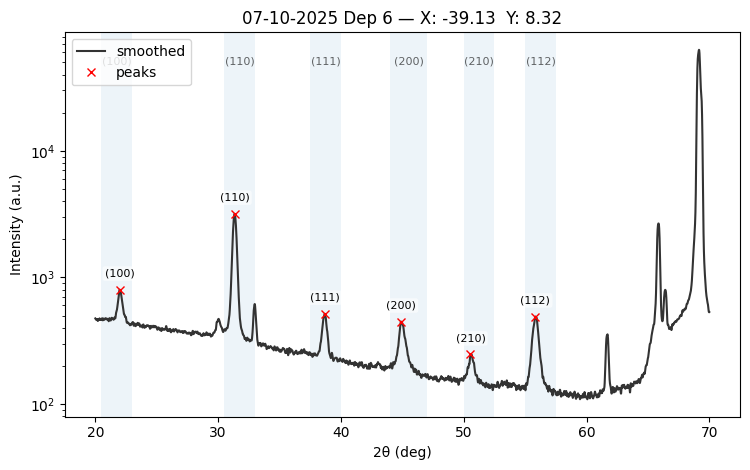


BTO_Mapping_Theta2Theta_07-10-2025_001_34_-9-781_-2-079.xy  peaks: 6
  (100)    [R1]   22.030°   I≈552.0   FWHM≈1.1233°   Area≈63.24
  (110)    [R2]   31.370°   I≈1388.4   FWHM≈1.8196°   Area≈461.49
  (111)    [R3]   38.720°   I≈1054.5   FWHM≈1.4617°   Area≈351.33
  (200)    [R4]   45.100°   I≈275.7   FWHM≈1.4625°   Area≈82.65
  (210)    [R5]   50.570°   I≈183.3   FWHM≈1.1706°   Area≈34.96
  (112)    [R6]   55.950°   I≈625.7   FWHM≈1.8038°   Area≈271.08


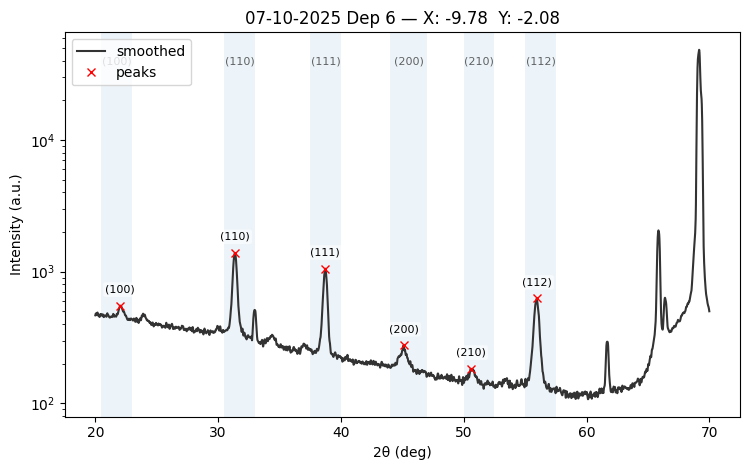


BTO_Mapping_Theta2Theta_07-10-2025_001_35_-19-563_-4-158.xy  peaks: 6
  (100)    [R1]   22.000°   I≈587.2   FWHM≈1.1293°   Area≈97.43
  (110)    [R2]   31.360°   I≈2438.4   FWHM≈1.8197°   Area≈847.95
  (111)    [R3]   38.720°   I≈840.6   FWHM≈1.5056°   Area≈282.34
  (200)    [R4]   45.040°   I≈306.4   FWHM≈1.7209°   Area≈102.21
  (210)    [R5]   50.710°   I≈215.3   FWHM≈1.4357°   Area≈44.46
  (112)    [R6]   55.870°   I≈579.0   FWHM≈1.8678°   Area≈262.16


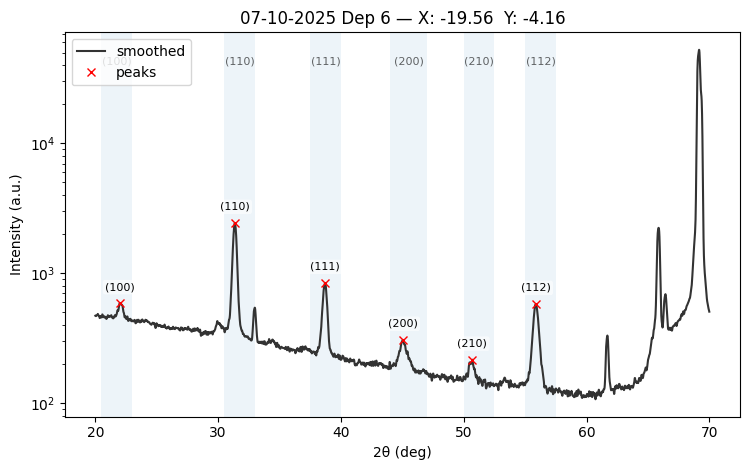


BTO_Mapping_Theta2Theta_07-10-2025_001_36_-29-344_-6-237.xy  peaks: 6
  (100)    [R1]   21.990°   I≈724.8   FWHM≈1.1749°   Area≈167.97
  (110)    [R2]   31.340°   I≈2974.1   FWHM≈1.8397°   Area≈1075.62
  (111)    [R3]   38.660°   I≈577.7   FWHM≈1.5452°   Area≈171.48
  (200)    [R4]   44.980°   I≈424.2   FWHM≈2.2820°   Area≈171.57
  (210)    [R5]   50.600°   I≈243.6   FWHM≈1.6716°   Area≈58.20
  (112)    [R6]   55.840°   I≈550.5   FWHM≈1.9114°   Area≈239.04


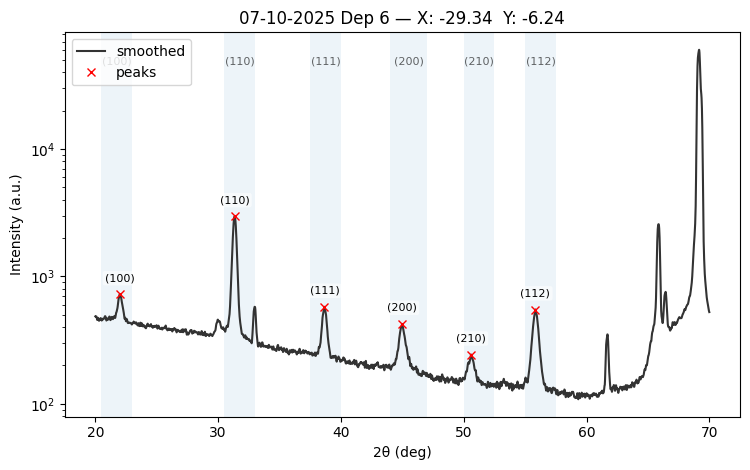


BTO_Mapping_Theta2Theta_07-10-2025_001_37_-39-126_-8-316.xy  peaks: 6
  (100)    [R1]   21.950°   I≈804.8   FWHM≈1.2207°   Area≈202.92
  (110)    [R2]   31.320°   I≈3705.7   FWHM≈1.8623°   Area≈1372.76
  (111)    [R3]   38.630°   I≈447.2   FWHM≈1.6046°   Area≈120.11
  (200)    [R4]   44.880°   I≈475.2   FWHM≈2.3724°   Area≈200.04
  (210)    [R5]   50.590°   I≈255.6   FWHM≈1.7363°   Area≈71.06
  (112)    [R6]   55.800°   I≈489.3   FWHM≈1.9962°   Area≈246.34


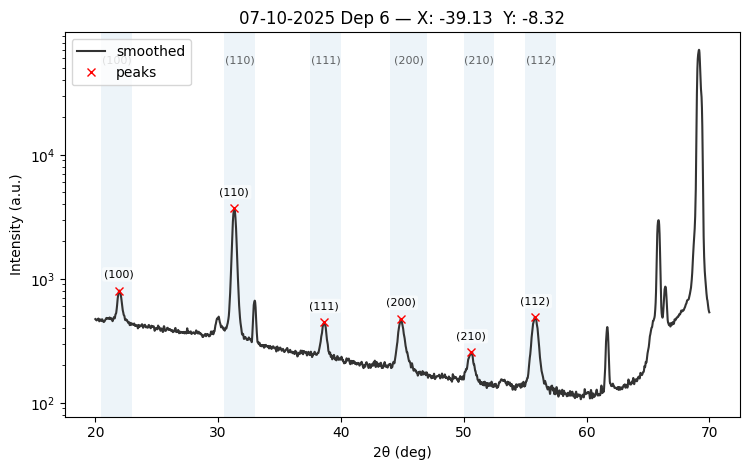


BTO_Mapping_Theta2Theta_07-10-2025_001_38_-8-090_-5-878.xy  peaks: 6
  (100)    [R1]   22.110°   I≈563.5   FWHM≈1.1269°   Area≈78.97
  (110)    [R2]   31.370°   I≈1340.4   FWHM≈1.8119°   Area≈432.80
  (111)    [R3]   38.740°   I≈1044.6   FWHM≈1.4670°   Area≈356.27
  (200)    [R4]   45.040°   I≈275.9   FWHM≈1.4457°   Area≈96.68
  (210)    [R5]   50.640°   I≈184.2   FWHM≈1.2198°   Area≈37.58
  (112)    [R6]   55.960°   I≈629.3   FWHM≈1.8039°   Area≈280.28


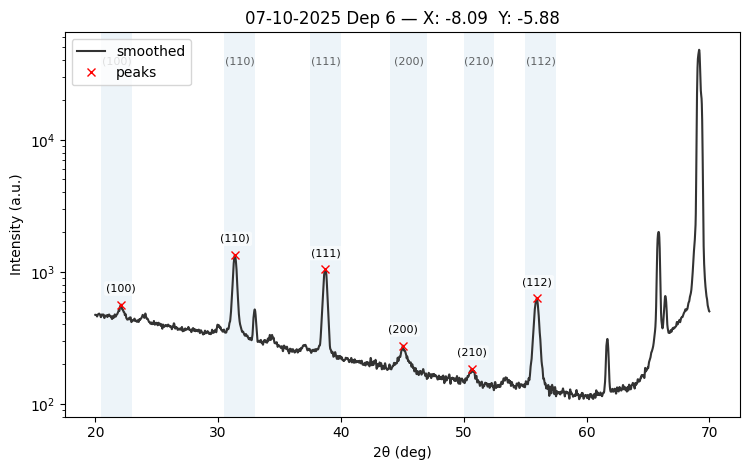


BTO_Mapping_Theta2Theta_07-10-2025_001_39_-16-180_-11-756.xy  peaks: 6
  (100)    [R1]   22.050°   I≈591.1   FWHM≈1.1495°   Area≈90.15
  (110)    [R2]   31.370°   I≈2295.9   FWHM≈1.8222°   Area≈784.43
  (111)    [R3]   38.690°   I≈939.3   FWHM≈1.5026°   Area≈311.71
  (200)    [R4]   44.950°   I≈295.6   FWHM≈1.6514°   Area≈104.82
  (210)    [R5]   50.580°   I≈203.2   FWHM≈1.3694°   Area≈43.85
  (112)    [R6]   55.890°   I≈587.4   FWHM≈1.8736°   Area≈259.09


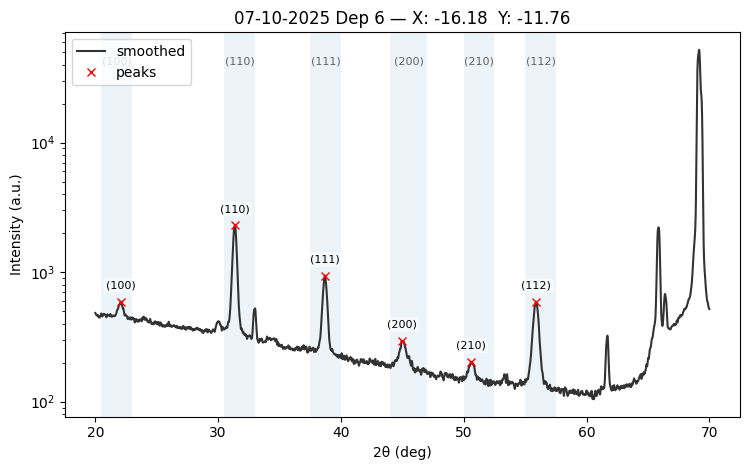


BTO_Mapping_Theta2Theta_07-10-2025_001_40_-24-271_-17-634.xy  peaks: 6
  (100)    [R1]   22.000°   I≈700.0   FWHM≈1.1886°   Area≈125.29
  (110)    [R2]   31.350°   I≈2985.4   FWHM≈1.8339°   Area≈1077.80
  (111)    [R3]   38.690°   I≈643.5   FWHM≈1.5347°   Area≈206.14
  (200)    [R4]   44.960°   I≈397.1   FWHM≈2.1637°   Area≈144.25
  (210)    [R5]   50.610°   I≈243.2   FWHM≈1.5747°   Area≈69.41
  (112)    [R6]   55.840°   I≈578.1   FWHM≈1.9183°   Area≈273.63


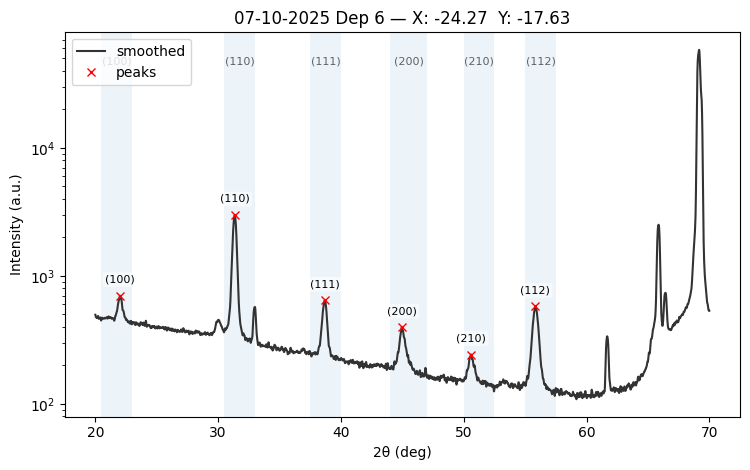


BTO_Mapping_Theta2Theta_07-10-2025_001_41_-32-361_-23-511.xy  peaks: 6
  (100)    [R1]   21.980°   I≈791.1   FWHM≈1.2085°   Area≈190.69
  (110)    [R2]   31.320°   I≈3574.8   FWHM≈1.8561°   Area≈1330.42
  (111)    [R3]   38.570°   I≈466.3   FWHM≈1.5993°   Area≈141.10
  (200)    [R4]   44.910°   I≈459.4   FWHM≈2.3415°   Area≈193.97
  (210)    [R5]   50.550°   I≈262.3   FWHM≈1.8010°   Area≈69.58
  (112)    [R6]   55.820°   I≈515.8   FWHM≈1.9886°   Area≈260.73


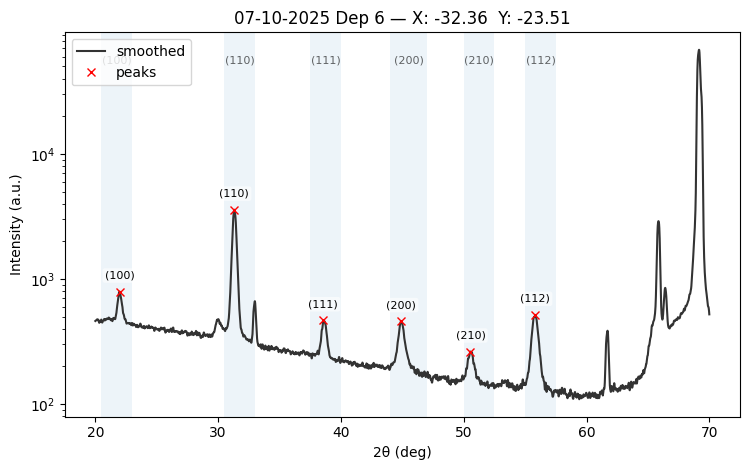


BTO_Mapping_Theta2Theta_07-10-2025_001_42_-5-000_-8-660.xy  peaks: 6
  (100)    [R1]   22.080°   I≈564.7   FWHM≈1.1518°   Area≈89.36
  (110)    [R2]   31.370°   I≈1186.6   FWHM≈1.8071°   Area≈375.75
  (111)    [R3]   38.740°   I≈1052.5   FWHM≈1.4636°   Area≈345.35
  (200)    [R4]   45.030°   I≈262.7   FWHM≈1.4643°   Area≈80.35
  (210)    [R5]   50.750°   I≈182.8   FWHM≈1.1374°   Area≈29.75
  (112)    [R6]   55.950°   I≈640.5   FWHM≈1.7938°   Area≈273.17


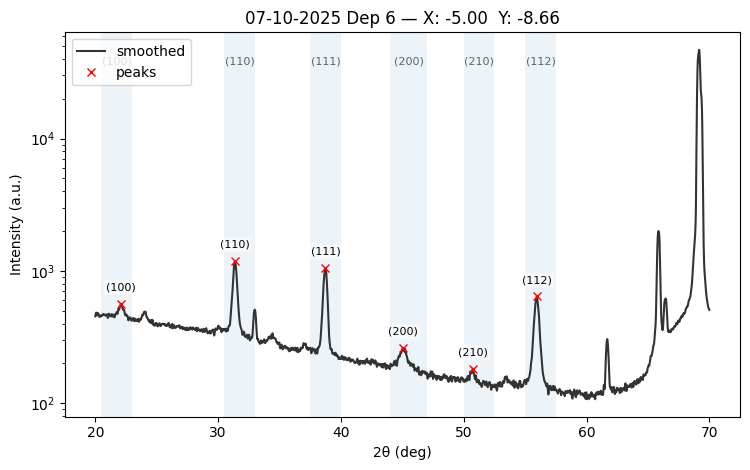


BTO_Mapping_Theta2Theta_07-10-2025_001_43_-10-000_-17-321.xy  peaks: 6
  (100)    [R1]   22.110°   I≈550.0   FWHM≈1.1655°   Area≈81.11
  (110)    [R2]   31.360°   I≈1625.5   FWHM≈1.8308°   Area≈552.55
  (111)    [R3]   38.720°   I≈1074.1   FWHM≈1.4827°   Area≈367.50
  (200)    [R4]   45.030°   I≈287.1   FWHM≈1.5223°   Area≈95.48
  (210)    [R5]   50.640°   I≈192.2   FWHM≈1.3058°   Area≈29.66
  (112)    [R6]   55.940°   I≈642.4   FWHM≈1.8337°   Area≈274.71


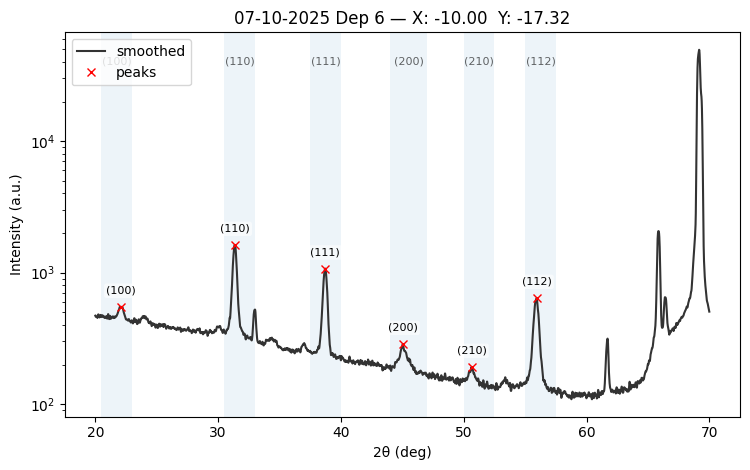


BTO_Mapping_Theta2Theta_07-10-2025_001_44_-15-000_-25-981.xy  peaks: 6
  (100)    [R1]   22.040°   I≈587.1   FWHM≈1.1590°   Area≈92.02
  (110)    [R2]   31.350°   I≈2312.1   FWHM≈1.8313°   Area≈810.29
  (111)    [R3]   38.700°   I≈950.2   FWHM≈1.5055°   Area≈322.68
  (200)    [R4]   45.060°   I≈292.0   FWHM≈1.6218°   Area≈112.67
  (210)    [R5]   50.580°   I≈213.8   FWHM≈1.4632°   Area≈48.76
  (112)    [R6]   55.870°   I≈639.0   FWHM≈1.8902°   Area≈298.35


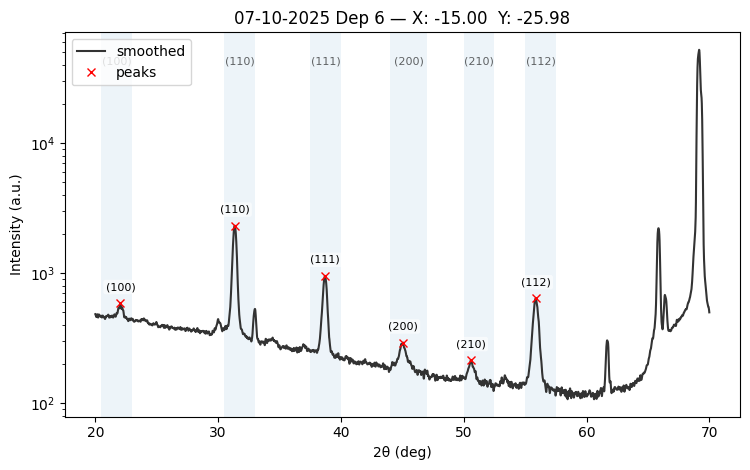


BTO_Mapping_Theta2Theta_07-10-2025_001_45_-20-000_-34-641.xy  peaks: 6
  (100)    [R1]   22.000°   I≈620.1   FWHM≈1.1679°   Area≈109.67
  (110)    [R2]   31.350°   I≈2984.8   FWHM≈1.8318°   Area≈1060.62
  (111)    [R3]   38.710°   I≈727.2   FWHM≈1.5284°   Area≈234.28
  (200)    [R4]   44.980°   I≈343.1   FWHM≈1.8404°   Area≈121.39
  (210)    [R5]   50.640°   I≈250.4   FWHM≈1.6355°   Area≈53.93
  (112)    [R6]   55.830°   I≈622.6   FWHM≈1.9267°   Area≈288.94


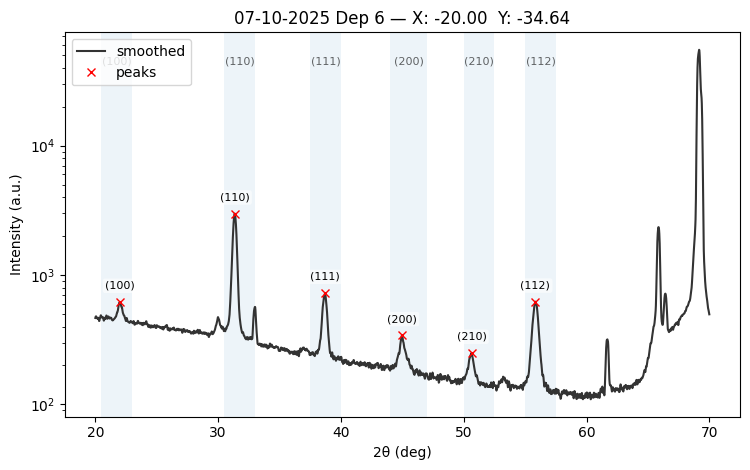


BTO_Mapping_Theta2Theta_07-10-2025_001_46_-1-045_-9-945.xy  peaks: 6
  (100)    [R1]   22.070°   I≈544.8   FWHM≈1.1233°   Area≈72.98
  (110)    [R2]   31.380°   I≈1122.0   FWHM≈1.8043°   Area≈362.09
  (111)    [R3]   38.740°   I≈1047.8   FWHM≈1.4476°   Area≈320.57
  (200)    [R4]   45.040°   I≈260.2   FWHM≈1.4555°   Area≈88.89
  (210)    [R5]   50.830°   I≈182.7   FWHM≈0.8740°   Area≈28.83
  (112)    [R6]   55.940°   I≈610.2   FWHM≈1.7767°   Area≈258.38


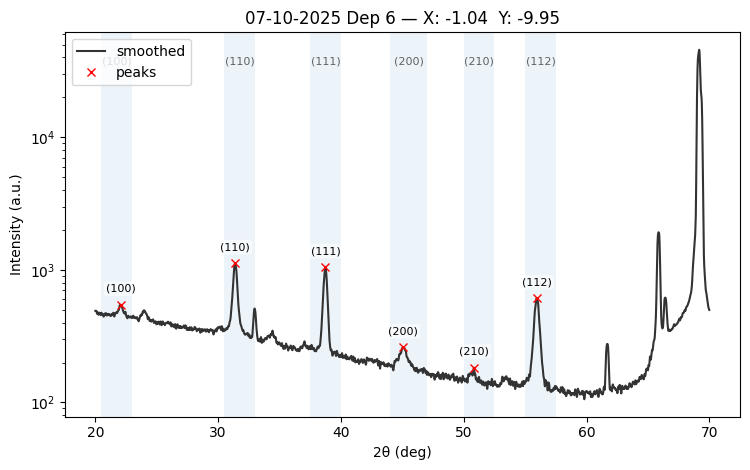


BTO_Mapping_Theta2Theta_07-10-2025_001_47_-2-091_-19-890.xy  peaks: 6
  (100)    [R1]   22.100°   I≈550.5   FWHM≈1.1240°   Area≈65.36
  (110)    [R2]   31.370°   I≈1155.0   FWHM≈1.8103°   Area≈356.20
  (111)    [R3]   38.740°   I≈1088.8   FWHM≈1.4606°   Area≈357.59
  (200)    [R4]   45.010°   I≈276.5   FWHM≈1.4967°   Area≈82.01
  (210)    [R5]   50.600°   I≈176.1   FWHM≈1.0712°   Area≈26.99
  (112)    [R6]   55.940°   I≈634.9   FWHM≈1.7949°   Area≈282.02


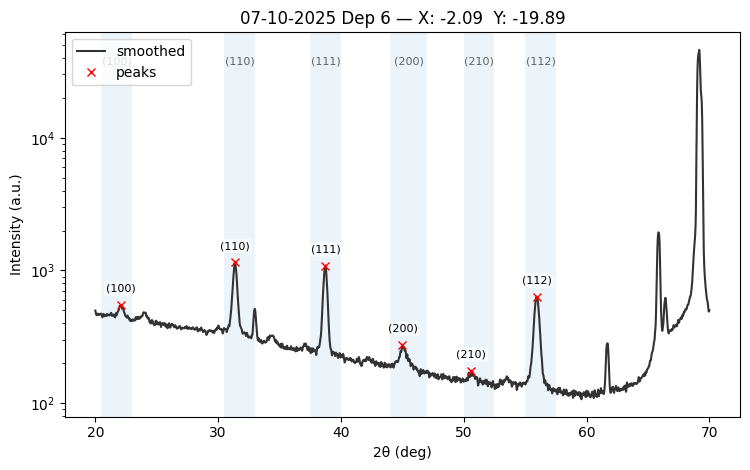


BTO_Mapping_Theta2Theta_07-10-2025_001_48_-3-136_-29-836.xy  peaks: 6
  (100)    [R1]   22.100°   I≈564.9   FWHM≈1.1220°   Area≈82.72
  (110)    [R2]   31.380°   I≈1217.7   FWHM≈1.8192°   Area≈400.43
  (111)    [R3]   38.730°   I≈1102.8   FWHM≈1.4584°   Area≈372.38
  (200)    [R4]   45.080°   I≈287.6   FWHM≈1.5148°   Area≈91.73
  (210)    [R5]   50.590°   I≈178.2   FWHM≈1.1639°   Area≈28.37
  (112)    [R6]   55.930°   I≈653.9   FWHM≈1.8085°   Area≈281.05


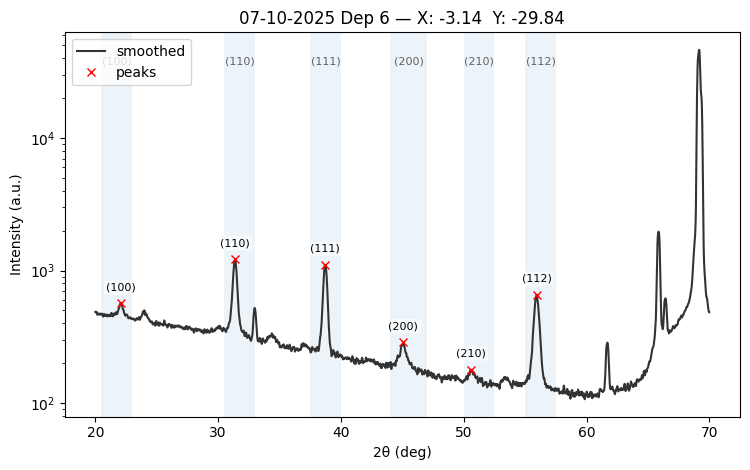


BTO_Mapping_Theta2Theta_07-10-2025_001_49_-4-181_-39-781.xy  peaks: 6
  (100)    [R1]   22.020°   I≈595.8   FWHM≈1.1542°   Area≈95.28
  (110)    [R2]   31.350°   I≈1333.7   FWHM≈1.8178°   Area≈444.56
  (111)    [R3]   38.730°   I≈1107.3   FWHM≈1.4635°   Area≈373.91
  (200)    [R4]   45.070°   I≈317.5   FWHM≈1.7320°   Area≈91.44
  (210)    [R5]   50.570°   I≈184.6   FWHM≈1.1476°   Area≈27.44
  (112)    [R6]   55.920°   I≈670.5   FWHM≈1.8101°   Area≈286.91


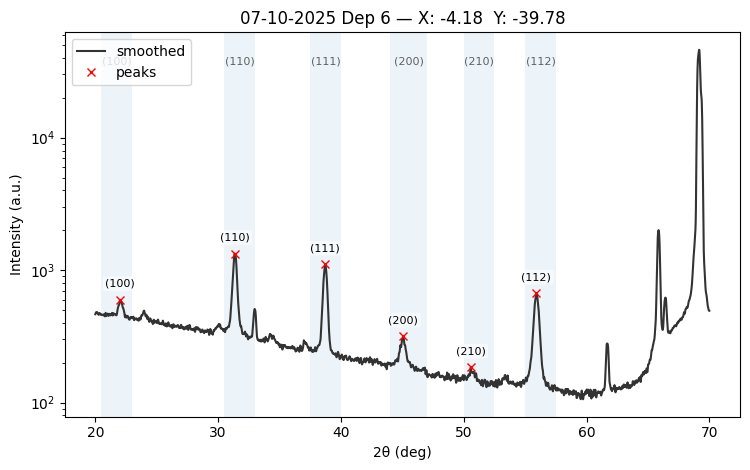


BTO_Mapping_Theta2Theta_07-10-2025_001_50_3-090_-9-511.xy  peaks: 6
  (100)    [R1]   22.070°   I≈548.3   FWHM≈1.1177°   Area≈71.13
  (110)    [R2]   31.400°   I≈1175.0   FWHM≈1.7952°   Area≈387.08
  (111)    [R3]   38.730°   I≈978.1   FWHM≈1.4442°   Area≈314.04
  (200)    [R4]   45.100°   I≈247.1   FWHM≈1.5134°   Area≈80.72
  (210)    [R5]   50.720°   I≈169.8   FWHM≈1.2041°   Area≈24.43
  (112)    [R6]   55.990°   I≈577.1   FWHM≈1.7689°   Area≈248.06


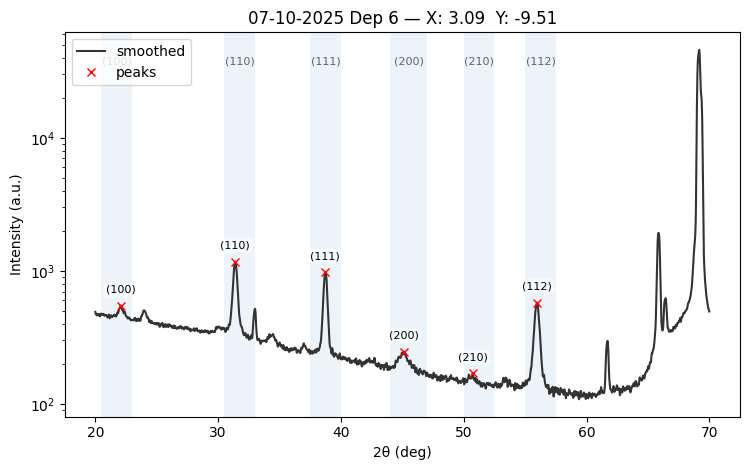


BTO_Mapping_Theta2Theta_07-10-2025_001_51_6-180_-19-021.xy  peaks: 5
  (100)    [R1]   22.120°   I≈544.5   FWHM≈1.1076°   Area≈50.83
  (110)    [R2]   31.390°   I≈1213.8   FWHM≈1.8093°   Area≈394.44
  (111)    [R3]   38.750°   I≈959.6   FWHM≈1.4415°   Area≈292.01
  (200)    [R4]   45.150°   I≈256.6   FWHM≈1.3963°   Area≈74.07
  (112)    [R6]   55.970°   I≈557.9   FWHM≈1.7658°   Area≈243.99


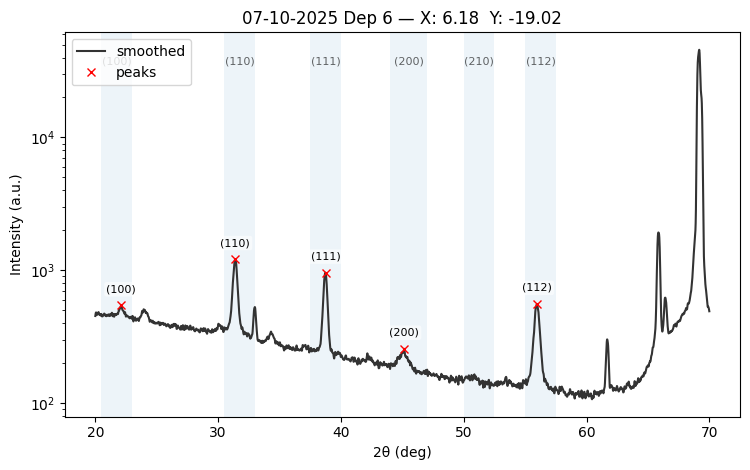


BTO_Mapping_Theta2Theta_07-10-2025_001_52_9-271_-28-532.xy  peaks: 4
  (110)    [R2]   31.400°   I≈1250.5   FWHM≈1.8016°   Area≈417.04
  (111)    [R3]   38.730°   I≈903.0   FWHM≈1.4446°   Area≈280.24
  (200)    [R4]   44.990°   I≈243.6   FWHM≈1.4398°   Area≈71.04
  (112)    [R6]   55.950°   I≈536.3   FWHM≈1.7847°   Area≈229.30


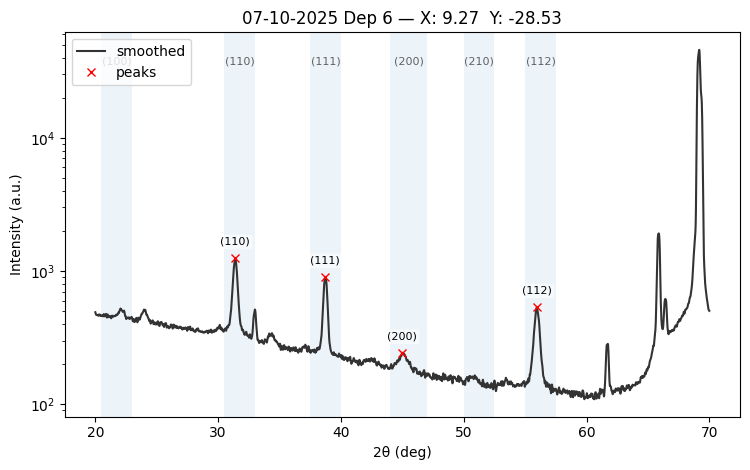


BTO_Mapping_Theta2Theta_07-10-2025_001_53_12-361_-38-042.xy  peaks: 5
  (110)    [R2]   31.410°   I≈1227.1   FWHM≈1.8070°   Area≈422.96
  (111)    [R3]   38.760°   I≈884.2   FWHM≈1.4395°   Area≈268.49
  (200)    [R4]   45.110°   I≈236.9   FWHM≈1.3270°   Area≈53.47
  (210)    [R5]   50.640°   I≈168.7   FWHM≈1.1497°   Area≈27.49
  (112)    [R6]   55.960°   I≈482.2   FWHM≈1.7917°   Area≈203.35


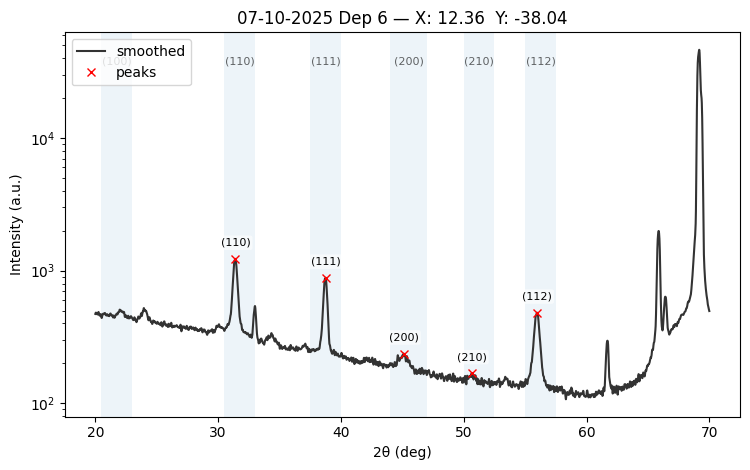


BTO_Mapping_Theta2Theta_07-10-2025_001_54_6-691_-7-431.xy  peaks: 4
  (110)    [R2]   31.390°   I≈1203.6   FWHM≈1.7984°   Area≈400.30
  (111)    [R3]   38.730°   I≈931.6   FWHM≈1.4419°   Area≈290.28
  (200)    [R4]   45.200°   I≈235.9   FWHM≈1.5205°   Area≈68.68
  (112)    [R6]   55.960°   I≈534.5   FWHM≈1.7687°   Area≈224.86


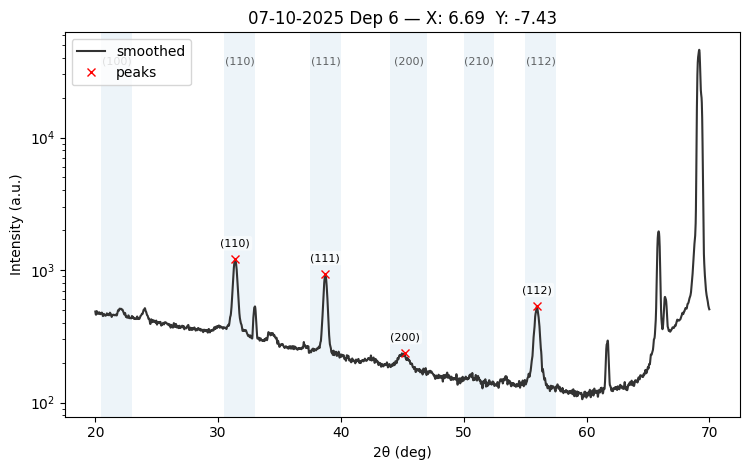


BTO_Mapping_Theta2Theta_07-10-2025_001_55_13-383_-14-863.xy  peaks: 4
  (110)    [R2]   31.400°   I≈1192.5   FWHM≈1.8054°   Area≈400.93
  (111)    [R3]   38.720°   I≈822.2   FWHM≈1.4538°   Area≈245.33
  (200)    [R4]   44.870°   I≈246.3   FWHM≈1.3629°   Area≈77.33
  (112)    [R6]   55.980°   I≈450.2   FWHM≈1.7743°   Area≈181.13


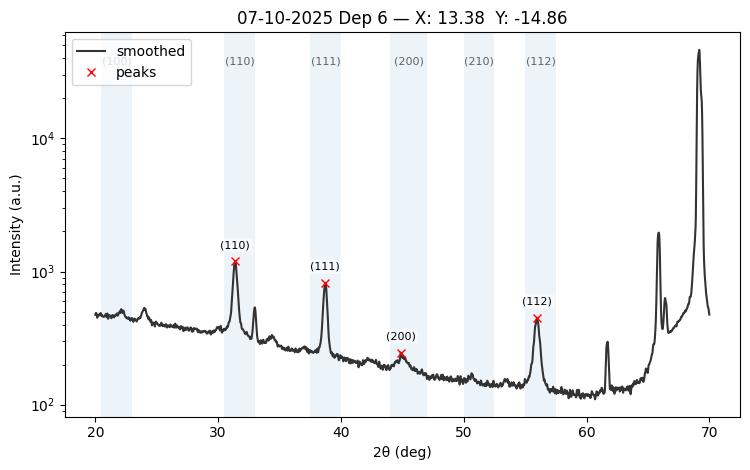


BTO_Mapping_Theta2Theta_07-10-2025_001_56_20-074_-22-294.xy  peaks: 4
  (110)    [R2]   31.400°   I≈1091.9   FWHM≈1.8120°   Area≈372.72
  (111)    [R3]   38.730°   I≈767.9   FWHM≈1.4614°   Area≈216.80
  (200)    [R4]   44.930°   I≈233.9   FWHM≈1.5276°   Area≈67.02
  (112)    [R6]   55.990°   I≈369.3   FWHM≈1.8051°   Area≈150.19


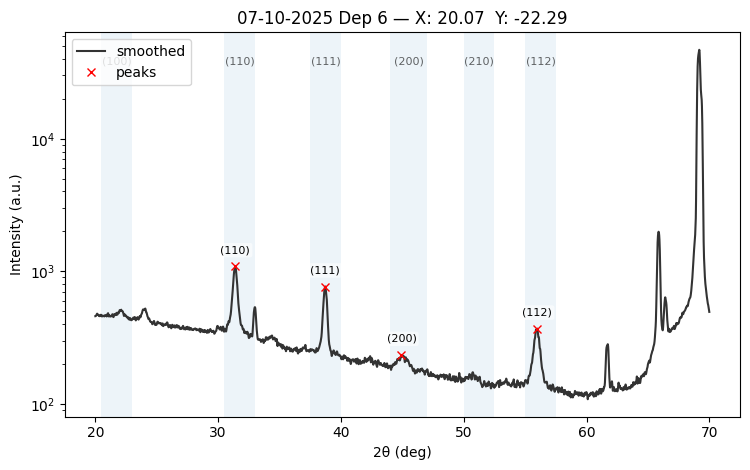


BTO_Mapping_Theta2Theta_07-10-2025_001_57_26-765_-29-726.xy  peaks: 4
  (110)    [R2]   31.370°   I≈1072.3   FWHM≈1.8147°   Area≈356.29
  (111)    [R3]   38.730°   I≈700.0   FWHM≈1.4701°   Area≈204.83
  (200)    [R4]   45.230°   I≈230.0   FWHM≈1.5203°   Area≈50.91
  (112)    [R6]   55.880°   I≈329.5   FWHM≈1.6939°   Area≈128.57


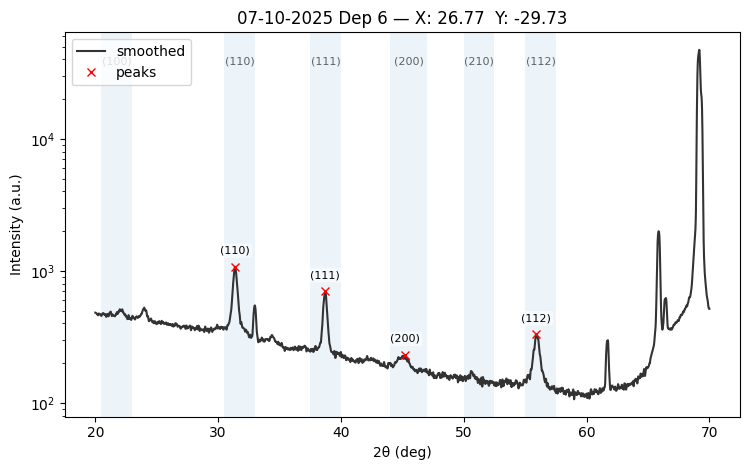


BTO_Mapping_Theta2Theta_07-10-2025_001_58_9-135_-4-067.xy  peaks: 4
  (110)    [R2]   31.400°   I≈1196.1   FWHM≈1.8047°   Area≈402.98
  (111)    [R3]   38.730°   I≈861.4   FWHM≈1.4420°   Area≈263.54
  (200)    [R4]   45.040°   I≈239.3   FWHM≈1.3254°   Area≈56.06
  (112)    [R6]   55.920°   I≈468.1   FWHM≈1.7724°   Area≈197.26


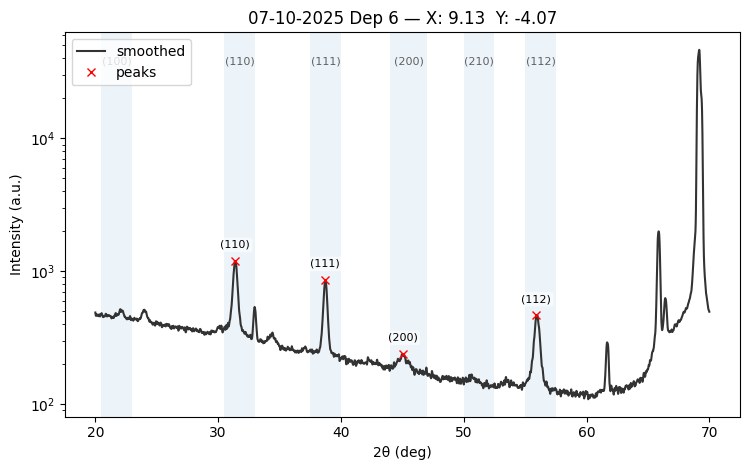


BTO_Mapping_Theta2Theta_07-10-2025_001_59_18-271_-8-135.xy  peaks: 4
  (110)    [R2]   31.380°   I≈1072.2   FWHM≈1.8206°   Area≈358.57
  (111)    [R3]   38.710°   I≈757.6   FWHM≈1.4564°   Area≈221.14
  (200)    [R4]   44.800°   I≈233.4   FWHM≈1.5014°   Area≈52.77
  (112)    [R6]   55.960°   I≈368.6   FWHM≈1.7914°   Area≈147.47


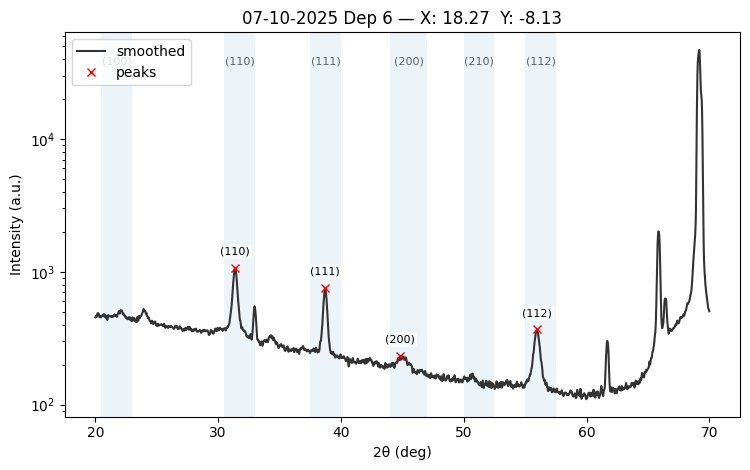


BTO_Mapping_Theta2Theta_07-10-2025_001_60_27-406_-12-202.xy  peaks: 5
  (110)    [R2]   31.390°   I≈965.1   FWHM≈1.8306°   Area≈308.61
  (111)    [R3]   38.710°   I≈657.8   FWHM≈1.4669°   Area≈189.32
  (200)    [R4]   44.910°   I≈228.5   FWHM≈1.2752°   Area≈56.47
  (210)    [R5]   50.820°   I≈173.1   FWHM≈1.0697°   Area≈26.08
  (112)    [R6]   55.870°   I≈300.1   FWHM≈1.5675°   Area≈112.38


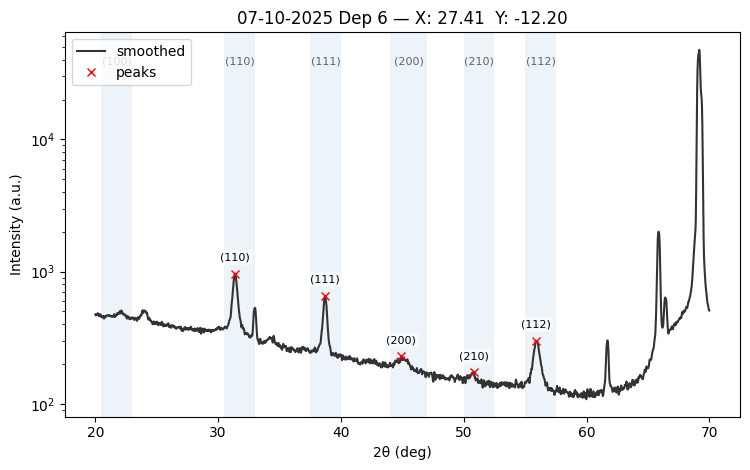


BTO_Mapping_Theta2Theta_07-10-2025_001_61_36-542_-16-269.xy  peaks: 3
  (110)    [R2]   31.360°   I≈928.8   FWHM≈1.8228°   Area≈323.96
  (111)    [R3]   38.700°   I≈553.0   FWHM≈1.4842°   Area≈159.05
  (112)    [R6]   55.910°   I≈247.8   FWHM≈1.2832°   Area≈94.34


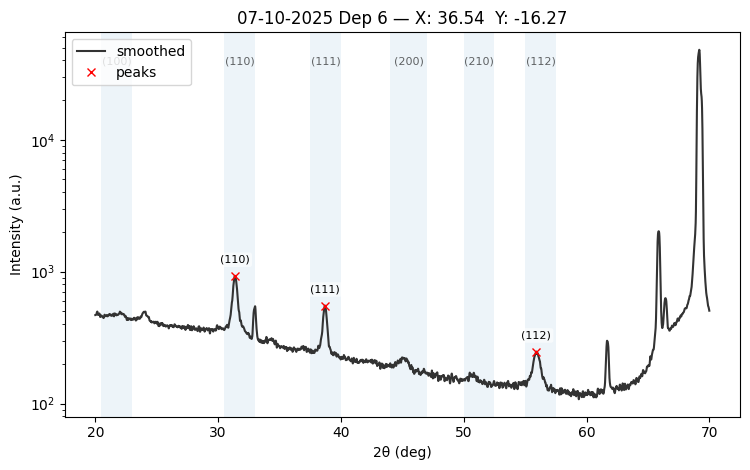


Individual plots for: 08-10-2025 Dep 7

BTO_Mapping_Theta2Theta_08-10-2025_001_01_0-000_0-000.xy  peaks: 5
  (100)    [R1]   21.990°   I≈547.7   FWHM≈1.1815°   Area≈68.15
  (110)    [R2]   31.390°   I≈1098.3   FWHM≈1.8141°   Area≈369.34
  (111)    [R3]   38.700°   I≈1176.9   FWHM≈1.4682°   Area≈407.67
  (200)    [R4]   45.040°   I≈269.4   FWHM≈1.5004°   Area≈71.68
  (112)    [R6]   55.910°   I≈700.6   FWHM≈1.7975°   Area≈305.31


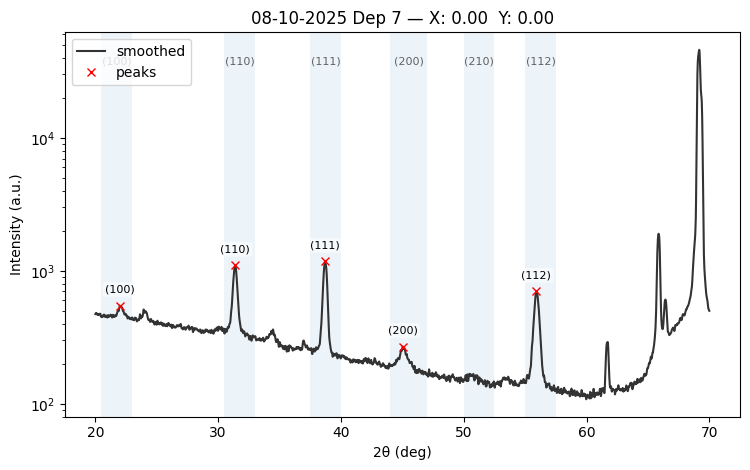


BTO_Mapping_Theta2Theta_08-10-2025_001_02_10-000_0-000.xy  peaks: 4
  (110)    [R2]   31.400°   I≈1245.7   FWHM≈1.8155°   Area≈405.60
  (111)    [R3]   38.700°   I≈985.7   FWHM≈1.4681°   Area≈308.35
  (200)    [R4]   44.950°   I≈250.1   FWHM≈1.5830°   Area≈63.01
  (112)    [R6]   55.890°   I≈563.0   FWHM≈1.8051°   Area≈241.90


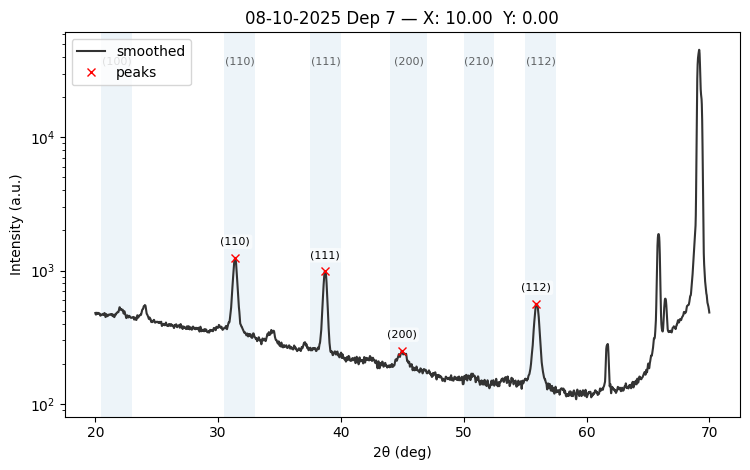


BTO_Mapping_Theta2Theta_08-10-2025_001_03_20-000_0-000.xy  peaks: 4
  (110)    [R2]   31.370°   I≈1052.9   FWHM≈1.8449°   Area≈354.88
  (111)    [R3]   38.710°   I≈841.3   FWHM≈1.4810°   Area≈257.75
  (200)    [R4]   44.840°   I≈247.8   FWHM≈1.6409°   Area≈65.54
  (112)    [R6]   55.940°   I≈426.2   FWHM≈1.8221°   Area≈180.47


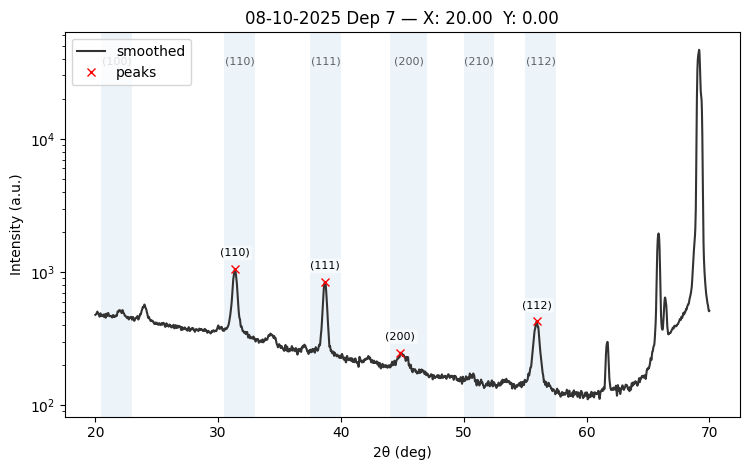


BTO_Mapping_Theta2Theta_08-10-2025_001_04_30-000_0-000.xy  peaks: 4
  (110)    [R2]   31.340°   I≈1002.2   FWHM≈1.8544°   Area≈348.86
  (111)    [R3]   38.690°   I≈723.0   FWHM≈1.4903°   Area≈204.27
  (200)    [R4]   44.960°   I≈249.0   FWHM≈1.5044°   Area≈64.27
  (112)    [R6]   55.930°   I≈341.8   FWHM≈1.8005°   Area≈129.61


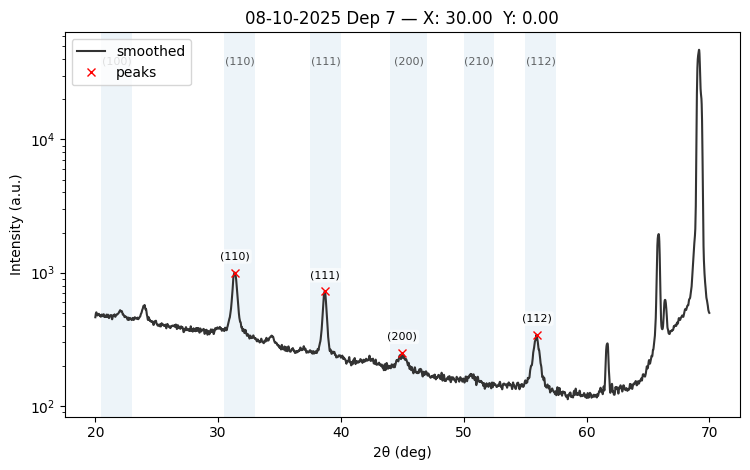


BTO_Mapping_Theta2Theta_08-10-2025_001_05_40-000_0-000.xy  peaks: 5
  (110)    [R2]   31.320°   I≈981.0   FWHM≈1.8634°   Area≈332.15
  (111)    [R3]   38.690°   I≈575.5   FWHM≈1.5123°   Area≈162.87
  (200)    [R4]   45.160°   I≈230.2   FWHM≈1.4983°   Area≈56.85
  (210)    [R5]   50.700°   I≈182.2   FWHM≈1.2468°   Area≈32.12
  (112)    [R6]   55.850°   I≈265.9   FWHM≈1.3978°   Area≈99.10


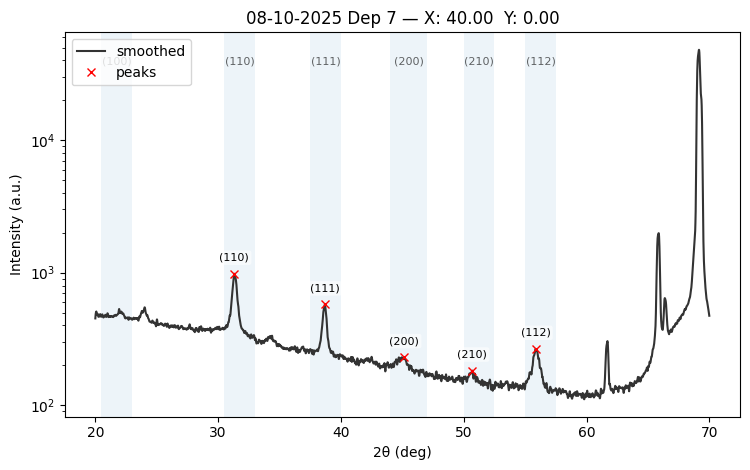


BTO_Mapping_Theta2Theta_08-10-2025_001_06_9-135_4-067.xy  peaks: 4
  (110)    [R2]   31.400°   I≈1244.1   FWHM≈1.8045°   Area≈418.18
  (111)    [R3]   38.730°   I≈1001.0   FWHM≈1.4665°   Area≈310.63
  (200)    [R4]   45.020°   I≈244.7   FWHM≈1.5535°   Area≈60.56
  (112)    [R6]   55.950°   I≈573.3   FWHM≈1.7874°   Area≈244.70


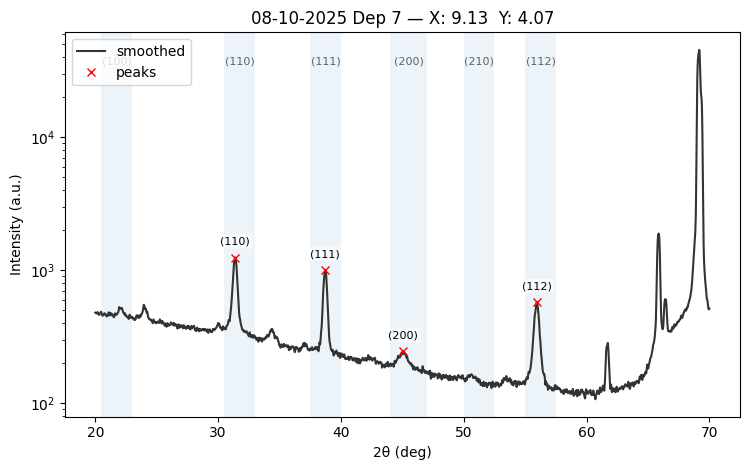


BTO_Mapping_Theta2Theta_08-10-2025_001_07_18-271_8-135.xy  peaks: 4
  (110)    [R2]   31.370°   I≈1066.2   FWHM≈1.8367°   Area≈364.39
  (111)    [R3]   38.710°   I≈836.0   FWHM≈1.4743°   Area≈248.80
  (200)    [R4]   44.680°   I≈240.2   FWHM≈1.6270°   Area≈59.75
  (112)    [R6]   55.950°   I≈435.7   FWHM≈1.8160°   Area≈185.44


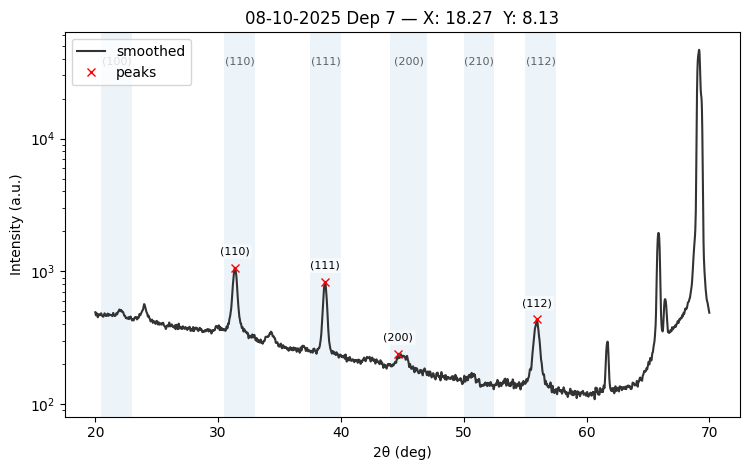


BTO_Mapping_Theta2Theta_08-10-2025_001_08_27-406_12-202.xy  peaks: 4
  (110)    [R2]   31.370°   I≈1015.1   FWHM≈1.8391°   Area≈341.87
  (111)    [R3]   38.680°   I≈697.4   FWHM≈1.4974°   Area≈206.07
  (200)    [R4]   45.190°   I≈242.2   FWHM≈1.5613°   Area≈71.78
  (112)    [R6]   55.940°   I≈322.6   FWHM≈1.7277°   Area≈128.87


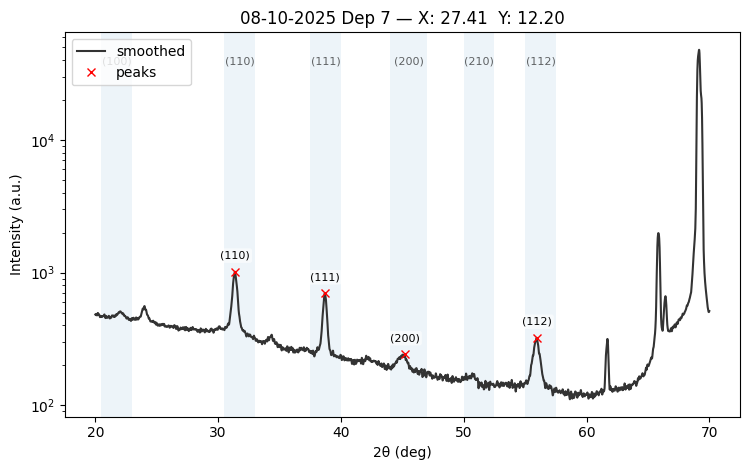


BTO_Mapping_Theta2Theta_08-10-2025_001_09_36-542_16-269.xy  peaks: 4
  (110)    [R2]   31.360°   I≈980.9   FWHM≈1.8456°   Area≈321.36
  (111)    [R3]   38.680°   I≈559.1   FWHM≈1.5052°   Area≈155.44
  (200)    [R4]   44.830°   I≈228.3   FWHM≈1.5077°   Area≈54.72
  (112)    [R6]   55.960°   I≈258.9   FWHM≈1.3196°   Area≈91.66


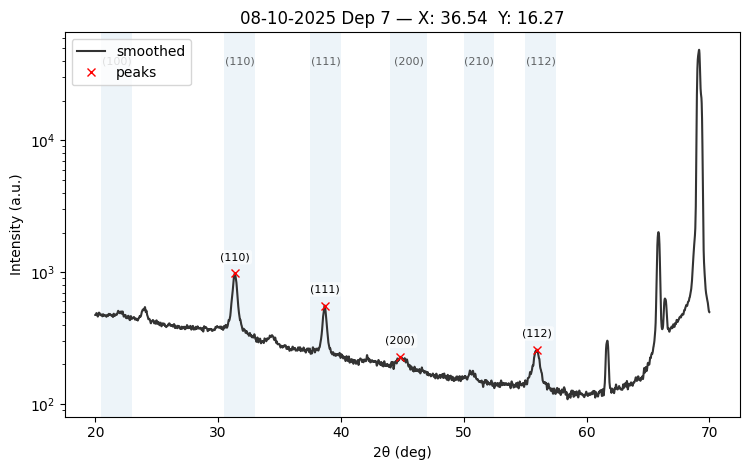


BTO_Mapping_Theta2Theta_08-10-2025_001_10_6-691_7-431.xy  peaks: 4
  (110)    [R2]   31.410°   I≈1255.7   FWHM≈1.7968°   Area≈415.61
  (111)    [R3]   38.740°   I≈1030.4   FWHM≈1.4464°   Area≈314.82
  (200)    [R4]   45.050°   I≈253.9   FWHM≈1.5402°   Area≈71.65
  (112)    [R6]   55.930°   I≈576.8   FWHM≈1.7920°   Area≈270.50


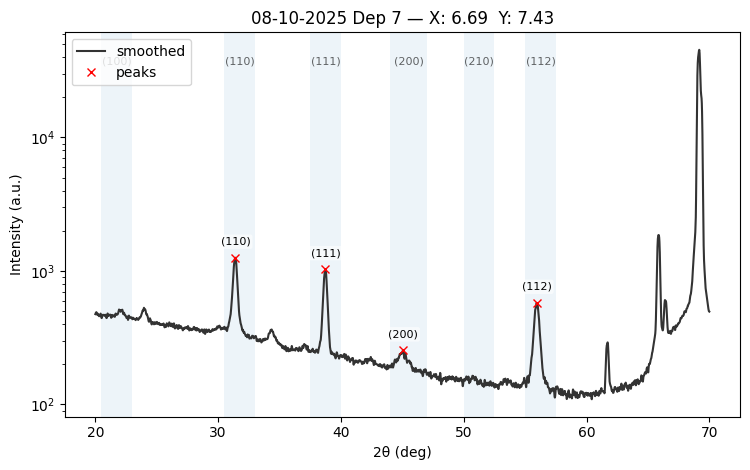


BTO_Mapping_Theta2Theta_08-10-2025_001_11_13-383_14-863.xy  peaks: 4
  (110)    [R2]   31.380°   I≈1106.2   FWHM≈1.8218°   Area≈380.04
  (111)    [R3]   38.720°   I≈849.8   FWHM≈1.4617°   Area≈257.59
  (200)    [R4]   45.170°   I≈245.3   FWHM≈1.5124°   Area≈54.01
  (112)    [R6]   55.940°   I≈451.1   FWHM≈1.7899°   Area≈189.38


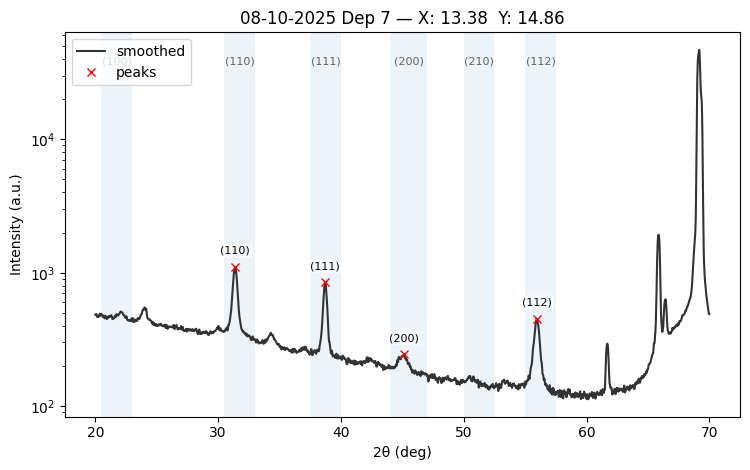


BTO_Mapping_Theta2Theta_08-10-2025_001_12_20-074_22-294.xy  peaks: 4
  (110)    [R2]   31.370°   I≈1046.6   FWHM≈1.8301°   Area≈350.83
  (111)    [R3]   38.700°   I≈726.6   FWHM≈1.4727°   Area≈208.07
  (200)    [R4]   45.060°   I≈240.3   FWHM≈1.4981°   Area≈48.60
  (112)    [R6]   55.960°   I≈359.1   FWHM≈1.8258°   Area≈138.27


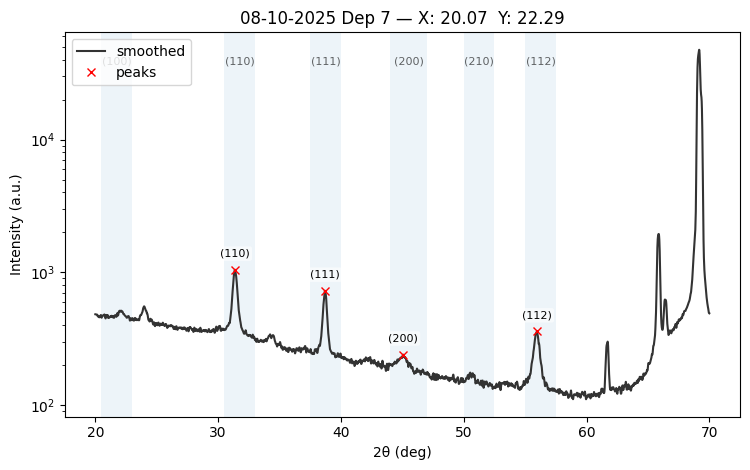


BTO_Mapping_Theta2Theta_08-10-2025_001_13_26-765_29-726.xy  peaks: 5
  (110)    [R2]   31.390°   I≈1015.2   FWHM≈1.8299°   Area≈334.80
  (111)    [R3]   38.710°   I≈572.6   FWHM≈1.4995°   Area≈157.33
  (200)    [R4]   45.040°   I≈230.3   FWHM≈1.6254°   Area≈60.51
  (210)    [R5]   50.750°   I≈182.1   FWHM≈1.2147°   Area≈25.78
  (112)    [R6]   55.970°   I≈280.5   FWHM≈1.3938°   Area≈94.59


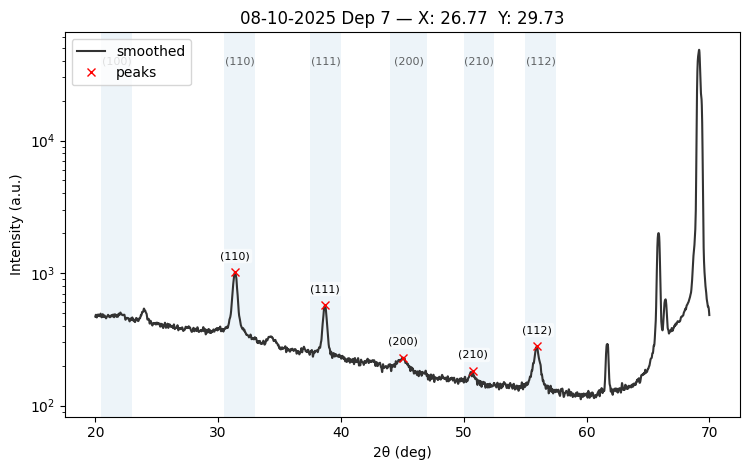


BTO_Mapping_Theta2Theta_08-10-2025_001_14_3-090_9-511.xy  peaks: 5
  (100)    [R1]   22.040°   I≈548.3   FWHM≈1.1126°   Area≈59.22
  (110)    [R2]   31.400°   I≈1218.2   FWHM≈1.7953°   Area≈390.53
  (111)    [R3]   38.730°   I≈1063.7   FWHM≈1.4567°   Area≈332.96
  (200)    [R4]   45.050°   I≈261.0   FWHM≈1.5199°   Area≈72.19
  (112)    [R6]   55.960°   I≈628.4   FWHM≈1.7700°   Area≈265.41


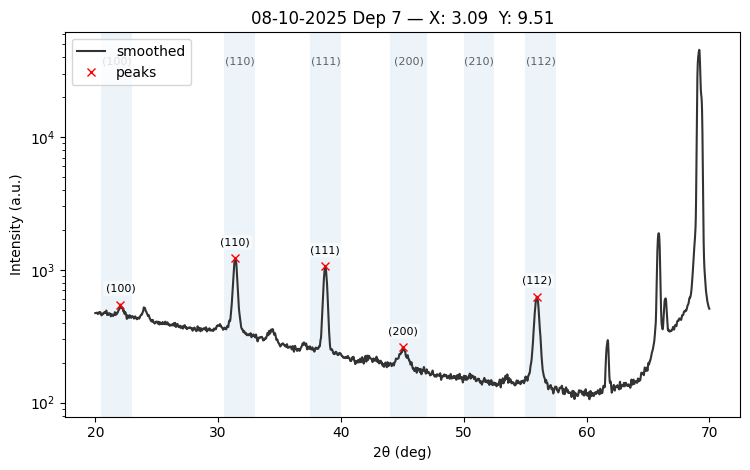


BTO_Mapping_Theta2Theta_08-10-2025_001_15_6-180_19-021.xy  peaks: 4
  (110)    [R2]   31.400°   I≈1234.8   FWHM≈1.8065°   Area≈417.92
  (111)    [R3]   38.700°   I≈916.9   FWHM≈1.4480°   Area≈287.64
  (200)    [R4]   45.070°   I≈240.4   FWHM≈1.5389°   Area≈67.00
  (112)    [R6]   55.990°   I≈517.7   FWHM≈1.7743°   Area≈218.23


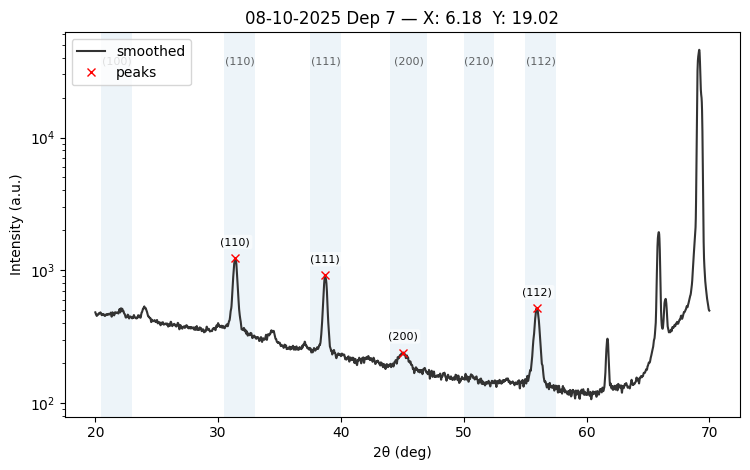


BTO_Mapping_Theta2Theta_08-10-2025_001_16_9-271_28-532.xy  peaks: 4
  (110)    [R2]   31.390°   I≈1091.7   FWHM≈1.8096°   Area≈367.35
  (111)    [R3]   38.730°   I≈791.2   FWHM≈1.4593°   Area≈244.18
  (200)    [R4]   45.070°   I≈244.6   FWHM≈1.3749°   Area≈60.80
  (112)    [R6]   55.940°   I≈419.4   FWHM≈1.7692°   Area≈175.18


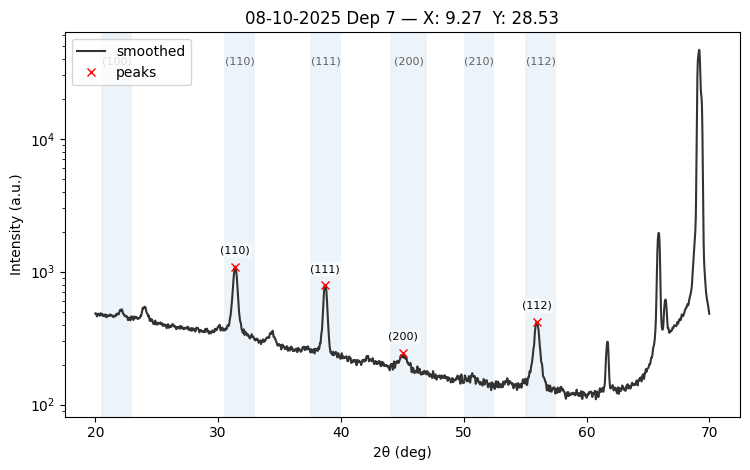


BTO_Mapping_Theta2Theta_08-10-2025_001_17_12-361_38-042.xy  peaks: 5
  (110)    [R2]   31.400°   I≈1083.8   FWHM≈1.8117°   Area≈348.40
  (111)    [R3]   38.720°   I≈679.7   FWHM≈1.4642°   Area≈201.77
  (200)    [R4]   44.990°   I≈237.7   FWHM≈1.3161°   Area≈63.90
  (210)    [R5]   50.760°   I≈182.3   FWHM≈0.9595°   Area≈29.60
  (112)    [R6]   55.980°   I≈334.0   FWHM≈1.6993°   Area≈126.27


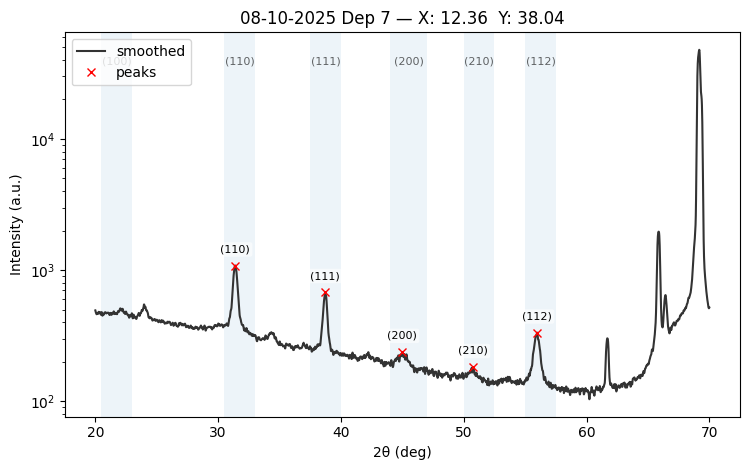


BTO_Mapping_Theta2Theta_08-10-2025_001_18_-1-045_9-945.xy  peaks: 5
  (100)    [R1]   22.120°   I≈547.8   FWHM≈1.1355°   Area≈53.97
  (110)    [R2]   31.410°   I≈1131.4   FWHM≈1.7888°   Area≈368.64
  (111)    [R3]   38.730°   I≈1132.9   FWHM≈1.4526°   Area≈367.01
  (200)    [R4]   45.140°   I≈275.6   FWHM≈1.5430°   Area≈86.65
  (112)    [R6]   55.970°   I≈670.9   FWHM≈1.7804°   Area≈291.77


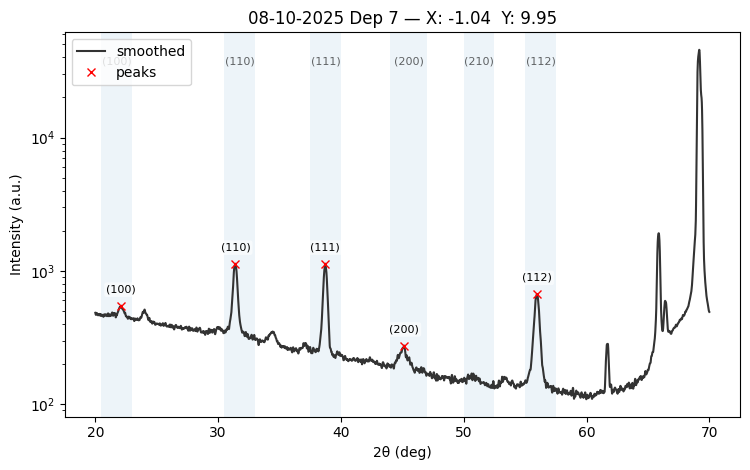


BTO_Mapping_Theta2Theta_08-10-2025_001_19_-2-091_19-890.xy  peaks: 4
  (110)    [R2]   31.410°   I≈1224.7   FWHM≈1.7892°   Area≈405.08
  (111)    [R3]   38.730°   I≈1064.8   FWHM≈1.4366°   Area≈327.22
  (200)    [R4]   45.100°   I≈253.7   FWHM≈1.3602°   Area≈73.82
  (112)    [R6]   55.990°   I≈628.1   FWHM≈1.7661°   Area≈263.87


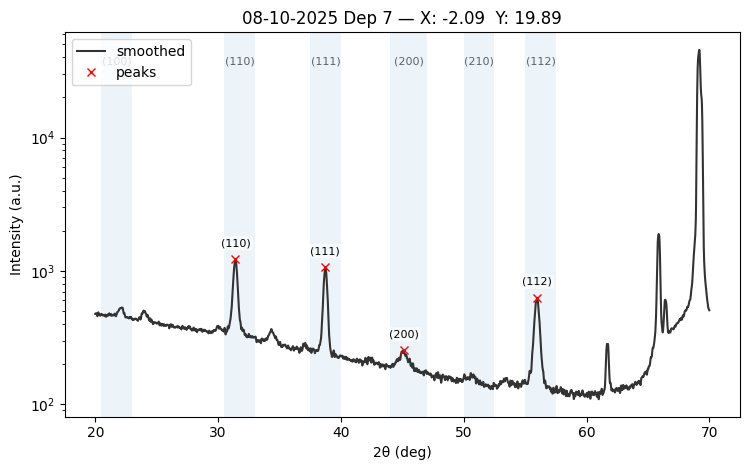


BTO_Mapping_Theta2Theta_08-10-2025_001_20_-3-136_29-836.xy  peaks: 4
  (110)    [R2]   31.410°   I≈1277.9   FWHM≈1.7812°   Area≈423.77
  (111)    [R3]   38.720°   I≈937.5   FWHM≈1.4358°   Area≈297.16
  (200)    [R4]   45.000°   I≈238.4   FWHM≈1.4555°   Area≈65.49
  (112)    [R6]   56.000°   I≈558.6   FWHM≈1.7627°   Area≈233.25


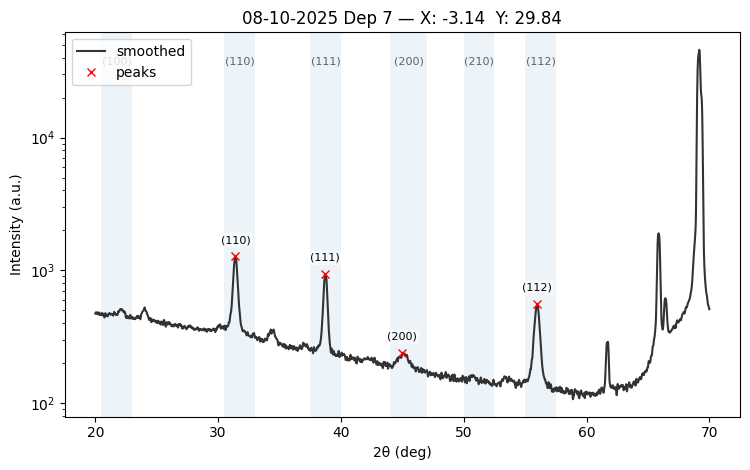


BTO_Mapping_Theta2Theta_08-10-2025_001_21_-4-181_39-781.xy  peaks: 4
  (110)    [R2]   31.410°   I≈1226.8   FWHM≈1.7812°   Area≈413.45
  (111)    [R3]   38.740°   I≈858.8   FWHM≈1.4348°   Area≈256.40
  (200)    [R4]   45.130°   I≈239.5   FWHM≈1.5663°   Area≈60.05
  (112)    [R6]   55.980°   I≈462.1   FWHM≈1.7651°   Area≈201.68


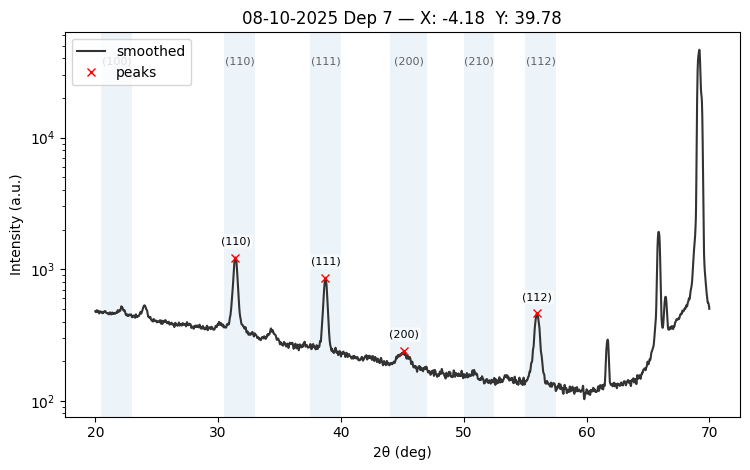


BTO_Mapping_Theta2Theta_08-10-2025_001_22_-5-000_8-660.xy  peaks: 5
  (100)    [R1]   22.100°   I≈544.1   FWHM≈1.1176°   Area≈60.83
  (110)    [R2]   31.370°   I≈1102.1   FWHM≈1.7992°   Area≈349.83
  (111)    [R3]   38.740°   I≈1166.8   FWHM≈1.4569°   Area≈395.59
  (200)    [R4]   45.070°   I≈267.1   FWHM≈1.4452°   Area≈83.82
  (112)    [R6]   55.950°   I≈716.7   FWHM≈1.7847°   Area≈309.98


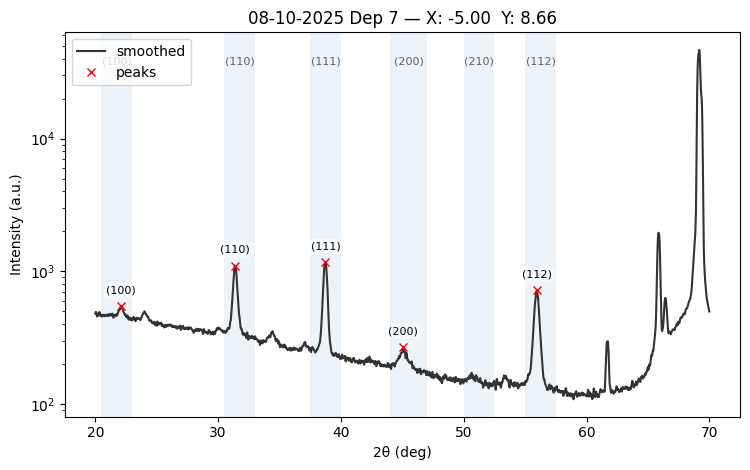


BTO_Mapping_Theta2Theta_08-10-2025_001_23_-10-000_17-321.xy  peaks: 5
  (100)    [R1]   22.090°   I≈563.5   FWHM≈1.0907°   Area≈87.84
  (110)    [R2]   31.420°   I≈1084.1   FWHM≈1.7941°   Area≈346.11
  (111)    [R3]   38.730°   I≈1137.7   FWHM≈1.4553°   Area≈382.87
  (200)    [R4]   45.030°   I≈261.6   FWHM≈1.5666°   Area≈95.56
  (112)    [R6]   55.980°   I≈686.8   FWHM≈1.7742°   Area≈297.44


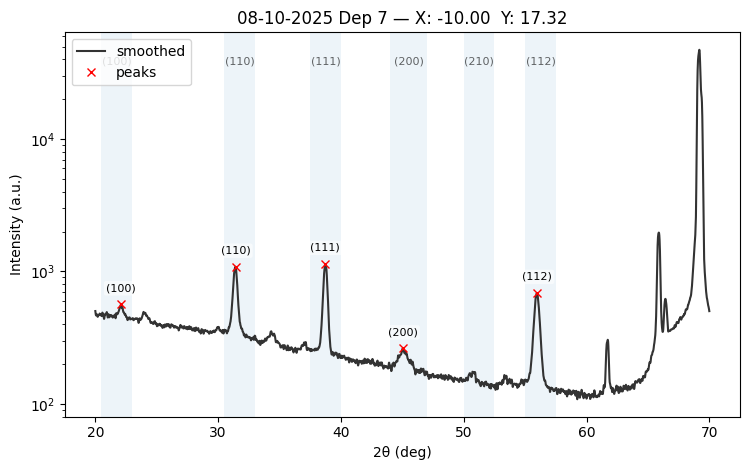


BTO_Mapping_Theta2Theta_08-10-2025_001_24_-15-000_25-981.xy  peaks: 5
  (100)    [R1]   22.060°   I≈556.5   FWHM≈1.0876°   Area≈73.25
  (110)    [R2]   31.390°   I≈1084.6   FWHM≈1.7853°   Area≈340.90
  (111)    [R3]   38.740°   I≈1129.9   FWHM≈1.4412°   Area≈380.22
  (200)    [R4]   45.120°   I≈267.7   FWHM≈1.4593°   Area≈95.34
  (112)    [R6]   55.970°   I≈700.5   FWHM≈1.7655°   Area≈306.53


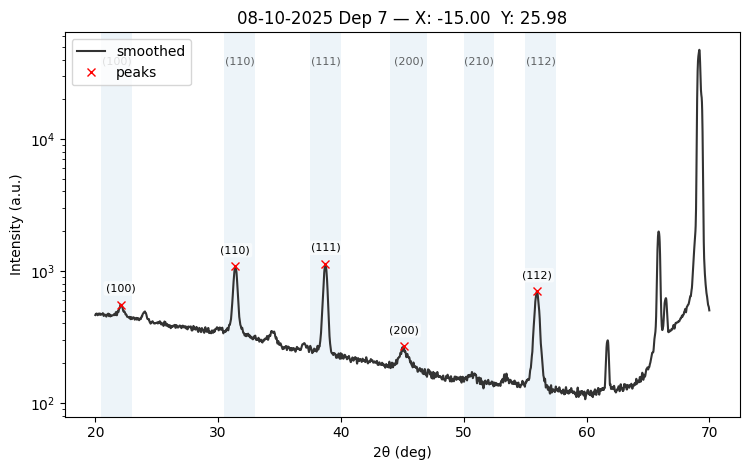


BTO_Mapping_Theta2Theta_08-10-2025_001_25_-20-000_34-641.xy  peaks: 5
  (100)    [R1]   22.120°   I≈582.5   FWHM≈1.0574°   Area≈75.17
  (110)    [R2]   31.430°   I≈1112.6   FWHM≈1.7671°   Area≈365.39
  (111)    [R3]   38.750°   I≈1107.2   FWHM≈1.4277°   Area≈353.46
  (200)    [R4]   45.150°   I≈294.8   FWHM≈1.5752°   Area≈86.37
  (112)    [R6]   56.000°   I≈690.4   FWHM≈1.7478°   Area≈287.58


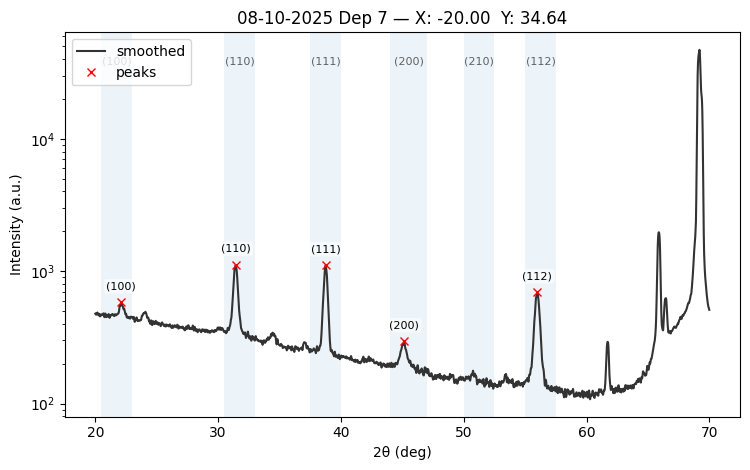


BTO_Mapping_Theta2Theta_08-10-2025_001_26_-8-090_5-878.xy  peaks: 6
  (100)    [R1]   22.070°   I≈540.1   FWHM≈1.1388°   Area≈74.08
  (110)    [R2]   31.380°   I≈1170.5   FWHM≈1.8142°   Area≈366.75
  (111)    [R3]   38.720°   I≈1217.5   FWHM≈1.4684°   Area≈412.70
  (200)    [R4]   45.100°   I≈260.0   FWHM≈1.4811°   Area≈99.50
  (210)    [R5]   50.640°   I≈178.3   FWHM≈1.1217°   Area≈24.29
  (112)    [R6]   55.940°   I≈715.1   FWHM≈1.8058°   Area≈327.26


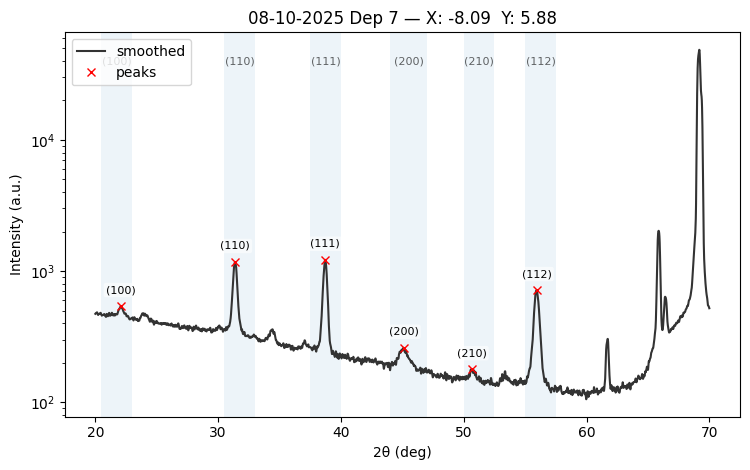


BTO_Mapping_Theta2Theta_08-10-2025_001_27_-16-180_11-756.xy  peaks: 6
  (100)    [R1]   22.070°   I≈548.6   FWHM≈1.1432°   Area≈58.26
  (110)    [R2]   31.370°   I≈1506.5   FWHM≈1.8071°   Area≈494.68
  (111)    [R3]   38.690°   I≈1157.1   FWHM≈1.4744°   Area≈398.15
  (200)    [R4]   45.070°   I≈270.4   FWHM≈1.3760°   Area≈94.86
  (210)    [R5]   50.690°   I≈193.5   FWHM≈1.2264°   Area≈51.06
  (112)    [R6]   55.900°   I≈696.2   FWHM≈1.8231°   Area≈317.30


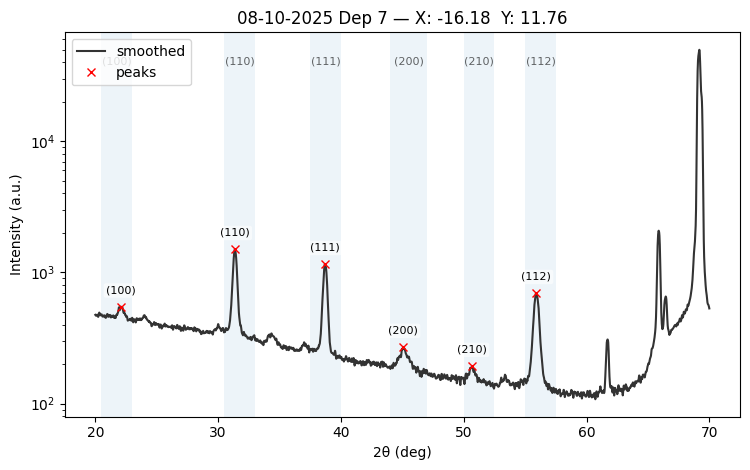


BTO_Mapping_Theta2Theta_08-10-2025_001_28_-24-271_17-634.xy  peaks: 6
  (100)    [R1]   22.040°   I≈565.8   FWHM≈1.1407°   Area≈77.98
  (110)    [R2]   31.370°   I≈1885.7   FWHM≈1.8005°   Area≈635.86
  (111)    [R3]   38.740°   I≈1047.6   FWHM≈1.4841°   Area≈350.62
  (200)    [R4]   45.060°   I≈282.3   FWHM≈1.5480°   Area≈98.70
  (210)    [R5]   50.600°   I≈201.2   FWHM≈1.2999°   Area≈48.80
  (112)    [R6]   55.900°   I≈699.5   FWHM≈1.8395°   Area≈317.22


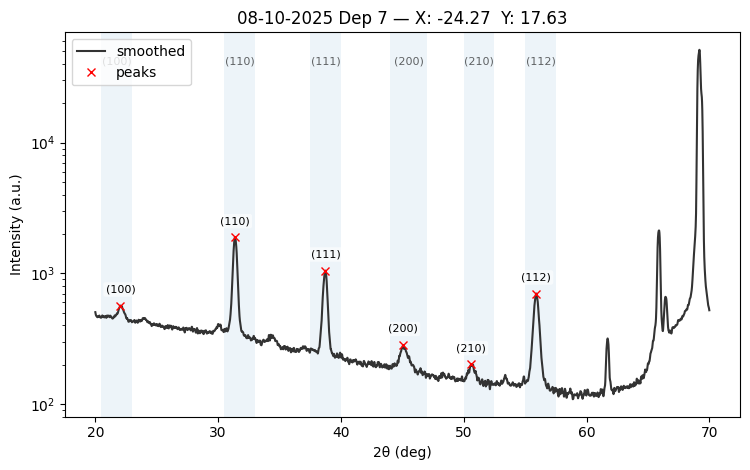


BTO_Mapping_Theta2Theta_08-10-2025_001_29_-32-361_23-511.xy  peaks: 6
  (100)    [R1]   22.090°   I≈599.7   FWHM≈1.1211°   Area≈92.79
  (110)    [R2]   31.380°   I≈2074.1   FWHM≈1.7959°   Area≈707.62
  (111)    [R3]   38.710°   I≈913.7   FWHM≈1.4774°   Area≈318.50
  (200)    [R4]   45.090°   I≈308.6   FWHM≈1.6888°   Area≈110.33
  (210)    [R5]   50.630°   I≈219.3   FWHM≈1.4163°   Area≈52.60
  (112)    [R6]   55.910°   I≈686.9   FWHM≈1.8488°   Area≈313.80


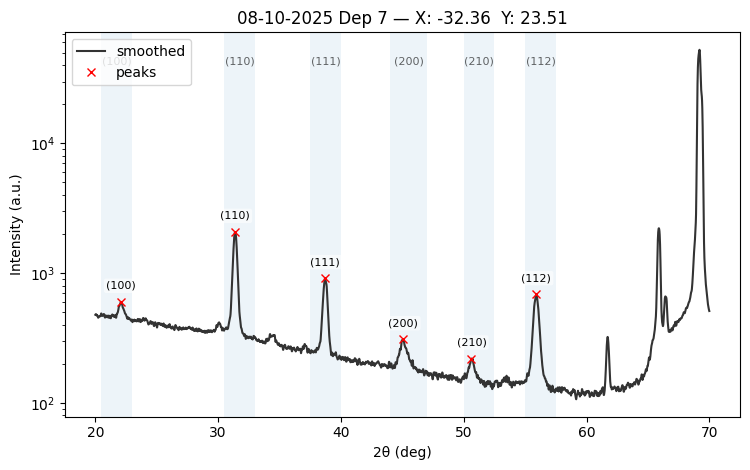


BTO_Mapping_Theta2Theta_08-10-2025_001_30_-9-781_2-079.xy  peaks: 6
  (100)    [R1]   22.020°   I≈543.1   FWHM≈1.1099°   Area≈75.53
  (110)    [R2]   31.370°   I≈1367.4   FWHM≈1.8199°   Area≈441.82
  (111)    [R3]   38.700°   I≈1205.3   FWHM≈1.4835°   Area≈426.55
  (200)    [R4]   45.030°   I≈271.5   FWHM≈1.5408°   Area≈101.95
  (210)    [R5]   50.750°   I≈189.2   FWHM≈1.1760°   Area≈30.29
  (112)    [R6]   55.890°   I≈713.9   FWHM≈1.8316°   Area≈321.85


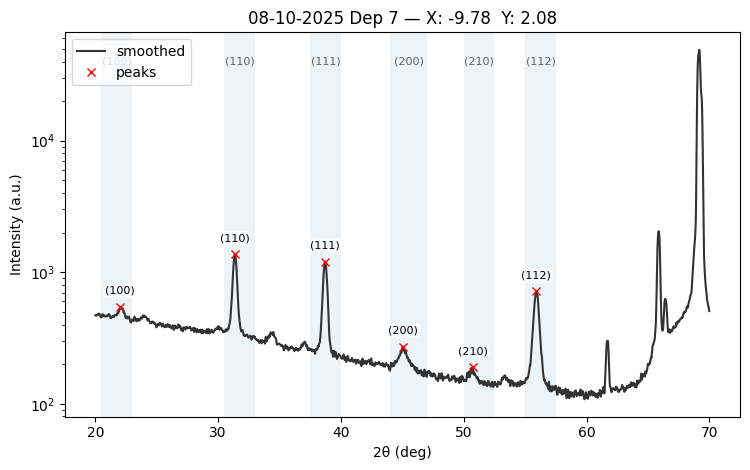


BTO_Mapping_Theta2Theta_08-10-2025_001_31_-19-563_4-158.xy  peaks: 6
  (100)    [R1]   22.150°   I≈590.5   FWHM≈1.1150°   Area≈98.97
  (110)    [R2]   31.370°   I≈2227.8   FWHM≈1.8213°   Area≈788.73
  (111)    [R3]   38.720°   I≈970.6   FWHM≈1.5140°   Area≈330.53
  (200)    [R4]   44.970°   I≈311.1   FWHM≈1.7415°   Area≈95.78
  (210)    [R5]   50.650°   I≈212.3   FWHM≈1.4126°   Area≈40.16
  (112)    [R6]   55.900°   I≈689.5   FWHM≈1.8788°   Area≈321.76


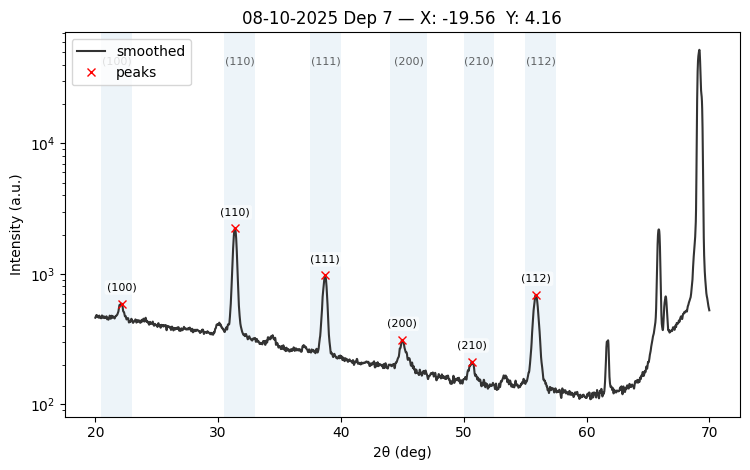


BTO_Mapping_Theta2Theta_08-10-2025_001_32_-29-344_6-237.xy  peaks: 6
  (100)    [R1]   22.040°   I≈710.4   FWHM≈1.1543°   Area≈125.08
  (110)    [R2]   31.360°   I≈2794.2   FWHM≈1.8192°   Area≈998.08
  (111)    [R3]   38.680°   I≈668.6   FWHM≈1.5250°   Area≈218.03
  (200)    [R4]   44.970°   I≈400.1   FWHM≈2.2399°   Area≈156.34
  (210)    [R5]   50.640°   I≈252.5   FWHM≈1.6453°   Area≈56.83
  (112)    [R6]   55.890°   I≈650.8   FWHM≈1.9160°   Area≈310.09


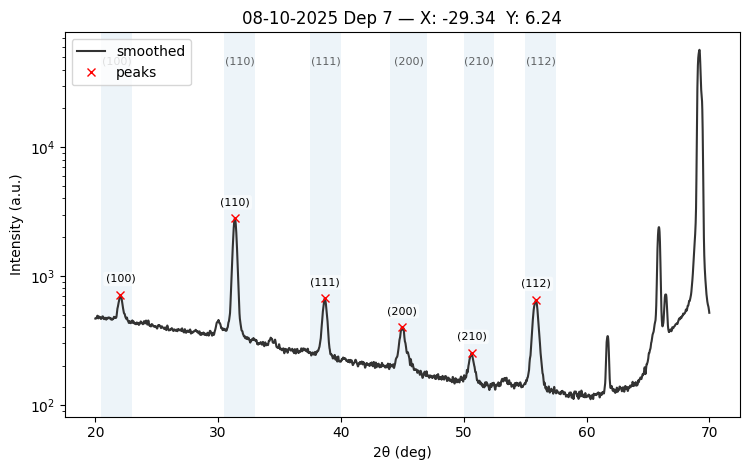


BTO_Mapping_Theta2Theta_08-10-2025_001_33_-39-126_8-316.xy  peaks: 6
  (100)    [R1]   22.040°   I≈825.5   FWHM≈1.1493°   Area≈205.17
  (110)    [R2]   31.360°   I≈3254.3   FWHM≈1.8238°   Area≈1211.62
  (111)    [R3]   38.730°   I≈517.3   FWHM≈1.5377°   Area≈156.76
  (200)    [R4]   44.900°   I≈496.2   FWHM≈2.2841°   Area≈202.85
  (210)    [R5]   50.670°   I≈268.5   FWHM≈1.7311°   Area≈73.09
  (112)    [R6]   55.870°   I≈598.7   FWHM≈1.9210°   Area≈288.02


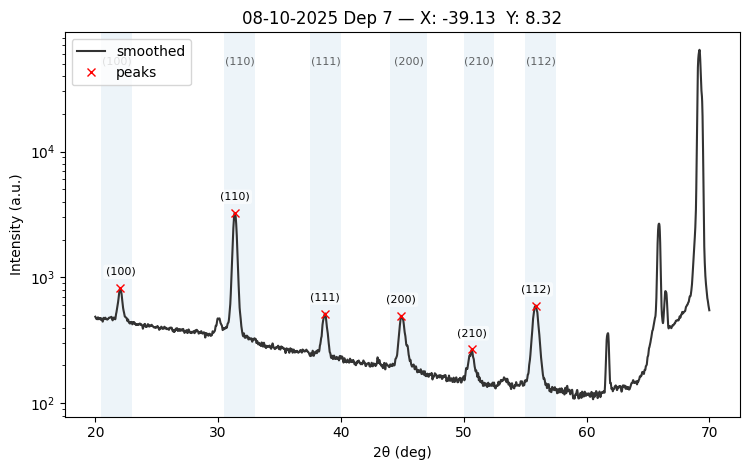


BTO_Mapping_Theta2Theta_08-10-2025_001_34_-9-781_-2-079.xy  peaks: 6
  (100)    [R1]   21.980°   I≈558.4   FWHM≈1.1528°   Area≈65.11
  (110)    [R2]   31.360°   I≈1480.5   FWHM≈1.8242°   Area≈491.48
  (111)    [R3]   38.700°   I≈1228.8   FWHM≈1.4828°   Area≈426.19
  (200)    [R4]   45.070°   I≈277.0   FWHM≈1.5253°   Area≈92.97
  (210)    [R5]   50.620°   I≈192.1   FWHM≈1.2995°   Area≈31.03
  (112)    [R6]   55.920°   I≈714.1   FWHM≈1.8379°   Area≈319.72


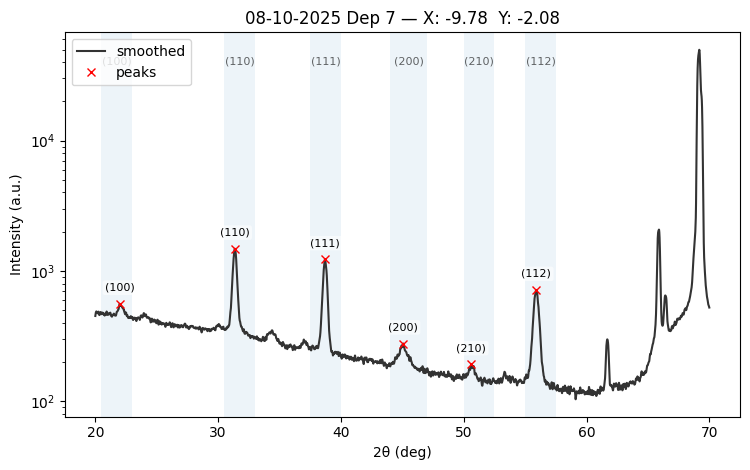


BTO_Mapping_Theta2Theta_08-10-2025_001_35_-19-563_-4-158.xy  peaks: 6
  (100)    [R1]   22.010°   I≈624.5   FWHM≈1.1404°   Area≈109.90
  (110)    [R2]   31.360°   I≈2539.9   FWHM≈1.8235°   Area≈876.47
  (111)    [R3]   38.690°   I≈852.0   FWHM≈1.5230°   Area≈292.03
  (200)    [R4]   44.950°   I≈340.4   FWHM≈1.9264°   Area≈116.13
  (210)    [R5]   50.620°   I≈228.7   FWHM≈1.5928°   Area≈50.28
  (112)    [R6]   55.860°   I≈693.5   FWHM≈1.8999°   Area≈323.92


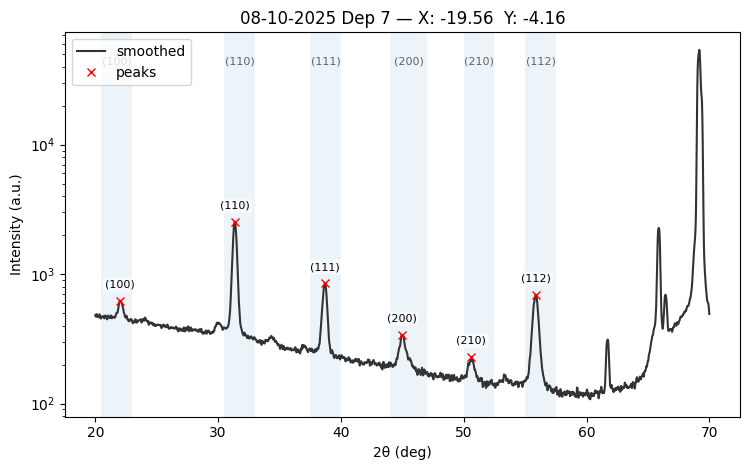


BTO_Mapping_Theta2Theta_08-10-2025_001_36_-29-344_-6-237.xy  peaks: 6
  (100)    [R1]   22.000°   I≈787.1   FWHM≈1.1730°   Area≈193.27
  (110)    [R2]   31.340°   I≈2907.8   FWHM≈1.8435°   Area≈1055.16
  (111)    [R3]   38.690°   I≈569.8   FWHM≈1.5488°   Area≈161.53
  (200)    [R4]   44.930°   I≈482.1   FWHM≈2.2918°   Area≈206.49
  (210)    [R5]   50.630°   I≈253.2   FWHM≈1.6807°   Area≈66.17
  (112)    [R6]   55.840°   I≈673.3   FWHM≈1.9483°   Area≈335.37


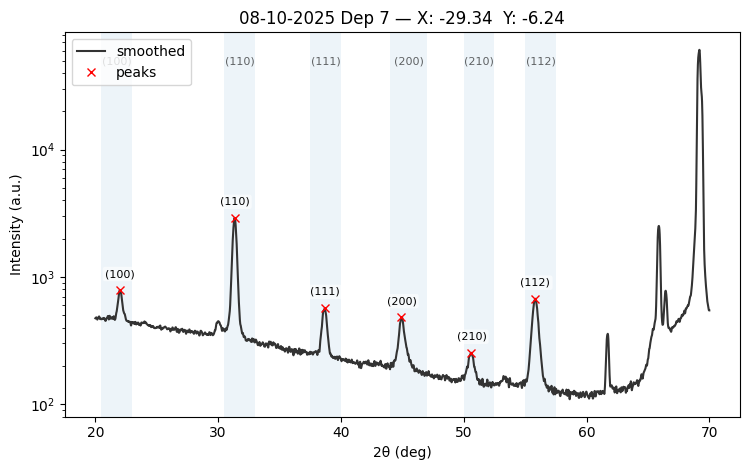


BTO_Mapping_Theta2Theta_08-10-2025_001_37_-39-126_-8-316.xy  peaks: 6
  (100)    [R1]   21.980°   I≈816.6   FWHM≈1.1932°   Area≈168.01
  (110)    [R2]   31.320°   I≈4323.7   FWHM≈1.8583°   Area≈1582.62
  (111)    [R3]   38.660°   I≈481.3   FWHM≈1.5698°   Area≈127.41
  (200)    [R4]   44.880°   I≈518.0   FWHM≈2.3590°   Area≈223.82
  (210)    [R5]   50.570°   I≈271.9   FWHM≈1.8603°   Area≈65.09
  (112)    [R6]   55.760°   I≈610.1   FWHM≈1.9831°   Area≈293.86


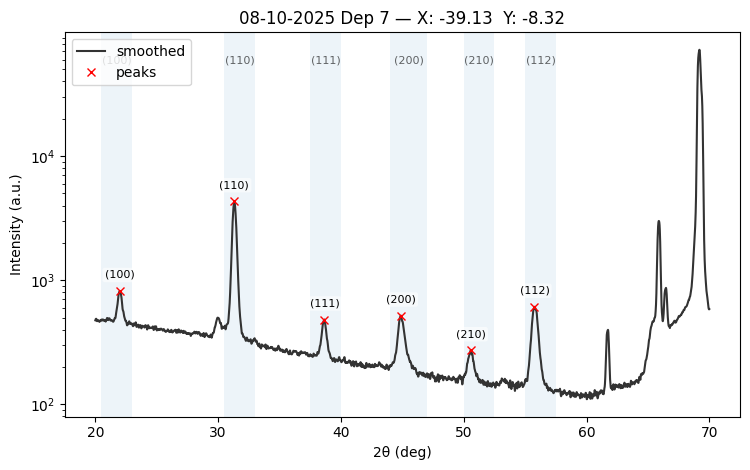


BTO_Mapping_Theta2Theta_08-10-2025_001_38_-8-090_-5-878.xy  peaks: 6
  (100)    [R1]   22.200°   I≈536.4   FWHM≈1.1977°   Area≈60.91
  (110)    [R2]   31.360°   I≈1403.8   FWHM≈1.8261°   Area≈467.09
  (111)    [R3]   38.690°   I≈1219.7   FWHM≈1.4839°   Area≈418.04
  (200)    [R4]   45.040°   I≈270.0   FWHM≈1.5362°   Area≈73.32
  (210)    [R5]   50.620°   I≈191.0   FWHM≈1.2838°   Area≈32.18
  (112)    [R6]   55.930°   I≈723.0   FWHM≈1.8349°   Area≈330.54


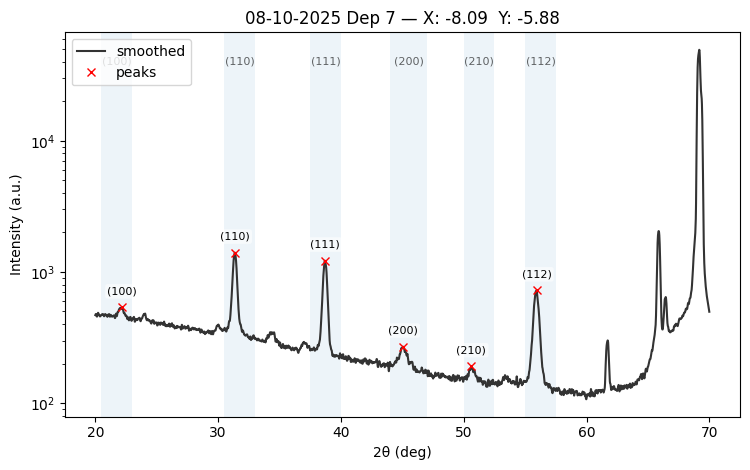


BTO_Mapping_Theta2Theta_08-10-2025_001_39_-16-180_-11-756.xy  peaks: 6
  (100)    [R1]   22.020°   I≈613.5   FWHM≈1.1379°   Area≈100.67
  (110)    [R2]   31.340°   I≈2410.4   FWHM≈1.8314°   Area≈848.32
  (111)    [R3]   38.690°   I≈941.9   FWHM≈1.5255°   Area≈342.56
  (200)    [R4]   45.060°   I≈333.9   FWHM≈1.8547°   Area≈126.83
  (210)    [R5]   50.560°   I≈227.1   FWHM≈1.5348°   Area≈48.45
  (112)    [R6]   55.880°   I≈689.0   FWHM≈1.9063°   Area≈323.73


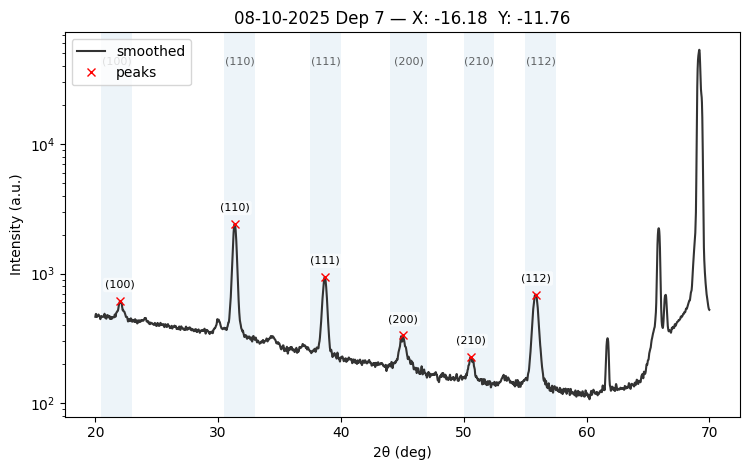


BTO_Mapping_Theta2Theta_08-10-2025_001_40_-24-271_-17-634.xy  peaks: 6
  (100)    [R1]   21.990°   I≈763.4   FWHM≈1.1748°   Area≈176.02
  (110)    [R2]   31.340°   I≈2779.7   FWHM≈1.8513°   Area≈1007.08
  (111)    [R3]   38.610°   I≈611.5   FWHM≈1.5562°   Area≈209.23
  (200)    [R4]   44.960°   I≈461.8   FWHM≈2.2936°   Area≈174.12
  (210)    [R5]   50.590°   I≈260.8   FWHM≈1.7361°   Area≈65.21
  (112)    [R6]   55.820°   I≈686.3   FWHM≈1.9566°   Area≈337.13


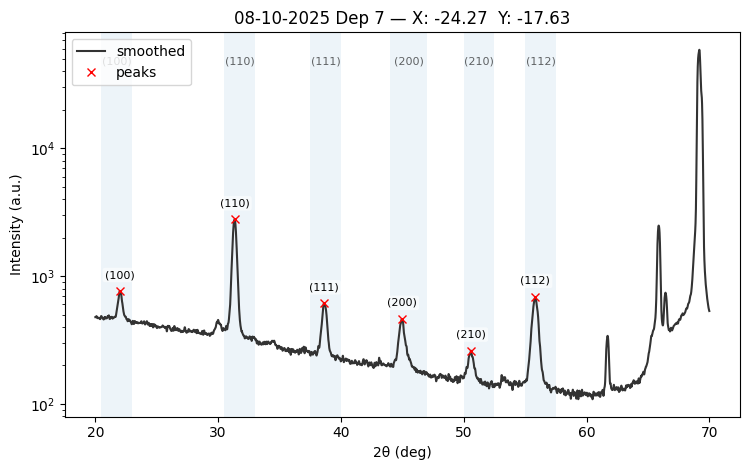


BTO_Mapping_Theta2Theta_08-10-2025_001_41_-32-361_-23-511.xy  peaks: 6
  (100)    [R1]   22.020°   I≈830.9   FWHM≈1.2047°   Area≈184.74
  (110)    [R2]   31.320°   I≈3835.5   FWHM≈1.8619°   Area≈1424.57
  (111)    [R3]   38.640°   I≈486.0   FWHM≈1.5756°   Area≈127.85
  (200)    [R4]   44.900°   I≈528.5   FWHM≈2.3725°   Area≈236.02
  (210)    [R5]   50.530°   I≈285.7   FWHM≈1.9435°   Area≈76.74
  (112)    [R6]   55.770°   I≈648.8   FWHM≈1.9968°   Area≈322.84


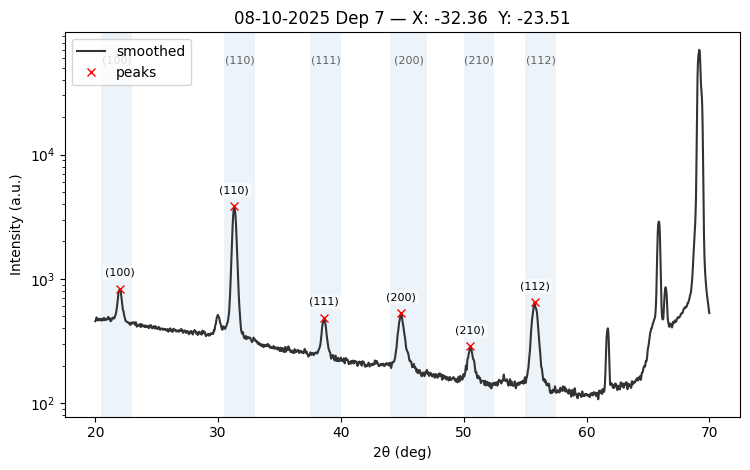


BTO_Mapping_Theta2Theta_08-10-2025_001_42_-5-000_-8-660.xy  peaks: 6
  (100)    [R1]   22.050°   I≈544.1   FWHM≈1.1652°   Area≈64.11
  (110)    [R2]   31.360°   I≈1217.8   FWHM≈1.8270°   Area≈396.19
  (111)    [R3]   38.720°   I≈1239.3   FWHM≈1.4815°   Area≈431.96
  (200)    [R4]   45.020°   I≈267.1   FWHM≈1.6092°   Area≈69.58
  (210)    [R5]   50.770°   I≈183.0   FWHM≈1.1085°   Area≈22.38
  (112)    [R6]   55.930°   I≈731.7   FWHM≈1.8290°   Area≈328.09


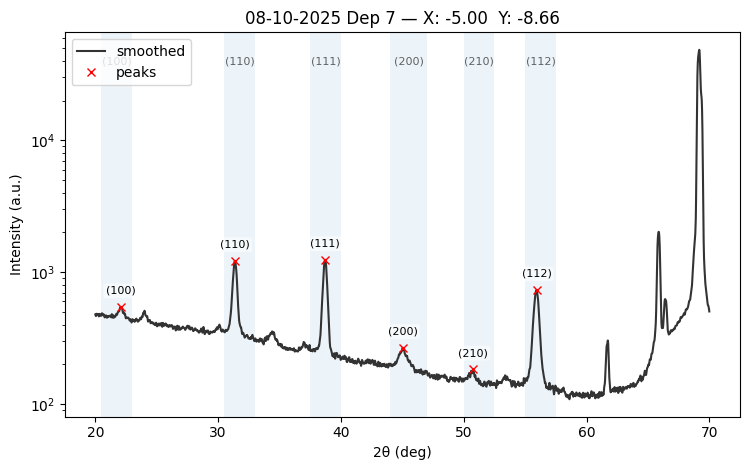


BTO_Mapping_Theta2Theta_08-10-2025_001_43_-10-000_-17-321.xy  peaks: 6
  (100)    [R1]   22.080°   I≈579.7   FWHM≈1.1413°   Area≈65.00
  (110)    [R2]   31.370°   I≈1765.4   FWHM≈1.8347°   Area≈596.18
  (111)    [R3]   38.710°   I≈1183.5   FWHM≈1.5089°   Area≈416.70
  (200)    [R4]   45.030°   I≈295.8   FWHM≈1.6234°   Area≈91.05
  (210)    [R5]   50.630°   I≈206.3   FWHM≈1.3969°   Area≈41.23
  (112)    [R6]   55.850°   I≈719.3   FWHM≈1.8757°   Area≈337.14


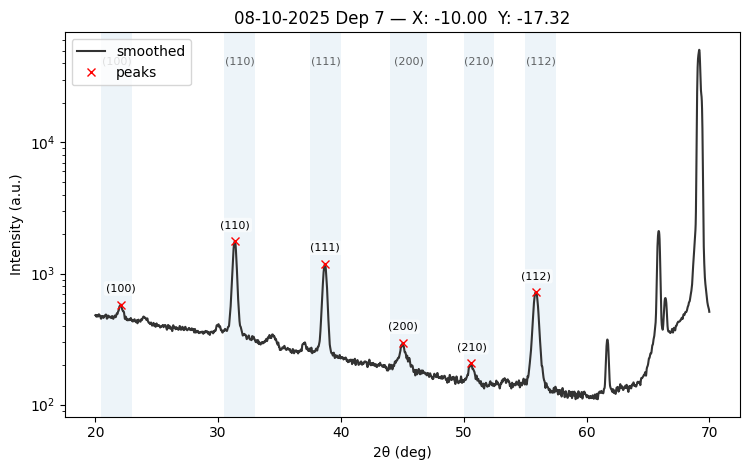


BTO_Mapping_Theta2Theta_08-10-2025_001_44_-15-000_-25-981.xy  peaks: 6
  (100)    [R1]   22.020°   I≈620.1   FWHM≈1.1567°   Area≈114.33
  (110)    [R2]   31.340°   I≈2407.4   FWHM≈1.8416°   Area≈845.52
  (111)    [R3]   38.680°   I≈936.6   FWHM≈1.5517°   Area≈350.84
  (200)    [R4]   44.990°   I≈340.6   FWHM≈1.9056°   Area≈115.36
  (210)    [R5]   50.620°   I≈227.3   FWHM≈1.6173°   Area≈54.61
  (112)    [R6]   55.800°   I≈711.6   FWHM≈1.9234°   Area≈338.82


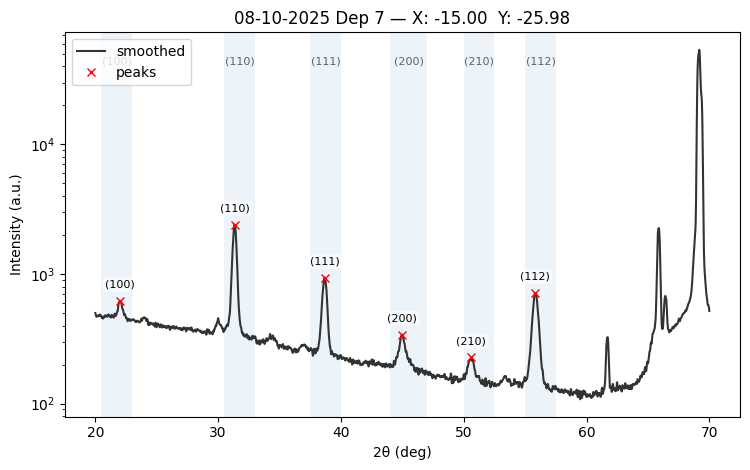


BTO_Mapping_Theta2Theta_08-10-2025_001_45_-20-000_-34-641.xy  peaks: 6
  (100)    [R1]   22.000°   I≈722.3   FWHM≈1.1826°   Area≈133.70
  (110)    [R2]   31.330°   I≈2692.6   FWHM≈1.8536°   Area≈991.37
  (111)    [R3]   38.660°   I≈712.9   FWHM≈1.5484°   Area≈232.59
  (200)    [R4]   44.920°   I≈420.4   FWHM≈2.2881°   Area≈168.22
  (210)    [R5]   50.490°   I≈253.1   FWHM≈1.7609°   Area≈55.37
  (112)    [R6]   55.770°   I≈678.2   FWHM≈1.9633°   Area≈338.10


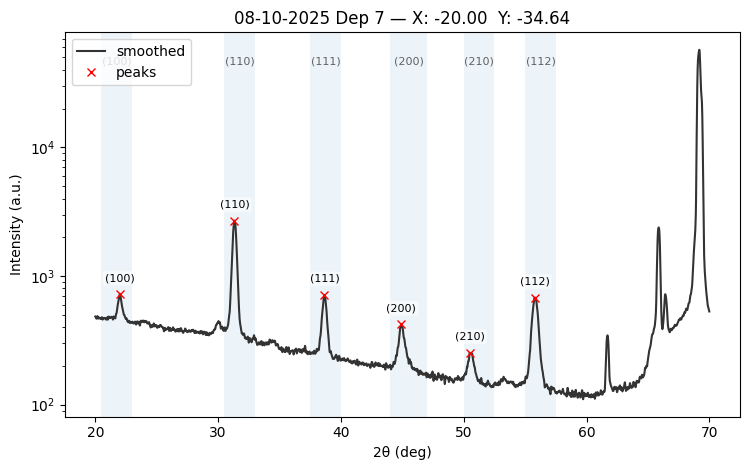


BTO_Mapping_Theta2Theta_08-10-2025_001_46_-1-045_-9-945.xy  peaks: 5
  (100)    [R1]   22.140°   I≈546.4   FWHM≈1.1288°   Area≈67.89
  (110)    [R2]   31.370°   I≈1104.2   FWHM≈1.8162°   Area≈339.79
  (111)    [R3]   38.720°   I≈1243.1   FWHM≈1.4703°   Area≈429.21
  (200)    [R4]   44.980°   I≈274.5   FWHM≈1.5219°   Area≈79.88
  (112)    [R6]   55.930°   I≈732.7   FWHM≈1.8200°   Area≈334.41


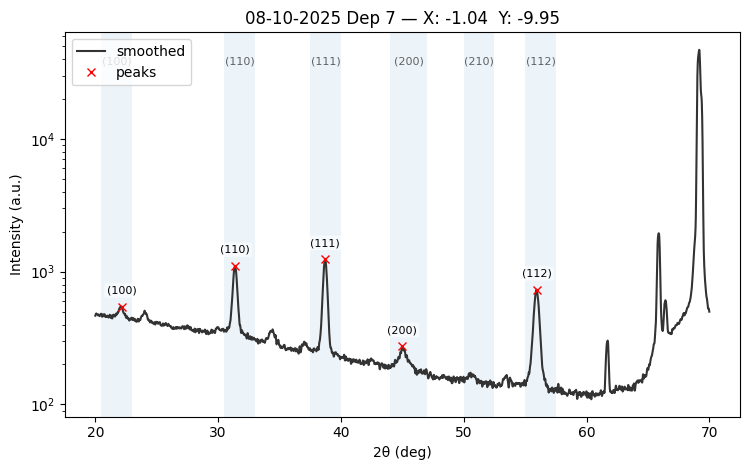


BTO_Mapping_Theta2Theta_08-10-2025_001_47_-2-091_-19-890.xy  peaks: 5
  (100)    [R1]   22.030°   I≈563.2   FWHM≈1.0824°   Area≈97.05
  (110)    [R2]   31.350°   I≈1151.2   FWHM≈1.8256°   Area≈368.33
  (111)    [R3]   38.700°   I≈1257.8   FWHM≈1.4857°   Area≈446.79
  (200)    [R4]   45.070°   I≈272.7   FWHM≈1.5676°   Area≈75.38
  (112)    [R6]   55.930°   I≈764.9   FWHM≈1.8334°   Area≈341.61


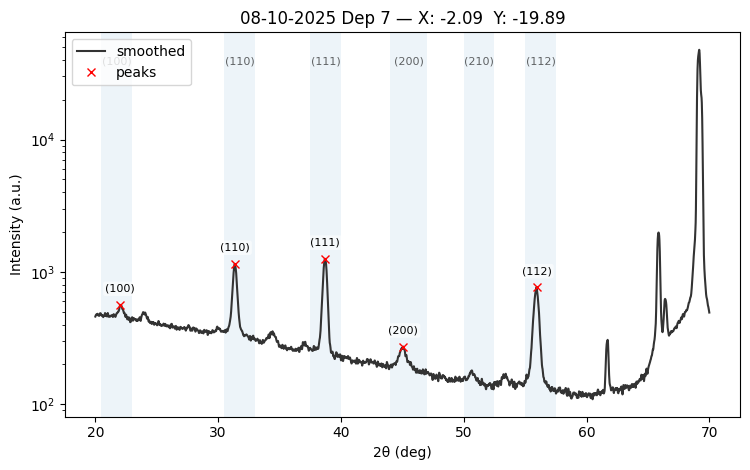


BTO_Mapping_Theta2Theta_08-10-2025_001_48_-3-136_-29-836.xy  peaks: 6
  (100)    [R1]   22.050°   I≈569.4   FWHM≈1.1252°   Area≈70.79
  (110)    [R2]   31.360°   I≈1226.6   FWHM≈1.8376°   Area≈392.67
  (111)    [R3]   38.710°   I≈1285.8   FWHM≈1.5019°   Area≈463.50
  (200)    [R4]   45.050°   I≈283.8   FWHM≈1.7119°   Area≈86.95
  (210)    [R5]   50.590°   I≈187.4   FWHM≈1.2957°   Area≈28.80
  (112)    [R6]   55.890°   I≈759.9   FWHM≈1.8631°   Area≈351.66


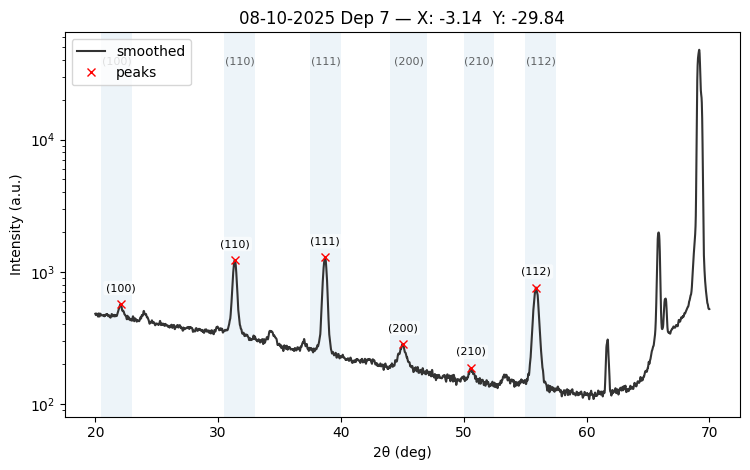


BTO_Mapping_Theta2Theta_08-10-2025_001_49_-4-181_-39-781.xy  peaks: 6
  (100)    [R1]   22.040°   I≈585.3   FWHM≈1.1551°   Area≈87.34
  (110)    [R2]   31.370°   I≈1371.3   FWHM≈1.8350°   Area≈435.99
  (111)    [R3]   38.700°   I≈1254.2   FWHM≈1.5035°   Area≈450.28
  (200)    [R4]   45.050°   I≈294.7   FWHM≈1.6390°   Area≈95.62
  (210)    [R5]   50.650°   I≈191.6   FWHM≈1.3047°   Area≈26.17
  (112)    [R6]   55.870°   I≈790.3   FWHM≈1.8538°   Area≈357.67


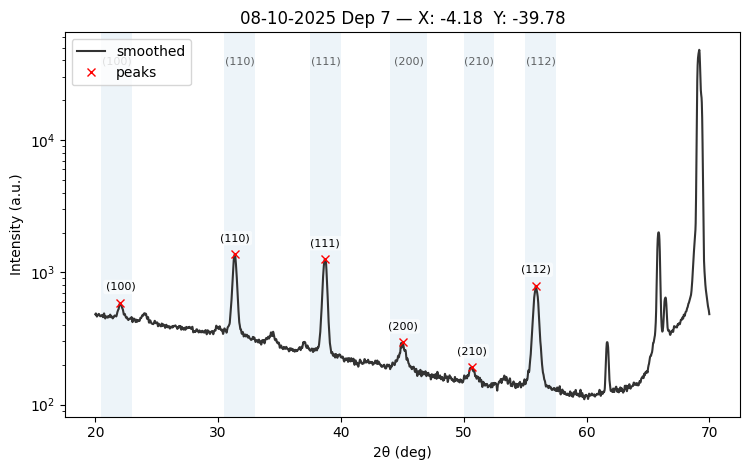


BTO_Mapping_Theta2Theta_08-10-2025_001_50_3-090_-9-511.xy  peaks: 5
  (100)    [R1]   22.080°   I≈556.7   FWHM≈1.0856°   Area≈70.52
  (110)    [R2]   31.380°   I≈1129.6   FWHM≈1.8083°   Area≈383.08
  (111)    [R3]   38.720°   I≈1187.6   FWHM≈1.4654°   Area≈405.54
  (200)    [R4]   45.060°   I≈275.1   FWHM≈1.5634°   Area≈85.99
  (112)    [R6]   55.930°   I≈693.1   FWHM≈1.8019°   Area≈316.89


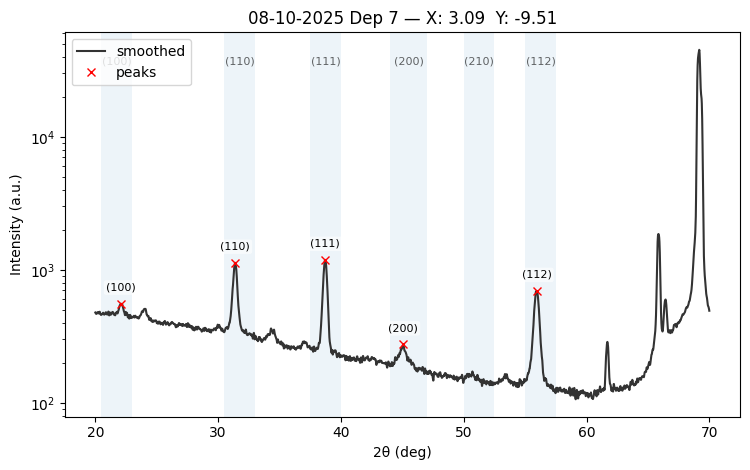


BTO_Mapping_Theta2Theta_08-10-2025_001_51_6-180_-19-021.xy  peaks: 5
  (100)    [R1]   22.060°   I≈565.3   FWHM≈1.1492°   Area≈71.60
  (110)    [R2]   31.370°   I≈1166.4   FWHM≈1.8147°   Area≈372.40
  (111)    [R3]   38.740°   I≈1195.6   FWHM≈1.4761°   Area≈399.46
  (200)    [R4]   45.020°   I≈282.0   FWHM≈1.5568°   Area≈92.05
  (112)    [R6]   55.970°   I≈692.4   FWHM≈1.8097°   Area≈306.19


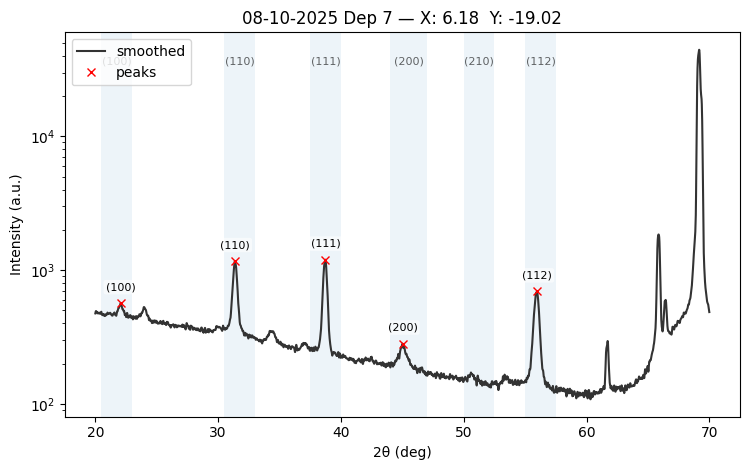


BTO_Mapping_Theta2Theta_08-10-2025_001_52_9-271_-28-532.xy  peaks: 5
  (100)    [R1]   22.050°   I≈545.1   FWHM≈1.2567°   Area≈74.70
  (110)    [R2]   31.400°   I≈1246.6   FWHM≈1.8144°   Area≈413.15
  (111)    [R3]   38.730°   I≈1138.5   FWHM≈1.4764°   Area≈366.33
  (200)    [R4]   45.020°   I≈279.9   FWHM≈1.5963°   Area≈89.32
  (112)    [R6]   55.930°   I≈690.4   FWHM≈1.8005°   Area≈296.67


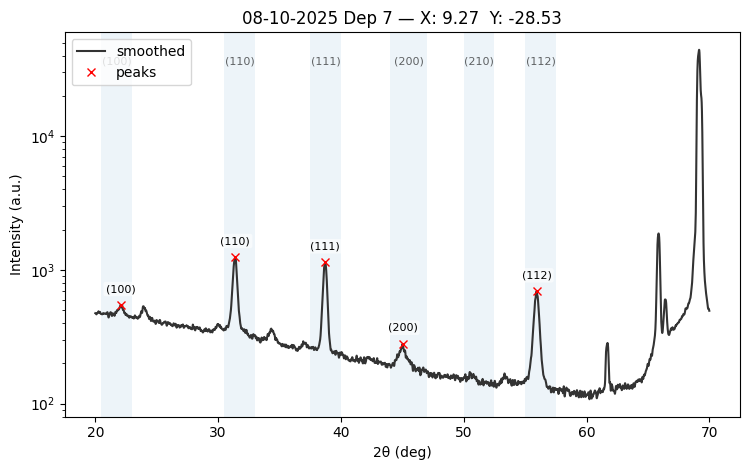


BTO_Mapping_Theta2Theta_08-10-2025_001_53_12-361_-38-042.xy  peaks: 4
  (110)    [R2]   31.380°   I≈1336.4   FWHM≈1.8268°   Area≈442.96
  (111)    [R3]   38.710°   I≈1069.8   FWHM≈1.4762°   Area≈346.08
  (200)    [R4]   45.120°   I≈259.9   FWHM≈1.4292°   Area≈71.30
  (112)    [R6]   55.950°   I≈632.9   FWHM≈1.7978°   Area≈278.64


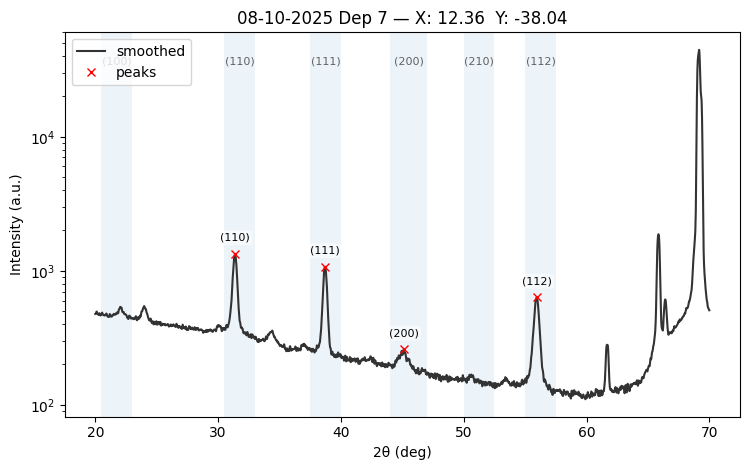


BTO_Mapping_Theta2Theta_08-10-2025_001_54_6-691_-7-431.xy  peaks: 5
  (100)    [R1]   22.000°   I≈541.4   FWHM≈1.2091°   Area≈68.52
  (110)    [R2]   31.370°   I≈1210.2   FWHM≈1.8052°   Area≈397.38
  (111)    [R3]   38.730°   I≈1126.5   FWHM≈1.4624°   Area≈354.31
  (200)    [R4]   45.070°   I≈263.9   FWHM≈1.4734°   Area≈77.92
  (112)    [R6]   55.980°   I≈638.6   FWHM≈1.7991°   Area≈273.95


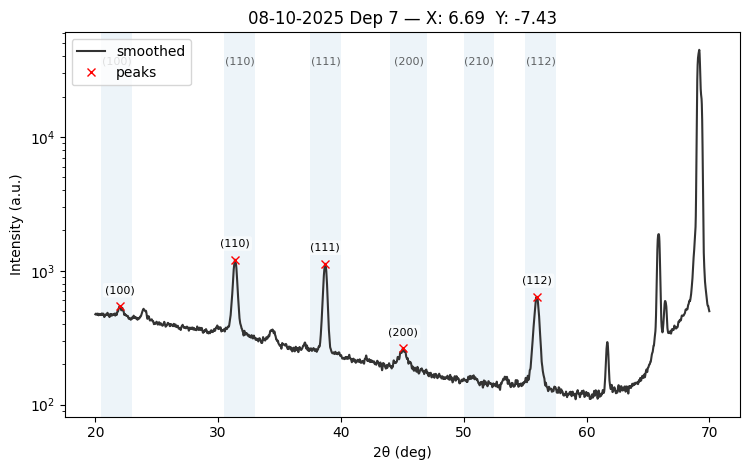


BTO_Mapping_Theta2Theta_08-10-2025_001_55_13-383_-14-863.xy  peaks: 4
  (110)    [R2]   31.370°   I≈1236.6   FWHM≈1.8188°   Area≈428.42
  (111)    [R3]   38.720°   I≈1015.8   FWHM≈1.4774°   Area≈330.95
  (200)    [R4]   45.120°   I≈251.8   FWHM≈1.6148°   Area≈70.95
  (112)    [R6]   55.910°   I≈571.5   FWHM≈1.8092°   Area≈262.02


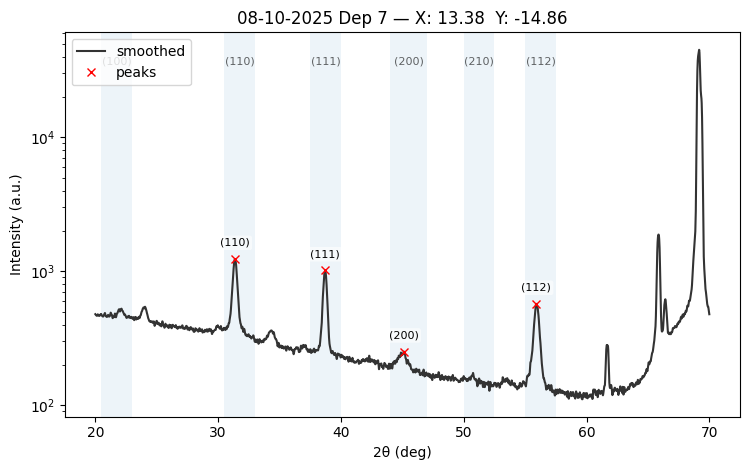


BTO_Mapping_Theta2Theta_08-10-2025_001_56_20-074_-22-294.xy  peaks: 4
  (110)    [R2]   31.370°   I≈1138.0   FWHM≈1.8425°   Area≈381.19
  (111)    [R3]   38.700°   I≈929.1   FWHM≈1.4835°   Area≈300.77
  (200)    [R4]   44.840°   I≈249.1   FWHM≈1.5802°   Area≈56.42
  (112)    [R6]   55.940°   I≈493.8   FWHM≈1.8392°   Area≈215.87


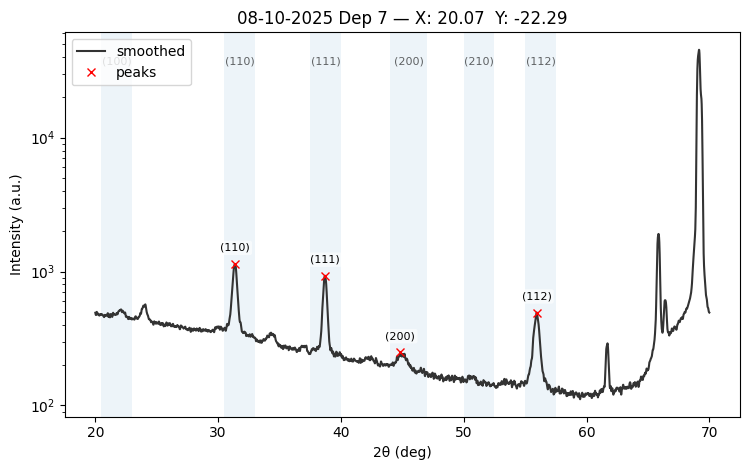


BTO_Mapping_Theta2Theta_08-10-2025_001_57_26-765_-29-726.xy  peaks: 4
  (110)    [R2]   31.370°   I≈1121.9   FWHM≈1.8424°   Area≈366.39
  (111)    [R3]   38.700°   I≈851.2   FWHM≈1.4904°   Area≈274.14
  (200)    [R4]   45.060°   I≈251.1   FWHM≈1.6529°   Area≈77.31
  (112)    [R6]   55.910°   I≈417.3   FWHM≈1.8201°   Area≈173.10


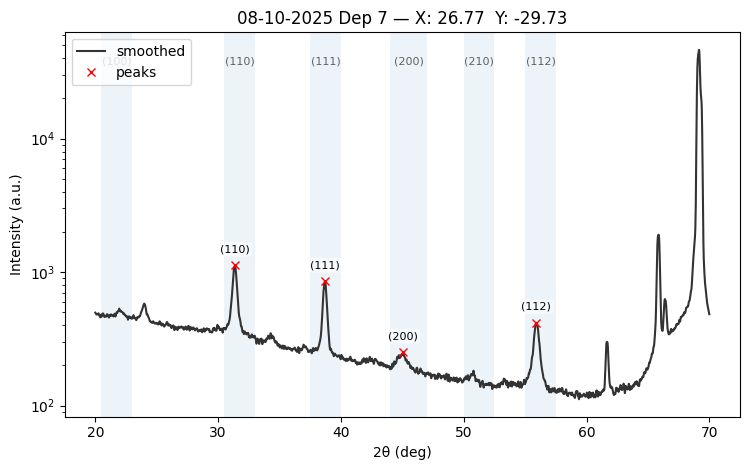


BTO_Mapping_Theta2Theta_08-10-2025_001_58_9-135_-4-067.xy  peaks: 6
  (100)    [R1]   22.040°   I≈537.8   FWHM≈1.1835°   Area≈65.01
  (110)    [R2]   31.390°   I≈1233.9   FWHM≈1.8123°   Area≈417.22
  (111)    [R3]   38.720°   I≈1060.5   FWHM≈1.4574°   Area≈339.78
  (200)    [R4]   45.040°   I≈252.6   FWHM≈1.5823°   Area≈74.48
  (210)    [R5]   50.700°   I≈175.6   FWHM≈0.9732°   Area≈17.91
  (112)    [R6]   55.940°   I≈594.8   FWHM≈1.7988°   Area≈263.62


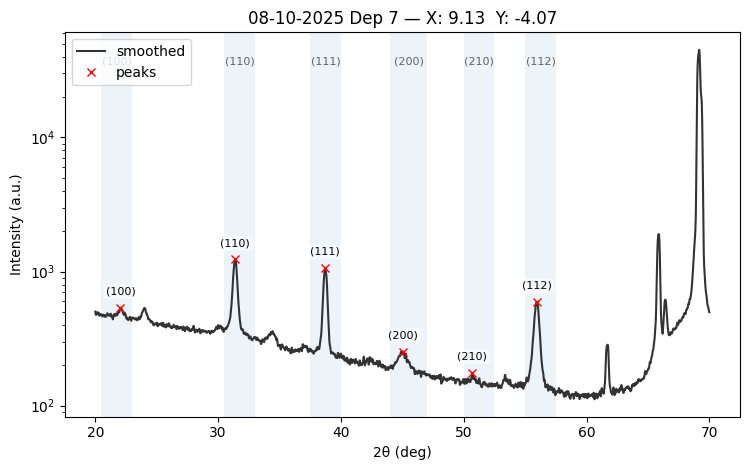


BTO_Mapping_Theta2Theta_08-10-2025_001_59_18-271_-8-135.xy  peaks: 4
  (110)    [R2]   31.380°   I≈1116.6   FWHM≈1.8370°   Area≈382.25
  (111)    [R3]   38.700°   I≈908.2   FWHM≈1.4677°   Area≈280.07
  (200)    [R4]   45.110°   I≈244.0   FWHM≈1.5545°   Area≈70.62
  (112)    [R6]   55.930°   I≈474.6   FWHM≈1.8191°   Area≈206.71


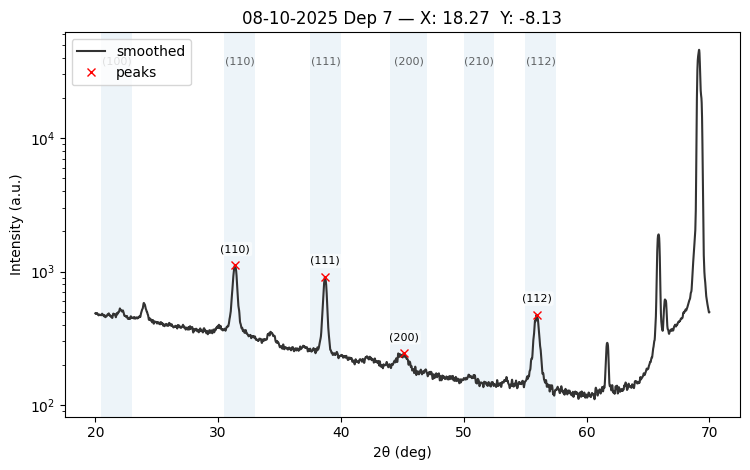


BTO_Mapping_Theta2Theta_08-10-2025_001_60_27-406_-12-202.xy  peaks: 4
  (110)    [R2]   31.370°   I≈1035.2   FWHM≈1.8549°   Area≈338.10
  (111)    [R3]   38.700°   I≈805.2   FWHM≈1.4886°   Area≈256.41
  (200)    [R4]   45.170°   I≈247.7   FWHM≈1.5318°   Area≈64.77
  (112)    [R6]   55.840°   I≈361.7   FWHM≈1.8676°   Area≈154.30


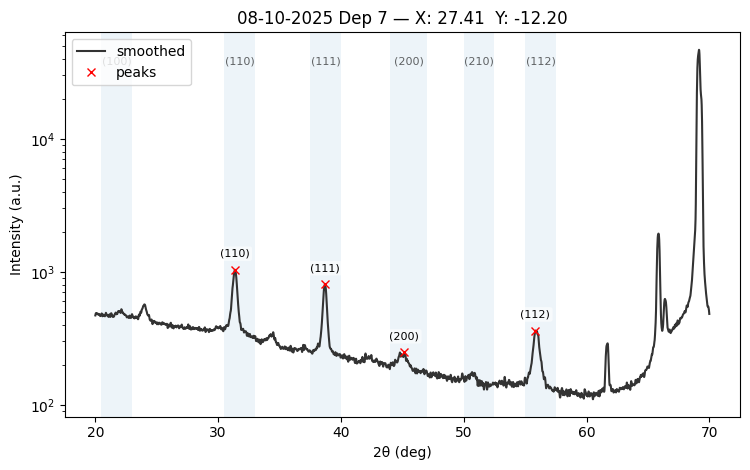


BTO_Mapping_Theta2Theta_08-10-2025_001_61_36-542_-16-269.xy  peaks: 5
  (110)    [R2]   31.330°   I≈1043.9   FWHM≈1.8554°   Area≈363.05
  (111)    [R3]   38.670°   I≈679.2   FWHM≈1.5039°   Area≈210.82
  (200)    [R4]   44.940°   I≈240.1   FWHM≈1.5152°   Area≈70.37
  (210)    [R5]   50.640°   I≈186.4   FWHM≈1.1190°   Area≈21.89
  (112)    [R6]   55.990°   I≈299.2   FWHM≈1.5926°   Area≈119.86


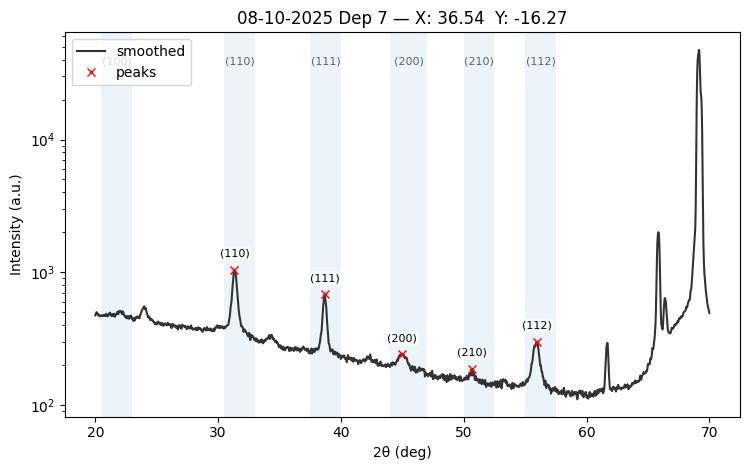


Individual plots for: 09-10-2025 Dep 8

BTO_Mapping_Theta2Theta_09-10-2025_001_01_0-000_0-000.xy  peaks: 6
  (100)    [R1]   22.040°   I≈656.3   FWHM≈1.0743°   Area≈145.09
  (110)    [R2]   31.400°   I≈3249.6   FWHM≈1.7654°   Area≈1118.90
  (111)    [R3]   38.740°   I≈1085.6   FWHM≈1.4397°   Area≈339.59
  (200)    [R4]   45.180°   I≈345.1   FWHM≈1.7383°   Area≈133.08
  (210)    [R5]   50.720°   I≈237.3   FWHM≈1.4305°   Area≈61.14
  (112)    [R6]   56.010°   I≈561.4   FWHM≈1.7314°   Area≈241.92


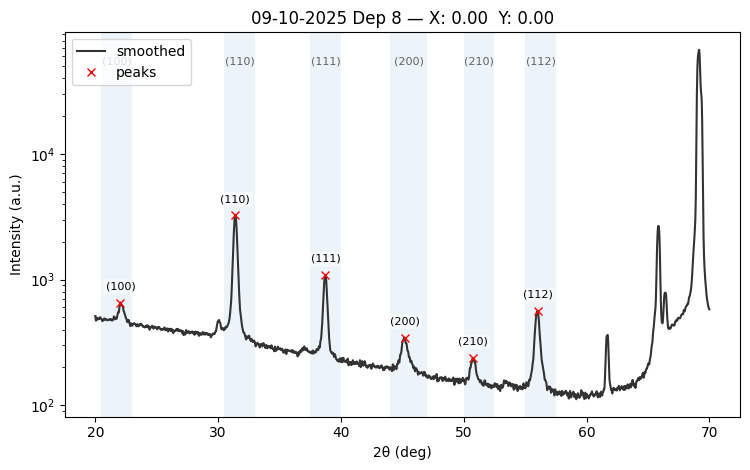


BTO_Mapping_Theta2Theta_09-10-2025_001_02_10-000_0-000.xy  peaks: 6
  (100)    [R1]   22.090°   I≈632.9   FWHM≈1.0847°   Area≈117.78
  (110)    [R2]   31.410°   I≈3104.7   FWHM≈1.7567°   Area≈1093.99
  (111)    [R3]   38.750°   I≈1089.7   FWHM≈1.4165°   Area≈335.69
  (200)    [R4]   45.260°   I≈303.7   FWHM≈1.5425°   Area≈117.05
  (210)    [R5]   50.760°   I≈239.8   FWHM≈1.3509°   Area≈63.91
  (112)    [R6]   56.020°   I≈556.5   FWHM≈1.7005°   Area≈226.07


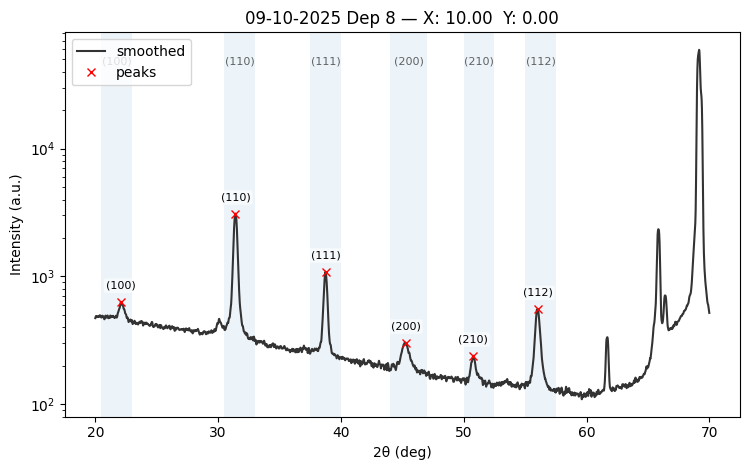


BTO_Mapping_Theta2Theta_09-10-2025_001_03_20-000_0-000.xy  peaks: 6
  (100)    [R1]   22.080°   I≈597.6   FWHM≈1.1424°   Area≈118.14
  (110)    [R2]   31.420°   I≈2713.2   FWHM≈1.7408°   Area≈928.33
  (111)    [R3]   38.760°   I≈1022.9   FWHM≈1.3991°   Area≈320.91
  (200)    [R4]   45.220°   I≈281.9   FWHM≈1.4292°   Area≈100.70
  (210)    [R5]   50.740°   I≈241.7   FWHM≈1.3212°   Area≈61.13
  (112)    [R6]   56.060°   I≈560.3   FWHM≈1.6743°   Area≈219.64


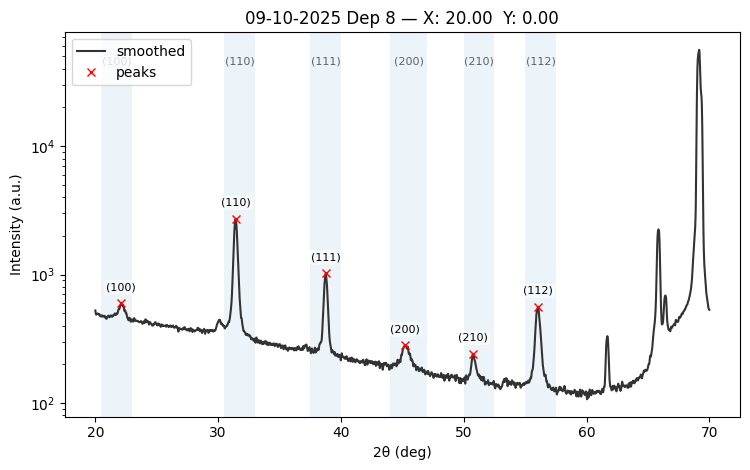


BTO_Mapping_Theta2Theta_09-10-2025_001_04_30-000_0-000.xy  peaks: 6
  (100)    [R1]   22.140°   I≈600.2   FWHM≈1.0490°   Area≈84.63
  (110)    [R2]   31.430°   I≈2086.3   FWHM≈1.7337°   Area≈715.70
  (111)    [R3]   38.780°   I≈973.1   FWHM≈1.3871°   Area≈289.02
  (200)    [R4]   45.190°   I≈277.1   FWHM≈1.4329°   Area≈100.18
  (210)    [R5]   50.850°   I≈219.4   FWHM≈1.2155°   Area≈41.36
  (112)    [R6]   56.040°   I≈589.2   FWHM≈1.6460°   Area≈237.16


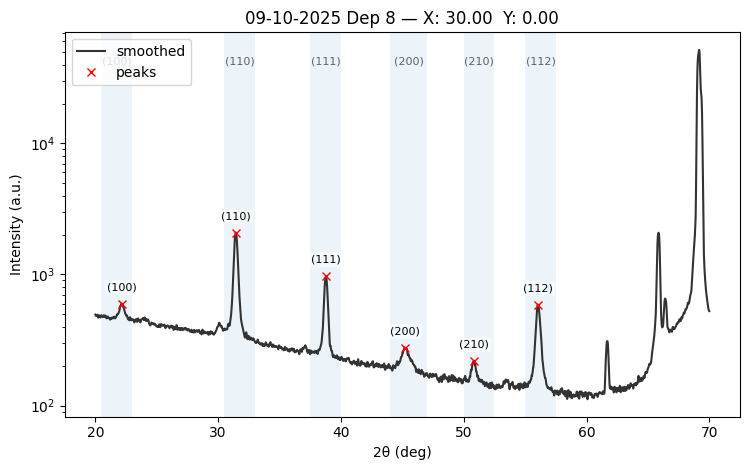


BTO_Mapping_Theta2Theta_09-10-2025_001_05_40-000_0-000.xy  peaks: 6
  (100)    [R1]   22.110°   I≈580.9   FWHM≈1.1203°   Area≈84.17
  (110)    [R2]   31.430°   I≈1678.9   FWHM≈1.7293°   Area≈591.62
  (111)    [R3]   38.800°   I≈941.0   FWHM≈1.3692°   Area≈278.38
  (200)    [R4]   45.220°   I≈265.1   FWHM≈1.3929°   Area≈94.37
  (210)    [R5]   50.830°   I≈198.2   FWHM≈1.1370°   Area≈41.45
  (112)    [R6]   56.100°   I≈586.7   FWHM≈1.6348°   Area≈238.81


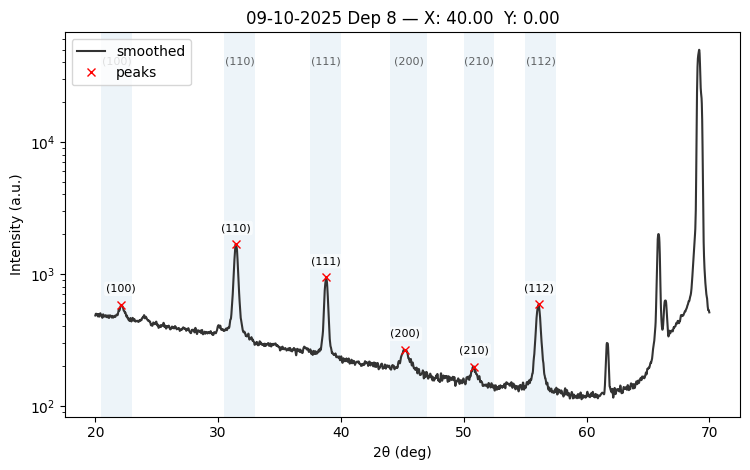


BTO_Mapping_Theta2Theta_09-10-2025_001_06_9-135_4-067.xy  peaks: 6
  (100)    [R1]   22.110°   I≈627.1   FWHM≈1.0675°   Area≈113.72
  (110)    [R2]   31.410°   I≈3157.1   FWHM≈1.7519°   Area≈1086.38
  (111)    [R3]   38.750°   I≈1053.4   FWHM≈1.4196°   Area≈323.85
  (200)    [R4]   45.170°   I≈301.1   FWHM≈1.5516°   Area≈109.61
  (210)    [R5]   50.760°   I≈241.8   FWHM≈1.3459°   Area≈56.79
  (112)    [R6]   56.020°   I≈551.5   FWHM≈1.6846°   Area≈217.51


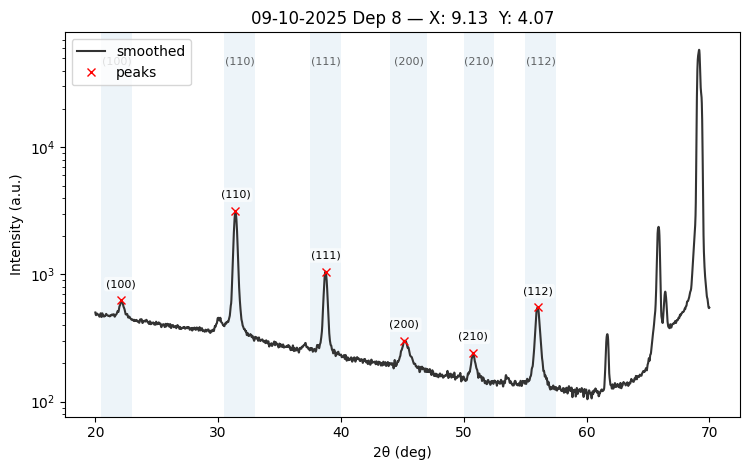


BTO_Mapping_Theta2Theta_09-10-2025_001_07_18-271_8-135.xy  peaks: 6
  (100)    [R1]   22.140°   I≈592.1   FWHM≈1.0656°   Area≈81.88
  (110)    [R2]   31.430°   I≈2647.2   FWHM≈1.7424°   Area≈902.53
  (111)    [R3]   38.770°   I≈975.4   FWHM≈1.3996°   Area≈287.78
  (200)    [R4]   45.240°   I≈295.7   FWHM≈1.4377°   Area≈91.14
  (210)    [R5]   50.740°   I≈228.3   FWHM≈1.3083°   Area≈58.54
  (112)    [R6]   55.980°   I≈546.9   FWHM≈1.6745°   Area≈222.69


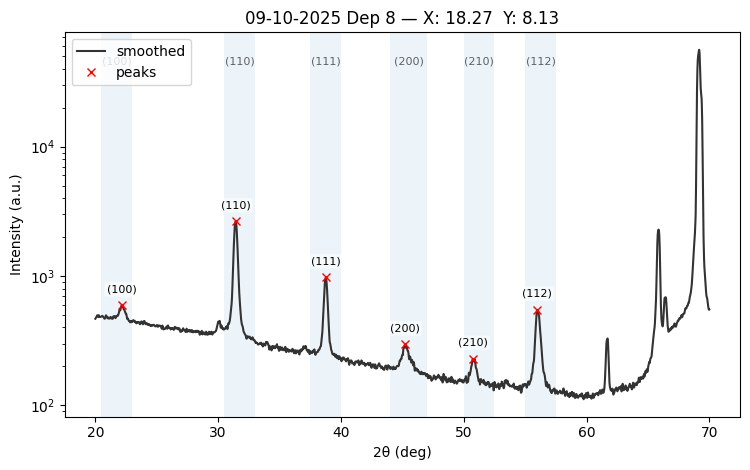


BTO_Mapping_Theta2Theta_09-10-2025_001_08_27-406_12-202.xy  peaks: 6
  (100)    [R1]   22.160°   I≈600.9   FWHM≈1.0490°   Area≈83.30
  (110)    [R2]   31.430°   I≈2018.5   FWHM≈1.7324°   Area≈724.46
  (111)    [R3]   38.790°   I≈953.6   FWHM≈1.3787°   Area≈282.78
  (200)    [R4]   45.210°   I≈279.8   FWHM≈1.3787°   Area≈90.79
  (210)    [R5]   50.830°   I≈215.8   FWHM≈1.2498°   Area≈44.19
  (112)    [R6]   56.050°   I≈600.7   FWHM≈1.6502°   Area≈254.26


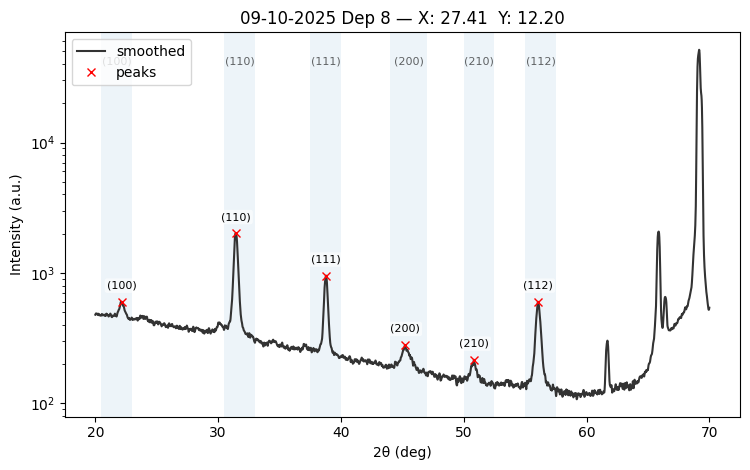


BTO_Mapping_Theta2Theta_09-10-2025_001_09_36-542_16-269.xy  peaks: 6
  (100)    [R1]   22.160°   I≈582.1   FWHM≈1.0456°   Area≈74.86
  (110)    [R2]   31.450°   I≈1653.0   FWHM≈1.7242°   Area≈577.69
  (111)    [R3]   38.800°   I≈910.5   FWHM≈1.3584°   Area≈264.43
  (200)    [R4]   45.190°   I≈279.5   FWHM≈1.3772°   Area≈82.12
  (210)    [R5]   50.880°   I≈194.9   FWHM≈1.0710°   Area≈34.25
  (112)    [R6]   56.080°   I≈567.8   FWHM≈1.6485°   Area≈238.92


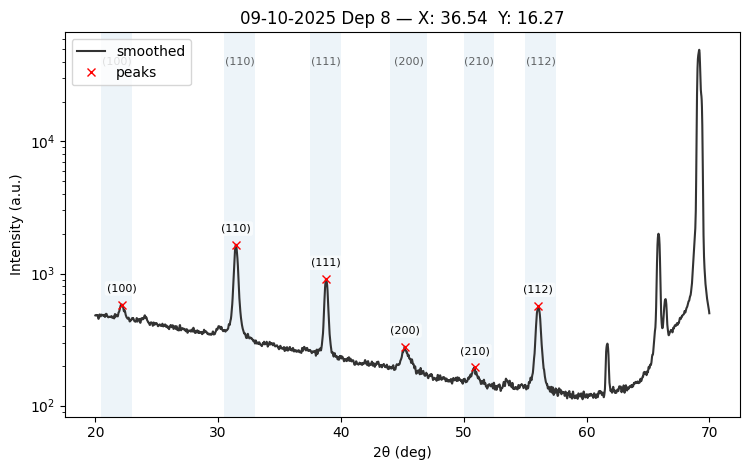


BTO_Mapping_Theta2Theta_09-10-2025_001_10_6-691_7-431.xy  peaks: 6
  (100)    [R1]   22.180°   I≈619.1   FWHM≈1.0813°   Area≈119.72
  (110)    [R2]   31.420°   I≈3142.8   FWHM≈1.7488°   Area≈1075.41
  (111)    [R3]   38.750°   I≈1060.7   FWHM≈1.4160°   Area≈329.04
  (200)    [R4]   45.100°   I≈312.6   FWHM≈1.5805°   Area≈107.12
  (210)    [R5]   50.760°   I≈235.3   FWHM≈1.3776°   Area≈55.81
  (112)    [R6]   56.010°   I≈558.5   FWHM≈1.6934°   Area≈224.53


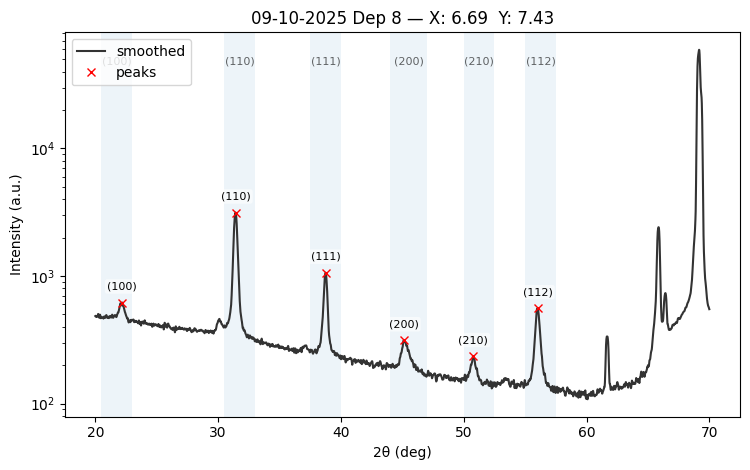


BTO_Mapping_Theta2Theta_09-10-2025_001_11_13-383_14-863.xy  peaks: 6
  (100)    [R1]   22.190°   I≈614.1   FWHM≈1.0488°   Area≈95.68
  (110)    [R2]   31.430°   I≈2746.5   FWHM≈1.7374°   Area≈939.38
  (111)    [R3]   38.770°   I≈1015.9   FWHM≈1.3959°   Area≈310.91
  (200)    [R4]   45.190°   I≈290.2   FWHM≈1.4034°   Area≈107.58
  (210)    [R5]   50.770°   I≈227.0   FWHM≈1.2824°   Area≈59.79
  (112)    [R6]   56.020°   I≈554.6   FWHM≈1.6708°   Area≈221.40


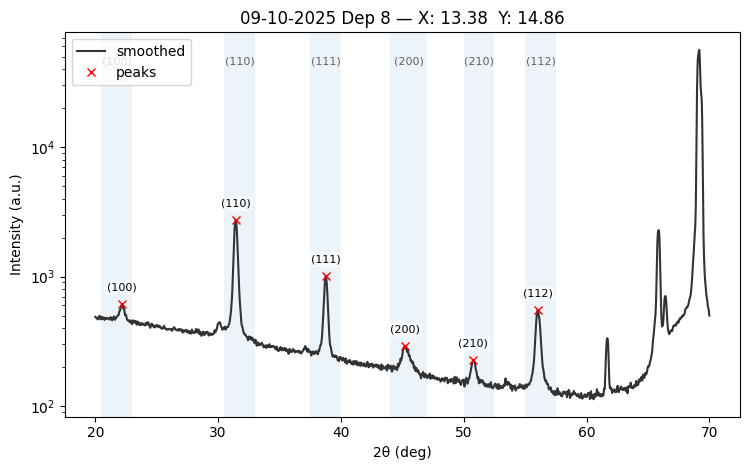


BTO_Mapping_Theta2Theta_09-10-2025_001_12_20-074_22-294.xy  peaks: 6
  (100)    [R1]   22.200°   I≈585.2   FWHM≈1.0919°   Area≈101.13
  (110)    [R2]   31.450°   I≈2162.1   FWHM≈1.7252°   Area≈737.81
  (111)    [R3]   38.790°   I≈1004.0   FWHM≈1.3708°   Area≈288.28
  (200)    [R4]   45.310°   I≈279.0   FWHM≈1.4023°   Area≈89.71
  (210)    [R5]   50.800°   I≈218.2   FWHM≈1.2365°   Area≈48.03
  (112)    [R6]   56.080°   I≈597.4   FWHM≈1.6470°   Area≈244.26


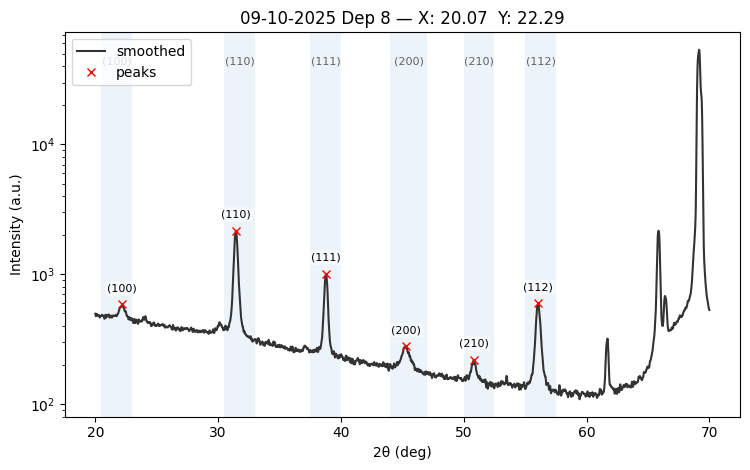


BTO_Mapping_Theta2Theta_09-10-2025_001_13_26-765_29-726.xy  peaks: 6
  (100)    [R1]   22.190°   I≈578.9   FWHM≈1.1172°   Area≈77.41
  (110)    [R2]   31.460°   I≈1674.8   FWHM≈1.7181°   Area≈575.69
  (111)    [R3]   38.810°   I≈968.9   FWHM≈1.3572°   Area≈285.72
  (200)    [R4]   45.220°   I≈278.9   FWHM≈1.3860°   Area≈86.05
  (210)    [R5]   50.760°   I≈200.1   FWHM≈1.1044°   Area≈38.19
  (112)    [R6]   56.060°   I≈592.6   FWHM≈1.6315°   Area≈237.16


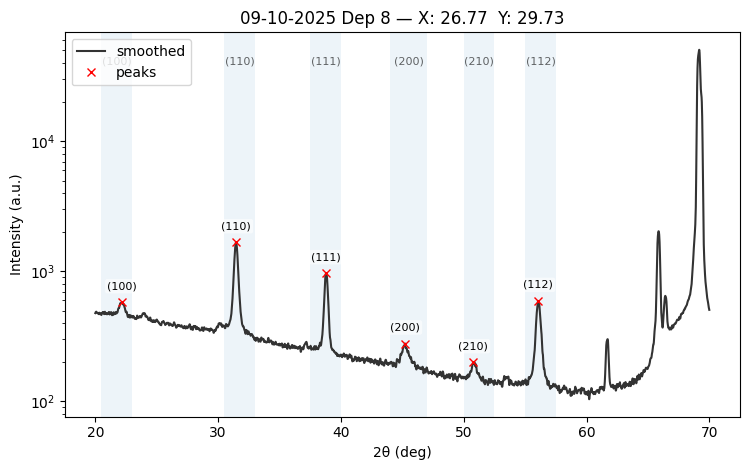


BTO_Mapping_Theta2Theta_09-10-2025_001_14_3-090_9-511.xy  peaks: 6
  (100)    [R1]   22.090°   I≈636.9   FWHM≈1.0886°   Area≈120.29
  (110)    [R2]   31.400°   I≈3160.2   FWHM≈1.7527°   Area≈1084.72
  (111)    [R3]   38.760°   I≈1075.0   FWHM≈1.4220°   Area≈342.43
  (200)    [R4]   45.190°   I≈326.3   FWHM≈1.6487°   Area≈122.60
  (210)    [R5]   50.770°   I≈235.1   FWHM≈1.3511°   Area≈55.57
  (112)    [R6]   55.980°   I≈562.4   FWHM≈1.6990°   Area≈239.65


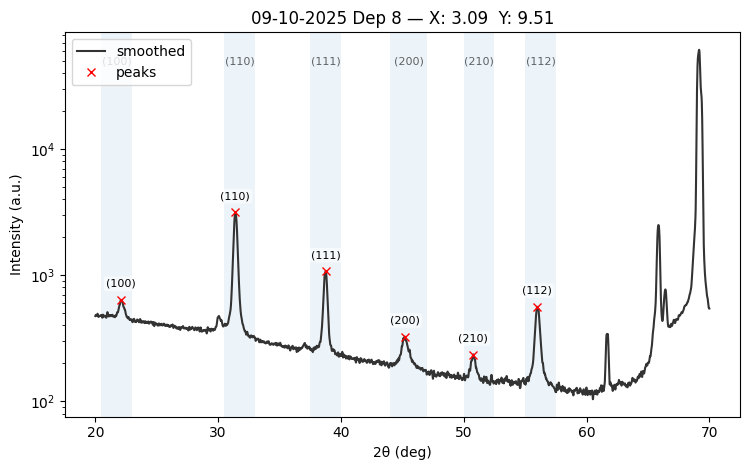


BTO_Mapping_Theta2Theta_09-10-2025_001_15_6-180_19-021.xy  peaks: 6
  (100)    [R1]   22.150°   I≈602.8   FWHM≈1.0901°   Area≈114.06
  (110)    [R2]   31.420°   I≈2936.0   FWHM≈1.7378°   Area≈1026.16
  (111)    [R3]   38.770°   I≈1086.9   FWHM≈1.3955°   Area≈323.59
  (200)    [R4]   45.170°   I≈304.2   FWHM≈1.4691°   Area≈109.60
  (210)    [R5]   50.850°   I≈233.9   FWHM≈1.3472°   Area≈50.62
  (112)    [R6]   56.030°   I≈562.6   FWHM≈1.6732°   Area≈225.81


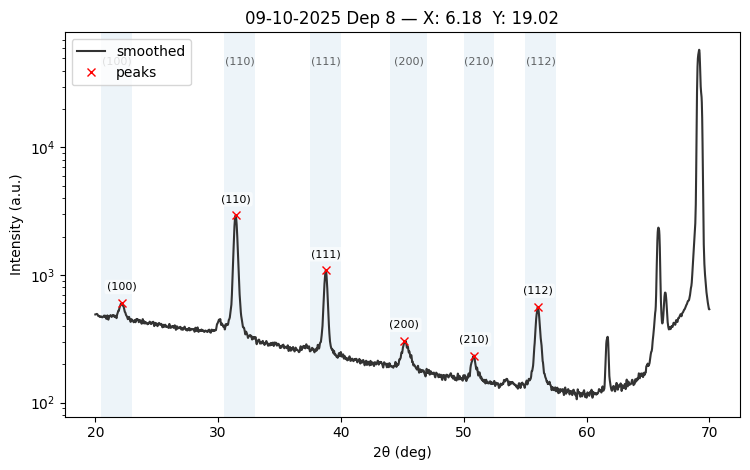


BTO_Mapping_Theta2Theta_09-10-2025_001_16_9-271_28-532.xy  peaks: 6
  (100)    [R1]   22.160°   I≈600.2   FWHM≈1.0359°   Area≈97.19
  (110)    [R2]   31.430°   I≈2425.7   FWHM≈1.7274°   Area≈849.58
  (111)    [R3]   38.780°   I≈1088.2   FWHM≈1.3798°   Area≈319.53
  (200)    [R4]   45.190°   I≈285.2   FWHM≈1.3715°   Area≈96.38
  (210)    [R5]   50.820°   I≈228.3   FWHM≈1.2612°   Area≈51.99
  (112)    [R6]   56.060°   I≈552.7   FWHM≈1.6638°   Area≈232.69


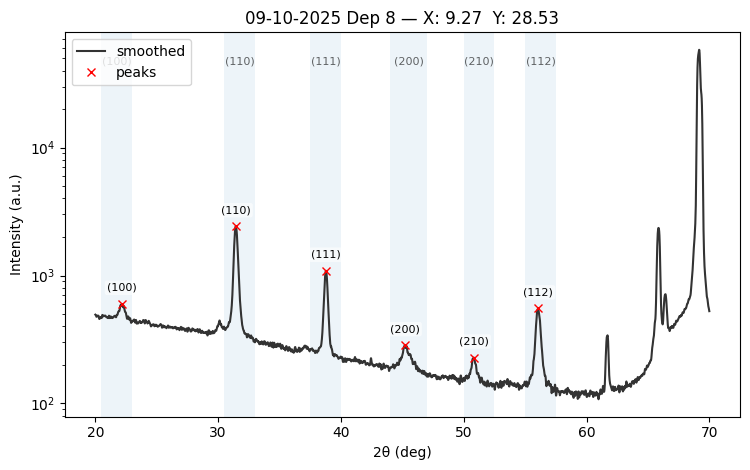


BTO_Mapping_Theta2Theta_09-10-2025_001_17_12-361_38-042.xy  peaks: 6
  (100)    [R1]   22.180°   I≈582.4   FWHM≈1.0391°   Area≈100.21
  (110)    [R2]   31.460°   I≈1869.8   FWHM≈1.7140°   Area≈648.06
  (111)    [R3]   38.800°   I≈1085.5   FWHM≈1.3623°   Area≈330.66
  (200)    [R4]   45.280°   I≈274.2   FWHM≈1.3887°   Area≈98.75
  (210)    [R5]   50.820°   I≈218.9   FWHM≈1.2429°   Area≈42.32
  (112)    [R6]   56.090°   I≈575.2   FWHM≈1.6328°   Area≈231.57


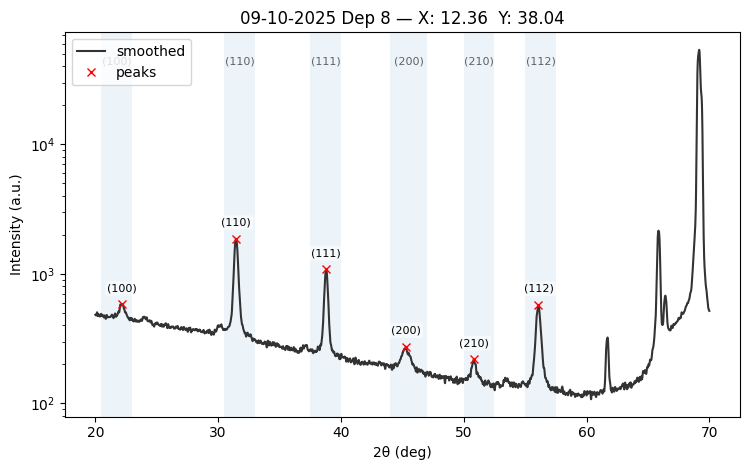


BTO_Mapping_Theta2Theta_09-10-2025_001_18_-1-045_9-945.xy  peaks: 6
  (100)    [R1]   22.150°   I≈635.2   FWHM≈1.0831°   Area≈104.49
  (110)    [R2]   31.420°   I≈3155.8   FWHM≈1.7582°   Area≈1116.85
  (111)    [R3]   38.750°   I≈1090.2   FWHM≈1.4274°   Area≈340.88
  (200)    [R4]   45.220°   I≈334.8   FWHM≈1.7155°   Area≈124.24
  (210)    [R5]   50.710°   I≈233.9   FWHM≈1.3452°   Area≈57.17
  (112)    [R6]   55.990°   I≈574.2   FWHM≈1.7138°   Area≈226.66


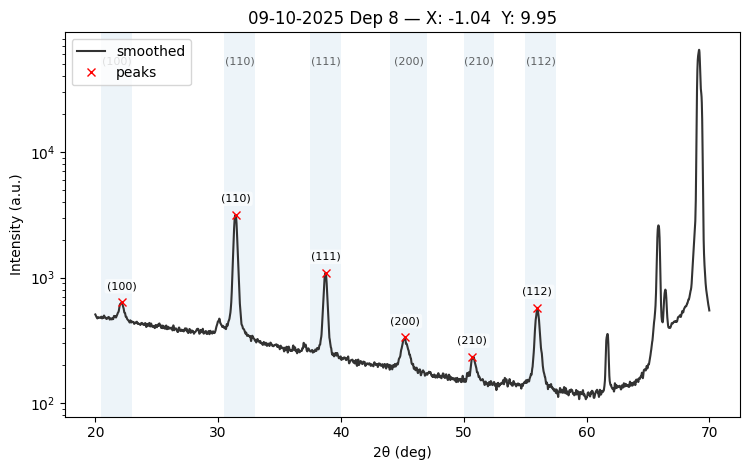


BTO_Mapping_Theta2Theta_09-10-2025_001_19_-2-091_19-890.xy  peaks: 6
  (100)    [R1]   22.150°   I≈635.1   FWHM≈1.0556°   Area≈100.49
  (110)    [R2]   31.420°   I≈3046.9   FWHM≈1.7441°   Area≈1054.33
  (111)    [R3]   38.750°   I≈1142.4   FWHM≈1.4088°   Area≈340.18
  (200)    [R4]   45.180°   I≈325.8   FWHM≈1.6320°   Area≈115.28
  (210)    [R5]   50.830°   I≈230.9   FWHM≈1.3244°   Area≈56.58
  (112)    [R6]   56.000°   I≈564.5   FWHM≈1.6916°   Area≈226.79


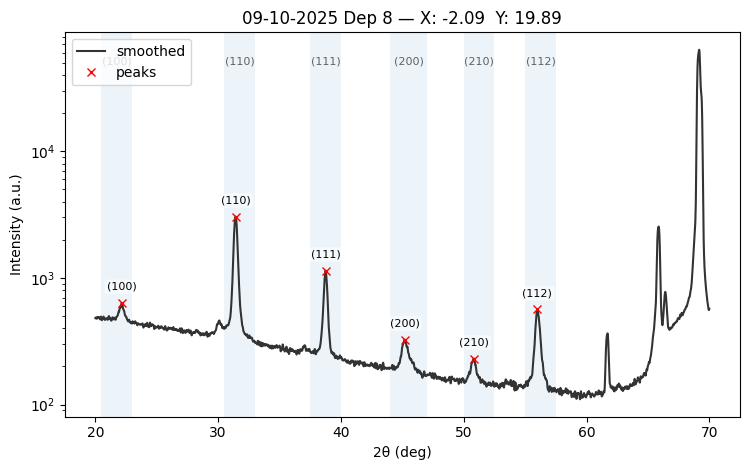


BTO_Mapping_Theta2Theta_09-10-2025_001_20_-3-136_29-836.xy  peaks: 6
  (100)    [R1]   22.080°   I≈602.3   FWHM≈1.1064°   Area≈116.75
  (110)    [R2]   31.440°   I≈2886.6   FWHM≈1.7329°   Area≈991.44
  (111)    [R3]   38.760°   I≈1155.1   FWHM≈1.3904°   Area≈349.54
  (200)    [R4]   45.270°   I≈309.4   FWHM≈1.5469°   Area≈94.83
  (210)    [R5]   50.850°   I≈233.4   FWHM≈1.3059°   Area≈61.54
  (112)    [R6]   56.050°   I≈556.7   FWHM≈1.6665°   Area≈228.74


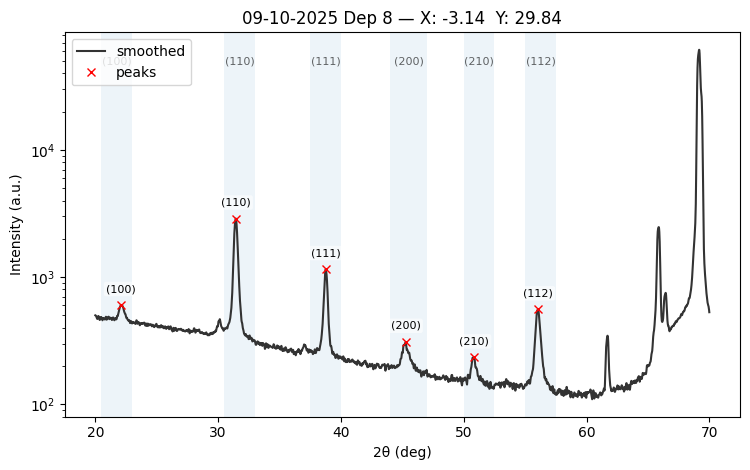


BTO_Mapping_Theta2Theta_09-10-2025_001_21_-4-181_39-781.xy  peaks: 6
  (100)    [R1]   22.200°   I≈602.9   FWHM≈1.0887°   Area≈80.78
  (110)    [R2]   31.460°   I≈2620.0   FWHM≈1.7133°   Area≈927.74
  (111)    [R3]   38.780°   I≈1137.3   FWHM≈1.3742°   Area≈332.06
  (200)    [R4]   45.300°   I≈288.0   FWHM≈1.4141°   Area≈87.79
  (210)    [R5]   50.850°   I≈241.2   FWHM≈1.3256°   Area≈61.64
  (112)    [R6]   56.070°   I≈554.4   FWHM≈1.6386°   Area≈223.69


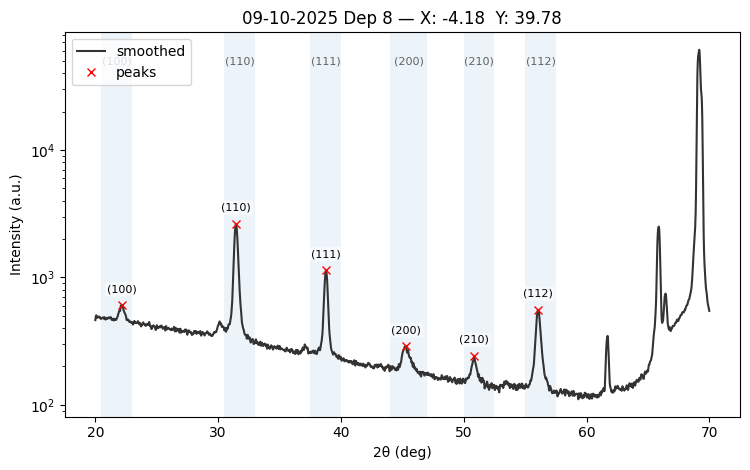


BTO_Mapping_Theta2Theta_09-10-2025_001_22_-5-000_8-660.xy  peaks: 6
  (100)    [R1]   22.170°   I≈645.8   FWHM≈1.1177°   Area≈107.49
  (110)    [R2]   31.400°   I≈3168.1   FWHM≈1.7581°   Area≈1091.99
  (111)    [R3]   38.740°   I≈1090.9   FWHM≈1.4346°   Area≈349.08
  (200)    [R4]   45.140°   I≈355.7   FWHM≈1.8094°   Area≈127.35
  (210)    [R5]   50.760°   I≈234.3   FWHM≈1.3737°   Area≈62.41
  (112)    [R6]   55.980°   I≈574.3   FWHM≈1.7290°   Area≈240.17


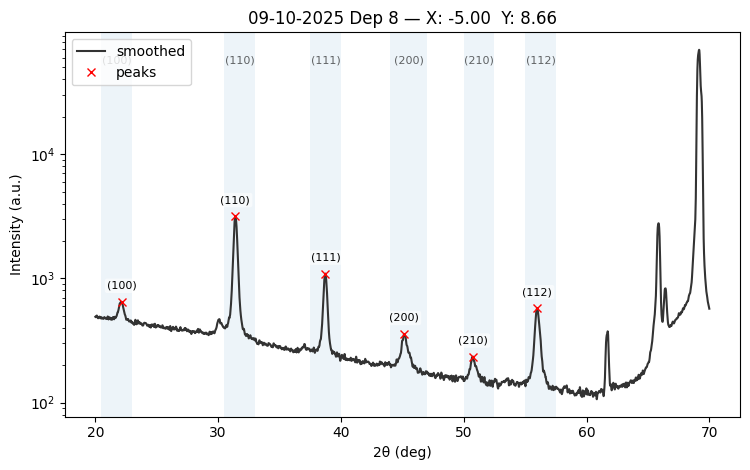


BTO_Mapping_Theta2Theta_09-10-2025_001_23_-10-000_17-321.xy  peaks: 6
  (100)    [R1]   22.110°   I≈669.9   FWHM≈1.0731°   Area≈137.51
  (110)    [R2]   31.420°   I≈3053.6   FWHM≈1.7503°   Area≈1047.88
  (111)    [R3]   38.720°   I≈1057.7   FWHM≈1.4381°   Area≈343.84
  (200)    [R4]   45.180°   I≈353.9   FWHM≈1.8166°   Area≈128.73
  (210)    [R5]   50.800°   I≈241.6   FWHM≈1.4139°   Area≈55.58
  (112)    [R6]   56.000°   I≈582.1   FWHM≈1.7120°   Area≈240.58


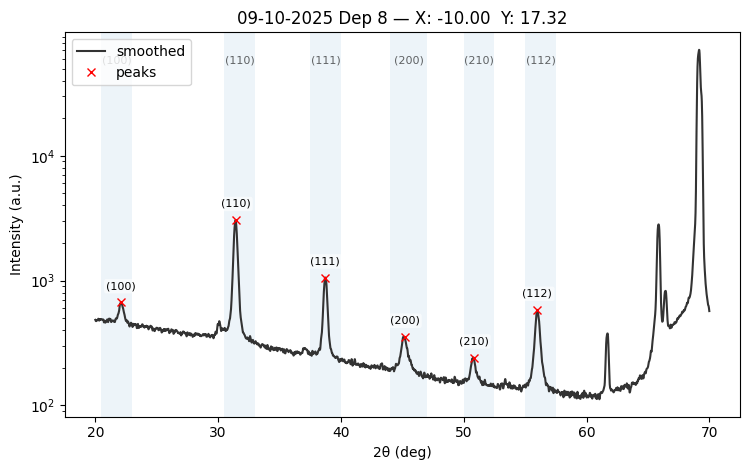


BTO_Mapping_Theta2Theta_09-10-2025_001_24_-15-000_25-981.xy  peaks: 6
  (100)    [R1]   22.110°   I≈638.4   FWHM≈1.0931°   Area≈120.43
  (110)    [R2]   31.420°   I≈2916.0   FWHM≈1.7489°   Area≈1031.45
  (111)    [R3]   38.730°   I≈1051.4   FWHM≈1.4250°   Area≈327.24
  (200)    [R4]   45.160°   I≈340.4   FWHM≈1.7456°   Area≈125.75
  (210)    [R5]   50.790°   I≈242.7   FWHM≈1.4111°   Area≈62.45
  (112)    [R6]   55.990°   I≈601.8   FWHM≈1.7040°   Area≈245.27


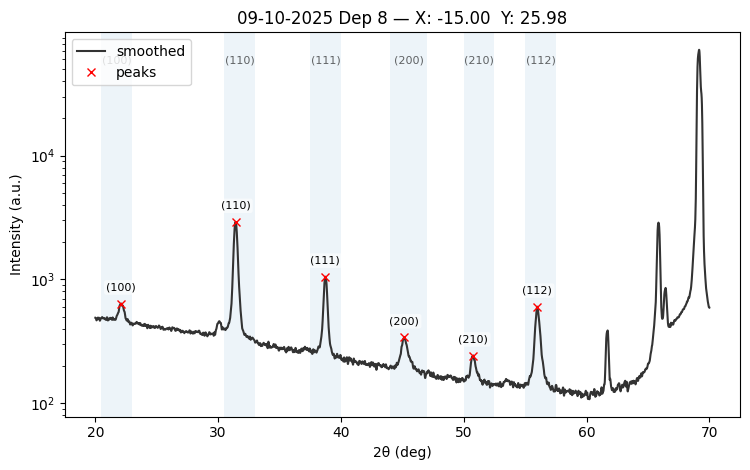


BTO_Mapping_Theta2Theta_09-10-2025_001_25_-20-000_34-641.xy  peaks: 6
  (100)    [R1]   22.150°   I≈629.8   FWHM≈1.0652°   Area≈124.44
  (110)    [R2]   31.450°   I≈2901.7   FWHM≈1.7195°   Area≈1034.01
  (111)    [R3]   38.760°   I≈1058.3   FWHM≈1.3988°   Area≈314.88
  (200)    [R4]   45.200°   I≈341.3   FWHM≈1.6821°   Area≈102.55
  (210)    [R5]   50.850°   I≈252.2   FWHM≈1.4296°   Area≈58.07
  (112)    [R6]   56.020°   I≈611.2   FWHM≈1.6752°   Area≈250.52


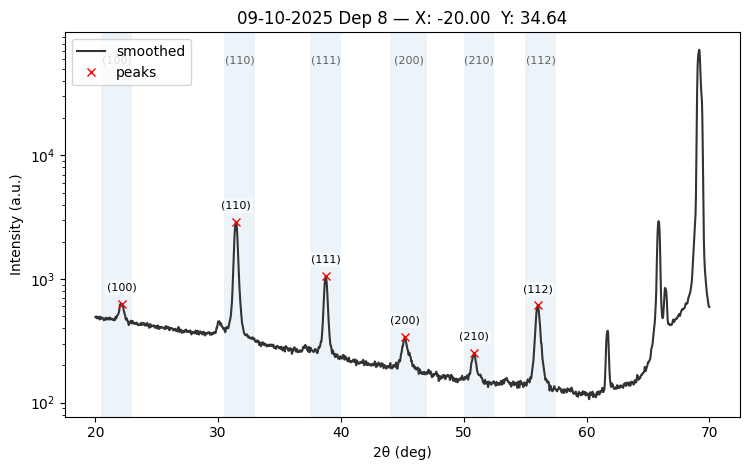


BTO_Mapping_Theta2Theta_09-10-2025_001_26_-8-090_5-878.xy  peaks: 6
  (100)    [R1]   22.090°   I≈671.6   FWHM≈1.1264°   Area≈107.27
  (110)    [R2]   31.400°   I≈3100.3   FWHM≈1.7659°   Area≈1079.98
  (111)    [R3]   38.720°   I≈1044.4   FWHM≈1.4505°   Area≈333.56
  (200)    [R4]   45.100°   I≈373.1   FWHM≈1.9524°   Area≈134.90
  (210)    [R5]   50.760°   I≈238.9   FWHM≈1.4295°   Area≈59.65
  (112)    [R6]   55.970°   I≈587.0   FWHM≈1.7162°   Area≈240.28


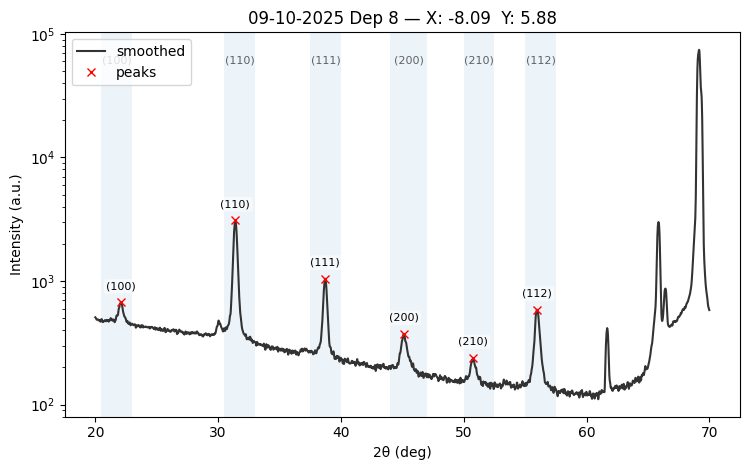


BTO_Mapping_Theta2Theta_09-10-2025_001_27_-16-180_11-756.xy  peaks: 6
  (100)    [R1]   22.060°   I≈690.7   FWHM≈1.1342°   Area≈120.85
  (110)    [R2]   31.410°   I≈2974.6   FWHM≈1.7637°   Area≈1038.92
  (111)    [R3]   38.720°   I≈989.4   FWHM≈1.4506°   Area≈302.66
  (200)    [R4]   45.140°   I≈381.7   FWHM≈1.9937°   Area≈158.00
  (210)    [R5]   50.730°   I≈242.5   FWHM≈1.4499°   Area≈51.54
  (112)    [R6]   55.980°   I≈604.4   FWHM≈1.7516°   Area≈257.14


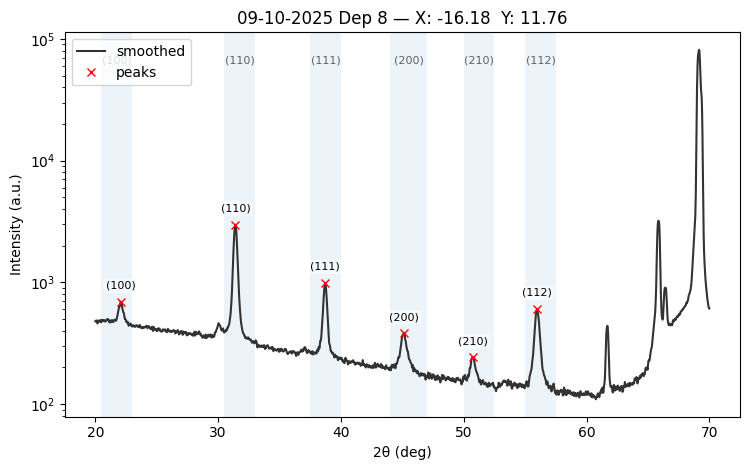


BTO_Mapping_Theta2Theta_09-10-2025_001_28_-24-271_17-634.xy  peaks: 6
  (100)    [R1]   22.040°   I≈691.2   FWHM≈1.1195°   Area≈157.22
  (110)    [R2]   31.410°   I≈2993.3   FWHM≈1.7575°   Area≈1051.79
  (111)    [R3]   38.720°   I≈916.1   FWHM≈1.4572°   Area≈284.85
  (200)    [R4]   45.070°   I≈394.3   FWHM≈2.0659°   Area≈149.48
  (210)    [R5]   50.810°   I≈261.4   FWHM≈1.5422°   Area≈70.33
  (112)    [R6]   55.980°   I≈598.0   FWHM≈1.7448°   Area≈251.83


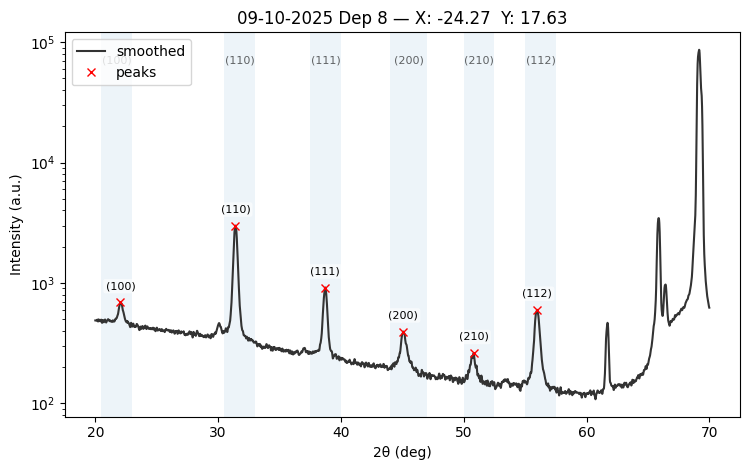


BTO_Mapping_Theta2Theta_09-10-2025_001_29_-32-361_23-511.xy  peaks: 6
  (100)    [R1]   22.070°   I≈684.3   FWHM≈1.1109°   Area≈147.03
  (110)    [R2]   31.420°   I≈3509.2   FWHM≈1.7431°   Area≈1231.54
  (111)    [R3]   38.710°   I≈849.5   FWHM≈1.4470°   Area≈250.21
  (200)    [R4]   45.120°   I≈386.3   FWHM≈2.0214°   Area≈144.98
  (210)    [R5]   50.680°   I≈256.5   FWHM≈1.5220°   Area≈74.21
  (112)    [R6]   55.990°   I≈600.1   FWHM≈1.7474°   Area≈262.55


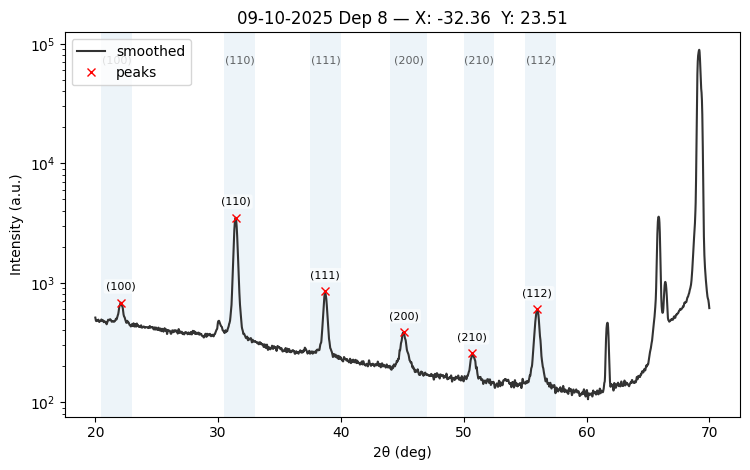


BTO_Mapping_Theta2Theta_09-10-2025_001_30_-9-781_2-079.xy  peaks: 6
  (100)    [R1]   22.070°   I≈691.7   FWHM≈1.1611°   Area≈125.69
  (110)    [R2]   31.400°   I≈3030.2   FWHM≈1.7729°   Area≈1054.53
  (111)    [R3]   38.710°   I≈1001.3   FWHM≈1.4574°   Area≈318.23
  (200)    [R4]   45.090°   I≈384.7   FWHM≈1.9829°   Area≈143.09
  (210)    [R5]   50.710°   I≈240.1   FWHM≈1.4268°   Area≈57.71
  (112)    [R6]   55.970°   I≈591.1   FWHM≈1.7434°   Area≈238.48


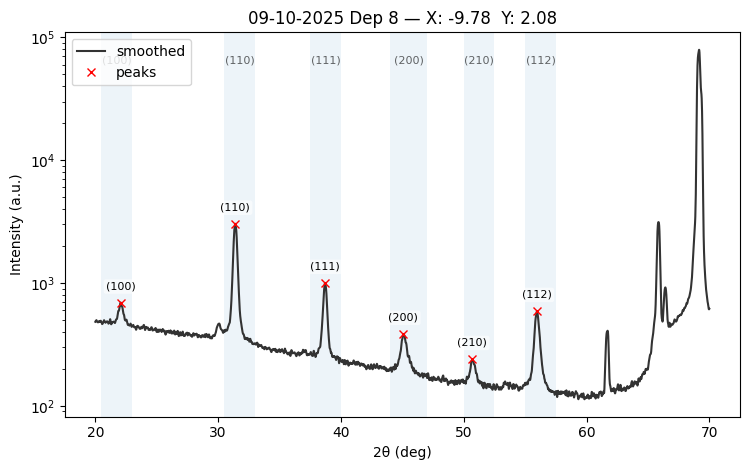


BTO_Mapping_Theta2Theta_09-10-2025_001_31_-19-563_4-158.xy  peaks: 6
  (100)    [R1]   22.020°   I≈718.8   FWHM≈1.1403°   Area≈138.12
  (110)    [R2]   31.400°   I≈2983.6   FWHM≈1.7729°   Area≈1043.62
  (111)    [R3]   38.700°   I≈866.0   FWHM≈1.4789°   Area≈279.82
  (200)    [R4]   45.070°   I≈418.9   FWHM≈2.2105°   Area≈158.34
  (210)    [R5]   50.680°   I≈245.5   FWHM≈1.5268°   Area≈59.35
  (112)    [R6]   55.940°   I≈603.1   FWHM≈1.7653°   Area≈246.98


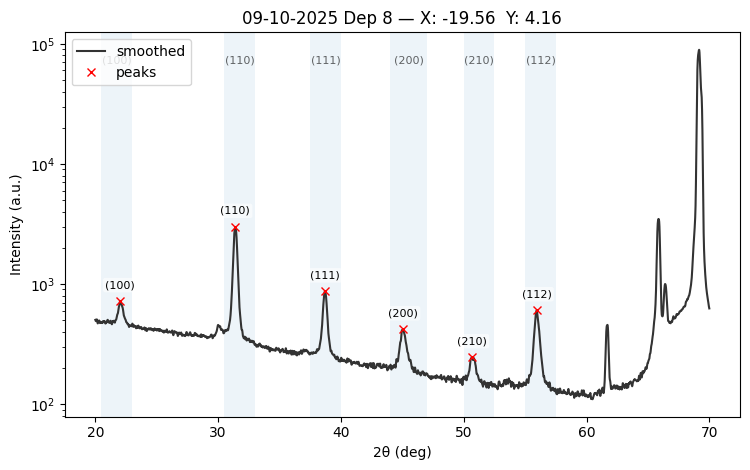


BTO_Mapping_Theta2Theta_09-10-2025_001_32_-29-344_6-237.xy  peaks: 6
  (100)    [R1]   22.080°   I≈705.3   FWHM≈1.1562°   Area≈163.65
  (110)    [R2]   31.380°   I≈3731.2   FWHM≈1.7788°   Area≈1299.60
  (111)    [R3]   38.690°   I≈751.5   FWHM≈1.5056°   Area≈229.35
  (200)    [R4]   45.080°   I≈440.6   FWHM≈2.2073°   Area≈168.99
  (210)    [R5]   50.670°   I≈262.1   FWHM≈1.6429°   Area≈66.08
  (112)    [R6]   55.910°   I≈556.9   FWHM≈1.8214°   Area≈240.74


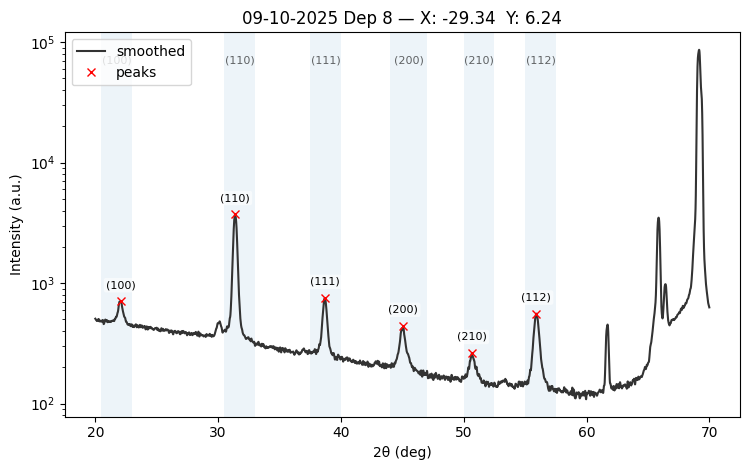


BTO_Mapping_Theta2Theta_09-10-2025_001_33_-39-126_8-316.xy  peaks: 6
  (100)    [R1]   22.100°   I≈663.9   FWHM≈1.1907°   Area≈137.31
  (110)    [R2]   31.360°   I≈6208.1   FWHM≈1.7966°   Area≈2105.67
  (111)    [R3]   38.680°   I≈576.8   FWHM≈1.5427°   Area≈184.18
  (200)    [R4]   45.000°   I≈379.8   FWHM≈2.1836°   Area≈161.09
  (210)    [R5]   50.630°   I≈264.2   FWHM≈1.7529°   Area≈64.88
  (112)    [R6]   55.870°   I≈497.3   FWHM≈1.8899°   Area≈209.10


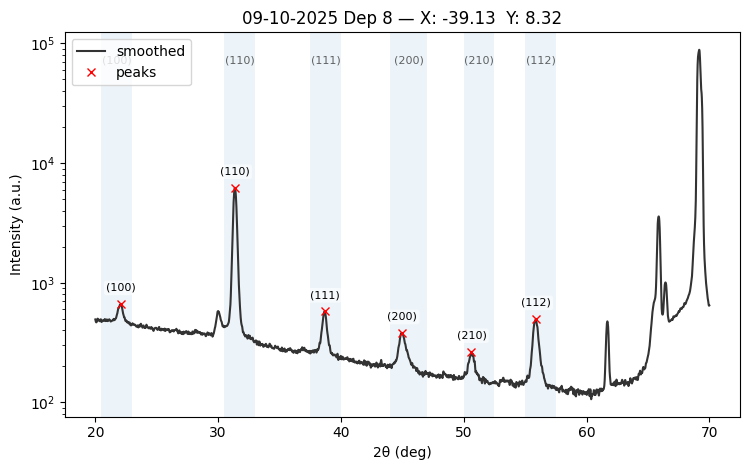


BTO_Mapping_Theta2Theta_09-10-2025_001_34_-9-781_-2-079.xy  peaks: 6
  (100)    [R1]   22.020°   I≈699.0   FWHM≈1.1300°   Area≈127.76
  (110)    [R2]   31.400°   I≈3018.8   FWHM≈1.7700°   Area≈1050.61
  (111)    [R3]   38.710°   I≈988.5   FWHM≈1.4624°   Area≈311.13
  (200)    [R4]   45.100°   I≈386.7   FWHM≈2.0023°   Area≈158.32
  (210)    [R5]   50.790°   I≈236.0   FWHM≈1.4256°   Area≈64.33
  (112)    [R6]   55.970°   I≈588.0   FWHM≈1.7508°   Area≈241.56


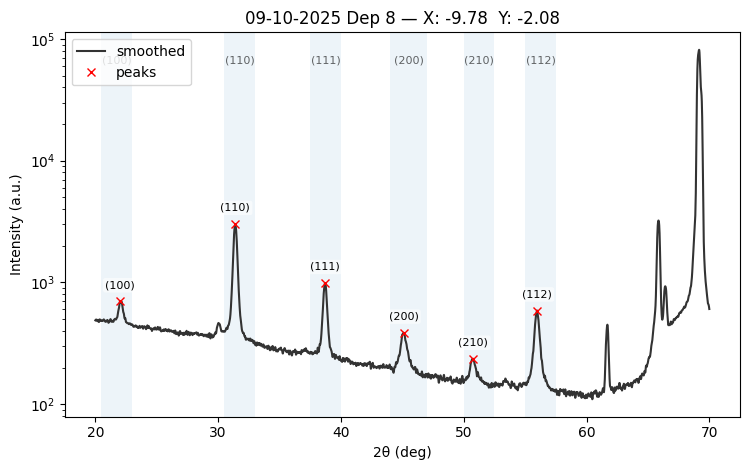


BTO_Mapping_Theta2Theta_09-10-2025_001_35_-19-563_-4-158.xy  peaks: 6
  (100)    [R1]   22.070°   I≈743.3   FWHM≈1.1502°   Area≈136.08
  (110)    [R2]   31.390°   I≈3107.6   FWHM≈1.7767°   Area≈1082.04
  (111)    [R3]   38.690°   I≈837.3   FWHM≈1.4901°   Area≈278.22
  (200)    [R4]   45.020°   I≈433.8   FWHM≈2.1969°   Area≈172.36
  (210)    [R5]   50.740°   I≈247.5   FWHM≈1.5554°   Area≈58.50
  (112)    [R6]   55.920°   I≈581.9   FWHM≈1.8013°   Area≈243.59


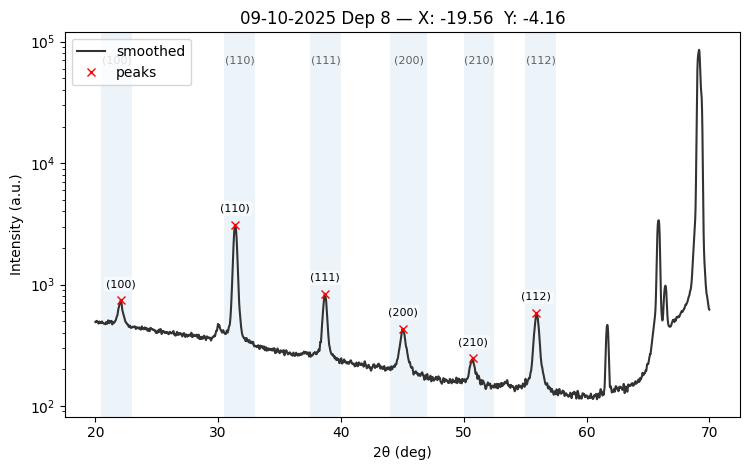


BTO_Mapping_Theta2Theta_09-10-2025_001_36_-29-344_-6-237.xy  peaks: 6
  (100)    [R1]   22.020°   I≈729.8   FWHM≈1.1931°   Area≈162.88
  (110)    [R2]   31.360°   I≈4516.6   FWHM≈1.8054°   Area≈1568.28
  (111)    [R3]   38.620°   I≈653.1   FWHM≈1.5478°   Area≈209.45
  (200)    [R4]   45.010°   I≈432.0   FWHM≈2.2965°   Area≈182.96
  (210)    [R5]   50.630°   I≈264.1   FWHM≈1.7151°   Area≈59.90
  (112)    [R6]   55.860°   I≈531.9   FWHM≈1.8886°   Area≈237.31


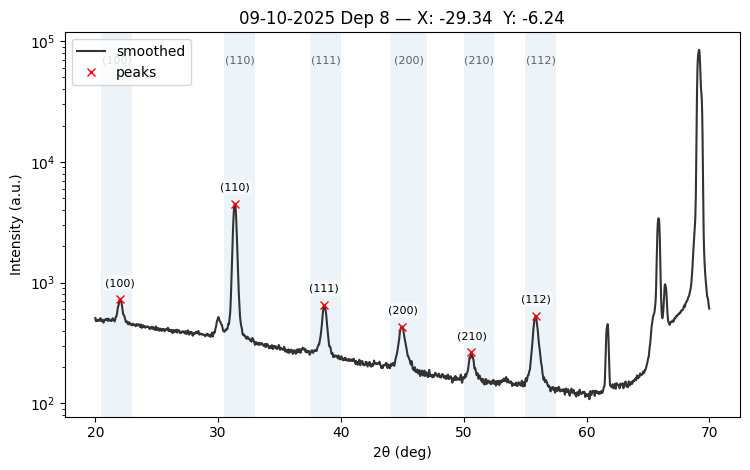


BTO_Mapping_Theta2Theta_09-10-2025_001_37_-39-126_-8-316.xy  peaks: 6
  (100)    [R1]   21.980°   I≈823.4   FWHM≈1.1824°   Area≈165.88
  (110)    [R2]   31.300°   I≈7851.2   FWHM≈1.8418°   Area≈2480.64
  (111)    [R3]   38.620°   I≈457.0   FWHM≈1.5769°   Area≈114.10
  (200)    [R4]   44.910°   I≈539.1   FWHM≈2.3427°   Area≈249.89
  (210)    [R5]   50.540°   I≈259.1   FWHM≈1.7487°   Area≈64.03
  (112)    [R6]   55.710°   I≈545.1   FWHM≈1.9876°   Area≈213.99


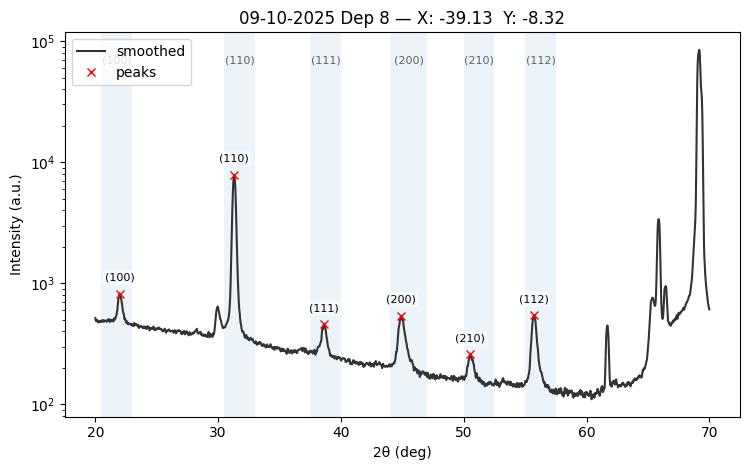


BTO_Mapping_Theta2Theta_09-10-2025_001_38_-8-090_-5-878.xy  peaks: 6
  (100)    [R1]   22.090°   I≈696.6   FWHM≈1.1435°   Area≈134.45
  (110)    [R2]   31.400°   I≈2994.9   FWHM≈1.7745°   Area≈1072.09
  (111)    [R3]   38.700°   I≈996.9   FWHM≈1.4587°   Area≈316.53
  (200)    [R4]   45.100°   I≈397.0   FWHM≈2.1082°   Area≈148.65
  (210)    [R5]   50.750°   I≈245.5   FWHM≈1.4470°   Area≈70.69
  (112)    [R6]   55.970°   I≈586.5   FWHM≈1.7558°   Area≈241.72


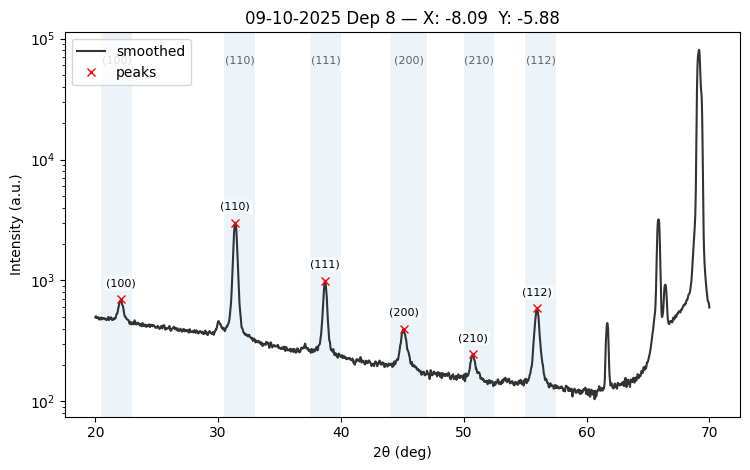


BTO_Mapping_Theta2Theta_09-10-2025_001_39_-16-180_-11-756.xy  peaks: 6
  (100)    [R1]   22.020°   I≈738.0   FWHM≈1.1724°   Area≈130.76
  (110)    [R2]   31.390°   I≈3060.8   FWHM≈1.7801°   Area≈1051.56
  (111)    [R3]   38.710°   I≈846.4   FWHM≈1.4833°   Area≈261.38
  (200)    [R4]   45.060°   I≈441.7   FWHM≈2.2021°   Area≈175.06
  (210)    [R5]   50.750°   I≈251.5   FWHM≈1.5767°   Area≈63.61
  (112)    [R6]   55.940°   I≈582.7   FWHM≈1.7858°   Area≈250.73


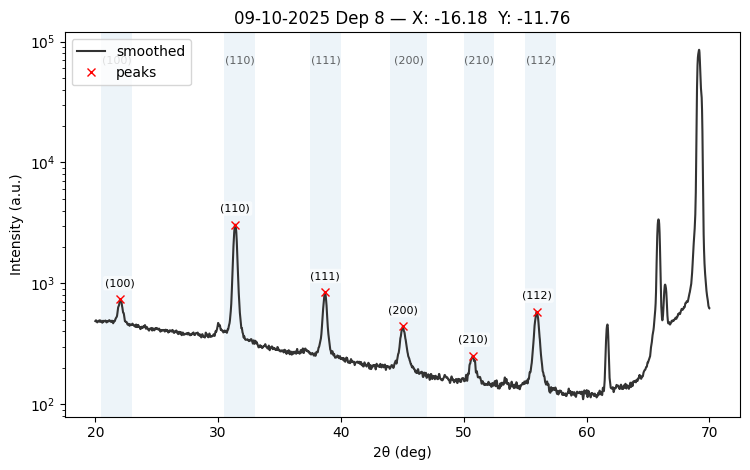


BTO_Mapping_Theta2Theta_09-10-2025_001_40_-24-271_-17-634.xy  peaks: 6
  (100)    [R1]   22.070°   I≈727.8   FWHM≈1.1893°   Area≈159.68
  (110)    [R2]   31.360°   I≈4320.5   FWHM≈1.8016°   Area≈1495.92
  (111)    [R3]   38.660°   I≈681.7   FWHM≈1.5349°   Area≈207.65
  (200)    [R4]   45.010°   I≈441.6   FWHM≈2.2783°   Area≈178.15
  (210)    [R5]   50.530°   I≈254.2   FWHM≈1.6987°   Area≈64.58
  (112)    [R6]   55.830°   I≈521.1   FWHM≈1.8765°   Area≈230.89


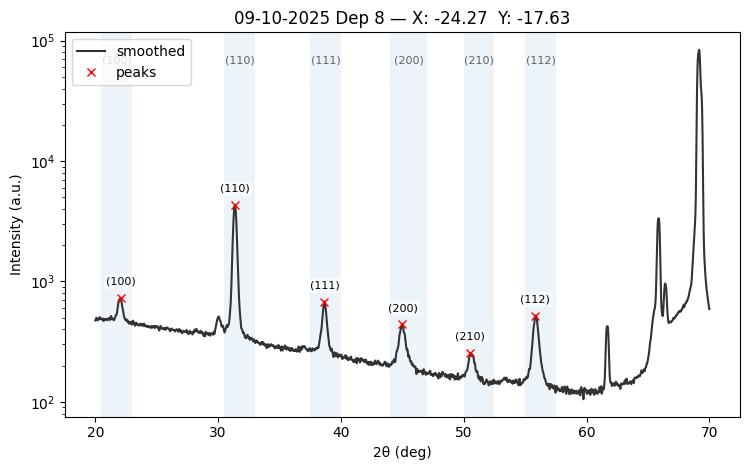


BTO_Mapping_Theta2Theta_09-10-2025_001_41_-32-361_-23-511.xy  peaks: 6
  (100)    [R1]   22.010°   I≈766.1   FWHM≈1.2046°   Area≈162.11
  (110)    [R2]   31.320°   I≈8270.9   FWHM≈1.8314°   Area≈2632.43
  (111)    [R3]   38.620°   I≈471.5   FWHM≈1.6104°   Area≈134.99
  (200)    [R4]   44.920°   I≈473.2   FWHM≈2.3384°   Area≈217.38
  (210)    [R5]   50.570°   I≈270.6   FWHM≈1.8106°   Area≈63.01
  (112)    [R6]   55.710°   I≈517.4   FWHM≈1.9760°   Area≈226.74


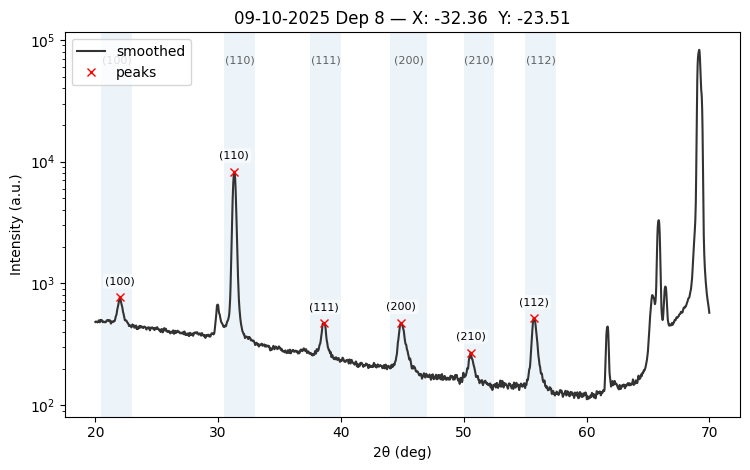


BTO_Mapping_Theta2Theta_09-10-2025_001_42_-5-000_-8-660.xy  peaks: 6
  (100)    [R1]   22.030°   I≈689.7   FWHM≈1.1032°   Area≈106.56
  (110)    [R2]   31.390°   I≈3090.1   FWHM≈1.7691°   Area≈1074.81
  (111)    [R3]   38.730°   I≈1012.5   FWHM≈1.4562°   Area≈335.18
  (200)    [R4]   45.120°   I≈398.1   FWHM≈2.0573°   Area≈154.89
  (210)    [R5]   50.750°   I≈240.7   FWHM≈1.4777°   Area≈55.64
  (112)    [R6]   55.940°   I≈591.7   FWHM≈1.7448°   Area≈251.46


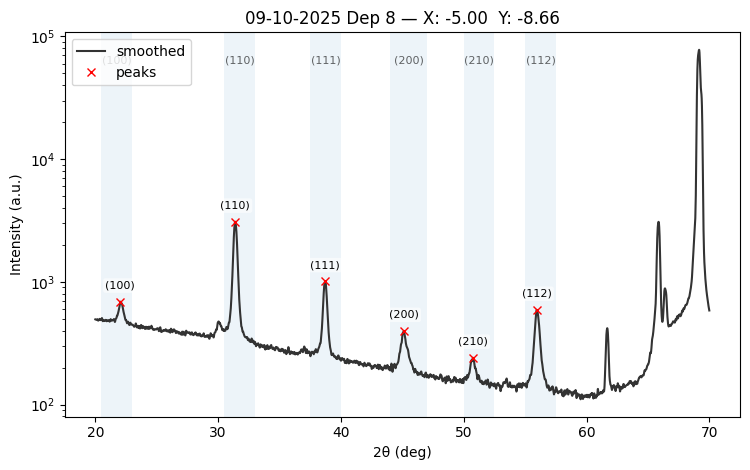


BTO_Mapping_Theta2Theta_09-10-2025_001_43_-10-000_-17-321.xy  peaks: 6
  (100)    [R1]   22.020°   I≈711.6   FWHM≈1.1447°   Area≈154.25
  (110)    [R2]   31.390°   I≈2991.2   FWHM≈1.7733°   Area≈1016.65
  (111)    [R3]   38.700°   I≈896.8   FWHM≈1.4750°   Area≈282.65
  (200)    [R4]   45.050°   I≈409.5   FWHM≈2.1860°   Area≈157.42
  (210)    [R5]   50.710°   I≈246.6   FWHM≈1.4809°   Area≈62.40
  (112)    [R6]   55.950°   I≈592.9   FWHM≈1.7631°   Area≈253.77


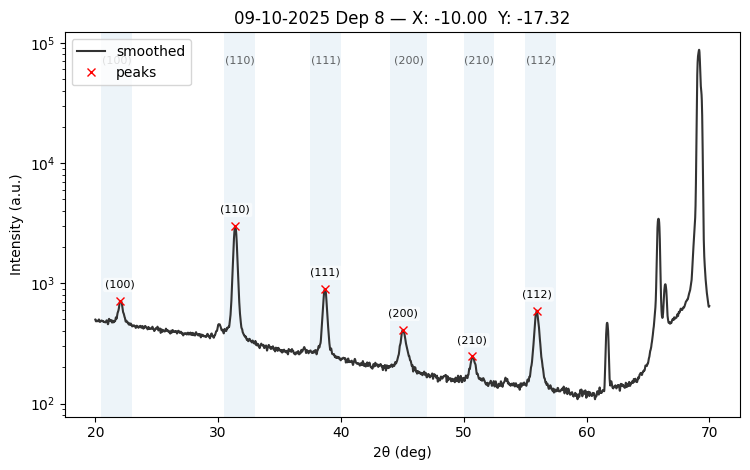


BTO_Mapping_Theta2Theta_09-10-2025_001_44_-15-000_-25-981.xy  peaks: 6
  (100)    [R1]   22.050°   I≈712.0   FWHM≈1.1439°   Area≈113.96
  (110)    [R2]   31.390°   I≈3306.9   FWHM≈1.7734°   Area≈1168.12
  (111)    [R3]   38.700°   I≈806.2   FWHM≈1.4842°   Area≈250.11
  (200)    [R4]   45.060°   I≈422.9   FWHM≈2.2044°   Area≈172.70
  (210)    [R5]   50.680°   I≈250.1   FWHM≈1.5410°   Area≈61.75
  (112)    [R6]   55.930°   I≈590.0   FWHM≈1.7886°   Area≈248.84


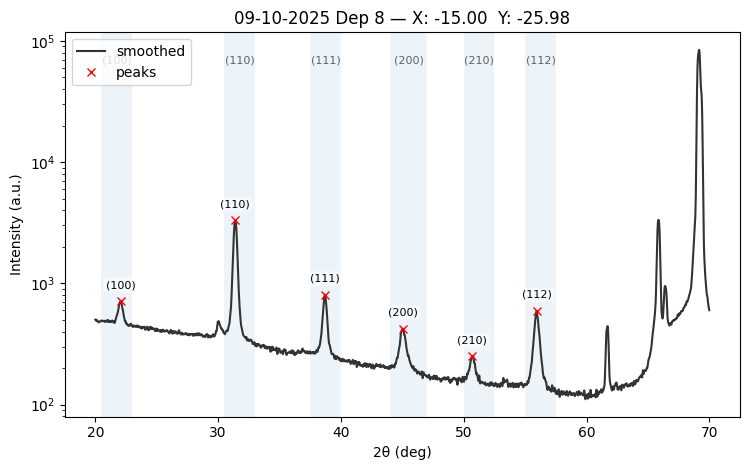


BTO_Mapping_Theta2Theta_09-10-2025_001_45_-20-000_-34-641.xy  peaks: 6
  (100)    [R1]   22.030°   I≈697.2   FWHM≈1.1727°   Area≈151.99
  (110)    [R2]   31.390°   I≈4826.8   FWHM≈1.7764°   Area≈1664.16
  (111)    [R3]   38.670°   I≈640.9   FWHM≈1.5237°   Area≈201.09
  (200)    [R4]   44.990°   I≈399.9   FWHM≈2.2059°   Area≈165.45
  (210)    [R5]   50.620°   I≈258.3   FWHM≈1.6549°   Area≈72.82
  (112)    [R6]   55.850°   I≈518.4   FWHM≈1.8624°   Area≈241.11


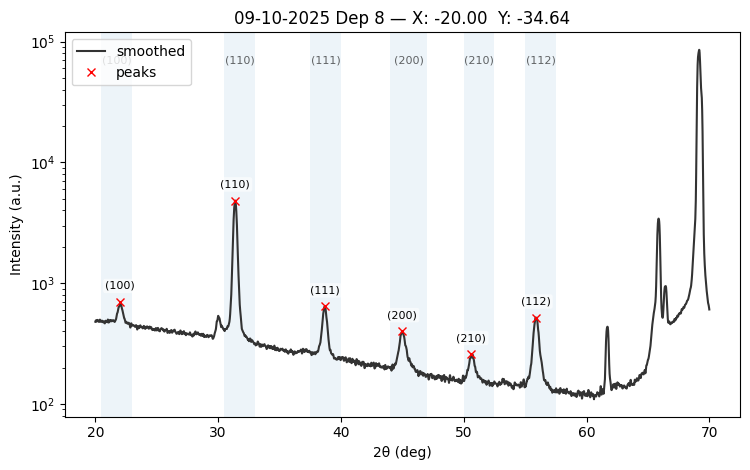


BTO_Mapping_Theta2Theta_09-10-2025_001_46_-1-045_-9-945.xy  peaks: 6
  (100)    [R1]   22.100°   I≈673.5   FWHM≈1.1139°   Area≈134.90
  (110)    [R2]   31.400°   I≈3158.8   FWHM≈1.7712°   Area≈1108.42
  (111)    [R3]   38.730°   I≈1081.2   FWHM≈1.4465°   Area≈328.89
  (200)    [R4]   45.140°   I≈369.4   FWHM≈1.9031°   Area≈123.72
  (210)    [R5]   50.750°   I≈238.9   FWHM≈1.4049°   Area≈65.52
  (112)    [R6]   55.980°   I≈578.8   FWHM≈1.7336°   Area≈230.80


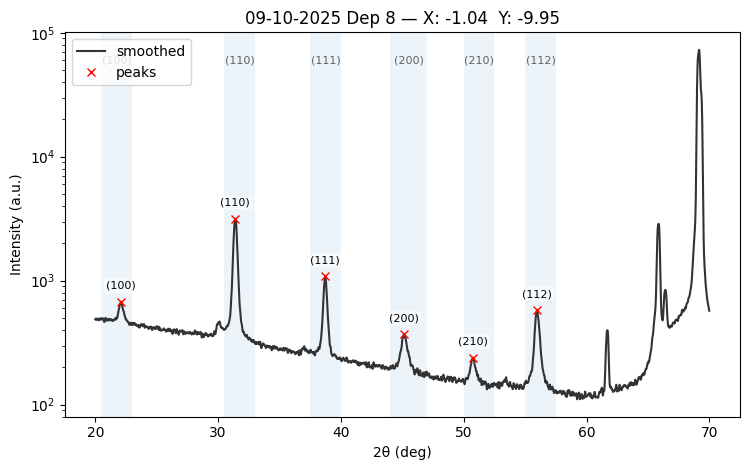


BTO_Mapping_Theta2Theta_09-10-2025_001_47_-2-091_-19-890.xy  peaks: 6
  (100)    [R1]   22.050°   I≈678.1   FWHM≈1.1282°   Area≈138.01
  (110)    [R2]   31.400°   I≈3122.2   FWHM≈1.7662°   Area≈1084.12
  (111)    [R3]   38.720°   I≈1026.2   FWHM≈1.4517°   Area≈327.22
  (200)    [R4]   45.150°   I≈398.4   FWHM≈2.0298°   Area≈150.89
  (210)    [R5]   50.810°   I≈242.3   FWHM≈1.4200°   Area≈63.94
  (112)    [R6]   55.950°   I≈583.7   FWHM≈1.7356°   Area≈245.70


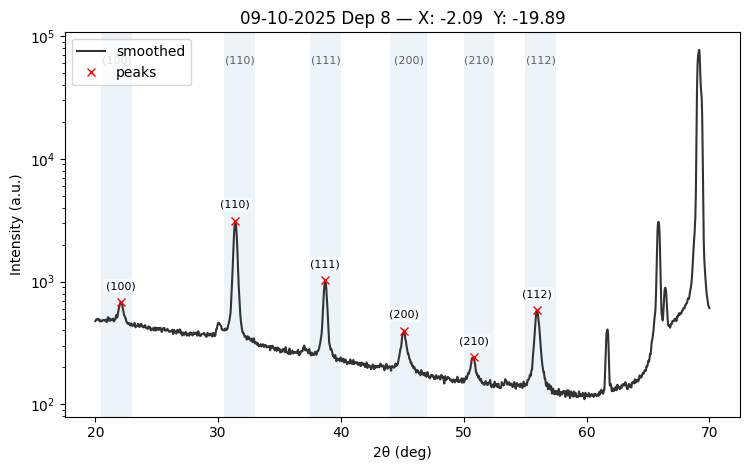


BTO_Mapping_Theta2Theta_09-10-2025_001_48_-3-136_-29-836.xy  peaks: 6
  (100)    [R1]   22.080°   I≈695.0   FWHM≈1.1205°   Area≈115.54
  (110)    [R2]   31.410°   I≈3070.0   FWHM≈1.7625°   Area≈1062.47
  (111)    [R3]   38.730°   I≈990.2   FWHM≈1.4468°   Area≈319.25
  (200)    [R4]   45.100°   I≈387.8   FWHM≈2.0745°   Area≈142.71
  (210)    [R5]   50.740°   I≈253.9   FWHM≈1.5216°   Area≈60.58
  (112)    [R6]   55.980°   I≈601.4   FWHM≈1.7411°   Area≈244.43


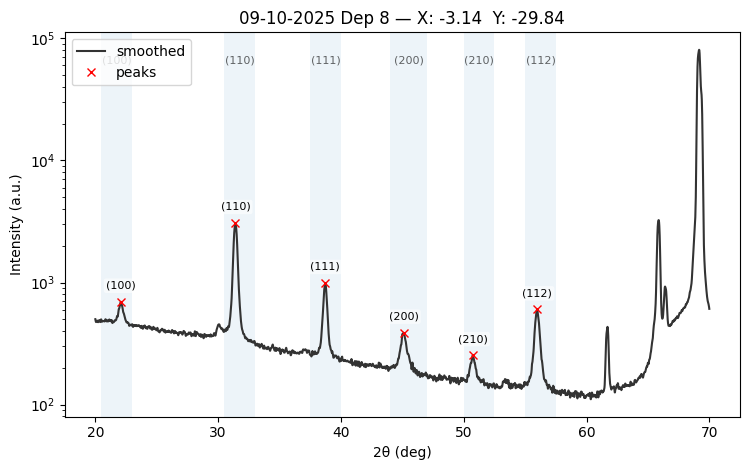


BTO_Mapping_Theta2Theta_09-10-2025_001_49_-4-181_-39-781.xy  peaks: 6
  (100)    [R1]   22.110°   I≈681.7   FWHM≈1.1080°   Area≈141.06
  (110)    [R2]   31.420°   I≈3115.2   FWHM≈1.7521°   Area≈1099.22
  (111)    [R3]   38.740°   I≈942.0   FWHM≈1.4411°   Area≈283.99
  (200)    [R4]   45.130°   I≈383.5   FWHM≈2.0193°   Area≈141.59
  (210)    [R5]   50.770°   I≈251.2   FWHM≈1.5220°   Area≈64.80
  (112)    [R6]   56.010°   I≈592.7   FWHM≈1.7345°   Area≈262.40


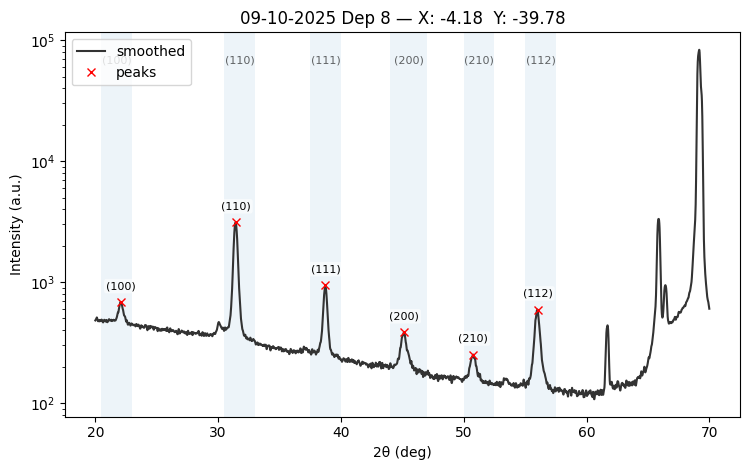


BTO_Mapping_Theta2Theta_09-10-2025_001_50_3-090_-9-511.xy  peaks: 6
  (100)    [R1]   22.090°   I≈645.1   FWHM≈1.1120°   Area≈117.65
  (110)    [R2]   31.410°   I≈3233.3   FWHM≈1.7617°   Area≈1128.50
  (111)    [R3]   38.720°   I≈1115.3   FWHM≈1.4337°   Area≈335.10
  (200)    [R4]   45.190°   I≈342.0   FWHM≈1.7821°   Area≈120.97
  (210)    [R5]   50.820°   I≈232.0   FWHM≈1.3542°   Area≈56.94
  (112)    [R6]   55.970°   I≈565.8   FWHM≈1.7224°   Area≈240.03


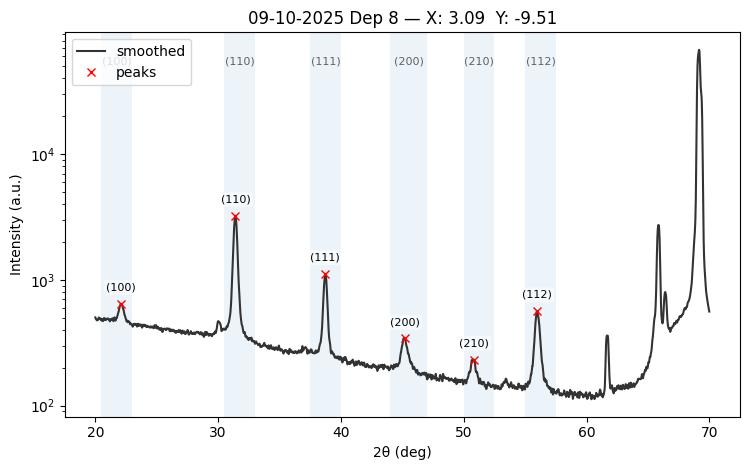


BTO_Mapping_Theta2Theta_09-10-2025_001_51_6-180_-19-021.xy  peaks: 6
  (100)    [R1]   22.130°   I≈659.8   FWHM≈1.0316°   Area≈116.06
  (110)    [R2]   31.410°   I≈3166.0   FWHM≈1.7592°   Area≈1095.57
  (111)    [R3]   38.740°   I≈1112.6   FWHM≈1.4288°   Area≈348.74
  (200)    [R4]   45.160°   I≈334.9   FWHM≈1.7338°   Area≈118.11
  (210)    [R5]   50.770°   I≈241.4   FWHM≈1.3922°   Area≈56.26
  (112)    [R6]   56.000°   I≈570.3   FWHM≈1.7221°   Area≈249.78


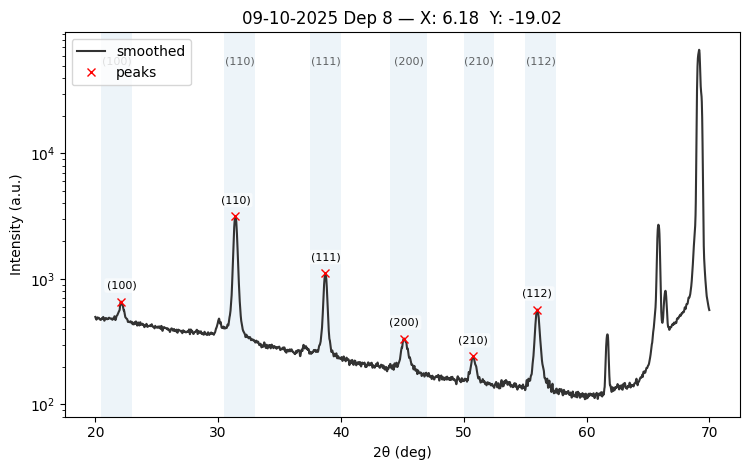


BTO_Mapping_Theta2Theta_09-10-2025_001_52_9-271_-28-532.xy  peaks: 6
  (100)    [R1]   22.150°   I≈645.9   FWHM≈1.0397°   Area≈105.88
  (110)    [R2]   31.420°   I≈3157.3   FWHM≈1.7505°   Area≈1092.71
  (111)    [R3]   38.750°   I≈1127.6   FWHM≈1.4208°   Area≈356.50
  (200)    [R4]   45.150°   I≈331.7   FWHM≈1.7287°   Area≈112.96
  (210)    [R5]   50.840°   I≈241.0   FWHM≈1.3726°   Area≈64.44
  (112)    [R6]   56.000°   I≈566.1   FWHM≈1.7049°   Area≈232.38


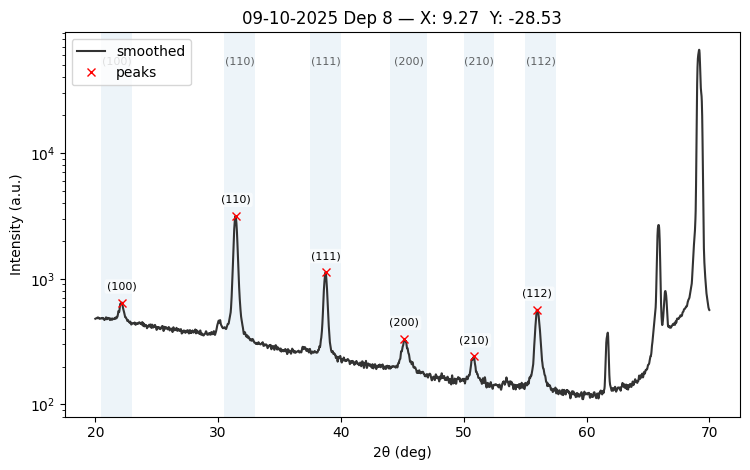


BTO_Mapping_Theta2Theta_09-10-2025_001_53_12-361_-38-042.xy  peaks: 6
  (100)    [R1]   22.170°   I≈629.5   FWHM≈1.0542°   Area≈94.85
  (110)    [R2]   31.430°   I≈3073.5   FWHM≈1.7356°   Area≈1091.18
  (111)    [R3]   38.760°   I≈1066.3   FWHM≈1.4060°   Area≈327.51
  (200)    [R4]   45.240°   I≈319.3   FWHM≈1.5895°   Area≈110.72
  (210)    [R5]   50.790°   I≈247.9   FWHM≈1.3580°   Area≈59.07
  (112)    [R6]   56.020°   I≈563.9   FWHM≈1.6850°   Area≈233.13


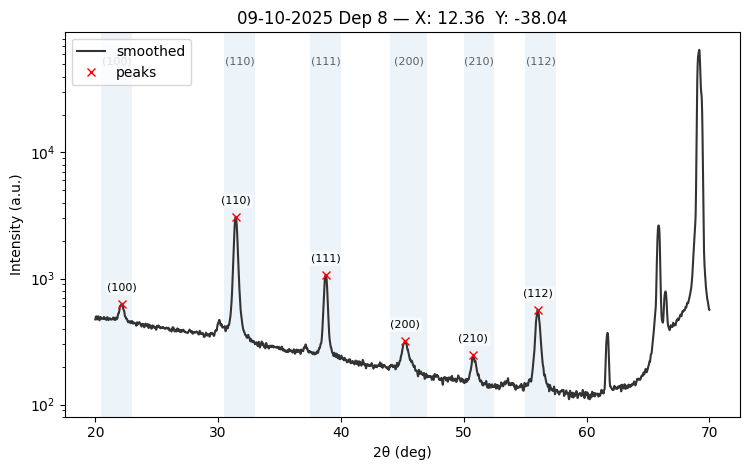


BTO_Mapping_Theta2Theta_09-10-2025_001_54_6-691_-7-431.xy  peaks: 6
  (100)    [R1]   22.150°   I≈643.1   FWHM≈1.1195°   Area≈114.37
  (110)    [R2]   31.410°   I≈3237.2   FWHM≈1.7572°   Area≈1121.86
  (111)    [R3]   38.740°   I≈1121.9   FWHM≈1.4278°   Area≈358.88
  (200)    [R4]   45.180°   I≈320.1   FWHM≈1.6481°   Area≈112.85
  (210)    [R5]   50.820°   I≈236.3   FWHM≈1.3261°   Area≈62.59
  (112)    [R6]   56.020°   I≈552.3   FWHM≈1.7151°   Area≈233.10


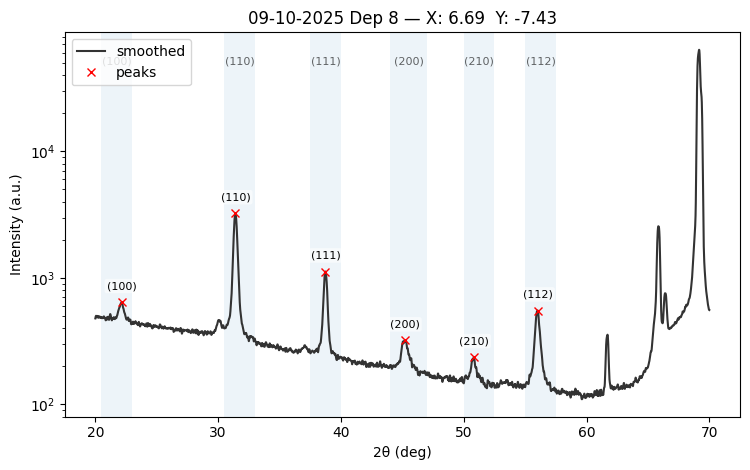


BTO_Mapping_Theta2Theta_09-10-2025_001_55_13-383_-14-863.xy  peaks: 6
  (100)    [R1]   22.150°   I≈618.4   FWHM≈1.0984°   Area≈104.47
  (110)    [R2]   31.410°   I≈3019.2   FWHM≈1.7535°   Area≈1087.43
  (111)    [R3]   38.760°   I≈1129.1   FWHM≈1.4186°   Area≈358.52
  (200)    [R4]   45.180°   I≈311.5   FWHM≈1.5981°   Area≈111.43
  (210)    [R5]   50.790°   I≈232.5   FWHM≈1.3702°   Area≈69.21
  (112)    [R6]   56.020°   I≈543.4   FWHM≈1.6910°   Area≈223.27


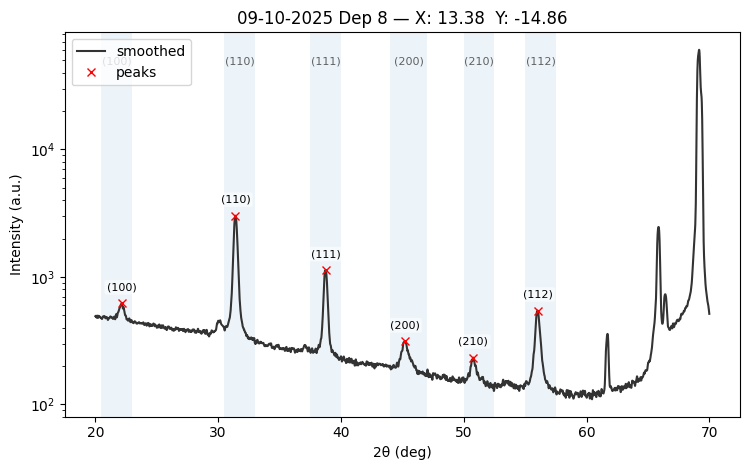


BTO_Mapping_Theta2Theta_09-10-2025_001_56_20-074_-22-294.xy  peaks: 6
  (100)    [R1]   22.140°   I≈604.1   FWHM≈1.0914°   Area≈99.60
  (110)    [R2]   31.420°   I≈2804.0   FWHM≈1.7400°   Area≈965.40
  (111)    [R3]   38.760°   I≈1212.0   FWHM≈1.3921°   Area≈371.65
  (200)    [R4]   45.260°   I≈289.2   FWHM≈1.4327°   Area≈88.54
  (210)    [R5]   50.730°   I≈223.6   FWHM≈1.3003°   Area≈44.80
  (112)    [R6]   55.990°   I≈552.6   FWHM≈1.6895°   Area≈231.65


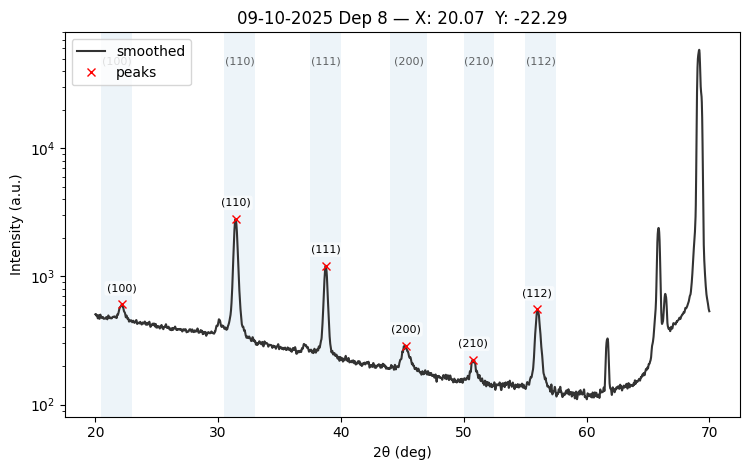


BTO_Mapping_Theta2Theta_09-10-2025_001_57_26-765_-29-726.xy  peaks: 6
  (100)    [R1]   22.130°   I≈597.1   FWHM≈1.0612°   Area≈97.37
  (110)    [R2]   31.440°   I≈2374.2   FWHM≈1.7291°   Area≈817.30
  (111)    [R3]   38.780°   I≈1169.1   FWHM≈1.3851°   Area≈352.72
  (200)    [R4]   45.270°   I≈279.6   FWHM≈1.3949°   Area≈82.79
  (210)    [R5]   50.820°   I≈220.5   FWHM≈1.2284°   Area≈51.41
  (112)    [R6]   56.020°   I≈544.9   FWHM≈1.6618°   Area≈232.21


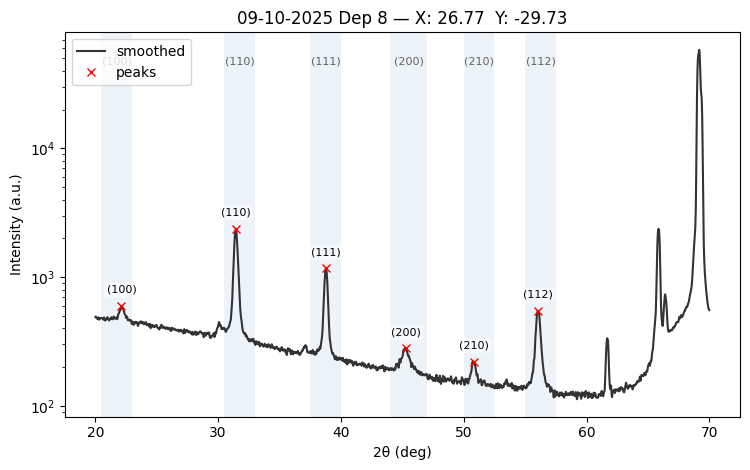


BTO_Mapping_Theta2Theta_09-10-2025_001_58_9-135_-4-067.xy  peaks: 6
  (100)    [R1]   22.090°   I≈627.9   FWHM≈1.1029°   Area≈118.06
  (110)    [R2]   31.400°   I≈3139.0   FWHM≈1.7570°   Area≈1112.57
  (111)    [R3]   38.760°   I≈1107.7   FWHM≈1.4238°   Area≈352.72
  (200)    [R4]   45.150°   I≈327.7   FWHM≈1.6366°   Area≈106.76
  (210)    [R5]   50.760°   I≈237.7   FWHM≈1.3492°   Area≈57.07
  (112)    [R6]   56.000°   I≈558.0   FWHM≈1.6998°   Area≈219.53


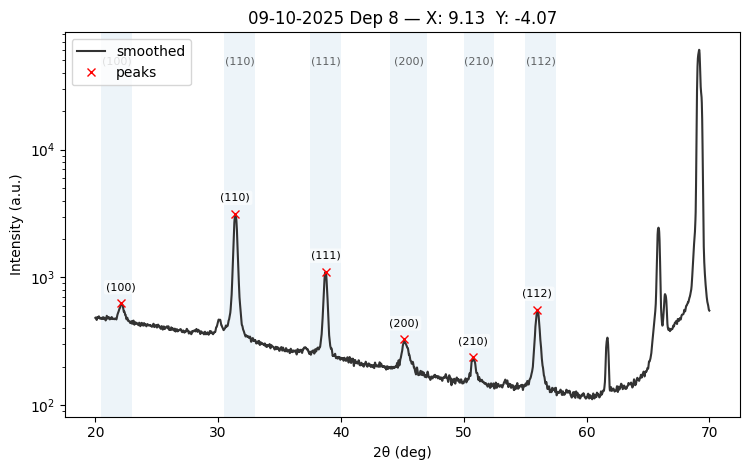


BTO_Mapping_Theta2Theta_09-10-2025_001_59_18-271_-8-135.xy  peaks: 6
  (100)    [R1]   22.060°   I≈600.3   FWHM≈1.0706°   Area≈108.70
  (110)    [R2]   31.410°   I≈2815.6   FWHM≈1.7501°   Area≈974.56
  (111)    [R3]   38.750°   I≈1081.2   FWHM≈1.4086°   Area≈349.61
  (200)    [R4]   45.380°   I≈289.6   FWHM≈1.4407°   Area≈104.12
  (210)    [R5]   50.820°   I≈229.1   FWHM≈1.2797°   Area≈65.51
  (112)    [R6]   56.010°   I≈565.2   FWHM≈1.6832°   Area≈217.56


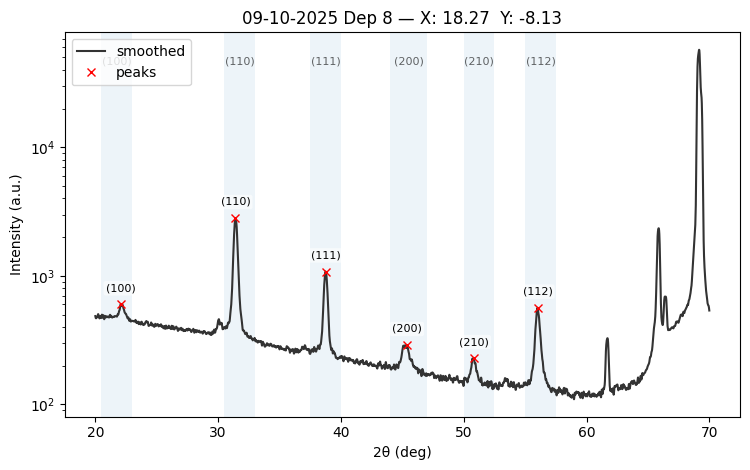


BTO_Mapping_Theta2Theta_09-10-2025_001_60_27-406_-12-202.xy  peaks: 6
  (100)    [R1]   22.140°   I≈590.3   FWHM≈1.0717°   Area≈103.08
  (110)    [R2]   31.430°   I≈2301.5   FWHM≈1.7425°   Area≈827.22
  (111)    [R3]   38.780°   I≈1109.6   FWHM≈1.3837°   Area≈345.36
  (200)    [R4]   45.150°   I≈282.7   FWHM≈1.3519°   Area≈89.81
  (210)    [R5]   50.750°   I≈222.6   FWHM≈1.2589°   Area≈49.26
  (112)    [R6]   56.040°   I≈577.8   FWHM≈1.6525°   Area≈218.40


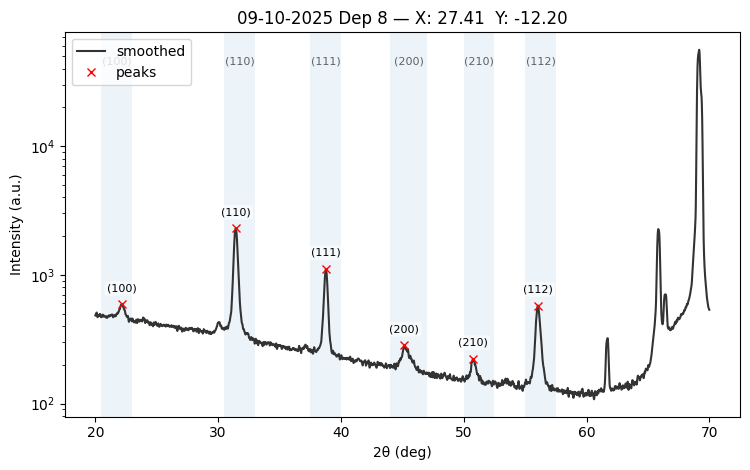


BTO_Mapping_Theta2Theta_09-10-2025_001_61_36-542_-16-269.xy  peaks: 6
  (100)    [R1]   22.130°   I≈597.5   FWHM≈1.0302°   Area≈87.26
  (110)    [R2]   31.440°   I≈1779.1   FWHM≈1.7310°   Area≈610.89
  (111)    [R3]   38.790°   I≈1061.9   FWHM≈1.3717°   Area≈325.53
  (200)    [R4]   45.110°   I≈274.9   FWHM≈1.3820°   Area≈89.19
  (210)    [R5]   50.760°   I≈207.1   FWHM≈1.2123°   Area≈44.97
  (112)    [R6]   56.040°   I≈595.5   FWHM≈1.6403°   Area≈234.27


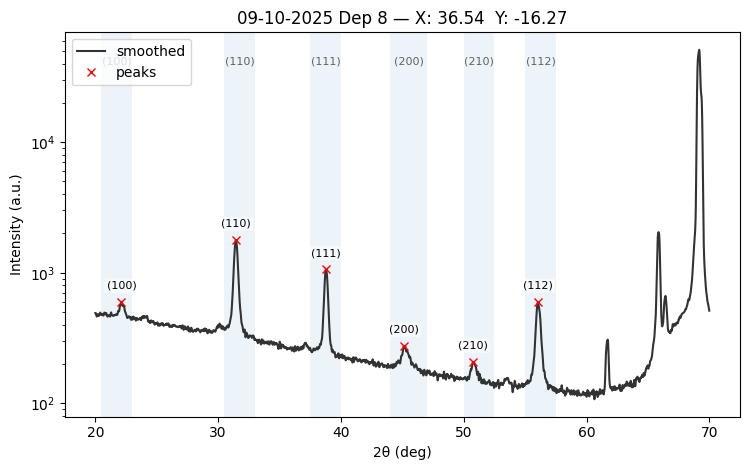

In [14]:
# Create individual plots with peak detection for each deposition
for dep_name in DEPOSITIONS:
    if dep_name not in all_deposition_results:
        continue
    
    print(f"\n{'='*80}")
    print(f"Individual plots for: {dep_name}")
    print(f"{'='*80}")
    
    dep_folder = os.path.join(BASE_DIR, dep_name)
    xy_data_folder = os.path.join(dep_folder, "XY Data")
    os.chdir(xy_data_folder)
    
    files = all_deposition_results[dep_name]['files']
    file_results = all_deposition_results[dep_name]['file_results']
    
    # Process each file and create individual plot
    for fp, file_res in zip(files, file_results):
        data = np.loadtxt(fp)
        x, y = data[:,0], data[:,1]
        step = float(np.mean(np.diff(x)))
        
        # Smooth
        w_use, p_use = _safe_window(len(x), window_pts, polyorder)
        ys = savgol_filter(y, w_use, p_use, mode="interp") if w_use is not None else y.copy()
        
        distance = max(1, int(min_sep_deg/step))
        width_s = (max(1, int(width_deg[0]/step)), max(2, int(width_deg[1]/step)))
        
        all_peaks_idx = []
        all_fwhm_deg = []
        all_area = []
        all_region_id = []
        all_Ipk = []
        all_labels = []
        
        per_region_count = {i: 0 for i in range(1, len(REGIONS)+1)}
        
        for rid, (lo, hi) in enumerate(REGIONS, start=1):
            m = (x >= lo) & (x <= hi)
            if np.count_nonzero(m) < 7:
                continue
            
            xr = x[m]
            yr = ys[m]
            idx0 = np.nonzero(m)[0][0]
            
            cand_r, prop = find_peaks(yr, distance=distance, width=width_s)
            if cand_r.size == 0:
                continue
            
            keep_r = []
            for i, pk in enumerate(cand_r):
                lb = prop["left_bases"][i]
                rb = prop["right_bases"][i]
                base = max(yr[lb], yr[rb])
                amp = yr[pk] - base
                if amp <= 0: continue
                if yr[pk] / max(base, 1e-9) < ratio_min: continue
                if amp < frac_min * base: continue
                keep_r.append(i)
            
            if not keep_r:
                continue
            
            peaks_r = cand_r[keep_r]
            widths, w_left, w_right, _ = peak_widths(yr, peaks_r, rel_height=0.5)
            
            idx_axis = np.arange(len(xr), dtype=float)
            left_x = np.interp(w_left, idx_axis, xr)
            right_x = np.interp(w_right, idx_axis, xr)
            fwhm_deg = np.abs(right_x - left_x)
            
            for j, pk in enumerate(peaks_r):
                lb = prop["left_bases"][keep_r[j]]
                rb = prop["right_bases"][keep_r[j]]
                
                x_lb, y_lb = xr[lb], yr[lb]
                x_rb, y_rb = xr[rb], yr[rb]
                
                lx, rx = x_lb, x_rb
                if lx >= rx:
                    lx = left_x[j]
                    rx = right_x[j]
                
                seg_mask = (xr >= lx) & (xr <= rx)
                if np.count_nonzero(seg_mask) < 2:
                    k0 = max(0, pk - 3)
                    k1 = min(len(xr), pk + 4)
                    seg_mask = np.zeros_like(xr, dtype=bool)
                    seg_mask[k0:k1] = True
                
                xs = xr[seg_mask]
                ys_seg = yr[seg_mask]
                
                if x_rb != x_lb:
                    slope = (y_rb - y_lb) / (x_rb - x_lb)
                    y_base = y_lb + slope * (xs - x_lb)
                else:
                    y_base = np.full_like(xs, np.mean([y_lb, y_rb]))
                
                area = np.trapz(np.maximum(ys_seg - y_base, 0.0), xs)
                
                if area == 0.0 or not np.isfinite(area):
                    peak_height = yr[pk] - np.mean([y_lb, y_rb])
                    area = peak_height * fwhm_deg[j] * 0.5 * np.sqrt(np.pi / np.log(2))
                
                gi = idx0 + pk
                all_peaks_idx.append(gi)
                all_fwhm_deg.append(float(fwhm_deg[j]))
                all_area.append(float(area))
                all_region_id.append(rid)
                all_Ipk.append(float(yr[pk]))
                
                # Name the peak
                base_name = REGION_NAMES[rid-1] if rid-1 < len(REGION_NAMES) else f"R{rid}"
                per_region_count[rid] += 1
                label = base_name if per_region_count[rid] == 1 else f"{base_name}-{per_region_count[rid]}"
                all_labels.append(label)
        
        # Print peak info
        print(f"\n{os.path.basename(fp)}  peaks: {len(all_peaks_idx)}")
        for lbl, rid, gi, Ipk, fwhm, area in zip(all_labels, all_region_id, all_peaks_idx, all_Ipk, all_fwhm_deg, all_area):
            print(f"  {lbl:8s} [R{rid}]  {x[gi]:7.3f}°   I≈{Ipk:.1f}   FWHM≈{fwhm:.4f}°   Area≈{area:.2f}")
        
        # Plot
        plt.figure(figsize=(7.6, 4.8))
        plt.plot(x, ys, label="smoothed", color="0.2")
        
        # Annotate peaks
        if all_peaks_idx:
            p_x = x[np.array(all_peaks_idx)]
            p_y = np.array(all_Ipk)
            plt.plot(p_x, p_y, "rx", label="peaks")
            for (xx, yy, lbl) in zip(p_x, p_y, all_labels):
                plt.annotate(lbl, (xx, yy), xytext=(0, 8), textcoords="offset points",
                             ha="center", va="bottom", fontsize=8, rotation=0,
                             bbox=dict(boxstyle="round,pad=0.2", fc="white", ec="none", alpha=0.6))
        
        # Draw region spans
        for (lo, hi), nm in zip(REGIONS, REGION_NAMES):
            plt.axvspan(lo, hi, alpha=0.08)
            mid = 0.5*(lo+hi)
            plt.text(mid, plt.ylim()[1]*0.85, nm, ha="center", va="top", fontsize=8, alpha=0.6)
        
        # Extract coordinates for title
        x_val, y_val = extract_xy_from_filename(fp)
        if x_val is not None and y_val is not None:
            title_text = f"{dep_name} — X: {x_val:.2f}  Y: {y_val:.2f}"
        else:
            title_text = f"{dep_name} — {os.path.basename(fp)}"
        
        plt.title(title_text)
        plt.xlabel("2θ (deg)")
        plt.ylabel("Intensity (a.u.)")
        plt.yscale("log")
        plt.legend()
        plt.tight_layout()
        plt.show()

## Contour Maps - All FWHM


Creating FWHM contour maps for 30-09-2025 Dep 1


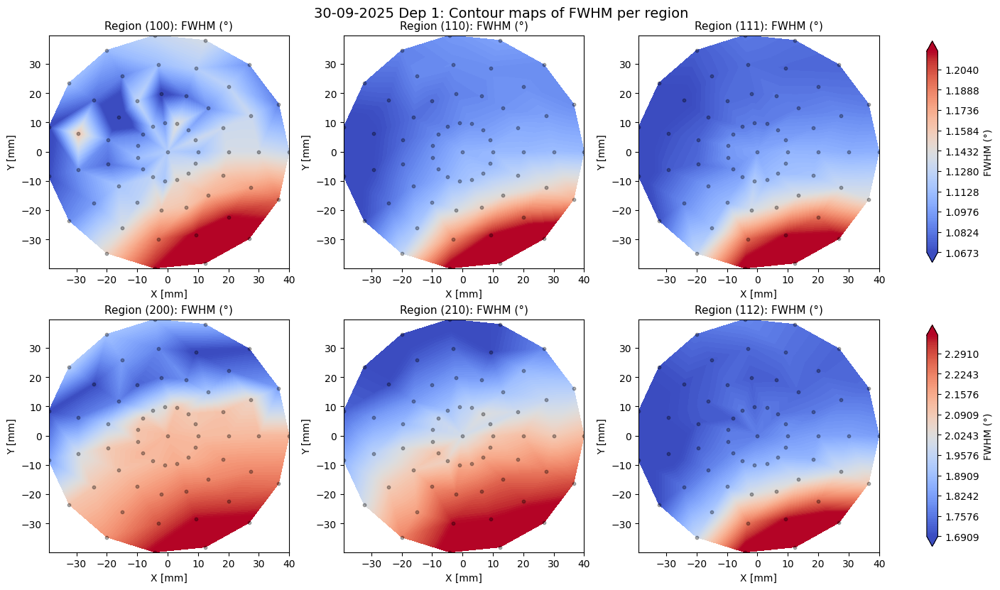


Creating FWHM contour maps for 22-09-2025 Dep 2


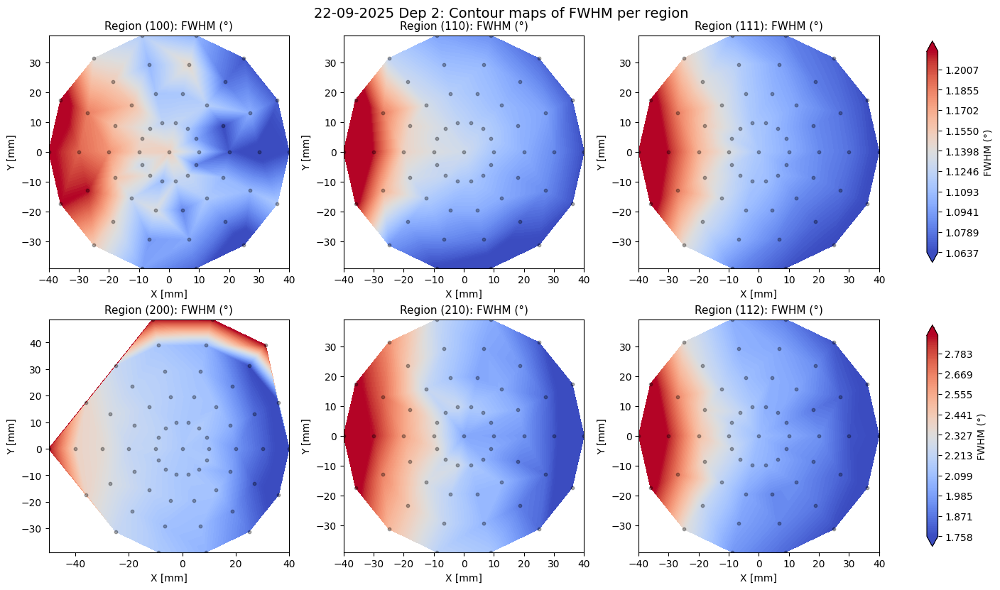


Creating FWHM contour maps for 24-09-2025 Dep 3


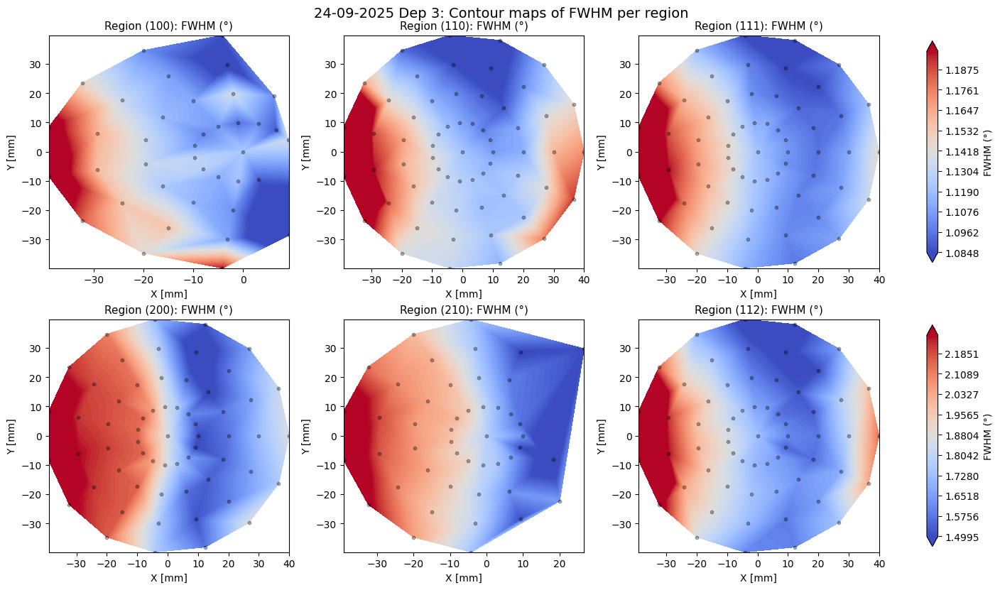


Creating FWHM contour maps for 07-10-2025 Dep 6


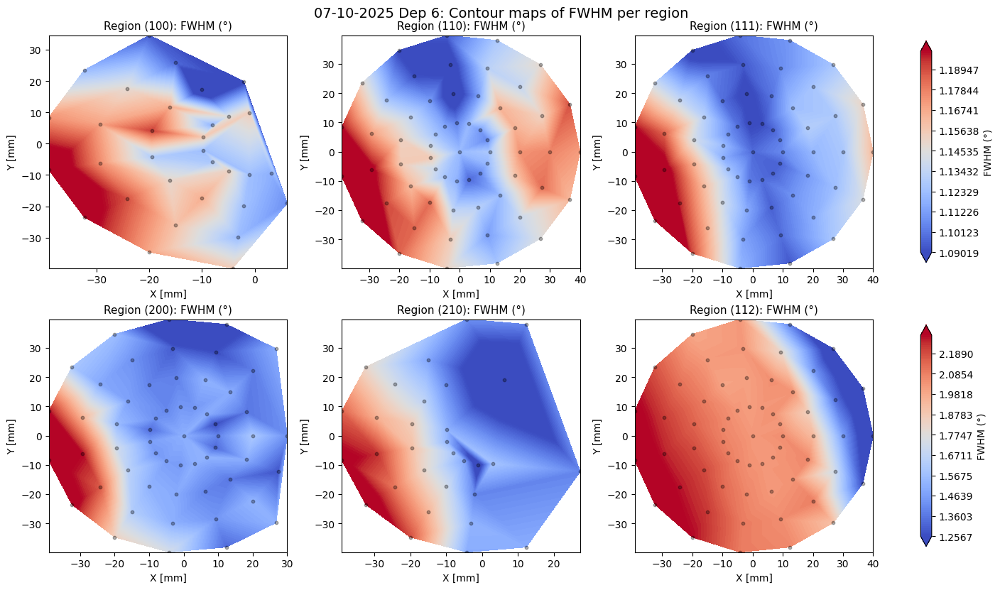


Creating FWHM contour maps for 08-10-2025 Dep 7


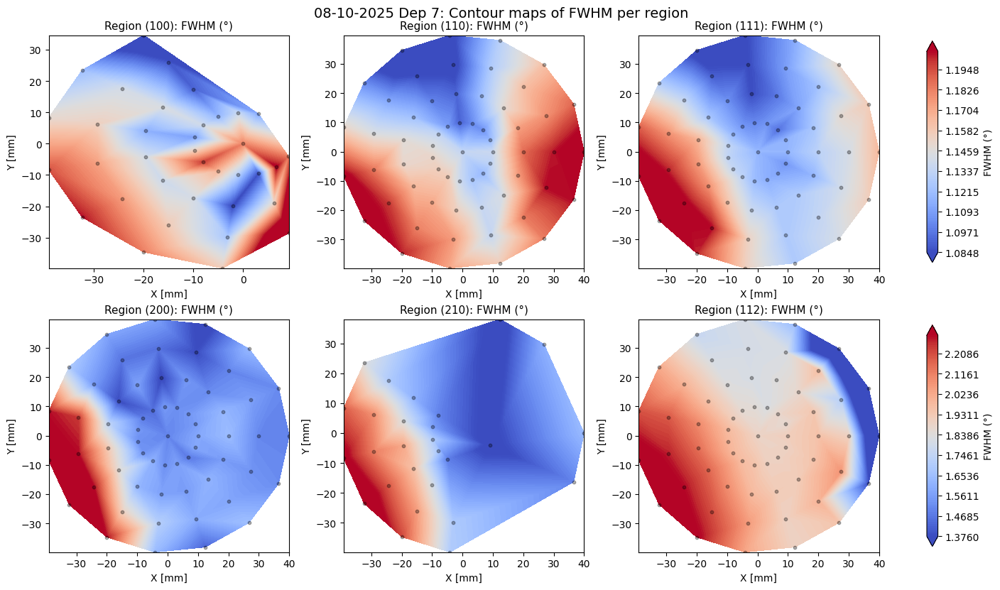


Creating FWHM contour maps for 09-10-2025 Dep 8


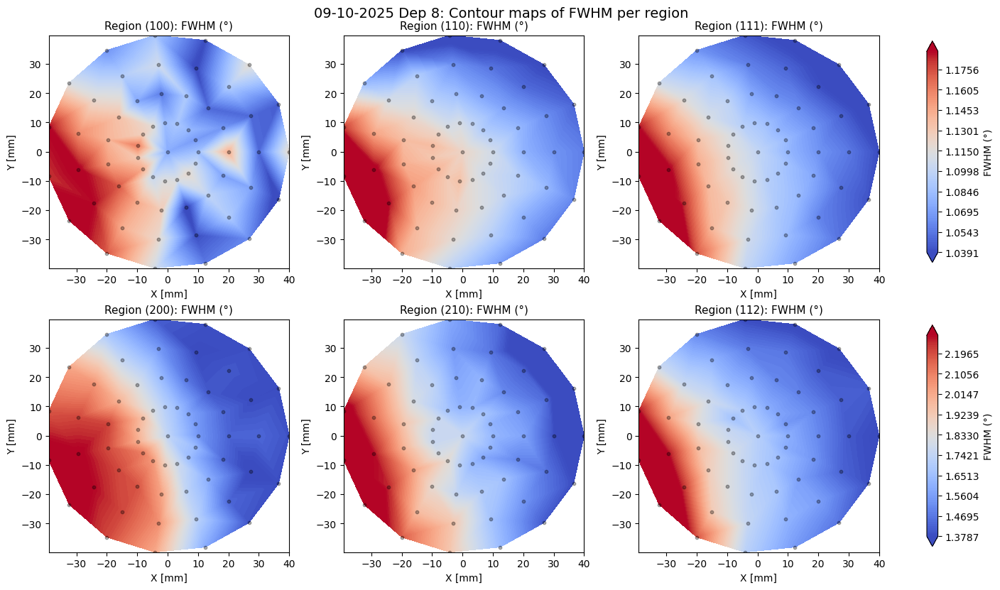

In [15]:
# Helper functions for contour plotting
def _unique_xy(x, y, z):
    arr = np.column_stack([x, y, z])
    keys = np.ascontiguousarray(arr[:, :2]).view(
        np.dtype((np.void, arr[:, :2].dtype.itemsize * 2))
    ).ravel()
    _, idx = np.unique(keys, return_index=True)
    idx = np.sort(idx)
    return arr[idx, 0], arr[idx, 1], arr[idx, 2]

def _contour_one(ax, xs, ys, zs, title, nlevels=100, cmap="coolwarm", try_grid_fallback=True):
    m = np.isfinite(xs) & np.isfinite(ys) & np.isfinite(zs)
    xs, ys, zs = xs[m], ys[m], zs[m]
    if len(xs) == 0:
        ax.text(0.5, 0.5, "No data", ha='center', va='center', transform=ax.transAxes)
        ax.set_axis_off()
        return None

    xs, ys, zs = _unique_xy(xs, ys, zs)
    if len(xs) < 3:
        ax.text(0.5, 0.5, "Too few points", ha='center', va='center', transform=ax.transAxes)
        ax.set_axis_off()
        return None

    # Robust color limits
    vmin = np.nanpercentile(zs, 5)
    vmax = np.nanpercentile(zs, 95)
    if not np.isfinite(vmin) or not np.isfinite(vmax) or vmin == vmax:
        vmin, vmax = float(np.nanmin(zs)), float(np.nanmax(zs))
        if not np.isfinite(vmin) or vmin == vmax:
            ax.text(0.5, 0.5, "No variation", ha='center', va='center', transform=ax.transAxes)
            ax.set_axis_off()
            return None

    # Triangulation or grid fallback
    try:
        tri = Triangulation(xs, ys)
        cf = ax.tricontourf(tri, zs, levels=np.linspace(vmin, vmax, nlevels),
                            extend='both', cmap=cmap)
    except Exception:
        if not try_grid_fallback:
            ax.text(0.5, 0.5, "Triangulation failed", ha='center', va='center', transform=ax.transAxes)
            ax.set_axis_off()
            return None

        gx = np.linspace(xs.min(), xs.max(), 60)
        gy = np.linspace(ys.min(), ys.max(), 60)
        GX, GY = np.meshgrid(gx, gy)
        GZ = griddata((xs, ys), zs, (GX, GY), method='linear')
        if np.isnan(GZ).all():
            GZ = griddata((xs, ys), zs, (GX, GY), method='nearest')
        if np.isnan(GZ).all():
            ax.text(0.5, 0.5, "Insufficient geometry", ha='center', va='center', transform=ax.transAxes)
            ax.set_axis_off()
            return None

        cf = ax.contourf(GX, GY, GZ, levels=np.linspace(vmin, vmax, nlevels),
                         extend='both', cmap=cmap)

    ax.scatter(xs, ys, s=10, c='k', alpha=0.3)
    ax.set_title(title, fontsize=11)
    ax.set_xlabel("X [mm]")
    ax.set_ylabel("Y [mm]")
    return cf

# Normalize data into shape (N, 6)
def normalize_six(arr, N):
    a = np.asarray(arr)
    if a.ndim == 2 and a.shape == (N, 6):
        return a
    if a.ndim == 1 and a.size == N * 6:
        return a.reshape(N, 6)
    if a.ndim == 2 and a.shape[0] == N * 6 and a.shape[1] == 6:
        blocks = np.split(a, 6, axis=0)
        return np.column_stack([blocks[j][:, j] for j in range(6)])
    if a.ndim == 2 and a.shape == (N * 6, 1):
        return a.reshape(N, 6)
    raise ValueError(f"Cannot reshape array with shape {a.shape} to (N,6).")

# Create FWHM contour maps for all depositions
for dep_name in DEPOSITIONS:
    if dep_name not in all_deposition_results:
        continue
    
    print(f"\nCreating FWHM contour maps for {dep_name}")
    
    x_pos = all_deposition_results[dep_name]['x_coordinates']
    y_pos = all_deposition_results[dep_name]['y_coordinates']
    fwhm = all_deposition_results[dep_name]['fwhm']
    N = x_pos.size
    
    fwhm = normalize_six(fwhm, N)
    
    titles = [f"Region {REGION_NAMES[i]}" for i in range(6)]
    fig, axes = plt.subplots(2, 3, figsize=(14, 8), constrained_layout=True)
    cfs = []
    for i in range(6):
        r, c = divmod(i, 3)
        cf = _contour_one(axes[r, c], x_pos, y_pos, fwhm[:, i],
                          title=f"{titles[i]}: FWHM (°)", cmap="coolwarm")
        cfs.append(cf)
    
    # Row-wise colorbars
    for r in range(2):
        row = [cfs[r*3 + j] for j in range(3) if cfs[r*3 + j] is not None]
        if row:
            fig.colorbar(row[0], ax=axes[r, :], shrink=0.95, label="FWHM (°)")
    
    plt.suptitle(f"{dep_name}: Contour maps of FWHM per region", y=1.02, fontsize=14)
    plt.show()

## Contour Maps - All Peak Intensity


Creating Peak Intensity contour maps for 30-09-2025 Dep 1


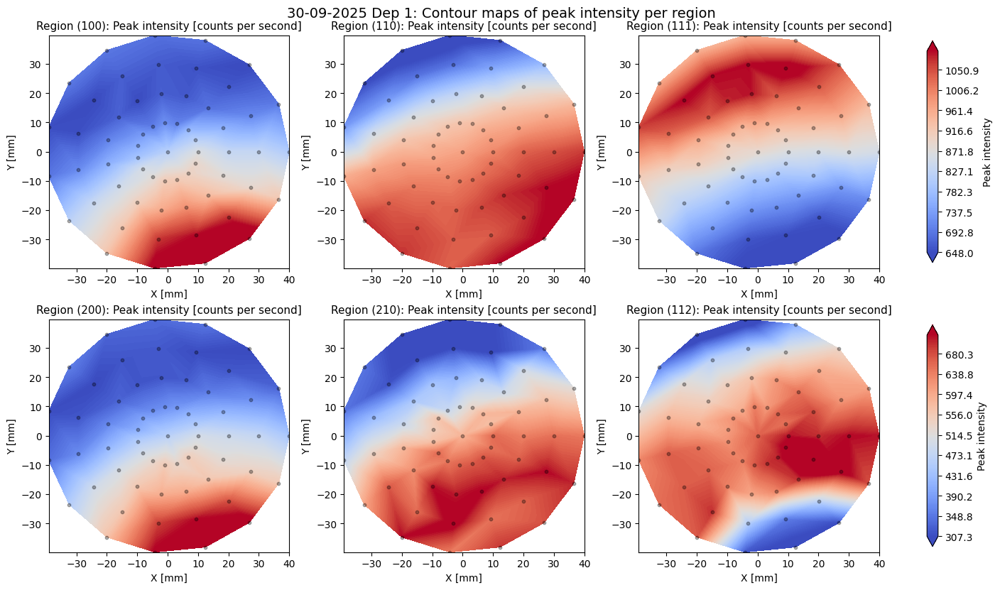


Creating Peak Intensity contour maps for 22-09-2025 Dep 2


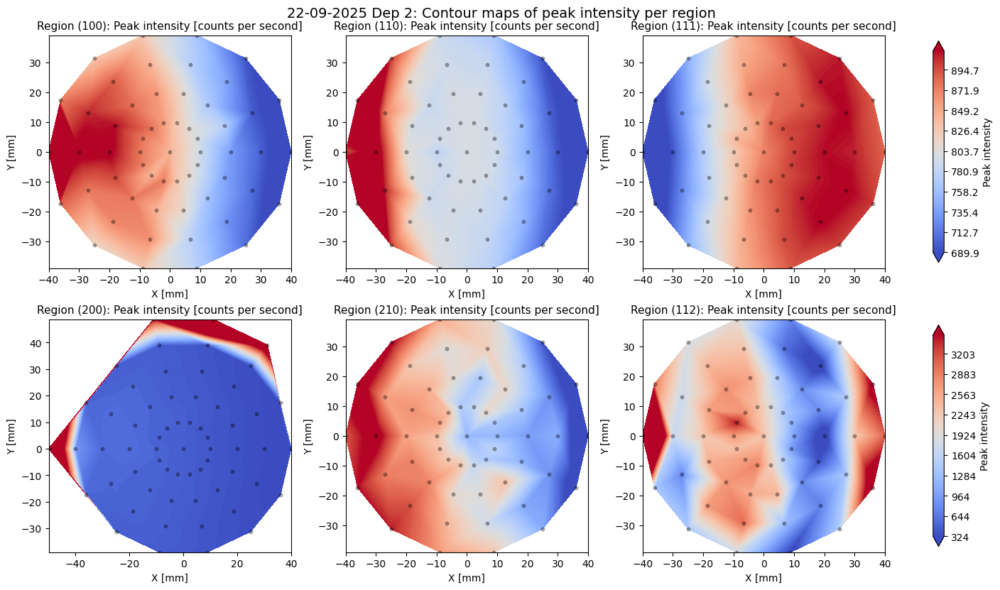


Creating Peak Intensity contour maps for 24-09-2025 Dep 3


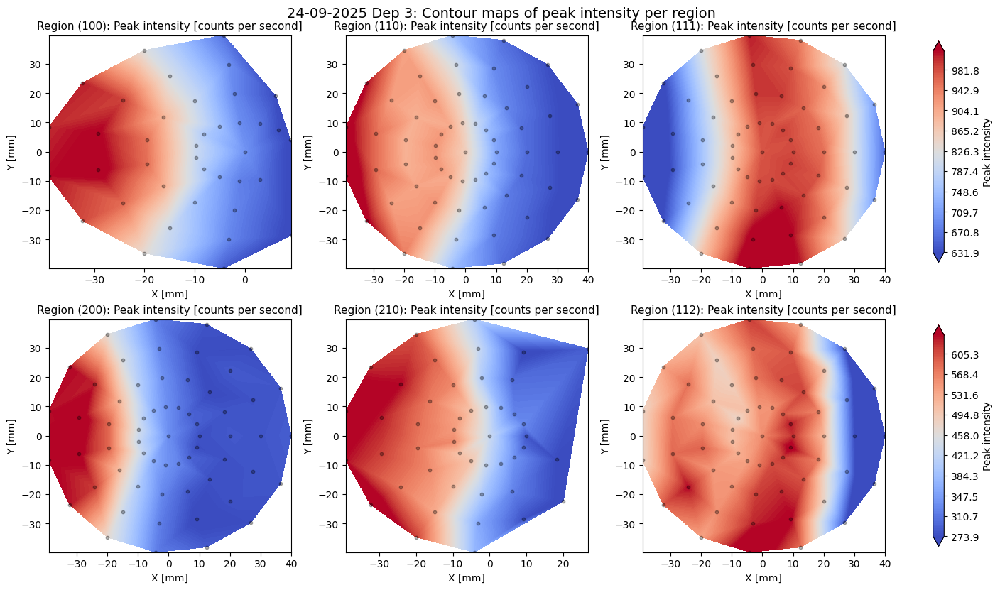


Creating Peak Intensity contour maps for 07-10-2025 Dep 6


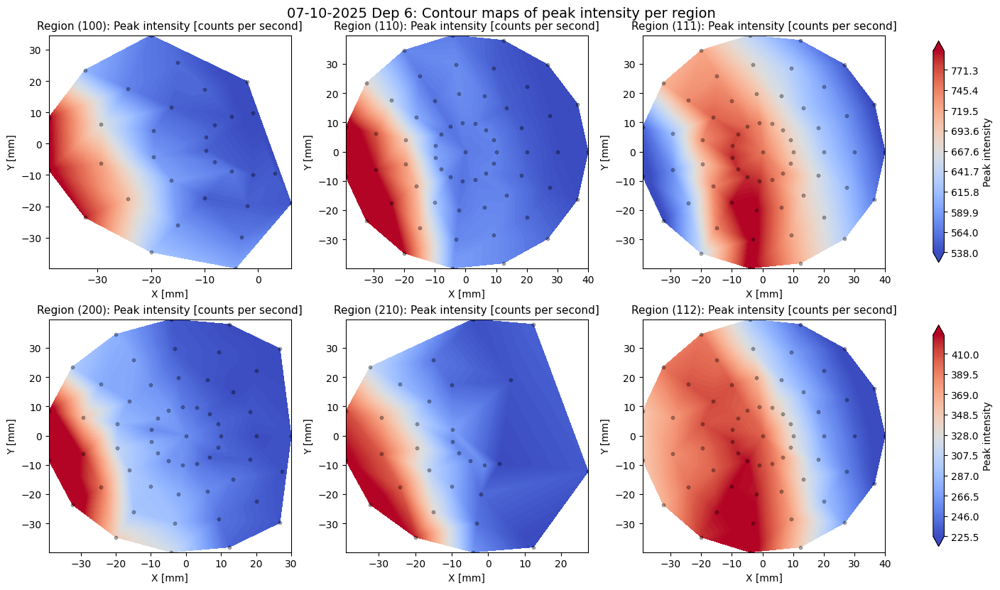


Creating Peak Intensity contour maps for 08-10-2025 Dep 7


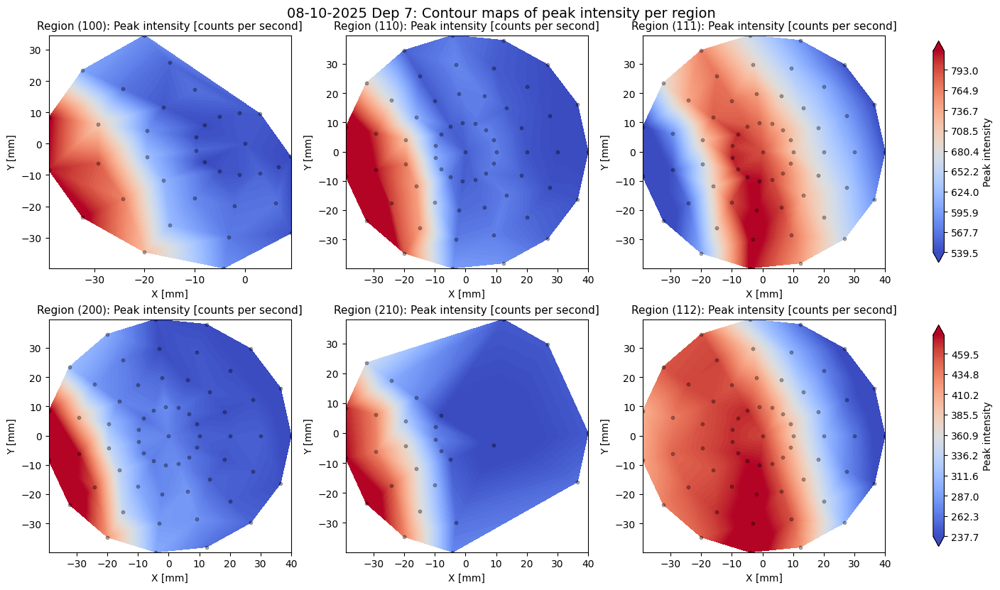


Creating Peak Intensity contour maps for 09-10-2025 Dep 8


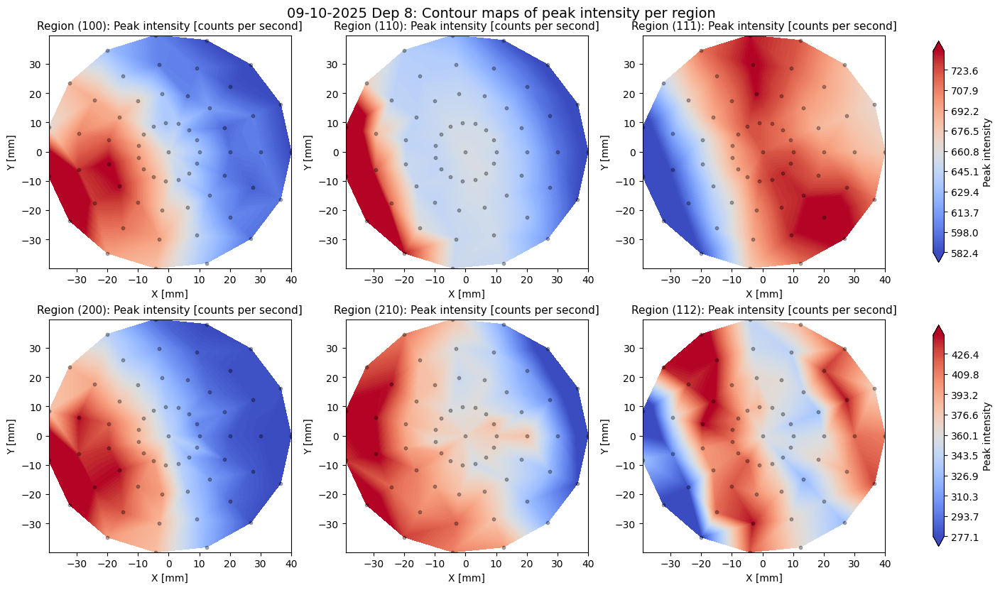

In [16]:
# Create Peak Intensity contour maps for all depositions
for dep_name in DEPOSITIONS:
    if dep_name not in all_deposition_results:
        continue
    
    print(f"\nCreating Peak Intensity contour maps for {dep_name}")
    
    x_pos = all_deposition_results[dep_name]['x_coordinates']
    y_pos = all_deposition_results[dep_name]['y_coordinates']
    peakI = all_deposition_results[dep_name]['peak_intensity']
    N = x_pos.size
    
    peakI = normalize_six(peakI, N)
    
    titles = [f"Region {REGION_NAMES[i]}" for i in range(6)]
    fig, axes = plt.subplots(2, 3, figsize=(14, 8), constrained_layout=True)
    cfs = []
    for i in range(6):
        r, c = divmod(i, 3)
        cf = _contour_one(axes[r, c], x_pos, y_pos, peakI[:, i],
                          title=f"{titles[i]}: Peak intensity [counts per second]",
                          cmap="coolwarm", nlevels=120)
        cfs.append(cf)
    
    # Row-wise colorbars
    for r in range(2):
        row = [cfs[r*3 + j] for j in range(3) if cfs[r*3 + j] is not None]
        if row:
            fig.colorbar(row[0], ax=axes[r, :], shrink=0.95, label="Peak intensity")
    
    plt.suptitle(f"{dep_name}: Contour maps of peak intensity per region", y=1.02, fontsize=14)
    plt.show()

## Contour Maps - (100) and (110) Planes: FWHM, Peak Intensity, Integrated Area and Ratio


Creating (100) and (110) contour maps for 30-09-2025 Dep 1


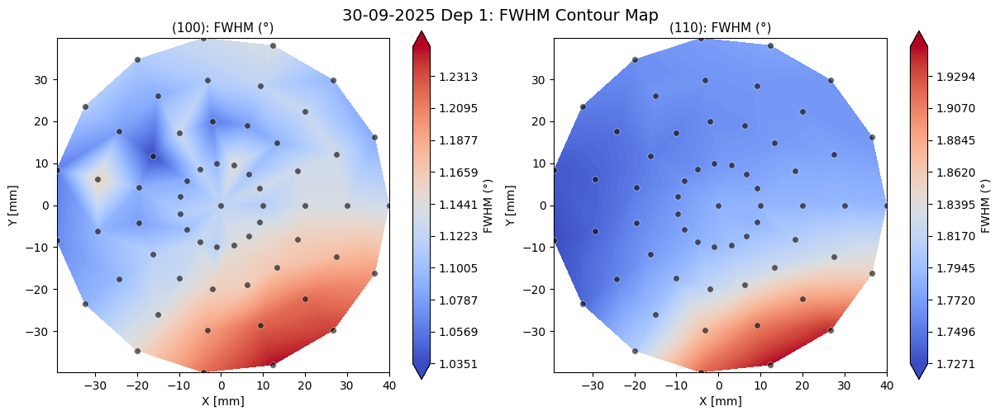

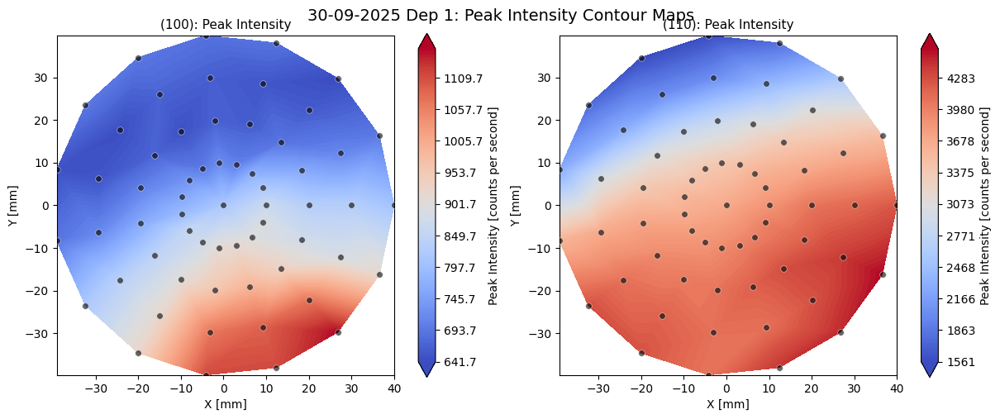

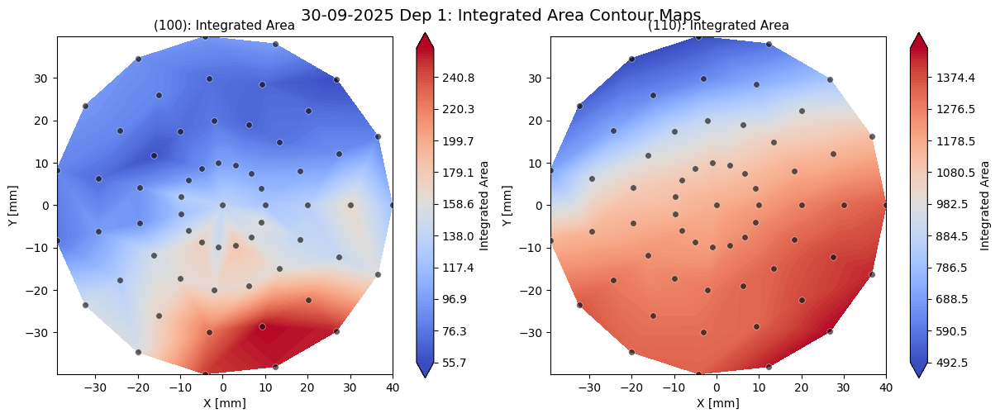

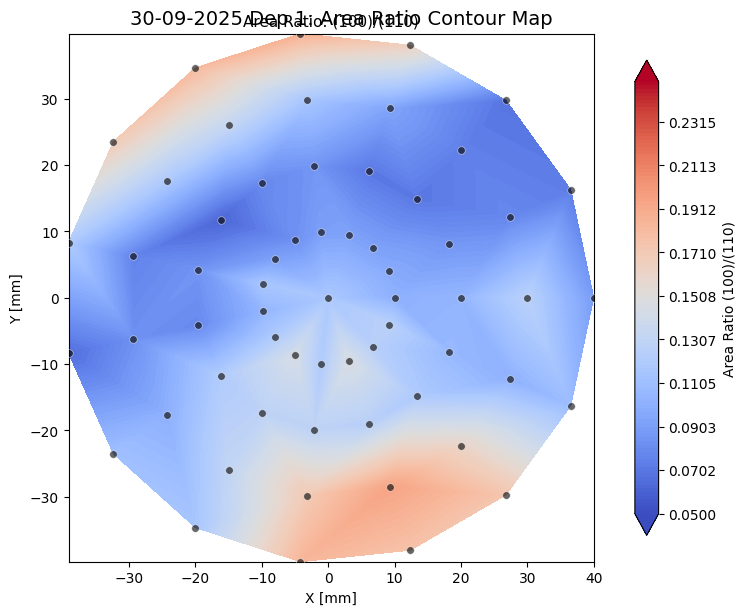


Creating (100) and (110) contour maps for 22-09-2025 Dep 2


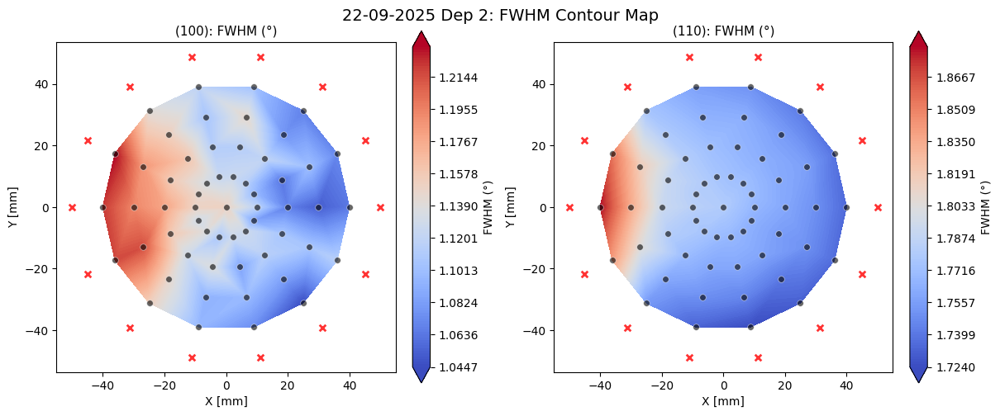

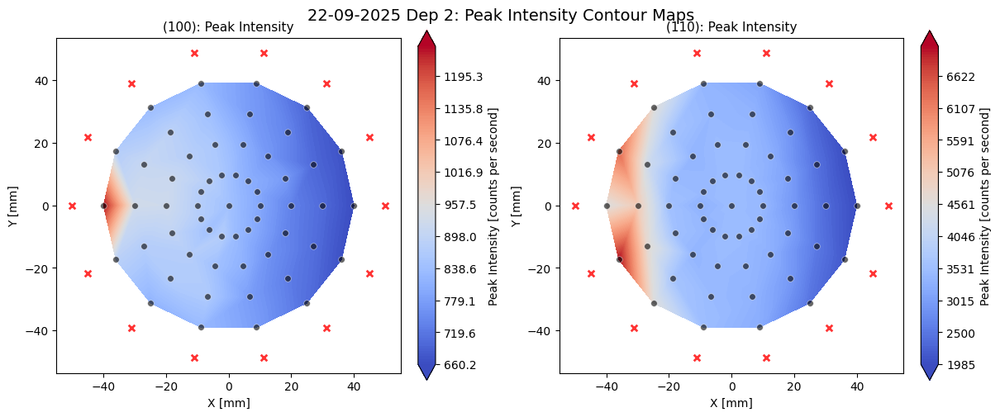

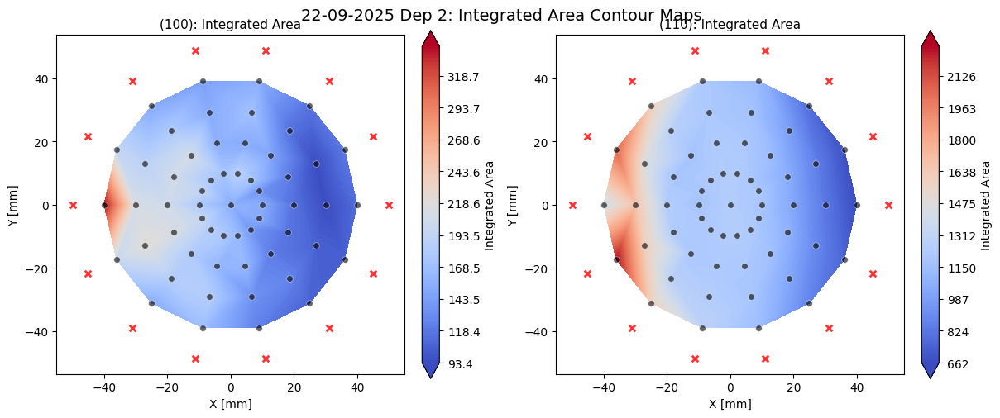

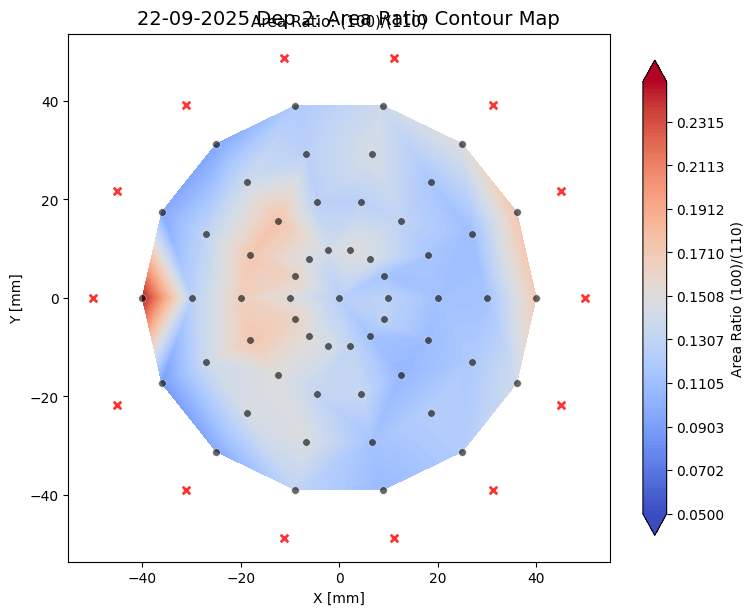


Creating (100) and (110) contour maps for 24-09-2025 Dep 3


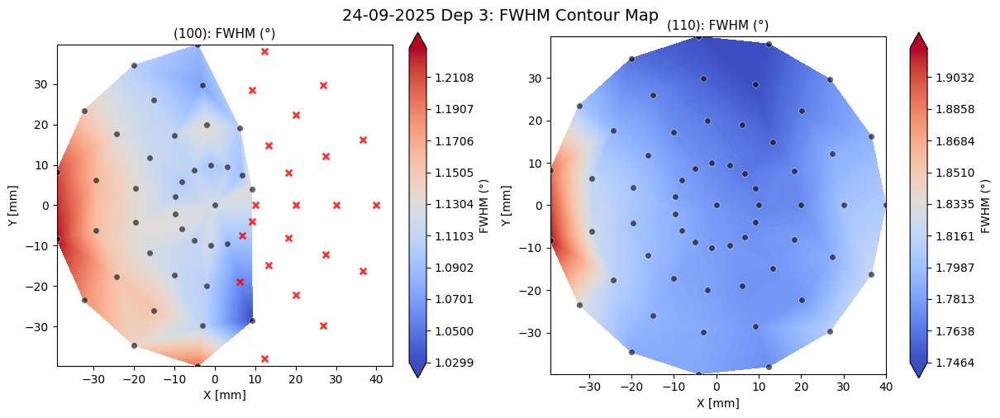

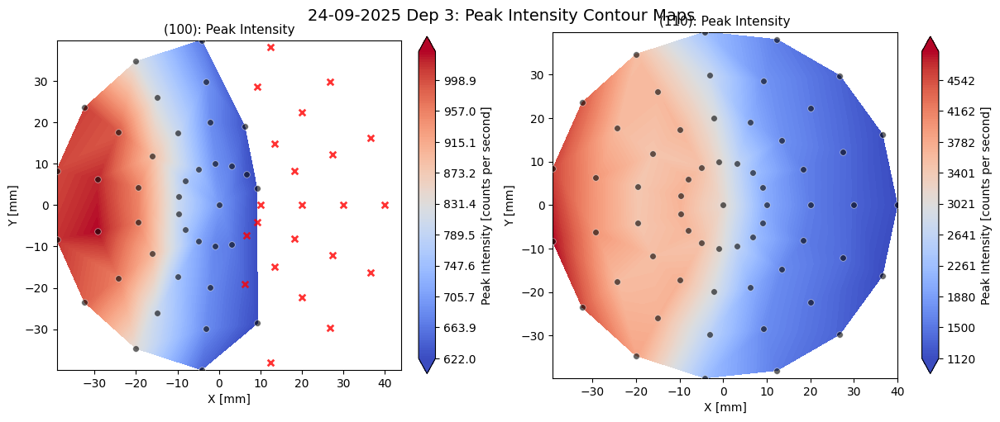

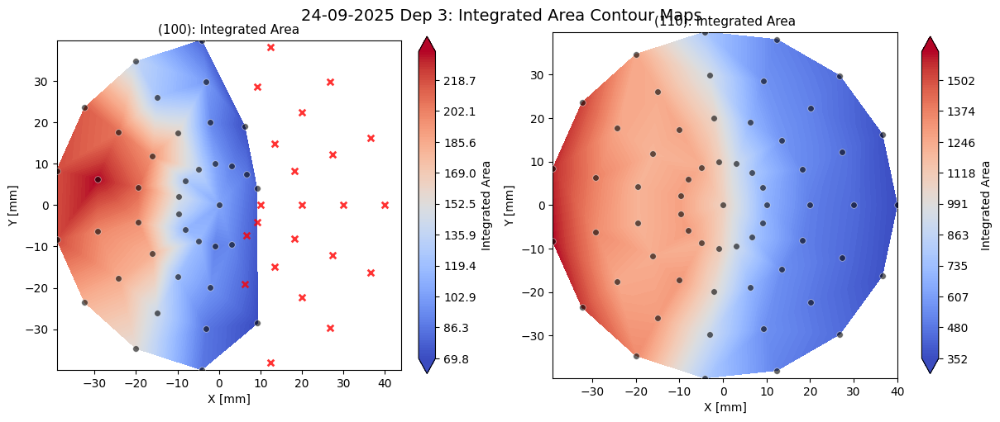

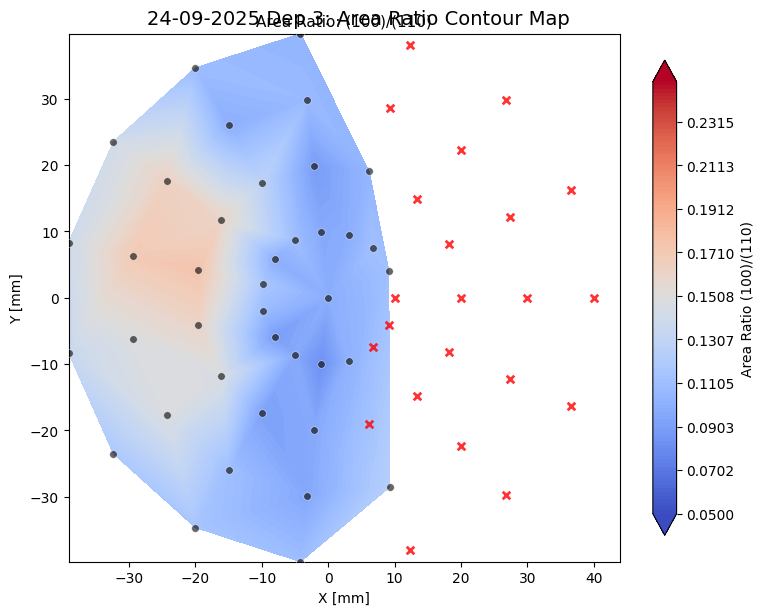


Creating (100) and (110) contour maps for 07-10-2025 Dep 6


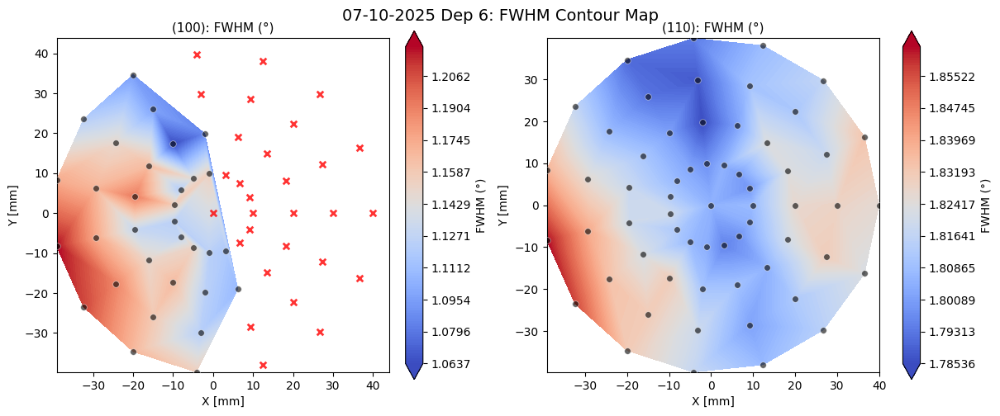

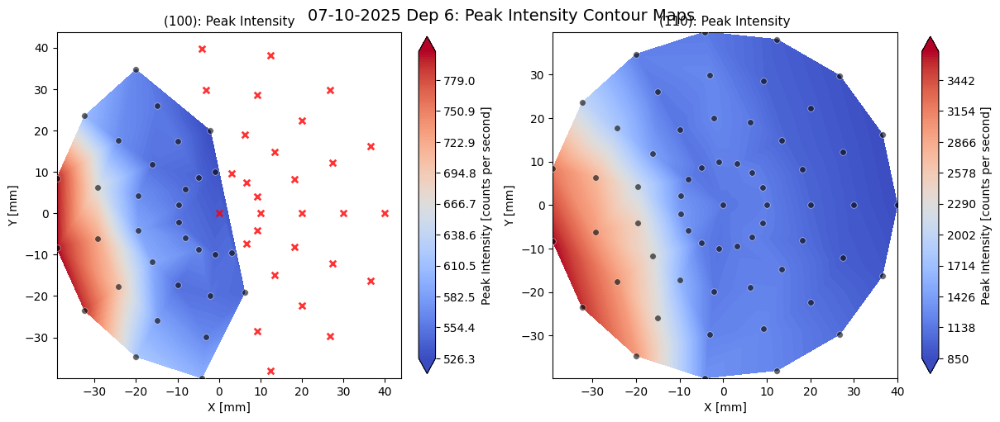

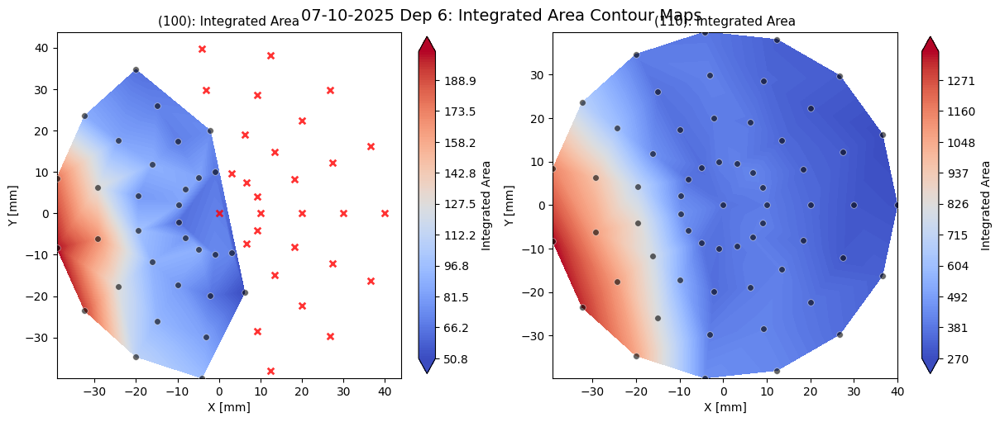

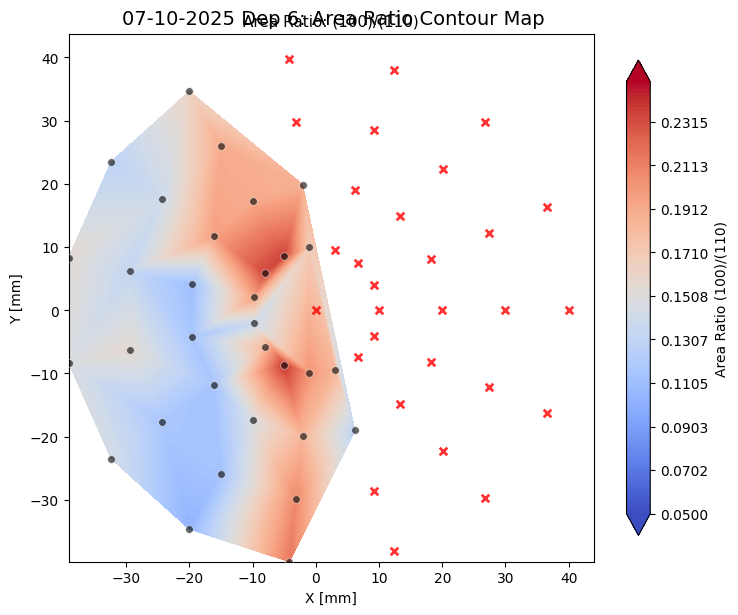


Creating (100) and (110) contour maps for 08-10-2025 Dep 7


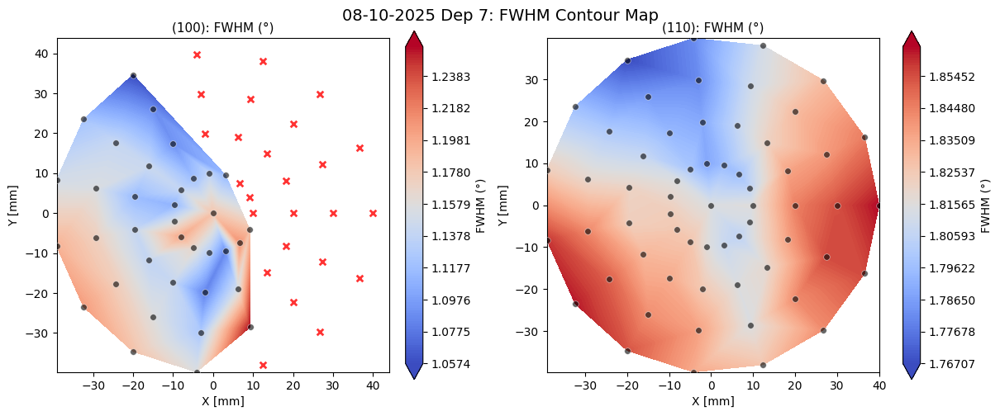

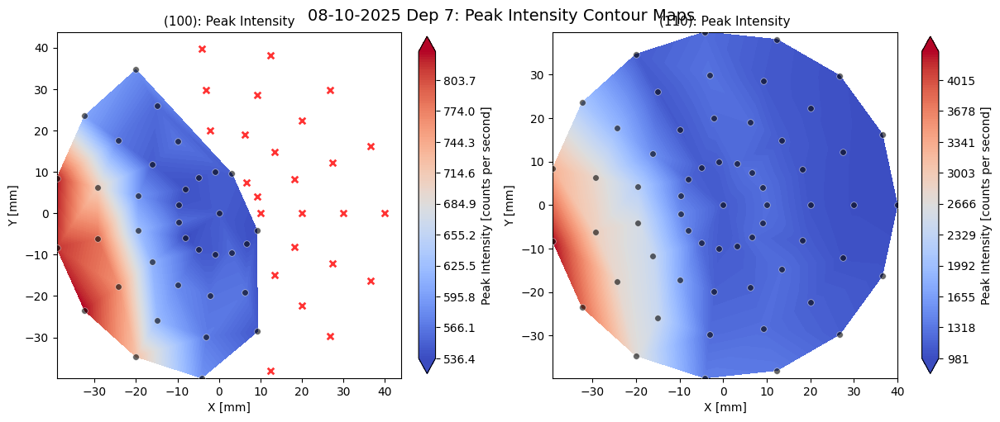

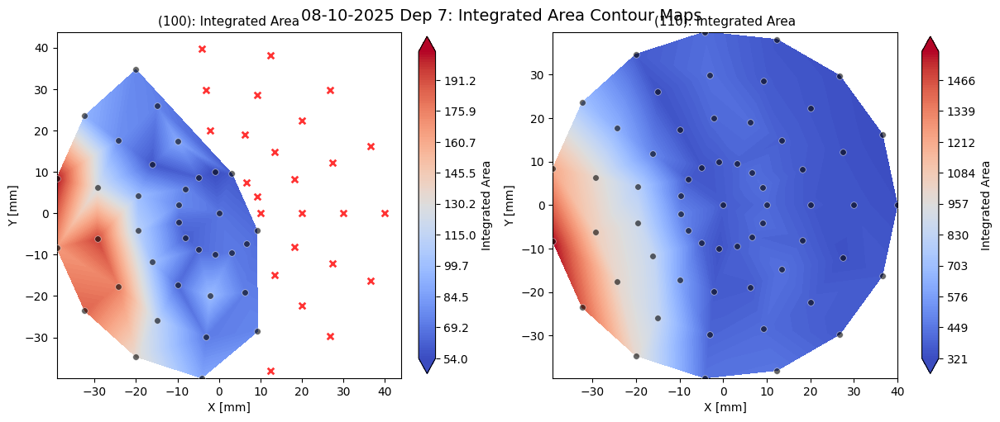

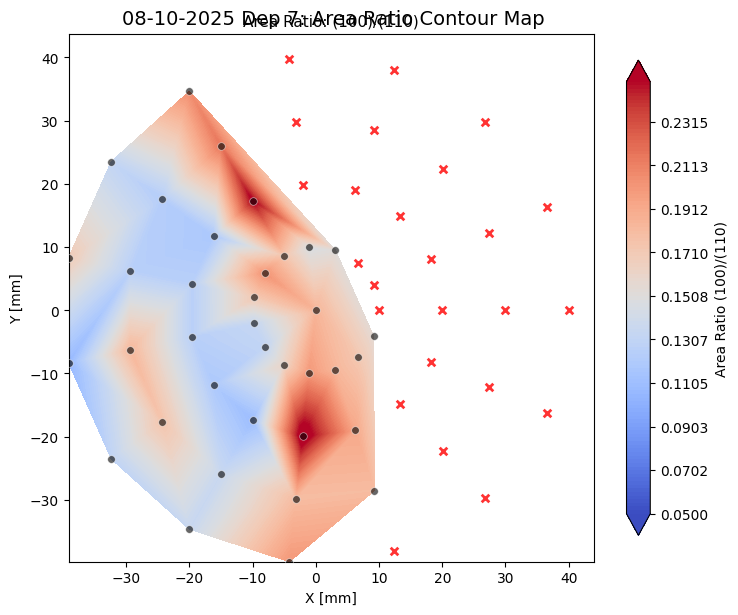


Creating (100) and (110) contour maps for 09-10-2025 Dep 8


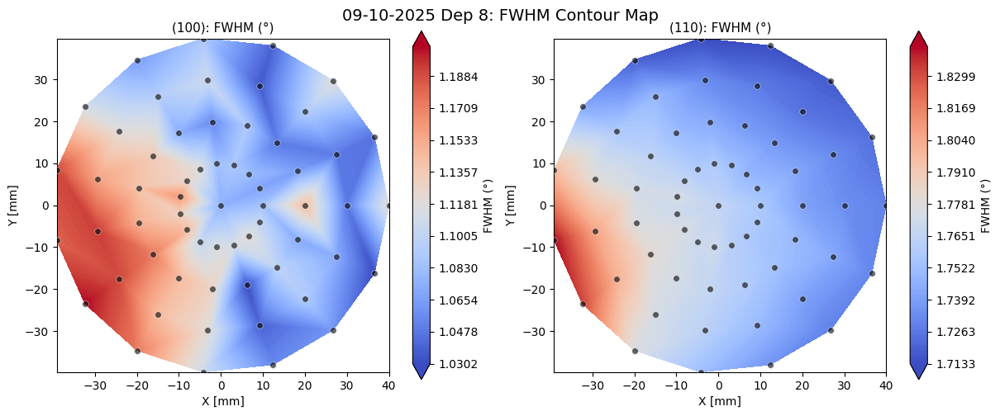

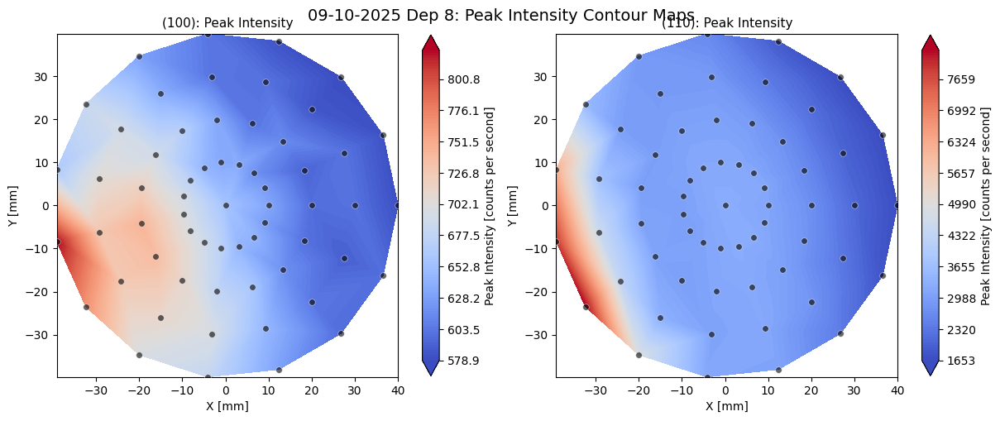

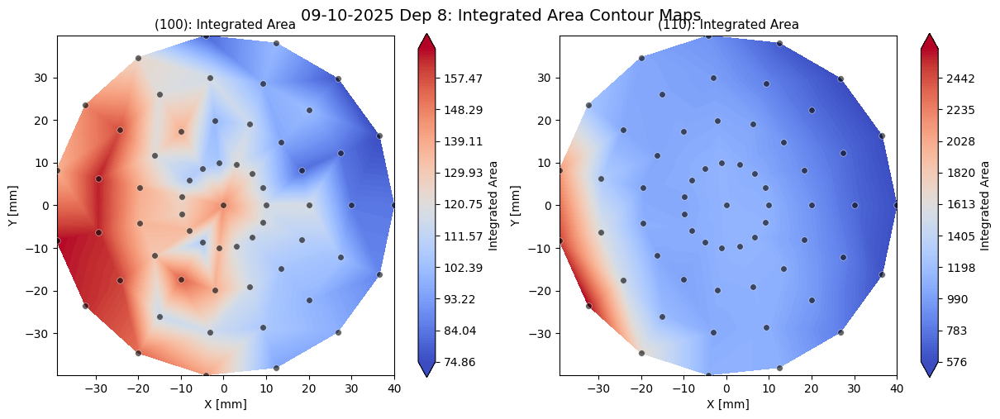

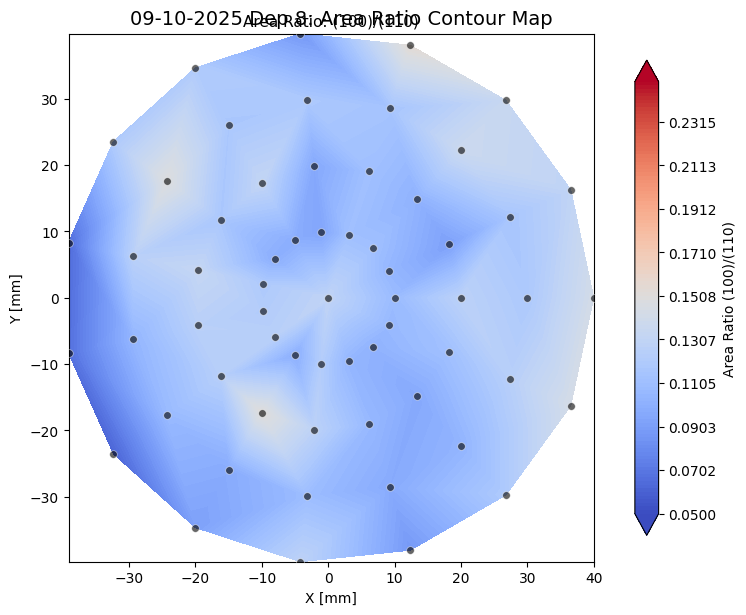

In [17]:
# Helper function for contour with custom levels
def _robust_minmax(zs):
    vmin = np.nanpercentile(zs, 5)
    vmax = np.nanpercentile(zs, 95)
    if not np.isfinite(vmin) or not np.isfinite(vmax) or vmin == vmax:
        vmin = float(np.nanmin(zs))
        vmax = float(np.nanmax(zs))
    return vmin, vmax

def _contour_one_custom(ax, xs_all, ys_all, zs_all, title, nlevels=100, cmap="coolwarm", levels=None):
    """Create smooth contour plot using triangulation. Shows all measurement points with markers."""
    mask_finite = np.isfinite(xs_all) & np.isfinite(ys_all) & np.isfinite(zs_all)
    xs = xs_all[mask_finite]
    ys = ys_all[mask_finite]
    zs = zs_all[mask_finite]
    
    if len(xs) == 0:
        ax.text(0.5, 0.5, "No data", ha="center", va="center", transform=ax.transAxes)
        ax.scatter(xs_all, ys_all, s=30, c='red', marker='x', alpha=0.6, linewidths=2)
        ax.set_title(title, fontsize=11)
        ax.set_xlabel("X [mm]")
        ax.set_ylabel("Y [mm]")
        ax.set_aspect('equal', adjustable='box')
        return None

    xs, ys, zs = _unique_xy(xs, ys, zs)
    
    if len(xs) < 3:
        ax.text(0.5, 0.5, "Too few points", ha="center", va="center", transform=ax.transAxes)
        ax.scatter(xs_all, ys_all, s=30, c='red', marker='x', alpha=0.6, linewidths=2)
        ax.set_title(title, fontsize=11)
        ax.set_xlabel("X [mm]")
        ax.set_ylabel("Y [mm]")
        ax.set_aspect('equal', adjustable='box')
        return None

    finite_levels = None
    if levels is not None:
        finite_levels = np.asarray(levels, dtype=float)
        finite_levels = finite_levels[np.isfinite(finite_levels)]

    if finite_levels is None or finite_levels.size == 0:
        vmin, vmax = _robust_minmax(zs)
        if not np.isfinite(vmin) or not np.isfinite(vmax) or vmin == vmax:
            ax.text(0.5, 0.5, "No variation", ha="center", va="center", transform=ax.transAxes)
            ax.set_title(title, fontsize=11)
            ax.set_xlabel("X [mm]")
            ax.set_ylabel("Y [mm]")
            ax.set_aspect('equal', adjustable='box')
            return None
        finite_levels = np.linspace(vmin, vmax, nlevels)

    try:
        tri = Triangulation(xs, ys)
        cf = ax.tricontourf(tri, zs, levels=finite_levels, extend="both", cmap=cmap)
    except Exception:
        gx = np.linspace(xs.min(), xs.max(), 100)
        gy = np.linspace(ys.min(), ys.max(), 100)
        GX, GY = np.meshgrid(gx, gy)
        GZ = griddata((xs, ys), zs, (GX, GY), method="linear")
        if np.isnan(GZ).all():
            GZ = griddata((xs, ys), zs, (GX, GY), method="nearest")
        if np.isnan(GZ).all():
            ax.text(0.5, 0.5, "Triangulation failed", ha="center", va="center", transform=ax.transAxes)
            ax.set_title(title, fontsize=11)
            ax.set_xlabel("X [mm]")
            ax.set_ylabel("Y [mm]")
            ax.set_aspect('equal', adjustable='box')
            return None
        
        cf = ax.contourf(GX, GY, GZ, levels=finite_levels, extend="both", cmap=cmap)

    # Scatter plot: show ALL measurement points
    if np.sum(mask_finite) > 0:
        ax.scatter(xs_all[mask_finite], ys_all[mask_finite], 
                   s=30, c="k", alpha=0.6, edgecolors='white', linewidths=0.5, zorder=5)
    
    if np.sum(~mask_finite) > 0:
        ax.scatter(xs_all[~mask_finite], ys_all[~mask_finite], 
                   s=30, c="red", marker='x', alpha=0.8, linewidths=2, zorder=5)
    
    ax.set_title(title, fontsize=11)
    ax.set_xlabel("X [mm]")
    ax.set_ylabel("Y [mm]")
    ax.set_aspect('equal', adjustable='box')
    
    return cf

# Create (100) and (110) contour maps for all depositions
for dep_name in DEPOSITIONS:
    if dep_name not in all_deposition_results:
        continue
    
    print(f"\nCreating (100) and (110) contour maps for {dep_name}")
    
    x_pos = all_deposition_results[dep_name]['x_coordinates']
    y_pos = all_deposition_results[dep_name]['y_coordinates']
    fwhm = all_deposition_results[dep_name]['fwhm']
    peakI = all_deposition_results[dep_name]['peak_intensity']
    peakA = all_deposition_results[dep_name]['peak_areas']
    N = x_pos.size
    
    fwhm = normalize_six(fwhm, N)
    peakI = normalize_six(peakI, N)
    peakA = normalize_six(peakA, N)
    
    planes_to_plot = [0, 1]  # (100) and (110)
    plane_names = [REGION_NAMES[i] for i in planes_to_plot]
    
    # ===== FWHM =====
    fig, axes = plt.subplots(1, 2, figsize=(12, 5), constrained_layout=True)
    for plot_idx, plane_idx in enumerate(planes_to_plot):
        plane_vals = fwhm[:, plane_idx]
        finite_vals = plane_vals[np.isfinite(plane_vals)]
        
        if finite_vals.size:
            pmin = float(finite_vals.min())
            pmax = float(finite_vals.max())
            if pmin == pmax:
                pmax = pmin + 1e-6
            plane_levels = np.linspace(pmin, pmax, 120)
        else:
            plane_levels = None
        
        cf = _contour_one_custom(axes[plot_idx], x_pos, y_pos, fwhm[:, plane_idx],
                                  title=f"{plane_names[plot_idx]}: FWHM (°)",
                                  cmap="coolwarm", levels=plane_levels)
        
        if cf is not None:
            fig.colorbar(cf, ax=axes[plot_idx], shrink=0.9, label="FWHM (°)")
    
    plt.suptitle(f"{dep_name}: FWHM Contour Map", y=1.00, fontsize=14)
    plt.show()
    
    # ===== Peak Intensity =====
    fig, axes = plt.subplots(1, 2, figsize=(12, 5), constrained_layout=True)
    for plot_idx, plane_idx in enumerate(planes_to_plot):
        plane_vals = peakI[:, plane_idx]
        finite_vals = plane_vals[np.isfinite(plane_vals)]
        
        if finite_vals.size:
            pmin = float(finite_vals.min())
            pmax = float(finite_vals.max())
            if pmin == pmax:
                pmax = pmin + 1e-6
            plane_levels = np.linspace(pmin, pmax, 120)
        else:
            plane_levels = None
        
        cf = _contour_one_custom(axes[plot_idx], x_pos, y_pos, peakI[:, plane_idx],
                                  title=f"{plane_names[plot_idx]}: Peak Intensity",
                                  cmap="coolwarm", levels=plane_levels)
        
        if cf is not None:
            fig.colorbar(cf, ax=axes[plot_idx], shrink=0.9, label="Peak Intensity [counts per second]")
    
    plt.suptitle(f"{dep_name}: Peak Intensity Contour Maps", y=1.00, fontsize=14)
    plt.show()
    
    # ===== Integrated Area =====
    fig, axes = plt.subplots(1, 2, figsize=(12, 5), constrained_layout=True)
    for plot_idx, plane_idx in enumerate(planes_to_plot):
        plane_vals = peakA[:, plane_idx]
        finite_vals = plane_vals[np.isfinite(plane_vals)]
        
        if finite_vals.size:
            pmin = float(finite_vals.min())
            pmax = float(finite_vals.max())
            if pmin == pmax:
                pmax = pmin + 1e-6
            plane_levels = np.linspace(pmin, pmax, 120)
        else:
            plane_levels = None
        
        cf = _contour_one_custom(axes[plot_idx], x_pos, y_pos, peakA[:, plane_idx],
                                  title=f"{plane_names[plot_idx]}: Integrated Area",
                                  cmap="coolwarm", levels=plane_levels)
        
        if cf is not None:
            fig.colorbar(cf, ax=axes[plot_idx], shrink=0.9, label="Integrated Area")
    
    plt.suptitle(f"{dep_name}: Integrated Area Contour Maps", y=1.00, fontsize=14)
    plt.show()
    
    # ===== Area Ratio =====
    area_100 = peakA[:, 0]
    area_110 = peakA[:, 1]
    
    with np.errstate(divide='ignore', invalid='ignore'):
        area_ratio = area_100 / area_110
    area_ratio[~np.isfinite(area_ratio)] = np.nan
    
    fig, ax = plt.subplots(1, 1, figsize=(8, 6), constrained_layout=True)
    
    finite_ratio = area_ratio[np.isfinite(area_ratio)]
    if finite_ratio.size > 0:
        rmin = float(finite_ratio.min())
        rmax = float(finite_ratio.max())
        if rmin == rmax:
            rmax = rmin + 1e-6
    
    cf = _contour_one_custom(ax, x_pos, y_pos, area_ratio,
                              title="Area Ratio: (100)/(110)",
                              cmap="coolwarm", levels=np.linspace(0.05, 0.25, 120))
    
    if cf is not None:
        fig.colorbar(cf, ax=ax, shrink=0.9, label="Area Ratio (100)/(110)")
    
    plt.suptitle(f"{dep_name}: Area Ratio Contour Map", y=1.00, fontsize=14)
    plt.show()

## Distance to Target Analysis for All Depositions


Distance analysis for: 30-09-2025 Dep 1
  3D Distance range: 158.64 - 224.99 mm


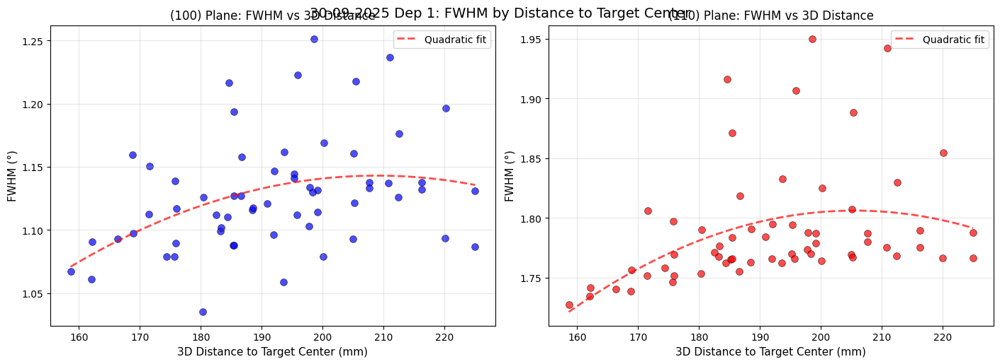

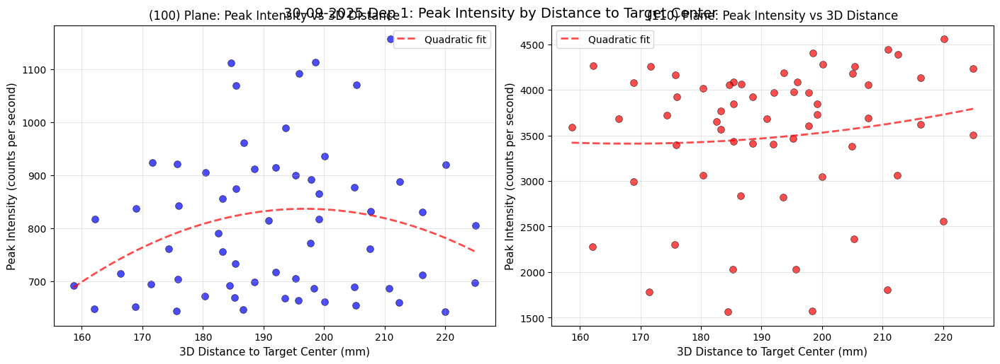

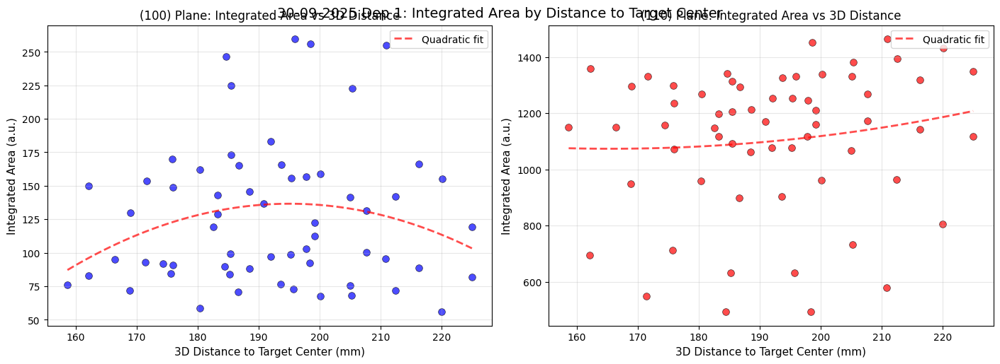

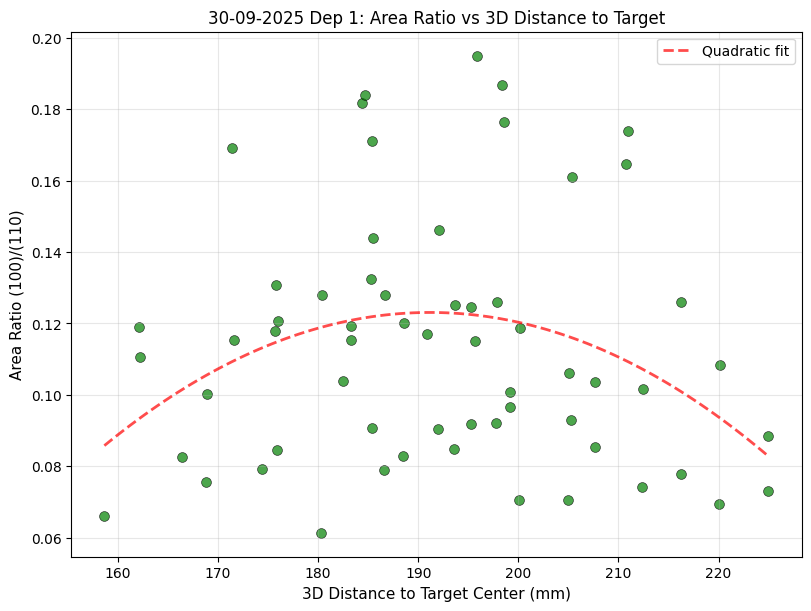


Correlation coefficients (Pearson) with 3D distance:

  FWHM:
    (100): r = 0.346
    (110): r = 0.340

  Peak Intensity:
    (100): r = 0.104
    (110): r = 0.120

  Integrated Area:
    (100): r = 0.062
    (110): r = 0.131

  Area Ratio (100)/(110): r = -0.041

Distance analysis for: 22-09-2025 Dep 2
  3D Distance range: 152.29 - 233.81 mm


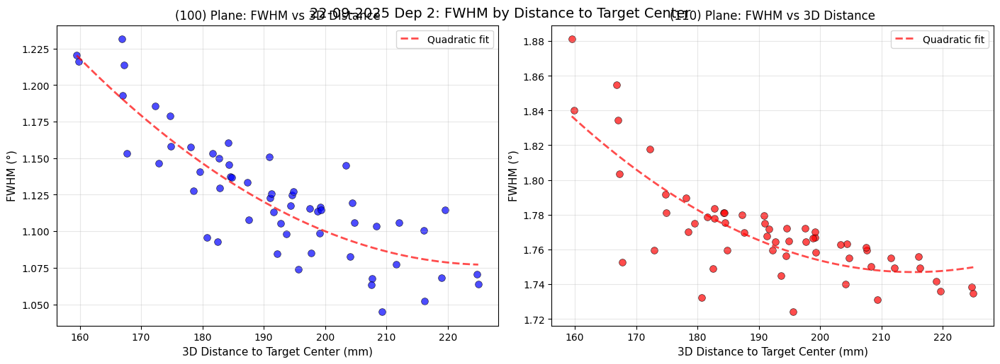

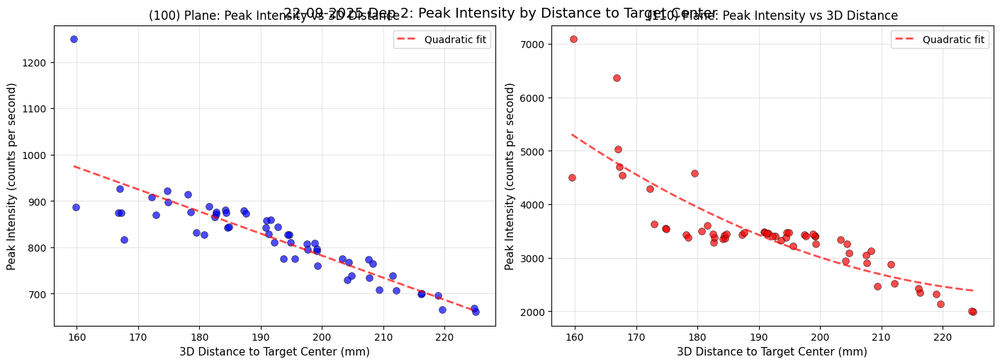

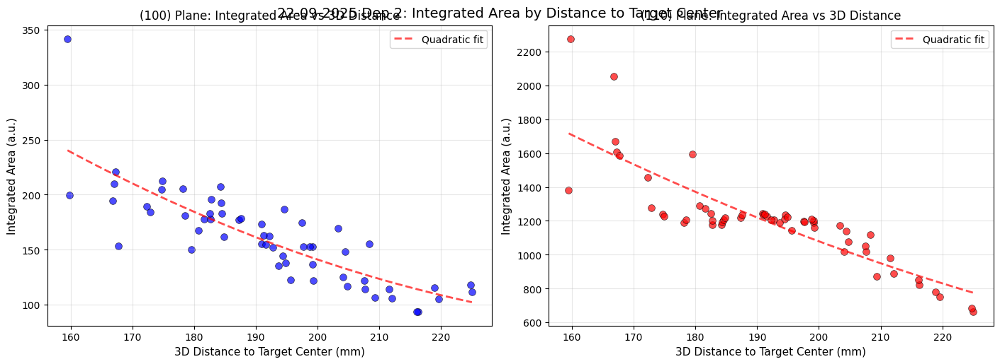

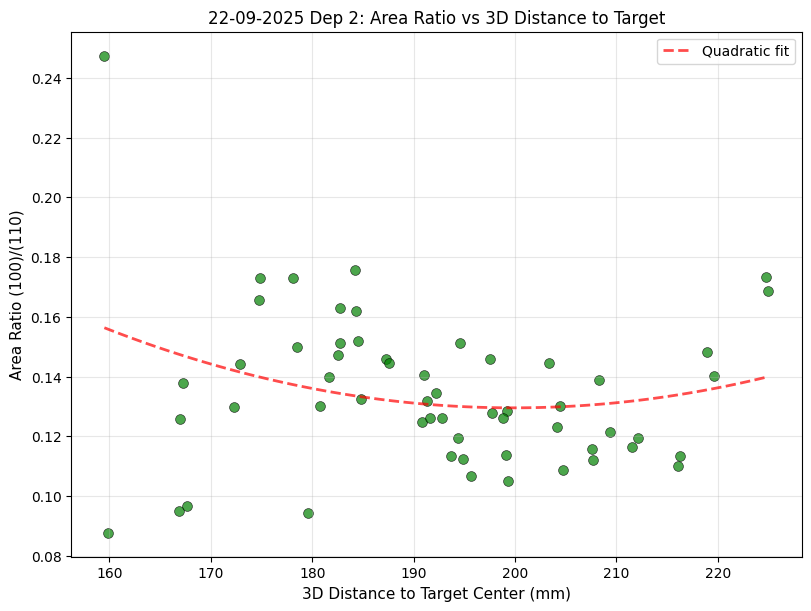


Correlation coefficients (Pearson) with 3D distance:

  FWHM:
    (100): r = -0.830
    (110): r = -0.727

  Peak Intensity:
    (100): r = -0.849
    (110): r = -0.822

  Integrated Area:
    (100): r = -0.822
    (110): r = -0.843

  Area Ratio (100)/(110): r = -0.150

Distance analysis for: 24-09-2025 Dep 3
  3D Distance range: 158.64 - 224.99 mm


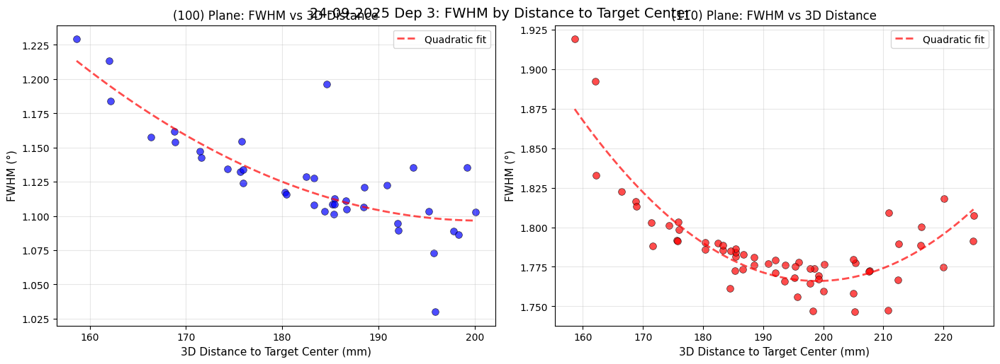

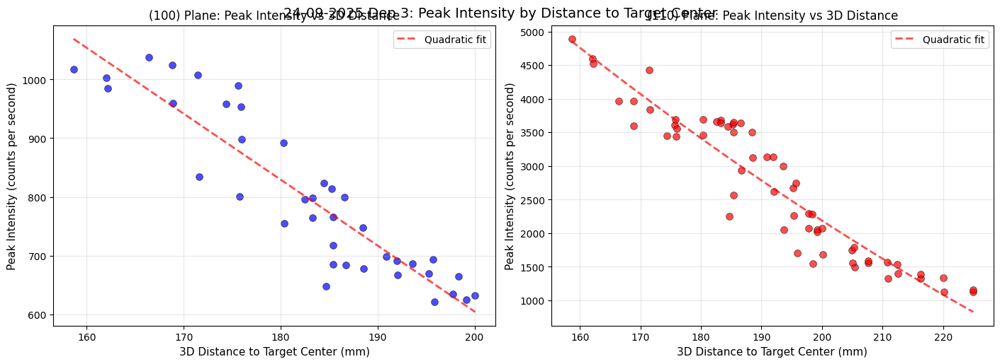

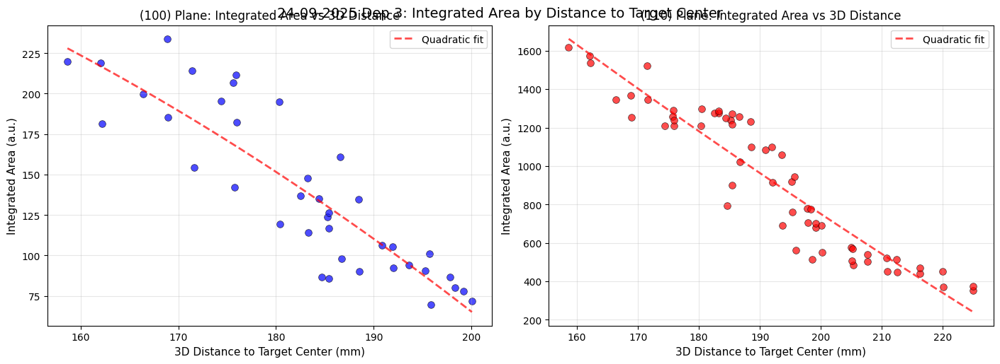

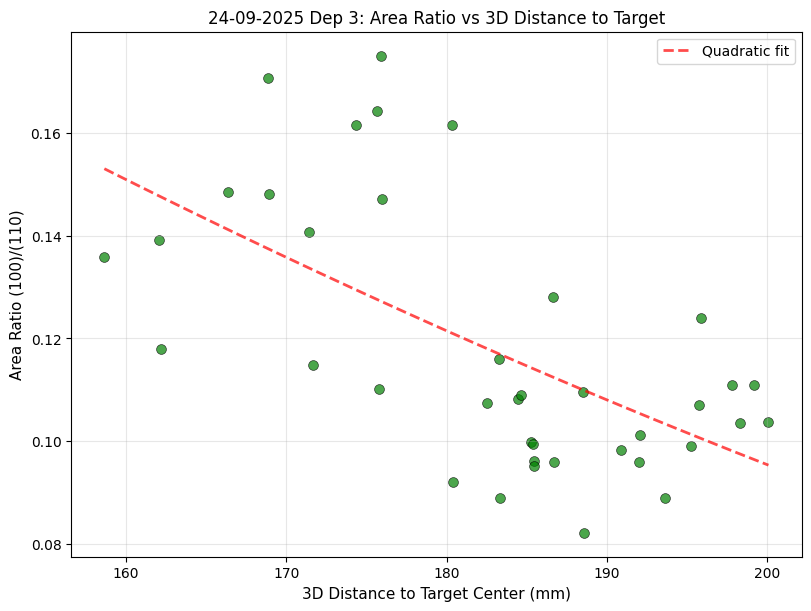


Correlation coefficients (Pearson) with 3D distance:

  FWHM:
    (100): r = -0.777
    (110): r = -0.494

  Peak Intensity:
    (100): r = -0.915
    (110): r = -0.939

  Integrated Area:
    (100): r = -0.879
    (110): r = -0.937

  Area Ratio (100)/(110): r = -0.601

Distance analysis for: 07-10-2025 Dep 6
  3D Distance range: 158.64 - 224.99 mm


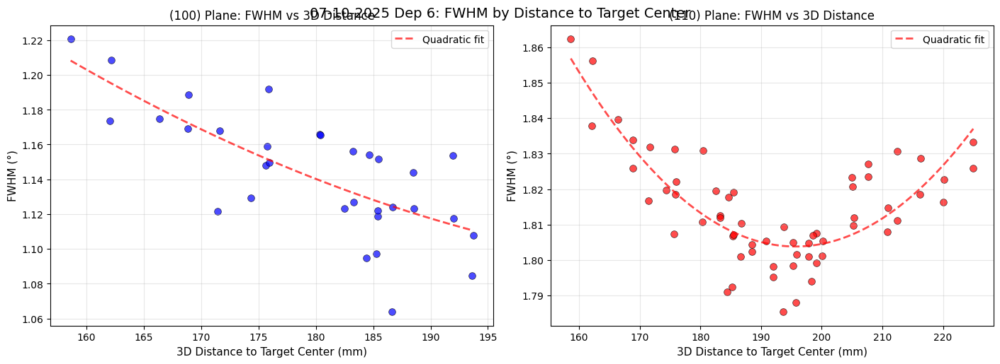

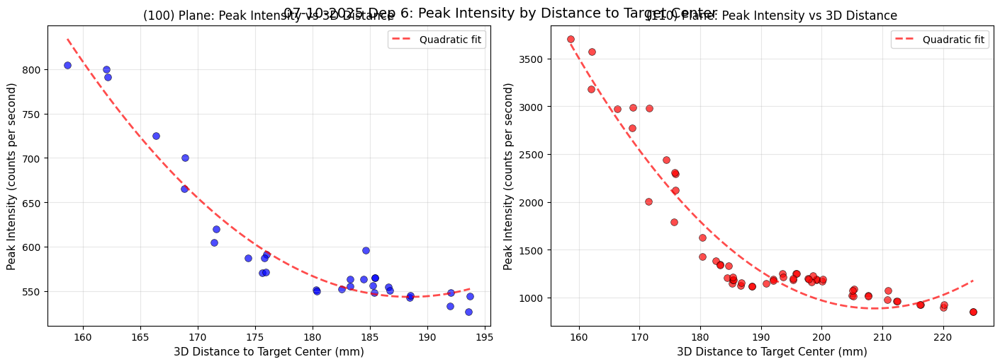

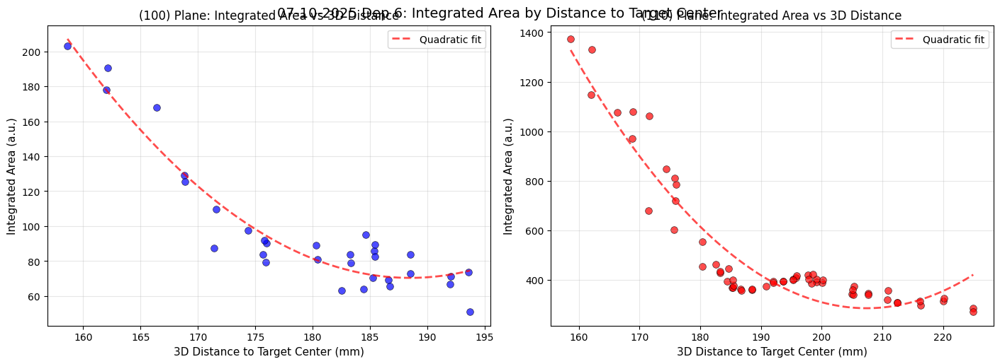

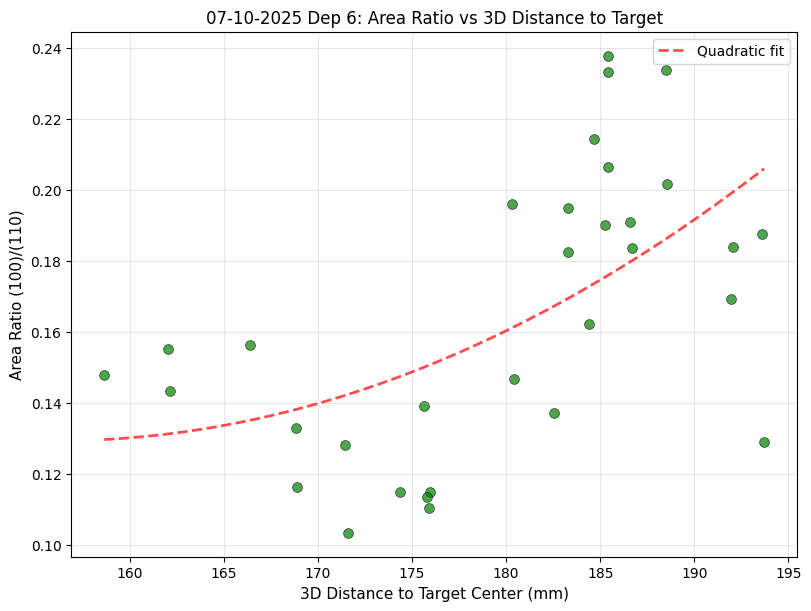


Correlation coefficients (Pearson) with 3D distance:

  FWHM:
    (100): r = -0.737
    (110): r = -0.267

  Peak Intensity:
    (100): r = -0.889
    (110): r = -0.821

  Integrated Area:
    (100): r = -0.872
    (110): r = -0.796

  Area Ratio (100)/(110): r = 0.556

Distance analysis for: 08-10-2025 Dep 7
  3D Distance range: 158.64 - 224.99 mm


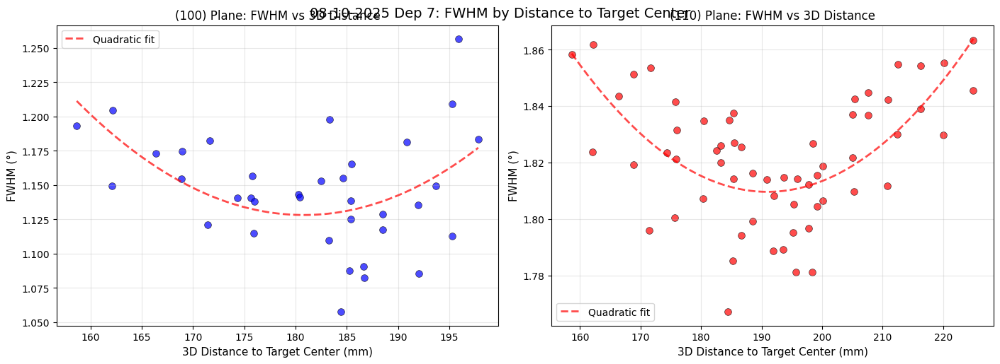

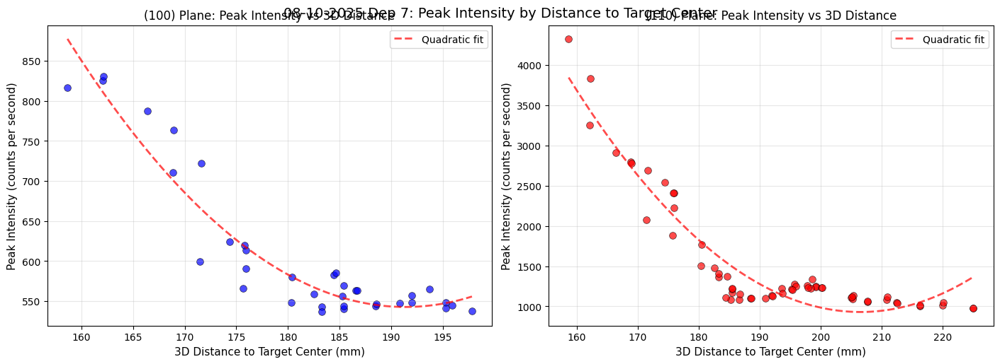

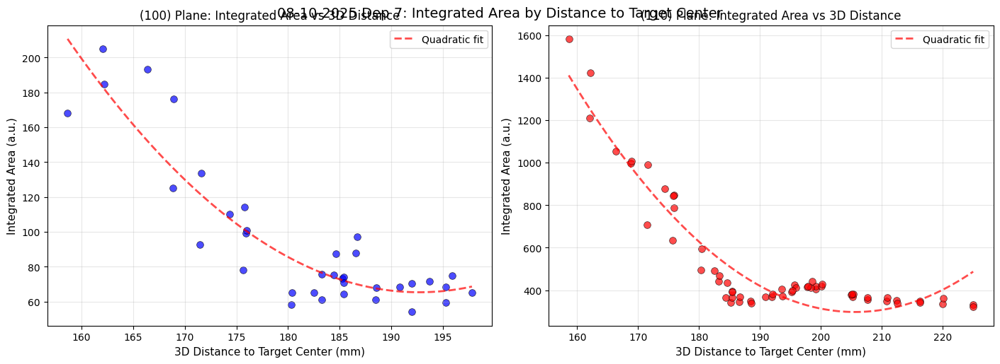

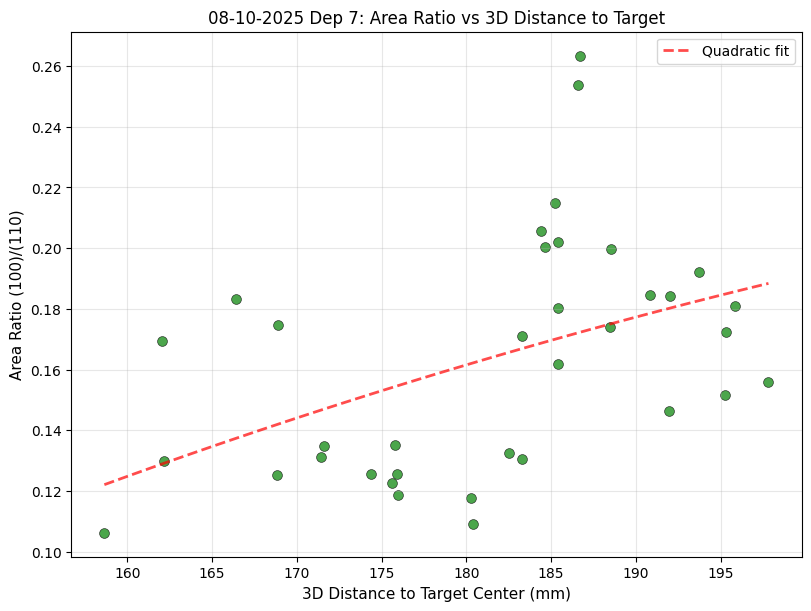


Correlation coefficients (Pearson) with 3D distance:

  FWHM:
    (100): r = -0.146
    (110): r = 0.099

  Peak Intensity:
    (100): r = -0.868
    (110): r = -0.786

  Integrated Area:
    (100): r = -0.843
    (110): r = -0.765

  Area Ratio (100)/(110): r = 0.448

Distance analysis for: 09-10-2025 Dep 8
  3D Distance range: 158.64 - 224.99 mm


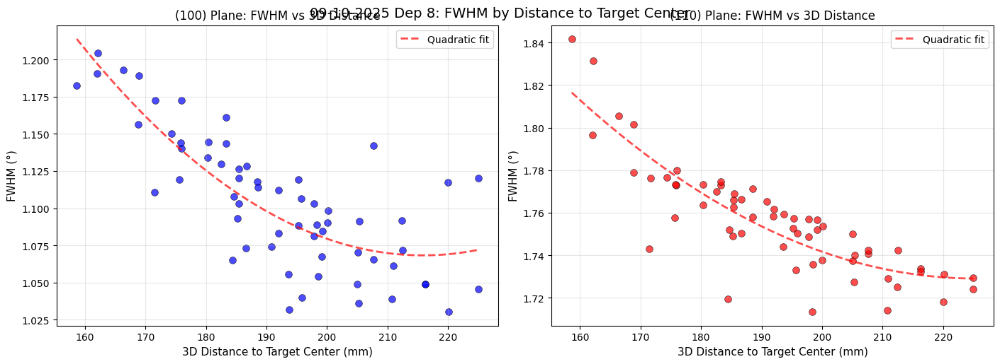

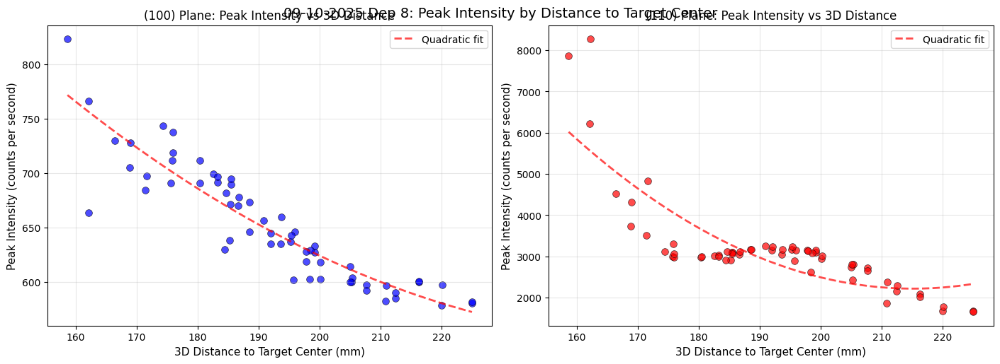

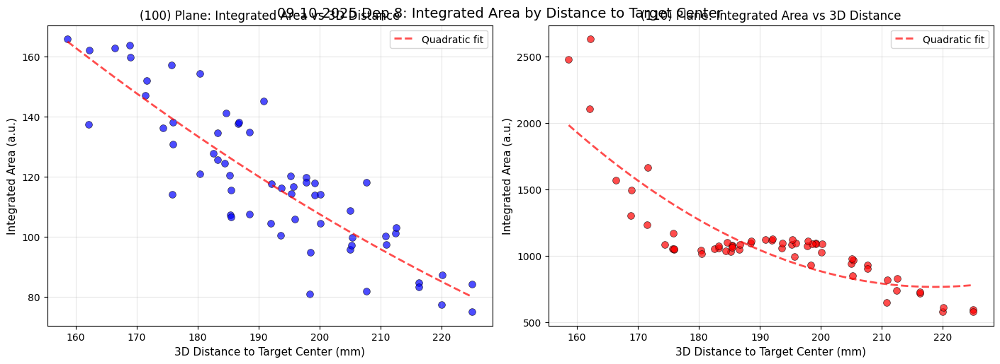

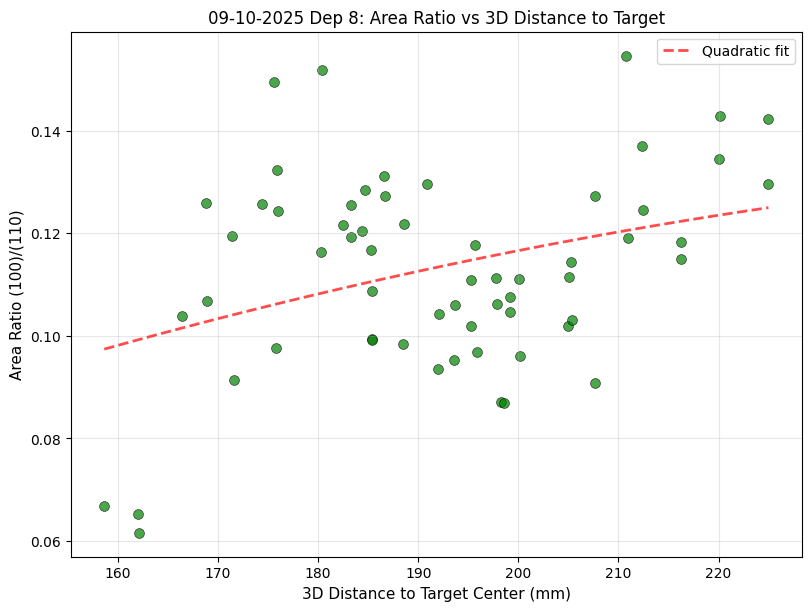


Correlation coefficients (Pearson) with 3D distance:

  FWHM:
    (100): r = -0.750
    (110): r = -0.824

  Peak Intensity:
    (100): r = -0.904
    (110): r = -0.754

  Integrated Area:
    (100): r = -0.870
    (110): r = -0.782

  Area Ratio (100)/(110): r = 0.346


All depositions analyzed successfully!


In [18]:
# Process each deposition and create distance plots
for dep_name in DEPOSITIONS:
    if dep_name not in all_deposition_results:
        print(f"\nSkipping {dep_name} - no results available")
        continue
    
    print(f"\n{'='*80}")
    print(f"Distance analysis for: {dep_name}")
    print(f"{'='*80}")
    
    # Get results for this deposition
    dep_data = all_deposition_results[dep_name]
    x_coordinates = dep_data['x_coordinates']
    y_coordinates = dep_data['y_coordinates']
    fwhm = dep_data['fwhm']
    peakI = dep_data['peak_intensity']
    peakA = dep_data['peak_areas']
    
    # Convert XRD coordinates to real-world coordinates
    # The x_coordinates from XRD need to have their sign flipped
    x_pos_real = -x_coordinates + wafer_center_x
    y_pos_real = y_coordinates + wafer_center_y
    z_pos_real = np.full_like(x_pos_real, wafer_center_z)
    
    # Calculate 3D distance from each point to target
    distances_3d = np.sqrt(
        (x_pos_real - target_x)**2 + 
        (y_pos_real - target_y)**2 + 
        (z_pos_real - target_z)**2
    )
    
    print(f"  3D Distance range: {distances_3d.min():.2f} - {distances_3d.max():.2f} mm")
    
    # Get data for (100) and (110) planes
    area_100 = peakA[:, 0]
    area_110 = peakA[:, 1]
    fwhm_100 = fwhm[:, 0]
    fwhm_110 = fwhm[:, 1]
    intensity_100 = peakI[:, 0]
    intensity_110 = peakI[:, 1]
    
    # Calculate area ratio
    with np.errstate(divide='ignore', invalid='ignore'):
        area_ratio = area_100 / area_110
    area_ratio[~np.isfinite(area_ratio)] = np.nan
    
    # ===============================================================
    # PLOT 1: FWHM vs 3D Distance
    # ===============================================================
    fig, axes = plt.subplots(1, 2, figsize=(14, 5), constrained_layout=True)
    
    # (100) FWHM
    ax = axes[0]
    mask_finite = np.isfinite(fwhm_100) & np.isfinite(distances_3d)
    ax.scatter(distances_3d[mask_finite], fwhm_100[mask_finite], 
               c='blue', s=50, alpha=0.7, edgecolors='black', linewidths=0.5)
    ax.set_xlabel('3D Distance to Target Center (mm)', fontsize=11)
    ax.set_ylabel('FWHM (°)', fontsize=11)
    ax.set_title('(100) Plane: FWHM vs 3D Distance', fontsize=12)
    ax.grid(True, alpha=0.3)
    
    if np.sum(mask_finite) > 3:
        z = np.polyfit(distances_3d[mask_finite], fwhm_100[mask_finite], 2)
        p = np.poly1d(z)
        x_trend = np.linspace(distances_3d[mask_finite].min(), distances_3d[mask_finite].max(), 100)
        ax.plot(x_trend, p(x_trend), 'r--', linewidth=2, alpha=0.7, label='Quadratic fit')
        ax.legend()
    
    # (110) FWHM
    ax = axes[1]
    mask_finite = np.isfinite(fwhm_110) & np.isfinite(distances_3d)
    ax.scatter(distances_3d[mask_finite], fwhm_110[mask_finite], 
               c='red', s=50, alpha=0.7, edgecolors='black', linewidths=0.5)
    ax.set_xlabel('3D Distance to Target Center (mm)', fontsize=11)
    ax.set_ylabel('FWHM (°)', fontsize=11)
    ax.set_title('(110) Plane: FWHM vs 3D Distance', fontsize=12)
    ax.grid(True, alpha=0.3)
    
    if np.sum(mask_finite) > 3:
        z = np.polyfit(distances_3d[mask_finite], fwhm_110[mask_finite], 2)
        p = np.poly1d(z)
        x_trend = np.linspace(distances_3d[mask_finite].min(), distances_3d[mask_finite].max(), 100)
        ax.plot(x_trend, p(x_trend), 'r--', linewidth=2, alpha=0.7, label='Quadratic fit')
        ax.legend()
    
    plt.suptitle(f'{dep_name}: FWHM by Distance to Target Center', y=1.00, fontsize=14)
    plt.show()
    
    # ===============================================================
    # PLOT 2: Peak Intensity vs 3D Distance
    # ===============================================================
    fig, axes = plt.subplots(1, 2, figsize=(14, 5), constrained_layout=True)
    
    # (100) Peak Intensity
    ax = axes[0]
    mask_finite = np.isfinite(intensity_100) & np.isfinite(distances_3d)
    ax.scatter(distances_3d[mask_finite], intensity_100[mask_finite], 
               c='blue', s=50, alpha=0.7, edgecolors='black', linewidths=0.5)
    ax.set_xlabel('3D Distance to Target Center (mm)', fontsize=11)
    ax.set_ylabel('Peak Intensity (counts per second)', fontsize=11)
    ax.set_title('(100) Plane: Peak Intensity vs 3D Distance', fontsize=12)
    ax.grid(True, alpha=0.3)
    
    if np.sum(mask_finite) > 3:
        z = np.polyfit(distances_3d[mask_finite], intensity_100[mask_finite], 2)
        p = np.poly1d(z)
        x_trend = np.linspace(distances_3d[mask_finite].min(), distances_3d[mask_finite].max(), 100)
        ax.plot(x_trend, p(x_trend), 'r--', linewidth=2, alpha=0.7, label='Quadratic fit')
        ax.legend()
    
    # (110) Peak Intensity
    ax = axes[1]
    mask_finite = np.isfinite(intensity_110) & np.isfinite(distances_3d)
    ax.scatter(distances_3d[mask_finite], intensity_110[mask_finite], 
               c='red', s=50, alpha=0.7, edgecolors='black', linewidths=0.5)
    ax.set_xlabel('3D Distance to Target Center (mm)', fontsize=11)
    ax.set_ylabel('Peak Intensity (counts per second)', fontsize=11)
    ax.set_title('(110) Plane: Peak Intensity vs 3D Distance', fontsize=12)
    ax.grid(True, alpha=0.3)
    
    if np.sum(mask_finite) > 3:
        z = np.polyfit(distances_3d[mask_finite], intensity_110[mask_finite], 2)
        p = np.poly1d(z)
        x_trend = np.linspace(distances_3d[mask_finite].min(), distances_3d[mask_finite].max(), 100)
        ax.plot(x_trend, p(x_trend), 'r--', linewidth=2, alpha=0.7, label='Quadratic fit')
        ax.legend()
    
    plt.suptitle(f'{dep_name}: Peak Intensity by Distance to Target Center', y=1.00, fontsize=14)
    plt.show()
    
    # ===============================================================
    # PLOT 3: Integrated Area vs 3D Distance
    # ===============================================================
    fig, axes = plt.subplots(1, 2, figsize=(14, 5), constrained_layout=True)
    
    # (100) Integrated Area
    ax = axes[0]
    mask_finite = np.isfinite(area_100) & np.isfinite(distances_3d)
    ax.scatter(distances_3d[mask_finite], area_100[mask_finite], 
               c='blue', s=50, alpha=0.7, edgecolors='black', linewidths=0.5)
    ax.set_xlabel('3D Distance to Target Center (mm)', fontsize=11)
    ax.set_ylabel('Integrated Area (a.u.)', fontsize=11)
    ax.set_title('(100) Plane: Integrated Area vs 3D Distance', fontsize=12)
    ax.grid(True, alpha=0.3)
    
    if np.sum(mask_finite) > 3:
        z = np.polyfit(distances_3d[mask_finite], area_100[mask_finite], 2)
        p = np.poly1d(z)
        x_trend = np.linspace(distances_3d[mask_finite].min(), distances_3d[mask_finite].max(), 100)
        ax.plot(x_trend, p(x_trend), 'r--', linewidth=2, alpha=0.7, label='Quadratic fit')
        ax.legend()
    
    # (110) Integrated Area
    ax = axes[1]
    mask_finite = np.isfinite(area_110) & np.isfinite(distances_3d)
    ax.scatter(distances_3d[mask_finite], area_110[mask_finite], 
               c='red', s=50, alpha=0.7, edgecolors='black', linewidths=0.5)
    ax.set_xlabel('3D Distance to Target Center (mm)', fontsize=11)
    ax.set_ylabel('Integrated Area (a.u.)', fontsize=11)
    ax.set_title('(110) Plane: Integrated Area vs 3D Distance', fontsize=12)
    ax.grid(True, alpha=0.3)
    
    if np.sum(mask_finite) > 3:
        z = np.polyfit(distances_3d[mask_finite], area_110[mask_finite], 2)
        p = np.poly1d(z)
        x_trend = np.linspace(distances_3d[mask_finite].min(), distances_3d[mask_finite].max(), 100)
        ax.plot(x_trend, p(x_trend), 'r--', linewidth=2, alpha=0.7, label='Quadratic fit')
        ax.legend()
    
    plt.suptitle(f'{dep_name}: Integrated Area by Distance to Target Center', y=1.00, fontsize=14)
    plt.show()
    
    # ===============================================================
    # PLOT 4: Area Ratio (100)/(110) vs 3D Distance
    # ===============================================================
    fig, ax = plt.subplots(1, 1, figsize=(8, 6), constrained_layout=True)
    
    mask_finite = np.isfinite(area_ratio) & np.isfinite(distances_3d)
    ax.scatter(distances_3d[mask_finite], area_ratio[mask_finite], 
               c='green', s=50, alpha=0.7, edgecolors='black', linewidths=0.5)
    ax.set_xlabel('3D Distance to Target Center (mm)', fontsize=11)
    ax.set_ylabel('Area Ratio (100)/(110)', fontsize=11)
    ax.set_title(f'{dep_name}: Area Ratio vs 3D Distance to Target', fontsize=12)
    ax.grid(True, alpha=0.3)
    
    if np.sum(mask_finite) > 3:
        z = np.polyfit(distances_3d[mask_finite], area_ratio[mask_finite], 2)
        p = np.poly1d(z)
        x_trend = np.linspace(distances_3d[mask_finite].min(), distances_3d[mask_finite].max(), 100)
        ax.plot(x_trend, p(x_trend), 'r--', linewidth=2, alpha=0.7, label='Quadratic fit')
        ax.legend()
    
    plt.show()
    
    # Print correlation statistics
    print(f"\nCorrelation coefficients (Pearson) with 3D distance:")
    for metric_name, data_100, data_110 in [
        ("FWHM", fwhm_100, fwhm_110),
        ("Peak Intensity", intensity_100, intensity_110),
        ("Integrated Area", area_100, area_110)
    ]:
        print(f"\n  {metric_name}:")
        for plane_name, data in [("(100)", data_100), ("(110)", data_110)]:
            mask = np.isfinite(data) & np.isfinite(distances_3d)
            if np.sum(mask) > 2:
                corr = np.corrcoef(distances_3d[mask], data[mask])[0, 1]
                print(f"    {plane_name}: r = {corr:.3f}")
    
    # Area ratio
    mask = np.isfinite(area_ratio) & np.isfinite(distances_3d)
    if np.sum(mask) > 2:
        corr = np.corrcoef(distances_3d[mask], area_ratio[mask])[0, 1]
        print(f"\n  Area Ratio (100)/(110): r = {corr:.3f}")

print(f"\n\n{'='*80}")
print("All depositions analyzed successfully!")
print(f"{'='*80}")